#  Set Up

In [17]:
#import libraries
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from sklearn.datasets import fetch_mldata
from sklearn.datasets import get_data_home
from sklearn.model_selection import train_test_split
from shutil import copyfileobj
from six.moves import urllib
from sklearn.datasets.base import get_data_home
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
from sklearn.neural_network import MLPClassifier

## Import Mnist

In [18]:
#here's a function that downloads MNIST from another source and stores
# it in the default location where scikit-learn stores mldata datasets 
#(`~/scikit_learn_data/mldata/`). So after you call this function, 
#`fetch_mldata("MNIST original")` will work fine.

def fetch_mnist(data_home=None):
    mnist_alternative_url = "https://github.com/amplab/datascience-sp14/raw/master/lab7/mldata/mnist-original.mat"
    data_home = get_data_home(data_home=data_home)
    data_home = os.path.join(data_home, 'mldata')
    if not os.path.exists(data_home):
        os.makedirs(data_home)
    mnist_save_path = os.path.join(data_home, "mnist-original.mat")
    if not os.path.exists(mnist_save_path):
        mnist_url = urllib.request.urlopen(mnist_alternative_url)
        with open(mnist_save_path, "wb") as matlab_file:
            copyfileobj(mnist_url, matlab_file)  
            
#Downloading the Data (MNIST)
print(get_data_home())

fetch_mnist()
mnist = fetch_mldata('MNIST original')

# These are the images
# There are 70,000 images (28 by 28 images for a dimensionality of 784)
print("Number of images: ", mnist.data.shape)
# These are the labels
print("Labels: " ,mnist.target.shape)

C:\Users\diana\scikit_learn_data
Number of images:  (70000, 784)
Labels:  (70000,)


In [19]:
#score to beat 
orig_score = 0.9134

## Functions for Creating New Features

In [24]:
def imgAsMatrix(img): 
    """converts img array to 28 x 28 matrix"""
    img_as_matrix = [[img[i*j-1] for i in range(28)] for j in range(28)]
    #print (img_as_matrix)
    return img_as_matrix
    
    
def findcenter(img_as_matrix):
    """finds the location of the center of the digit"""
    #print (img_as_matrix)
    #find non-black pixel locations 
    white_x = []
    white_y = []
    for i in range(28):
        for j in range (28):
            if img_as_matrix[i][j] > 0 :
                  white_y.append(i)
                    
    for j in range(28):
        for i in range(28):
            if img_as_matrix[i][j] > 0 :
                white_x.append(j)
                
   # white_y = [i for i in range(28) if img_as_matrix[i][j]>0 for j in range(28)]
    #white_x = [j for j in range(28) if img_as_matrix[i][j]>0 for i in range(28)]
    #flatten and then find median
    x_cntr = np.median(white_x)
    y_cntr = np.median(white_y)
    print ("xcenter",  x_cntr, "ycenter", y_cntr)
    return x_cntr, y_cntr

def crosshairs(img_as_matrix): 
    """divides images into 8 sections relative to the center of the digit"""
    x_cntr, y_cntr = findcenter(img_as_matrix)
    x_cntr = int(x_cntr.item())
    y_cntr = int(y_cntr.item())
    
    Top =[]
    TR  = []
    Rgt =[]
    BR =[]
    Bot =[]
    BL = []
    Lft =[]
    TL =[]
    
    for i in range(20):
        if y_cntr-2-i>=0:
            Top.append(img_as_matrix[x_cntr][y_cntr-2-i])
            
    for i in range(20):
        if x_cntr-2-i>=0 and y_cntr+2+i<28:
            TL.append(img_as_matrix[x_cntr-2-i][y_cntr+2+i])
            
       
    for i in range(20):
        if x_cntr-2-i>=0:
            Lft.append(img_as_matrix[x_cntr-2-i][y_cntr])
            
    
    for i in range(20):
        if x_cntr-2-i>=0 and y_cntr+2+i<28:
            BL.append(img_as_matrix[x_cntr-2-i][y_cntr+2+i])
        
        
    for i in range(20):
        if y_cntr+2+i<28:
            Bot.append(img_as_matrix[x_cntr][y_cntr+2+i])
        
        
    for i in range(20):
        if x_cntr+2+i<28 and y_cntr+2+i<28:
            BR.append(img_as_matrix[x_cntr+2+i][y_cntr+2+i])
        
        
    for i in range(20):
        if x_cntr+2+i<28:
            Rgt.append(img_as_matrix[x_cntr+2+i][y_cntr])
    
    
    for i in range(20):
        if x_cntr+2+i<28 and y_cntr-2-i>=0:
            TR.append(img_as_matrix[x_cntr+2+i][y_cntr-2-i])
    
    #Top = [img_as_matrix[x_cntr][y_cntr-2-i] for i in range(20) if y_cntr-2-i>=0]
    #TL  = [img_as_matrix[x_cntr-2-i][y_cntr+2+i] for i in range(20) if x_cntr-2-i>=0 and y_cntr+2+i>=0]
   # Lft = [img_as_matrix[x_cntr-2-i][y_cntr] for i in range(20) if x_cntr-2-i>=0]
    #BL  = [img_as_matrix[x_cntr-2-i][y_cntr+2+i] for i in range(20) if x_cntr-2-i>=0 and y_cntr+2+i<28]
    #Bot = [img_as_matrix[x_cntr][y_cntr+2+i] for i in range(20) if y_cntr+2+i<28]
    #BR  = [img_as_matrix[x_cntr+2+i][y_cntr+2+i] for i in range(20) if x_cntr+2+i<28 and y_cntr+2+i<28]
    #Rgt = [img_as_matrix[x_cntr+2+i][y_cntr] for i in range(20) if x_cntr+2+i<28]
    #TR  = [img_as_matrix[x_cntr+2+i][y_cntr-2-i] for i in range(20) if x_cntr+2+i<28 and y_cntr-2-i>=0]
    print ([Top,TR,Rgt,BR,Bot,BL,Lft,TL])
    return [Top,TR,Rgt,BR,Bot,BL,Lft,TL]

def longestLine(line):
    """calculates longest white line segment"""
    longest=0
    current=0
    i=0
    while i<len(line):
        if len[i]==0:
            longest=max(longest,current)
            i+=1
            current=0
        else:
            current+=1
            i+=1
    longest=max(longest,current)
    return longest  

def horizLL(img_as_matrix):
    return [longestline(img_as_matrix[i]) for i in range(28)]

def vertLL(img_as_matrix):
    verts = np.transpose(im_as_matrix)
    return [longestline(verts[i]) for i in range(28)]

def extremaCount(img):
    #takes the image as input variable img
    count = 0
    direction = 0
    for i in range(783):
        chg = img[i+1]-img[i]
        if chg != 0:
            new_dir = chg/abs(chg)
            if direction == 0:
                direction = new_dir
            else:
                if direction == -1 * new_dir:
                    direction = new_dir
                    count += 1
        elif img[i]==0:
            direction = 0
    return count


## Create Features and Normalize 

In [25]:
# find maximum value in mnist images
max = 0 
for img in mnist.data:
    if max < np.max(img):
        max = np.max(img)
    else: 
        pass 


for img in mnist.data: 
    img_as_matrix = imgAsMatrix(img)
    sections = crosshairs(img_as_matrix)
    extrema_features = []
    for section in sections: 
        extrema_features.append(extremaCount)



xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 60, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 178, 0, 0, 0, 121], [0, 0, 0, 252, 0, 7, 145], [253, 252, 0, 253, 252, 0, 0], [0, 0, 0, 252, 0, 7, 145], [253, 0, 178, 0, 0, 0, 121], [0, 0, 0, 253, 0, 0, 60, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 178, 0, 0, 0, 121]]
xcenter 19.0 ycenter 19.0
[[96, 0, 0, 253, 31, 0, 16, 251, 0, 0, 63, 0, 0, 0, 0, 0, 0, 0], [197, 204, 240, 0, 251, 0, 251], [48, 0, 0, 251, 0, 0, 94], [197, 251, 0, 197, 129, 0, 0], [48, 0, 0, 251, 0, 0, 94], [197, 204, 240, 0, 251, 0, 251], [96, 0, 0, 253, 31, 0, 16, 251, 0, 0, 63, 0, 0, 0, 0, 0, 0, 0], [197, 204, 240, 0, 251, 0, 251]]
xcenter 19.0 ycenter 19.0
[[251, 0, 0, 251, 0, 0, 32, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 251, 109], [182, 0, 0, 255, 93, 0, 0], [0, 0, 0, 0, 0, 251, 109], [253, 0, 0, 0, 0, 0, 0], [251, 0, 0, 251, 0, 0, 32, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[215, 0, 

xcenter 19.0 ycenter 19.0
[[146, 182, 0, 253, 253, 0, 0, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [185, 0, 186, 0, 0, 0, 0], [82, 0, 0, 253, 0, 125, 55], [253, 253, 0, 253, 253, 0, 0], [82, 0, 0, 253, 0, 125, 55], [185, 0, 186, 0, 0, 0, 0], [146, 182, 0, 253, 253, 0, 0, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [185, 0, 186, 0, 0, 0, 0]]
xcenter 19.5 ycenter 19.5
[[235, 142, 0, 246, 253, 0, 0, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [253, 0, 28, 0, 0, 0, 78], [0, 0, 0, 253, 0, 253, 138], [249, 253, 0, 253, 253, 0, 0], [0, 0, 0, 253, 0, 253, 138], [253, 0, 28, 0, 0, 0, 78], [235, 142, 0, 246, 253, 0, 0, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [253, 0, 28, 0, 0, 0, 78]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 1, 0, 27, 0, 0, 47, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 252, 0, 0, 0, 252], [0, 20, 0, 0, 252, 0, 253, 252], [0, 108, 0, 0, 253, 0, 0, 0], [0, 20, 0, 0, 252, 0, 253, 252], [252, 0, 0, 252, 0, 0, 0, 252], [0, 253, 0, 0, 1, 0, 27, 0, 0, 47, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 252, 0, 0, 0, 252]]
x

xcenter 19.0 ycenter 19.0
[[0, 250, 0, 244, 250, 0, 250, 82, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 250, 0, 0, 0, 0], [161, 0, 0, 250, 0, 254, 250], [250, 252, 0, 250, 250, 0, 0], [161, 0, 0, 250, 0, 254, 250], [0, 0, 250, 0, 0, 0, 0], [0, 250, 0, 244, 250, 0, 250, 82, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 250, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[252, 0, 0, 252, 153, 0, 246, 138, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 189, 252, 73, 219, 0], [0, 0, 0, 0, 0, 0, 252, 0], [252, 55, 252, 0, 0, 9, 0, 0], [0, 0, 0, 0, 0, 0, 252, 0], [0, 252, 0, 189, 252, 73, 219, 0], [252, 0, 0, 252, 153, 0, 246, 138, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 189, 252, 73, 219, 0]]
xcenter 18.5 ycenter 18.5
[[221, 0, 0, 252, 144, 0, 21, 180, 0, 0, 0, 0, 0, 0, 0, 0, 0], [108, 98, 0, 32, 221, 132, 125, 0], [0, 0, 0, 179, 0, 0, 253, 0], [252, 253, 252, 0, 253, 215, 0, 0], [0, 0, 0, 179, 0, 0, 253, 0], [108, 98, 0, 32, 221, 132, 125, 0], [221, 0, 0, 252, 144, 0, 21, 180, 0, 0, 0, 0, 0, 0, 0, 0, 0], [108, 98, 0

xcenter 19.0 ycenter 19.0
[[254, 0, 0, 251, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [117, 4, 0, 0, 74, 0, 251], [0, 0, 0, 58, 0, 50, 254], [254, 177, 0, 237, 254, 0, 0], [0, 0, 0, 58, 0, 50, 254], [117, 4, 0, 0, 74, 0, 251], [254, 0, 0, 251, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [117, 4, 0, 0, 74, 0, 251]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 223, 0, 0, 53, 128, 0, 0, 23, 0, 0, 0, 0, 0, 0, 0], [254, 0, 102, 0, 26, 0, 196], [0, 0, 0, 254, 0, 59, 103], [254, 254, 0, 218, 254, 0, 0], [0, 0, 0, 254, 0, 59, 103], [254, 0, 102, 0, 26, 0, 196], [0, 0, 0, 223, 0, 0, 53, 128, 0, 0, 23, 0, 0, 0, 0, 0, 0, 0], [254, 0, 102, 0, 26, 0, 196]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 253, 0, 0, 253, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0, 0], [104, 170, 99, 0, 209, 0, 253], [0, 0, 0, 105, 0, 185, 253], [234, 172, 0, 226, 43, 0, 0], [0, 0, 0, 105, 0, 185, 253], [104, 170, 99, 0, 209, 0, 253], [253, 0, 0, 253, 0, 0, 253, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0, 0], [104, 170, 99, 0, 209, 0, 253]]
xcenter 19.0 ycente

xcenter 19.0 ycenter 19.0
[[253, 0, 0, 191, 93, 0, 0, 215, 0, 0, 180, 0, 0, 0, 0, 0, 0, 0], [252, 20, 0, 0, 0, 0, 210], [0, 0, 0, 73, 0, 211, 252], [98, 252, 0, 253, 252, 0, 0], [0, 0, 0, 73, 0, 211, 252], [252, 20, 0, 0, 0, 0, 210], [253, 0, 0, 191, 93, 0, 0, 215, 0, 0, 180, 0, 0, 0, 0, 0, 0, 0], [252, 20, 0, 0, 0, 0, 210]]
xcenter 19.0 ycenter 19.0
[[0, 116, 0, 167, 174, 0, 240, 247, 0, 0, 133, 0, 0, 0, 0, 0, 0, 0], [156, 0, 235, 0, 0, 0, 0], [119, 0, 0, 253, 0, 235, 253], [253, 253, 0, 254, 243, 0, 0], [119, 0, 0, 253, 0, 235, 253], [156, 0, 235, 0, 0, 0, 0], [0, 116, 0, 167, 174, 0, 240, 247, 0, 0, 133, 0, 0, 0, 0, 0, 0, 0], [156, 0, 235, 0, 0, 0, 0]]
xcenter 19.5 ycenter 19.5
[[205, 0, 0, 253, 0, 0, 0, 126, 0, 0, 84, 0, 0, 0, 0, 0, 0, 0], [251, 0, 0, 0, 0, 0, 220], [0, 0, 0, 236, 0, 202, 251], [251, 251, 0, 236, 251, 0, 0], [0, 0, 0, 236, 0, 202, 251], [251, 0, 0, 0, 0, 0, 220], [205, 0, 0, 253, 0, 0, 0, 126, 0, 0, 84, 0, 0, 0, 0, 0, 0, 0], [251, 0, 0, 0, 0, 0, 220]]
xcenter 18.0 

xcenter 18.5 ycenter 18.5
[[254, 0, 0, 250, 254, 0, 143, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 211, 254, 250], [254, 0, 0, 254, 0, 0, 0, 0], [135, 75, 105, 0, 231, 136, 0, 0], [254, 0, 0, 254, 0, 0, 0, 0], [0, 254, 0, 0, 254, 211, 254, 250], [254, 0, 0, 250, 254, 0, 143, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 211, 254, 250]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 252, 0, 0, 157, 0, 0, 134, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 184, 0, 0, 0, 0], [50, 0, 0, 252, 0, 0, 252], [253, 252, 0, 110, 246, 0, 0], [50, 0, 0, 252, 0, 0, 252], [252, 0, 184, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 157, 0, 0, 134, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 184, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 72, 0, 0, 71, 0, 0, 40, 0, 218, 0, 0, 0, 0, 0, 0, 0], [230, 0, 0, 0, 0, 133, 0, 3], [253, 0, 0, 66, 0, 0, 0, 6], [253, 0, 253, 114, 201, 0, 0, 0], [253, 0, 0, 66, 0, 0, 0, 6], [230, 0, 0, 0, 0, 133, 0, 3], [0, 72, 0, 0, 71, 0, 0, 40, 0, 218, 0, 0, 0, 0, 0, 0, 0], [230, 0, 0, 0, 0, 133, 0, 3]]
xcen

xcenter 18.0 ycenter 18.0
[[0, 80, 0, 0, 83, 0, 221, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [220, 0, 0, 201, 0, 0, 0, 251], [0, 0, 0, 63, 16, 0, 251, 251], [0, 181, 0, 0, 253, 0, 0, 0], [0, 0, 0, 63, 16, 0, 251, 251], [220, 0, 0, 201, 0, 0, 0, 251], [0, 80, 0, 0, 83, 0, 221, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [220, 0, 0, 201, 0, 0, 0, 251]]
xcenter 18.0 ycenter 18.0
[[233, 254, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 203, 0, 252, 233, 0, 152, 212], [82, 0, 0, 213, 0, 0, 0, 0], [253, 0, 102, 171, 0, 232, 0, 0], [82, 0, 0, 213, 0, 0, 0, 0], [0, 203, 0, 252, 233, 0, 152, 212], [233, 254, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 203, 0, 252, 233, 0, 152, 212]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 235, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 169], [0, 81, 0, 104, 253, 0, 253, 253], [0, 253, 0, 0, 50, 0, 0, 0], [0, 81, 0, 104, 253, 0, 253, 253], [253, 0, 0, 0, 0, 0, 0, 169], [0, 0, 0, 0, 235, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[253, 0, 0, 253, 0, 0, 0, 12, 0, 0, 75, 0, 0, 0, 0, 0, 0, 0], [252, 56, 16, 0, 74, 0, 201], [0, 0, 0, 234, 0, 0, 252], [252, 252, 0, 76, 252, 0, 0], [0, 0, 0, 234, 0, 0, 252], [252, 56, 16, 0, 74, 0, 201], [253, 0, 0, 253, 0, 0, 0, 12, 0, 0, 75, 0, 0, 0, 0, 0, 0, 0], [252, 56, 16, 0, 74, 0, 201]]
xcenter 18.0 ycenter 18.0
[[81, 246, 0, 251, 204, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 81, 0, 0, 202], [0, 0, 0, 225, 0, 0, 0, 61], [253, 0, 253, 0, 0, 0, 0, 0], [0, 0, 0, 225, 0, 0, 0, 61], [0, 0, 0, 253, 81, 0, 0, 202], [81, 246, 0, 251, 204, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 81, 0, 0, 202]]
xcenter 18.0 ycenter 18.0
[[0, 126, 0, 229, 143, 0, 230, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [26, 0, 0, 133, 0, 0, 0, 253], [0, 0, 0, 234, 38, 0, 253, 249], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 234, 38, 0, 253, 249], [26, 0, 0, 133, 0, 0, 0, 253], [0, 126, 0, 229, 143, 0, 230, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [26, 0, 0, 133, 0, 0, 0, 253]]
xcenter

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 239, 0, 114, 252, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [252, 0, 252, 0, 0, 0, 0], [253, 0, 0, 252, 0, 252, 112], [252, 252, 0, 252, 252, 0, 0], [253, 0, 0, 252, 0, 252, 112], [252, 0, 252, 0, 0, 0, 0], [0, 0, 0, 253, 239, 0, 114, 252, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [252, 0, 252, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 226, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 0], [172, 0, 0, 253, 0, 30, 234], [253, 253, 0, 253, 253, 0, 0], [172, 0, 0, 253, 0, 30, 234], [253, 0, 253, 0, 0, 0, 0], [0, 0, 0, 226, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[255, 64, 0, 255, 191, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 255, 255, 0, 255, 255], [0, 0, 0, 255, 0, 0, 128, 0], [255, 255, 255, 0, 0, 255, 0, 0], [0, 0, 0, 255, 0, 0, 128, 0], [0, 255, 0, 255, 255, 0, 255, 255], [255, 64, 0, 255, 191, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 255, 255, 0, 255, 2

xcenter 18.5 ycenter 18.5
[[11, 30, 0, 0, 253, 0, 152, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [81, 0, 0, 0, 11, 91, 0, 253], [132, 0, 0, 254, 0, 0, 0, 0], [254, 0, 253, 81, 153, 0, 0, 0], [132, 0, 0, 254, 0, 0, 0, 0], [81, 0, 0, 0, 11, 91, 0, 253], [11, 30, 0, 0, 253, 0, 152, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [81, 0, 0, 0, 11, 91, 0, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 255, 0, 0, 57, 170, 0, 0, 86, 0, 0, 0, 0, 0, 0, 0], [198, 0, 114, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 29], [255, 255, 0, 141, 255, 0, 0], [0, 0, 0, 255, 0, 0, 29], [198, 0, 114, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 57, 170, 0, 0, 86, 0, 0, 0, 0, 0, 0, 0], [198, 0, 114, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[252, 203, 0, 253, 203, 0, 0, 132, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 20], [0, 0, 0, 113, 0, 0, 253], [243, 152, 0, 254, 253, 0, 0], [0, 0, 0, 113, 0, 0, 253], [0, 0, 0, 0, 0, 0, 20], [252, 203, 0, 253, 203, 0, 0, 132, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 20]]
xcenter 19.0 ycenter 19.0
[[253, 1

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 35, 253, 0, 146, 103, 0, 0, 0, 0, 0, 0, 0, 0, 0], [126, 0, 0, 0, 0, 253, 0, 40], [253, 0, 0, 239, 0, 0, 3, 82], [242, 220, 253, 0, 199, 237, 0, 0], [253, 0, 0, 239, 0, 0, 3, 82], [126, 0, 0, 0, 0, 253, 0, 40], [0, 0, 0, 35, 253, 0, 146, 103, 0, 0, 0, 0, 0, 0, 0, 0, 0], [126, 0, 0, 0, 0, 253, 0, 40]]
xcenter 20.0 ycenter 20.0
[[253, 0, 225, 253, 0, 0, 235, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 7, 0, 0], [0, 0, 0, 135, 30, 253], [253, 0, 253, 0, 0, 0], [0, 0, 0, 135, 30, 253], [0, 0, 0, 7, 0, 0], [253, 0, 225, 253, 0, 0, 235, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 7, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 240, 0, 0, 251, 0, 103, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 248, 0, 47, 0, 214, 0], [0, 0, 254, 241, 0, 0, 0, 0, 137], [0, 0, 207, 0, 0, 254, 0, 0, 0], [0, 0, 254, 241, 0, 0, 0, 0, 137], [0, 0, 254, 248, 0, 47, 0, 214, 0], [0, 240, 0, 0, 251, 0, 103, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 248, 0, 47, 0, 214, 0]]
xcenter 17.0 ycen

xcenter 17.0 ycenter 17.0
[[0, 176, 0, 0, 85, 0, 87, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 24, 0, 128, 0], [0, 0, 0, 181, 0, 0, 0, 0, 247], [0, 0, 0, 0, 0, 239, 0, 0, 0], [0, 0, 0, 181, 0, 0, 0, 0, 247], [0, 0, 0, 253, 0, 24, 0, 128, 0], [0, 176, 0, 0, 85, 0, 87, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 24, 0, 128, 0]]
xcenter 19.0 ycenter 19.0
[[87, 62, 0, 253, 135, 0, 253, 15, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 0], [237, 0, 0, 253, 0, 233, 253], [253, 253, 0, 253, 156, 0, 0], [237, 0, 0, 253, 0, 233, 253], [253, 0, 253, 0, 0, 0, 0], [87, 62, 0, 253, 135, 0, 253, 15, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 242, 0, 253, 0, 0, 210, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 205, 0, 0, 0, 168], [253, 0, 0, 253, 0, 0, 203], [253, 253, 0, 253, 28, 0, 0], [253, 0, 0, 253, 0, 0, 203], [253, 0, 205, 0, 0, 0, 168], [0, 242, 0, 253, 0, 0, 210, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 205, 0, 0, 0, 168]]
xcenter 1

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 68, 0, 0, 0, 222], [0, 0, 0, 80, 213, 0, 68, 253], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 80, 213, 0, 68, 253], [253, 0, 0, 68, 0, 0, 0, 222], [0, 0, 0, 0, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 68, 0, 0, 0, 222]]
xcenter 18.0 ycenter 18.0
[[0, 128, 0, 0, 0, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 64, 0, 0, 0, 0], [0, 0, 0, 0, 255, 0, 255, 0], [0, 64, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 255, 0, 255, 0], [255, 0, 0, 64, 0, 0, 0, 0], [0, 128, 0, 0, 0, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 64, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[250, 0, 0, 250, 250, 0, 250, 46, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [250, 252, 250, 0, 250, 0, 250], [250, 0, 0, 250, 0, 0, 250], [252, 250, 250, 242, 0, 0, 0], [250, 0, 0, 250, 0, 0, 250], [250, 252, 250, 0, 250, 0, 250], [250, 0, 0, 250, 250, 0, 250, 46, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [250, 252, 250, 0, 250, 0, 250]]
xcenter 19.0 ycent

xcenter 19.0 ycenter 19.0
[[195, 95, 0, 168, 0, 0, 208, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 233, 0, 0, 0, 0], [253, 0, 0, 12, 0, 0, 0], [0, 10, 28, 17, 70, 0, 0], [253, 0, 0, 12, 0, 0, 0], [0, 0, 233, 0, 0, 0, 0], [195, 95, 0, 168, 0, 0, 208, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 233, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 253, 0, 253, 253, 0, 158, 217, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [226, 0, 247, 0, 0, 0, 0], [254, 0, 0, 253, 0, 253, 0], [253, 198, 0, 253, 253, 0, 0], [254, 0, 0, 253, 0, 253, 0], [226, 0, 247, 0, 0, 0, 0], [0, 253, 0, 253, 253, 0, 158, 217, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [226, 0, 247, 0, 0, 0, 0]]
xcenter 19.5 ycenter 19.5
[[219, 204, 0, 253, 253, 0, 218, 103, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 51, 30, 0, 99, 0, 0], [0, 0, 0, 250, 0, 228, 253], [253, 253, 0, 253, 253, 0, 0], [0, 0, 0, 250, 0, 228, 253], [253, 51, 30, 0, 99, 0, 0], [219, 204, 0, 253, 253, 0, 218, 103, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 51, 30, 0, 99, 0, 0]]
xcenter 19.0 ycenter 19.0
[[

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 5, 253, 0, 111, 0, 0, 106, 0, 0, 0, 0, 0, 0, 0], [123, 0, 0, 0, 0, 0, 0, 165], [0, 253, 0, 44, 253, 0, 194, 212], [0, 155, 0, 0, 253, 181, 0, 0], [0, 253, 0, 44, 253, 0, 194, 212], [123, 0, 0, 0, 0, 0, 0, 165], [0, 0, 0, 5, 253, 0, 111, 0, 0, 106, 0, 0, 0, 0, 0, 0, 0], [123, 0, 0, 0, 0, 0, 0, 165]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 131, 254, 0, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0, 248, 77], [0, 0, 199, 0, 0, 0, 73, 254, 0], [0, 35, 197, 0, 0, 0, 242, 0, 0], [0, 0, 199, 0, 0, 0, 73, 254, 0], [0, 0, 254, 0, 0, 0, 0, 248, 77], [0, 0, 0, 131, 254, 0, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0, 248, 77]]
xcenter 18.0 ycenter 18.0
[[212, 26, 0, 208, 253, 0, 164, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 114, 0, 0, 212, 121, 118, 135], [243, 0, 0, 135, 0, 0, 0, 14], [254, 0, 253, 0, 254, 0, 0, 0], [243, 0, 0, 135, 0, 0, 0, 14], [0, 114, 0, 0, 212, 121, 118, 135], [212, 26, 0, 208, 253, 0, 164, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 114

xcenter 20.0 ycenter 20.0
[[0, 0, 170, 118, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 76, 102, 0, 0], [253, 0, 0, 0, 0, 253], [252, 0, 252, 252, 0, 0], [253, 0, 0, 0, 0, 253], [0, 0, 76, 102, 0, 0], [0, 0, 170, 118, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 76, 102, 0, 0]]
xcenter 20.0 ycenter 20.0
[[254, 0, 254, 0, 0, 0, 233, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 187, 0, 0], [52, 0, 0, 0, 173, 230], [201, 0, 244, 0, 0, 0], [52, 0, 0, 0, 173, 230], [0, 0, 0, 187, 0, 0], [254, 0, 254, 0, 0, 0, 233, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 187, 0, 0]]
xcenter 20.0 ycenter 20.0
[[245, 0, 247, 0, 0, 0, 254, 145, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 4, 215, 0, 0], [227, 0, 0, 0, 234, 184], [218, 0, 201, 249, 0, 0], [227, 0, 0, 0, 234, 184], [0, 0, 4, 215, 0, 0], [245, 0, 247, 0, 0, 0, 254, 145, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 4, 215, 0, 0]]
xcenter 20.0 ycenter 20.0
[[254, 0, 253, 0, 0, 0, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 

xcenter 20.0 ycenter 20.0
[[253, 0, 141, 5, 0, 0, 253, 0, 0, 0, 44, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [92, 0, 0, 0, 189, 10], [10, 0, 250, 253, 0, 0], [92, 0, 0, 0, 189, 10], [0, 0, 0, 0, 0, 0], [253, 0, 141, 5, 0, 0, 253, 0, 0, 0, 44, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[89, 0, 0, 166, 252, 0, 210, 0, 0, 54, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 89, 0, 0, 135], [0, 0, 0, 252, 0, 0, 126, 0], [252, 253, 139, 0, 0, 128, 0, 0], [0, 0, 0, 252, 0, 0, 126, 0], [0, 0, 0, 0, 89, 0, 0, 135], [89, 0, 0, 166, 252, 0, 210, 0, 0, 54, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 89, 0, 0, 135]]
xcenter 18.0 ycenter 18.0
[[255, 255, 0, 191, 255, 0, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 128, 0, 255, 255, 0, 128, 128], [0, 0, 0, 191, 0, 0, 0, 0], [255, 0, 255, 0, 0, 255, 0, 0], [0, 0, 0, 191, 0, 0, 0, 0], [0, 128, 0, 255, 255, 0, 128, 128], [255, 255, 0, 191, 255, 0, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 128, 0, 255, 255, 0, 128, 128]]
xcenter 19.0 ycenter 19.0
[[29,

xcenter 19.0 ycenter 19.0
[[202, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 6], [0, 0, 151, 0, 0, 253, 113], [15, 0, 0, 244, 100, 0, 0], [0, 0, 151, 0, 0, 253, 113], [253, 0, 0, 0, 0, 0, 6], [202, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 6]]
xcenter 19.0 ycenter 19.0
[[0, 191, 0, 64, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 0, 255, 0, 255], [255, 0, 0, 191, 0, 0, 0], [0, 64, 0, 255, 255, 0, 0], [255, 0, 0, 191, 0, 0, 0], [0, 0, 255, 0, 255, 0, 255], [0, 191, 0, 64, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 0, 255, 0, 255]]
xcenter 20.0 ycenter 20.0
[[0, 0, 253, 197, 0, 0, 253, 0, 0, 0, 145, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0], [0, 0, 0, 0, 0, 253], [253, 0, 253, 18, 0, 0], [0, 0, 0, 0, 0, 253], [0, 0, 0, 253, 0, 0], [0, 0, 253, 197, 0, 0, 253, 0, 0, 0, 145, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0]]
xcenter 18.0 ycenter 18.0
[[79, 172, 0, 83, 3, 0, 0, 240, 0, 0, 0, 0, 0, 0, 0,

xcenter 18.0 ycenter 18.0
[[253, 0, 0, 253, 253, 0, 253, 221, 0, 18, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 253, 253, 47], [135, 0, 0, 253, 0, 0, 155, 0], [182, 242, 185, 0, 66, 152, 0, 0], [135, 0, 0, 253, 0, 0, 155, 0], [0, 253, 0, 0, 253, 253, 253, 47], [253, 0, 0, 253, 253, 0, 253, 221, 0, 18, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 253, 253, 47]]
xcenter 19.5 ycenter 19.5
[[51, 132, 0, 254, 204, 0, 5, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 254, 0, 0, 0, 22], [189, 0, 0, 254, 0, 235, 0], [254, 128, 0, 254, 254, 0, 0], [189, 0, 0, 254, 0, 235, 0], [254, 0, 254, 0, 0, 0, 22], [51, 132, 0, 254, 204, 0, 5, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 254, 0, 0, 0, 22]]
xcenter 19.0 ycenter 19.0
[[0, 89, 0, 191, 0, 0, 252, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0], [120, 0, 204, 0, 0, 0, 179], [252, 0, 0, 252, 0, 0, 236], [0, 252, 4, 194, 252, 0, 0], [252, 0, 0, 252, 0, 0, 236], [120, 0, 204, 0, 0, 0, 179], [0, 89, 0, 191, 0, 0, 252, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0], [120, 0, 204, 0

[[0, 70, 0, 0, 252, 0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 152, 0, 0, 0, 254], [0, 0, 0, 0, 0, 0, 253, 252], [0, 20, 41, 0, 253, 255, 0, 0], [0, 0, 0, 0, 0, 0, 253, 252], [252, 0, 0, 152, 0, 0, 0, 254], [0, 70, 0, 0, 252, 0, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 152, 0, 0, 0, 254]]
xcenter 17.0 ycenter 17.0
[[0, 71, 0, 0, 253, 0, 250, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 251, 253, 0, 0, 0, 224, 28], [26, 0, 220, 253, 0, 0, 0, 191, 103], [0, 0, 220, 76, 0, 46, 0, 0, 0], [26, 0, 220, 253, 0, 0, 0, 191, 103], [0, 0, 251, 253, 0, 0, 0, 224, 28], [0, 71, 0, 0, 253, 0, 250, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 251, 253, 0, 0, 0, 224, 28]]
xcenter 18.0 ycenter 18.0
[[126, 19, 0, 216, 252, 0, 185, 0, 0, 19, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 57, 126, 0, 0, 253], [4, 0, 0, 252, 0, 0, 0, 0], [214, 141, 0, 0, 128, 253, 0, 0], [4, 0, 0, 252, 0, 0, 0, 0], [0, 0, 0, 57, 126, 0, 0, 253], [126, 19, 0, 216, 252, 0, 185, 0, 0, 19, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 57, 126, 0, 0, 253]]
xcenter

[[140, 0, 161, 0, 0, 201, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 171, 0, 0], [0, 0, 0, 131, 54], [0, 66, 93, 0, 0], [0, 0, 0, 131, 54], [0, 0, 171, 0, 0], [140, 0, 161, 0, 0, 201, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 171, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 214, 0, 0, 103, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 4, 0, 0, 0, 253], [0, 0, 0, 253, 11, 0, 253, 253], [0, 253, 25, 0, 217, 0, 0, 0], [0, 0, 0, 253, 11, 0, 253, 253], [253, 0, 0, 4, 0, 0, 0, 253], [0, 214, 0, 0, 103, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 4, 0, 0, 0, 253]]
xcenter 20.0 ycenter 20.0
[[253, 0, 128, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [0, 0, 0, 230, 0, 0], [0, 0, 54, 240, 0, 0], [0, 0, 0, 230, 0, 0], [0, 0, 0, 0, 0, 0], [253, 0, 128, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 249, 0, 79, 0, 0, 254, 0, 0, 223, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 250, 0, 0, 0, 148], [0, 0, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[0, 254, 0, 254, 254, 0, 220, 86, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0], [254, 0, 0, 254, 0, 0, 147], [0, 254, 0, 100, 153, 0, 0], [254, 0, 0, 254, 0, 0, 147], [0, 0, 254, 0, 0, 0, 0], [0, 254, 0, 254, 254, 0, 220, 86, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 253, 0, 13, 252, 0, 252, 243, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 0, 0, 0, 0], [252, 0, 0, 252, 0, 0, 84], [0, 252, 0, 0, 252, 0, 0], [252, 0, 0, 252, 0, 0, 84], [0, 0, 252, 0, 0, 0, 0], [0, 253, 0, 13, 252, 0, 252, 243, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 88, 0, 0, 0, 0, 11, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 133, 0, 0, 0, 243], [0, 0, 0, 0, 131, 0, 232, 253], [0, 55, 0, 0, 197, 0, 0, 0], [0, 0, 0, 0, 131, 0, 232, 253], [253, 0, 0, 133, 0, 0, 0, 243], [0, 0, 0, 0, 88, 0, 0, 0, 0, 11, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 133, 0, 0, 0, 243]]
xcenter 19.0 ycenter 19.0
[[0, 253, 0, 2

xcenter 19.0 ycenter 19.0
[[0, 71, 0, 253, 221, 0, 120, 238, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 206, 0, 0, 0, 35], [63, 0, 0, 252, 0, 255, 252], [252, 253, 0, 252, 252, 0, 0], [63, 0, 0, 252, 0, 255, 252], [252, 0, 206, 0, 0, 0, 35], [0, 71, 0, 253, 221, 0, 120, 238, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 206, 0, 0, 0, 35]]
xcenter 19.0 ycenter 19.0
[[175, 122, 0, 253, 228, 0, 54, 104, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0], [229, 0, 0, 193, 0, 0, 0], [51, 182, 0, 0, 0, 0, 0], [229, 0, 0, 193, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0], [175, 122, 0, 253, 228, 0, 54, 104, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 15, 0, 105, 0, 0, 232, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 225, 0, 0, 0, 152], [0, 0, 0, 20, 0, 0, 253, 178], [0, 235, 0, 0, 0, 0, 0, 0], [0, 0, 0, 20, 0, 0, 253, 178], [0, 0, 0, 225, 0, 0, 0, 152], [0, 15, 0, 105, 0, 0, 232, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 225, 0, 0, 0, 152]]
xcenter 19.0 ycenter 19.0

xcenter 17.5 ycenter 17.5
[[0, 0, 0, 0, 252, 0, 159, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 247, 205, 0, 0, 0, 253, 0], [0, 0, 253, 253, 0, 0, 0, 245, 0], [0, 5, 214, 48, 0, 0, 0, 0, 0], [0, 0, 253, 253, 0, 0, 0, 245, 0], [0, 0, 247, 205, 0, 0, 0, 253, 0], [0, 0, 0, 0, 252, 0, 159, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 247, 205, 0, 0, 0, 253, 0]]
xcenter 18.0 ycenter 18.0
[[184, 0, 0, 250, 252, 0, 228, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 34, 184, 7, 132, 232], [0, 0, 0, 253, 92, 0, 146, 252], [7, 253, 112, 0, 170, 17, 0, 0], [0, 0, 0, 253, 92, 0, 146, 252], [252, 0, 0, 34, 184, 7, 132, 232], [184, 0, 0, 250, 252, 0, 228, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 34, 184, 7, 132, 232]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 229, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [251, 0, 251, 0, 0, 0, 0], [253, 0, 0, 251, 0, 16, 94], [251, 251, 0, 251, 228, 0, 0], [253, 0, 0, 251, 0, 16, 94], [251, 0, 251, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 229, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [251, 0, 25

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 194, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [122, 0, 0, 0, 0, 0, 0, 20], [0, 0, 0, 0, 103, 0, 254, 239], [0, 95, 0, 0, 132, 0, 0, 0], [0, 0, 0, 0, 103, 0, 254, 239], [122, 0, 0, 0, 0, 0, 0, 20], [0, 0, 0, 0, 194, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [122, 0, 0, 0, 0, 0, 0, 20]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 182, 0, 0, 68, 36, 0, 0, 142, 0, 0, 0, 0, 0, 0, 0], [194, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 128, 254], [128, 0, 0, 254, 159, 0, 0], [0, 0, 0, 0, 0, 128, 254], [194, 0, 0, 0, 0, 0, 0], [0, 0, 0, 182, 0, 0, 68, 36, 0, 0, 142, 0, 0, 0, 0, 0, 0, 0], [194, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 29, 0, 238, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [66, 0, 2, 0, 0, 0, 0], [0, 0, 0, 220, 0, 11, 254], [254, 245, 0, 238, 254, 0, 0], [0, 0, 0, 220, 0, 11, 254], [66, 0, 2, 0, 0, 0, 0], [0, 0, 0, 254, 29, 0, 238, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [66, 0, 2, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 146, 0, 0, 150, 0, 104, 0, 0, 92, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 35, 0, 120, 42, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 255, 252], [231, 37, 0, 252, 221, 0, 0], [0, 0, 0, 0, 0, 255, 252], [252, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 35, 0, 120, 42, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[132, 0, 253, 0, 0, 0, 253, 0, 0, 0, 145, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0], [228, 0, 0, 0, 223, 190], [253, 0, 253, 144, 0, 0], [228, 0, 0, 0, 223, 190], [0, 0, 0, 253, 0, 0], [132, 0, 253, 0, 0, 0, 253, 0, 0, 0, 145, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 253, 0, 253, 253, 0, 253, 253, 0, 0, 162, 0, 0, 0, 0, 0, 0, 0], [0, 0, 246, 0, 0, 0, 0], [13, 0, 0, 253, 0, 253, 253], [253, 253, 0, 254, 253, 0, 0], [13, 0, 0, 253, 0, 253, 253], [0, 0, 246, 0, 0, 0, 0], [0, 253, 0, 253, 253, 0, 253, 253, 0, 0, 162, 0, 0, 0, 0, 0, 0, 0], [0, 0, 246, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 254, 0, 31, 14, 0, 94, 0,

xcenter 19.0 ycenter 19.0
[[0, 100, 0, 254, 254, 0, 0, 253, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [51, 0, 13, 0, 0, 0, 0], [2, 0, 0, 254, 0, 122, 0], [254, 238, 0, 246, 254, 0, 0], [2, 0, 0, 254, 0, 122, 0], [51, 0, 13, 0, 0, 0, 0], [0, 100, 0, 254, 254, 0, 0, 253, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [51, 0, 13, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[201, 0, 242, 157, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 32], [36, 0, 0, 0, 210, 253], [253, 0, 180, 156, 0, 0], [36, 0, 0, 0, 210, 253], [0, 0, 0, 253, 0, 32], [201, 0, 242, 157, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 32]]
xcenter 18.0 ycenter 18.0
[[128, 0, 0, 181, 251, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 24, 0, 0, 128, 251, 0, 31], [251, 0, 0, 0, 0, 0, 0, 0], [251, 0, 126, 94, 0, 236, 0, 0], [251, 0, 0, 0, 0, 0, 0, 0], [0, 24, 0, 0, 128, 251, 0, 31], [128, 0, 0, 181, 251, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 24, 0, 0, 128, 251, 0, 31]]
xcenter 20.0 ycenter 20.0
[[255, 0, 255, 

xcenter 18.0 ycenter 18.0
[[47, 0, 0, 109, 252, 0, 232, 0, 0, 47, 0, 0, 0, 0, 0, 0, 0], [92, 0, 0, 0, 47, 252, 0, 0], [253, 0, 0, 253, 0, 0, 16, 0], [252, 0, 252, 0, 129, 215, 0, 0], [253, 0, 0, 253, 0, 0, 16, 0], [92, 0, 0, 0, 47, 252, 0, 0], [47, 0, 0, 109, 252, 0, 232, 0, 0, 47, 0, 0, 0, 0, 0, 0, 0], [92, 0, 0, 0, 47, 252, 0, 0]]
xcenter 18.0 ycenter 18.0
[[10, 253, 0, 246, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 10, 0, 0, 200], [0, 0, 0, 0, 0, 0, 119, 0], [234, 234, 234, 0, 0, 30, 0, 0], [0, 0, 0, 0, 0, 0, 119, 0], [0, 0, 0, 254, 10, 0, 0, 200], [10, 253, 0, 246, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 10, 0, 0, 200]]
xcenter 20.5 ycenter 20.5
[[164, 0, 205, 83, 0, 0, 207, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 23, 0, 0], [0, 0, 0, 0, 104, 228], [61, 0, 246, 96, 0, 0], [0, 0, 0, 0, 104, 228], [0, 0, 0, 23, 0, 0], [164, 0, 205, 83, 0, 0, 207, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 23, 0, 0]]
xcenter 19.0 ycenter 19.0
[[155, 0, 0, 253

xcenter 17.0 ycenter 17.0
[[0, 252, 0, 0, 247, 0, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 193, 204, 0, 253, 0, 171, 0], [0, 0, 14, 42, 0, 0, 0, 121, 0], [0, 253, 0, 231, 0, 0, 252, 0, 0], [0, 0, 14, 42, 0, 0, 0, 121, 0], [0, 0, 193, 204, 0, 253, 0, 171, 0], [0, 252, 0, 0, 247, 0, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 193, 204, 0, 253, 0, 171, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 16, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 59, 0], [0, 0, 184, 103, 0, 0, 0, 251, 0], [0, 174, 63, 122, 0, 0, 0, 0, 0], [0, 0, 184, 103, 0, 0, 0, 251, 0], [0, 0, 0, 0, 0, 0, 0, 59, 0], [0, 0, 0, 0, 16, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 59, 0]]
xcenter 18.0 ycenter 18.0
[[0, 216, 0, 243, 0, 0, 247, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 201], [0, 0, 0, 0, 0, 0, 254, 151], [153, 57, 58, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 254, 151], [0, 0, 0, 254, 0, 0, 0, 201], [0, 216, 0, 243, 0, 0, 247, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 201

xcenter 19.0 ycenter 19.0
[[0, 254, 0, 254, 254, 0, 19, 236, 0, 0, 38, 0, 0, 0, 0, 0, 0, 0], [0, 0, 48, 0, 0, 0, 0], [11, 0, 0, 244, 0, 0, 0], [4, 80, 0, 254, 254, 0, 0], [11, 0, 0, 244, 0, 0, 0], [0, 0, 48, 0, 0, 0, 0], [0, 254, 0, 254, 254, 0, 19, 236, 0, 0, 38, 0, 0, 0, 0, 0, 0, 0], [0, 0, 48, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[18, 0, 0, 88, 196, 0, 89, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 18, 253, 0, 0], [252, 0, 0, 203, 0, 0, 28, 0], [253, 182, 253, 0, 237, 253, 0, 0], [252, 0, 0, 203, 0, 0, 28, 0], [0, 0, 0, 0, 18, 253, 0, 0], [18, 0, 0, 88, 196, 0, 89, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 18, 253, 0, 0]]
xcenter 18.0 ycenter 18.0
[[204, 253, 0, 253, 0, 0, 158, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [25, 80, 0, 253, 204, 0, 137, 140], [133, 0, 0, 149, 0, 0, 0, 253], [253, 0, 197, 124, 36, 0, 0, 0], [133, 0, 0, 149, 0, 0, 0, 253], [25, 80, 0, 253, 204, 0, 137, 140], [204, 253, 0, 253, 0, 0, 158, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [25, 80, 0, 253, 204, 0, 137, 140]]
xcenter

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 126, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 218, 0, 0, 0, 0], [7, 0, 0, 252, 0, 0, 252], [252, 252, 0, 178, 160, 0, 0], [7, 0, 0, 252, 0, 0, 252], [252, 0, 218, 0, 0, 0, 0], [0, 0, 0, 126, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 218, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 45, 0, 0, 0, 38, 0, 0, 0, 0, 0, 0, 0], [188, 0, 0, 0, 0, 0, 5], [0, 0, 0, 124, 0, 253, 253], [89, 222, 0, 253, 253, 0, 0], [0, 0, 0, 124, 0, 253, 253], [188, 0, 0, 0, 0, 0, 5], [0, 0, 0, 253, 0, 0, 45, 0, 0, 0, 38, 0, 0, 0, 0, 0, 0, 0], [188, 0, 0, 0, 0, 0, 5]]
xcenter 19.0 ycenter 19.0
[[88, 0, 0, 253, 0, 0, 0, 0, 0, 0, 16, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 146, 0, 0, 224, 253], [0, 45, 0, 242, 253, 0, 0], [0, 0, 146, 0, 0, 224, 253], [0, 0, 0, 0, 0, 0, 0], [88, 0, 0, 253, 0, 0, 0, 0, 0, 0, 16, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 17.5 ycenter 17.5
[[0, 28, 0, 0, 0, 0, 82, 0, 0, 0, 0, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 166, 0, 253, 253, 0, 253, 210, 0, 97, 34, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0], [253, 0, 0, 253, 0, 253, 253], [224, 253, 6, 253, 96, 0, 0], [253, 0, 0, 253, 0, 253, 253], [0, 0, 253, 0, 0, 0, 0], [0, 166, 0, 253, 253, 0, 253, 210, 0, 97, 34, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 22, 0, 27, 0, 0, 89, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 224, 0, 0, 0, 239], [0, 3, 0, 0, 168, 0, 253, 253], [44, 120, 121, 0, 253, 0, 0, 0], [0, 3, 0, 0, 168, 0, 253, 253], [253, 0, 0, 224, 0, 0, 0, 239], [0, 0, 0, 0, 22, 0, 27, 0, 0, 89, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 224, 0, 0, 0, 239]]
xcenter 19.0 ycenter 19.0
[[18, 0, 0, 222, 60, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [228, 0, 59, 0, 52, 0, 253], [0, 0, 0, 0, 0, 89, 229], [253, 37, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 89, 229], [228, 0, 59, 0, 52, 0, 253], [18, 0, 0, 222, 60, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [228, 0, 59, 0, 52, 0, 253]]
xcenter 19.0 ycenter

xcenter 19.0 ycenter 19.0
[[0, 2, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 104, 0, 245], [253, 0, 0, 253, 0, 0, 249], [0, 253, 4, 253, 141, 0, 0], [253, 0, 0, 253, 0, 0, 249], [253, 0, 253, 0, 104, 0, 245], [0, 2, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 104, 0, 245]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 61, 253, 0, 253, 0, 0, 91, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 116, 0, 0, 0, 186], [0, 0, 0, 195, 0, 0, 253, 253], [206, 253, 253, 0, 223, 43, 0, 0], [0, 0, 0, 195, 0, 0, 253, 253], [253, 0, 0, 116, 0, 0, 0, 186], [0, 0, 0, 61, 253, 0, 253, 0, 0, 91, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 116, 0, 0, 0, 186]]
xcenter 18.0 ycenter 18.0
[[254, 0, 0, 254, 254, 0, 254, 0, 0, 80, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 11, 254, 245, 246, 250], [157, 0, 0, 254, 0, 0, 254, 34], [254, 254, 254, 0, 254, 88, 0, 0], [157, 0, 0, 254, 0, 0, 254, 34], [0, 254, 0, 11, 254, 245, 246, 250], [254, 0, 0, 254, 254, 0, 254, 0, 0, 80, 0, 0, 0, 0, 0, 0, 0], [0, 254

xcenter 18.5 ycenter 18.5
[[144, 73, 0, 73, 108, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [62, 99, 0, 211, 144, 0, 105, 252], [0, 0, 0, 252, 0, 0, 144, 57], [252, 255, 252, 0, 252, 0, 0, 0], [0, 0, 0, 252, 0, 0, 144, 57], [62, 99, 0, 211, 144, 0, 105, 252], [144, 73, 0, 73, 108, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [62, 99, 0, 211, 144, 0, 105, 252]]
xcenter 20.0 ycenter 20.0
[[220, 0, 252, 116, 0, 0, 136, 65, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 252], [11, 0, 0, 0, 51, 136], [252, 0, 242, 183, 0, 0], [11, 0, 0, 0, 51, 136], [0, 0, 0, 253, 0, 252], [220, 0, 252, 116, 0, 0, 136, 65, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 88, 0, 0, 0, 0, 142, 0, 0, 225, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 174, 0, 0, 0, 66], [0, 0, 0, 0, 0, 0, 117, 217], [0, 192, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 117, 217], [0, 0, 0, 174, 0, 0, 0, 66], [0, 88, 0, 0, 0, 0, 142, 0, 0, 225, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 174, 0, 0, 0, 66]]
xcenter 18.0 ycenter 18.

xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 0, 0, 253, 0, 0, 98, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 251, 0, 0, 0, 164], [0, 215, 0, 0, 253, 0, 251, 0], [0, 147, 0, 0, 251, 0, 0, 0], [0, 215, 0, 0, 253, 0, 251, 0], [253, 0, 0, 251, 0, 0, 0, 164], [0, 253, 0, 0, 0, 0, 253, 0, 0, 98, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 251, 0, 0, 0, 164]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 11, 0, 0, 153, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 252, 0, 0, 0, 252], [0, 0, 0, 0, 162, 0, 253, 253], [0, 92, 0, 0, 252, 244, 0, 0], [0, 0, 0, 0, 162, 0, 253, 253], [252, 0, 0, 252, 0, 0, 0, 252], [0, 253, 0, 11, 0, 0, 153, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 252, 0, 0, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 64, 0, 177, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 0, 0, 253], [0, 0, 0, 0, 32, 0, 253, 253], [3, 168, 170, 0, 253, 253, 0, 0], [0, 0, 0, 0, 32, 0, 253, 253], [253, 0, 0, 253, 0, 0, 0, 253], [0, 253, 0, 0, 64, 0, 177, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 0,

xcenter 18.0 ycenter 18.0
[[0, 247, 0, 0, 137, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 252, 0, 0, 0, 252], [0, 0, 0, 0, 33, 0, 252, 252], [0, 230, 0, 0, 212, 0, 0, 0], [0, 0, 0, 0, 33, 0, 252, 252], [252, 0, 0, 252, 0, 0, 0, 252], [0, 247, 0, 0, 137, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 252, 0, 0, 0, 252]]
xcenter 19.5 ycenter 19.5
[[31, 0, 0, 253, 0, 0, 0, 0, 0, 0, 206, 0, 0, 0, 0, 0, 0, 0], [27, 0, 0, 0, 0, 0, 0], [0, 0, 25, 187, 0, 252, 252], [103, 196, 0, 252, 252, 0, 0], [0, 0, 25, 187, 0, 252, 252], [27, 0, 0, 0, 0, 0, 0], [31, 0, 0, 253, 0, 0, 0, 0, 0, 0, 206, 0, 0, 0, 0, 0, 0, 0], [27, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 169, 190, 0, 0, 118, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 234, 0, 0], [155, 0, 0, 0, 3, 242], [55, 0, 253, 255, 0, 0], [155, 0, 0, 0, 3, 242], [0, 0, 254, 234, 0, 0], [0, 0, 169, 190, 0, 0, 118, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 234, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 191, 0, 54, 250, 0, 224, 2

xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 85, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 165, 16, 0, 0, 0, 236, 0], [0, 0, 50, 18, 0, 0, 0, 58, 0], [0, 233, 0, 254, 0, 0, 3, 0, 0], [0, 0, 50, 18, 0, 0, 0, 58, 0], [0, 0, 165, 16, 0, 0, 0, 236, 0], [0, 0, 0, 0, 85, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 165, 16, 0, 0, 0, 236, 0]]
xcenter 19.5 ycenter 19.5
[[8, 0, 0, 253, 0, 0, 22, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 206, 0, 253, 253], [253, 253, 0, 253, 253, 0, 0], [0, 0, 0, 206, 0, 253, 253], [253, 0, 0, 0, 0, 0, 0], [8, 0, 0, 253, 0, 0, 22, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 252, 0, 252, 252, 0, 235, 171, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 52, 0, 0, 0, 0], [252, 0, 0, 44, 0, 0, 0], [0, 87, 0, 51, 252, 0, 0], [252, 0, 0, 44, 0, 0, 0], [0, 0, 52, 0, 0, 0, 0], [0, 252, 0, 252, 252, 0, 235, 171, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 52, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 102, 0, 225, 163, 

xcenter 18.0 ycenter 18.0
[[253, 114, 0, 253, 253, 0, 253, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 182, 253, 137, 253, 253], [197, 0, 0, 188, 0, 0, 0, 133], [253, 0, 253, 0, 68, 0, 0, 0], [197, 0, 0, 188, 0, 0, 0, 133], [0, 253, 0, 182, 253, 137, 253, 253], [253, 114, 0, 253, 253, 0, 253, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 182, 253, 137, 253, 253]]
xcenter 17.0 ycenter 17.0
[[0, 254, 0, 0, 253, 0, 223, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 203, 0, 0, 0, 253, 10], [0, 0, 41, 122, 0, 0, 0, 152, 0], [0, 254, 0, 253, 0, 0, 0, 0, 0], [0, 0, 41, 122, 0, 0, 0, 152, 0], [0, 0, 252, 203, 0, 0, 0, 253, 10], [0, 254, 0, 0, 253, 0, 223, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 203, 0, 0, 0, 253, 10]]
xcenter 18.0 ycenter 18.0
[[8, 0, 0, 194, 252, 0, 247, 0, 0, 114, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 8, 188, 0, 11], [189, 0, 0, 103, 0, 0, 0, 0], [253, 15, 252, 0, 68, 252, 0, 0], [189, 0, 0, 103, 0, 0, 0, 0], [0, 0, 0, 0, 8, 188, 0, 11], [8, 0, 0, 194, 252, 0, 247, 0, 0, 114, 0, 0, 0

xcenter 20.0 ycenter 20.0
[[0, 0, 91, 30, 0, 0, 244, 0, 0, 0, 250, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 218, 253, 0, 107], [253, 145, 0, 0, 191, 253], [214, 0, 253, 253, 0, 0], [253, 145, 0, 0, 191, 253], [0, 0, 218, 253, 0, 107], [0, 0, 91, 30, 0, 0, 244, 0, 0, 0, 250, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 218, 253, 0, 107]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [108, 0, 26, 0, 42, 0, 147], [0, 0, 0, 70, 0, 0, 253], [203, 70, 0, 0, 124, 0, 0], [0, 0, 0, 70, 0, 0, 253], [108, 0, 26, 0, 42, 0, 147], [0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [108, 0, 26, 0, 42, 0, 147]]
xcenter 19.0 ycenter 19.0
[[148, 0, 0, 232, 0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [194, 0, 0, 0, 0, 0, 0], [0, 0, 40, 32, 0, 253, 210], [23, 243, 0, 30, 143, 0, 0], [0, 0, 40, 32, 0, 253, 210], [194, 0, 0, 0, 0, 0, 0], [148, 0, 0, 232, 0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [194, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 9, 0, 253, 163, 0, 249, 191, 

[[0, 255, 0, 0, 255, 0, 191, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 255, 0, 0, 0, 255], [0, 0, 0, 255, 128, 0, 255, 255], [255, 255, 255, 0, 128, 191, 0, 0], [0, 0, 0, 255, 128, 0, 255, 255], [255, 0, 0, 255, 0, 0, 0, 255], [0, 255, 0, 0, 255, 0, 191, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 255, 0, 0, 0, 255]]
xcenter 19.0 ycenter 19.0
[[0, 16, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 190, 0, 253], [254, 0, 0, 253, 0, 0, 253], [118, 253, 0, 253, 0, 0, 0], [254, 0, 0, 253, 0, 0, 253], [253, 0, 253, 0, 190, 0, 253], [0, 16, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 190, 0, 253]]
xcenter 19.0 ycenter 19.0
[[51, 5, 0, 253, 19, 0, 253, 0, 0, 31, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 30], [253, 0, 0, 234, 0, 0, 0], [235, 228, 0, 0, 210, 0, 0], [253, 0, 0, 234, 0, 0, 0], [253, 0, 253, 0, 0, 0, 30], [51, 5, 0, 253, 19, 0, 253, 0, 0, 31, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 30]]
xcenter 18.0 ycenter 18.0
[[

[[252, 211, 0, 252, 71, 0, 63, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [47, 144, 253, 0, 253, 0, 253], [252, 0, 0, 253, 0, 0, 21], [109, 128, 0, 253, 252, 0, 0], [252, 0, 0, 253, 0, 0, 21], [47, 144, 253, 0, 253, 0, 253], [252, 211, 0, 252, 71, 0, 63, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [47, 144, 253, 0, 253, 0, 253]]
xcenter 18.0 ycenter 18.0
[[85, 130, 0, 252, 122, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 25, 85, 130, 233, 252], [252, 0, 0, 0, 0, 0, 0, 84], [252, 0, 252, 245, 0, 252, 0, 0], [252, 0, 0, 0, 0, 0, 0, 84], [0, 0, 0, 25, 85, 130, 233, 252], [85, 130, 0, 252, 122, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 25, 85, 130, 233, 252]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 3, 0, 0, 3, 215, 0, 0, 0, 0, 0, 0, 0, 0, 0], [23, 0, 0, 0, 0, 146, 0, 0], [196, 0, 0, 95, 0, 0, 0, 0], [253, 4, 219, 0, 150, 253, 0, 0], [196, 0, 0, 95, 0, 0, 0, 0], [23, 0, 0, 0, 0, 146, 0, 0], [0, 0, 0, 3, 0, 0, 3, 215, 0, 0, 0, 0, 0, 0, 0, 0, 0], [23, 0, 0, 0, 0, 146, 0, 0]]
xcenter 19.0 ycenter 19.0
[

xcenter 18.0 ycenter 18.0
[[0, 25, 0, 61, 244, 0, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 0, 0, 253], [0, 106, 0, 32, 114, 0, 253, 253], [0, 202, 0, 0, 243, 0, 0, 0], [0, 106, 0, 32, 114, 0, 253, 253], [253, 0, 0, 253, 0, 0, 0, 253], [0, 25, 0, 61, 244, 0, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[253, 253, 0, 253, 0, 0, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 228, 253, 0, 253, 154], [0, 82, 0, 149, 0, 0, 0, 0], [0, 0, 0, 0, 0, 12, 0, 0], [0, 82, 0, 149, 0, 0, 0, 0], [0, 253, 0, 228, 253, 0, 253, 154], [253, 253, 0, 253, 0, 0, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 228, 253, 0, 253, 154]]
xcenter 18.0 ycenter 18.0
[[216, 253, 0, 251, 19, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [114, 0, 0, 253, 216, 0, 253, 253], [0, 0, 0, 83, 0, 0, 253, 253], [120, 253, 253, 0, 0, 94, 0, 0], [0, 0, 0, 83, 0, 0, 253, 253], [114, 0, 0, 253, 216, 0, 253, 253], [216, 253, 0, 251, 19, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [

xcenter 20.0 ycenter 20.0
[[0, 0, 0, 60, 0, 0, 254, 144, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 35, 0, 253], [254, 253, 0, 0, 254, 253], [54, 0, 29, 253, 0, 0], [254, 253, 0, 0, 254, 253], [0, 0, 253, 35, 0, 253], [0, 0, 0, 60, 0, 0, 254, 144, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 35, 0, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 147, 0, 0, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 186, 0, 0, 0, 0], [0, 0, 0, 252, 0, 252, 147], [132, 252, 0, 252, 185, 0, 0], [0, 0, 0, 252, 0, 252, 147], [252, 0, 186, 0, 0, 0, 0], [0, 0, 0, 147, 0, 0, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 186, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 252, 0, 0, 187, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [169, 0, 144, 0, 0, 0, 0], [0, 0, 119, 253, 0, 252, 253], [252, 253, 0, 0, 0, 0, 0], [0, 0, 119, 253, 0, 252, 253], [169, 0, 144, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 187, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [169, 0, 144, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[184, 0, 0, 241, 252, 0, 

xcenter 19.0 ycenter 19.0
[[103, 24, 0, 253, 179, 0, 0, 253, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [219, 0, 246, 0, 0, 0, 0], [82, 0, 0, 37, 0, 222, 253], [246, 118, 0, 254, 253, 0, 0], [82, 0, 0, 37, 0, 222, 253], [219, 0, 246, 0, 0, 0, 0], [103, 24, 0, 253, 179, 0, 0, 253, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [219, 0, 246, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 140, 0, 0, 41, 0, 134], [0, 0, 228, 0, 0, 0, 29], [0, 0, 0, 0, 165, 0, 0], [0, 0, 228, 0, 0, 0, 29], [0, 140, 0, 0, 41, 0, 134], [252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 140, 0, 0, 41, 0, 134]]
xcenter 19.0 ycenter 19.0
[[253, 152, 0, 109, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [215, 165, 0, 0, 104, 0, 253], [0, 0, 0, 0, 0, 241, 253], [239, 24, 0, 239, 253, 0, 0], [0, 0, 0, 0, 0, 241, 253], [215, 165, 0, 0, 104, 0, 253], [253, 152, 0, 109, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [215, 165, 0, 0, 104, 0, 253]]
xcenter 18.0 ycenter 18.0
[[1

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 243, 231, 0, 6, 252, 0, 0, 193, 0, 0, 0, 0, 0, 0, 0], [148, 0, 0, 0, 0, 0, 0], [0, 0, 0, 82, 0, 119, 252], [222, 237, 0, 227, 252, 0, 0], [0, 0, 0, 82, 0, 119, 252], [148, 0, 0, 0, 0, 0, 0], [0, 0, 0, 243, 231, 0, 6, 252, 0, 0, 193, 0, 0, 0, 0, 0, 0, 0], [148, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[50, 0, 253, 0, 0, 0, 201, 0, 0, 0, 23, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 232, 0, 0], [110, 0, 0, 0, 124, 155], [173, 0, 253, 107, 0, 0], [110, 0, 0, 0, 124, 155], [0, 0, 0, 232, 0, 0], [50, 0, 253, 0, 0, 0, 201, 0, 0, 0, 23, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 232, 0, 0]]
xcenter 20.0 ycenter 20.0
[[192, 0, 252, 63, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 16, 253, 0, 25], [253, 0, 0, 0, 207, 195], [252, 0, 255, 252, 0, 0], [253, 0, 0, 0, 207, 195], [0, 0, 16, 253, 0, 25], [192, 0, 252, 63, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 16, 253, 0, 25]]
xcenter 19.0 ycenter 19.0
[[133, 252, 0, 253, 252, 0, 178, 252, 0, 0, 113

xcenter 19.0 ycenter 19.0
[[253, 0, 0, 253, 212, 0, 0, 253, 0, 0, 16, 0, 0, 0, 0, 0, 0, 0], [253, 7, 0, 0, 0, 0, 43], [0, 0, 33, 80, 0, 253, 253], [244, 213, 0, 253, 253, 0, 0], [0, 0, 33, 80, 0, 253, 253], [253, 7, 0, 0, 0, 0, 43], [253, 0, 0, 253, 212, 0, 0, 253, 0, 0, 16, 0, 0, 0, 0, 0, 0, 0], [253, 7, 0, 0, 0, 0, 43]]
xcenter 18.0 ycenter 18.0
[[254, 254, 0, 253, 0, 0, 254, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 98, 0, 254, 254, 0, 235, 204], [0, 0, 0, 254, 0, 0, 0, 138], [254, 254, 254, 0, 153, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 138], [0, 98, 0, 254, 254, 0, 235, 204], [254, 254, 0, 253, 0, 0, 254, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 98, 0, 254, 254, 0, 235, 204]]
xcenter 19.0 ycenter 19.0
[[118, 0, 0, 253, 52, 0, 50, 75, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 158, 0, 0, 0, 53], [56, 0, 0, 253, 0, 253, 239], [213, 253, 0, 253, 253, 0, 0], [56, 0, 0, 253, 0, 253, 239], [253, 0, 158, 0, 0, 0, 53], [118, 0, 0, 253, 52, 0, 50, 75, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 158, 0, 0, 0, 5

xcenter 19.0 ycenter 19.0
[[31, 0, 0, 252, 0, 0, 76, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [251, 0, 0, 0, 0, 0, 0], [0, 0, 179, 63, 0, 252, 253], [0, 138, 0, 228, 253, 0, 0], [0, 0, 179, 63, 0, 252, 253], [251, 0, 0, 0, 0, 0, 0], [31, 0, 0, 252, 0, 0, 76, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [251, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[99, 0, 0, 128, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [0, 0, 0, 147, 0, 254], [19, 0, 254, 0, 0, 0], [0, 0, 0, 147, 0, 254], [0, 0, 0, 0, 0, 0], [99, 0, 0, 128, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 191, 0, 0, 0, 255, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 255, 0, 255], [255, 64, 0, 0, 255, 255], [255, 0, 255, 255, 0, 0], [255, 64, 0, 0, 255, 255], [0, 0, 255, 255, 0, 255], [0, 0, 191, 0, 0, 0, 255, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 255, 0, 255]]
xcenter 19.5 ycenter 19.5
[[253, 0, 0, 86, 253, 0, 0, 249, 0, 0, 253, 0, 0, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[122, 0, 0, 253, 7, 0, 6, 132, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [253, 0, 7, 0, 0, 0, 0], [0, 0, 0, 253, 0, 253, 140], [222, 253, 0, 222, 253, 0, 0], [0, 0, 0, 253, 0, 253, 140], [253, 0, 7, 0, 0, 0, 0], [122, 0, 0, 253, 7, 0, 6, 132, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [253, 0, 7, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[145, 0, 0, 252, 119, 0, 252, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 5, 0, 0, 145, 112, 47, 0], [200, 0, 0, 0, 0, 0, 0, 0], [252, 0, 228, 0, 0, 252, 0, 0], [200, 0, 0, 0, 0, 0, 0, 0], [0, 5, 0, 0, 145, 112, 47, 0], [145, 0, 0, 252, 119, 0, 252, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 5, 0, 0, 145, 112, 47, 0]]
xcenter 19.0 ycenter 19.0
[[30, 0, 0, 99, 73, 0, 5, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 174, 0, 0, 0, 46], [14, 0, 0, 253, 0, 71, 65], [253, 253, 0, 247, 253, 0, 0], [14, 0, 0, 253, 0, 71, 65], [253, 0, 174, 0, 0, 0, 46], [30, 0, 0, 99, 73, 0, 5, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 174, 0, 0, 0, 46]]
xcenter 17.0 ycenter 17.0
[[0, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 230, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 68, 0, 0, 0, 22], [0, 0, 0, 32, 0, 0, 207], [231, 0, 0, 0, 0, 0, 0], [0, 0, 0, 32, 0, 0, 207], [253, 0, 68, 0, 0, 0, 22], [0, 0, 0, 230, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 68, 0, 0, 0, 22]]
xcenter 19.0 ycenter 19.0
[[0, 96, 0, 25, 70, 0, 253, 87, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 178, 0, 0, 0, 0], [19, 0, 0, 253, 0, 0, 117], [0, 253, 0, 163, 237, 0, 0], [19, 0, 0, 253, 0, 0, 117], [0, 0, 178, 0, 0, 0, 0], [0, 96, 0, 25, 70, 0, 253, 87, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 178, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[244, 0, 0, 241, 157, 0, 244, 34, 0, 121, 0, 0, 0, 0, 0, 0, 0], [0, 121, 0, 0, 244, 252, 98, 0], [252, 0, 0, 0, 0, 0, 0, 0], [253, 0, 252, 0, 174, 90, 0, 0], [252, 0, 0, 0, 0, 0, 0, 0], [0, 121, 0, 0, 244, 252, 98, 0], [244, 0, 0, 241, 157, 0, 244, 34, 0, 121, 0, 0, 0, 0, 0, 0, 0], [0, 121, 0, 0, 244, 252, 98, 0]]
xcenter 18.0 ycenter 18.0
[[207, 0, 0, 202, 2

[[254, 0, 254, 9, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 9, 0, 0], [0, 0, 0, 46, 254, 254], [220, 0, 57, 0, 0, 0], [0, 0, 0, 46, 254, 254], [0, 0, 0, 9, 0, 0], [254, 0, 254, 9, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 9, 0, 0]]
xcenter 20.0 ycenter 20.0
[[253, 0, 210, 0, 0, 0, 106, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0], [246, 0, 0, 0, 252, 252], [252, 0, 0, 56, 0, 0], [246, 0, 0, 0, 252, 252], [0, 0, 0, 252, 0, 0], [253, 0, 210, 0, 0, 0, 106, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0]]
xcenter 20.0 ycenter 20.0
[[61, 0, 201, 0, 0, 0, 188, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 21, 0, 0], [0, 0, 0, 2, 254, 254], [28, 0, 1, 0, 0, 0], [0, 0, 0, 2, 254, 254], [0, 0, 0, 21, 0, 0], [61, 0, 201, 0, 0, 0, 188, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 21, 0, 0]]
xcenter 18.0 ycenter 18.0
[[84, 0, 0, 236, 176, 0, 252, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 11, 0, 106, 84, 0, 0, 252], [0, 0, 0, 232, 0, 0, 148, 0], 

[[136, 0, 0, 195, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 128, 12, 0, 241, 0, 68], [0, 0, 0, 254, 0, 0, 66], [254, 254, 0, 0, 149, 0, 0], [0, 0, 0, 254, 0, 0, 66], [0, 128, 12, 0, 241, 0, 68], [136, 0, 0, 195, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 128, 12, 0, 241, 0, 68]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 63, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 150, 39, 0, 20], [81, 254, 0, 0, 162, 0], [0, 0, 252, 12, 0, 0], [81, 254, 0, 0, 162, 0], [0, 0, 150, 39, 0, 20], [0, 0, 0, 63, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 150, 39, 0, 20]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 191, 0, 0, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 64, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 255], [0, 255, 0, 0, 255, 0, 0], [0, 0, 0, 255, 0, 0, 255], [0, 0, 64, 0, 0, 0, 0], [0, 0, 0, 191, 0, 0, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 64, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[19, 94, 0, 251, 213, 0, 0, 251, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0], [240, 0, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[252, 237, 0, 252, 233, 0, 44, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [31, 253, 252, 0, 252, 0, 253], [252, 0, 0, 201, 0, 76, 242], [51, 208, 0, 255, 0, 0, 0], [252, 0, 0, 201, 0, 76, 242], [31, 253, 252, 0, 252, 0, 253], [252, 237, 0, 252, 233, 0, 44, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [31, 253, 252, 0, 252, 0, 253]]
xcenter 19.0 ycenter 19.0
[[34, 253, 0, 253, 253, 0, 253, 210, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 4], [253, 0, 0, 253, 0, 0, 239], [151, 253, 0, 253, 253, 0, 0], [253, 0, 0, 253, 0, 0, 239], [0, 0, 253, 0, 0, 0, 4], [34, 253, 0, 253, 253, 0, 253, 210, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 4]]
xcenter 19.0 ycenter 19.0
[[107, 0, 0, 251, 15, 0, 246, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 251, 0, 0, 0, 180], [144, 0, 0, 251, 0, 221, 251], [255, 251, 0, 255, 251, 0, 0], [144, 0, 0, 251, 0, 221, 251], [253, 0, 251, 0, 0, 0, 180], [107, 0, 0, 251, 15, 0, 246, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 251, 0, 0, 0, 180]]
x

xcenter 19.0 ycenter 19.0
[[0, 251, 0, 59, 188, 0, 248, 127, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [190, 0, 251, 0, 0, 0, 0], [253, 0, 0, 188, 0, 0, 0], [197, 148, 0, 236, 251, 0, 0], [253, 0, 0, 188, 0, 0, 0], [190, 0, 251, 0, 0, 0, 0], [0, 251, 0, 59, 188, 0, 248, 127, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [190, 0, 251, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 0, 208, 0, 0, 91, 0, 0, 0, 0, 0, 0, 0], [32, 0, 0, 0, 3, 0, 25], [0, 0, 0, 202, 0, 116, 253], [195, 253, 0, 58, 253, 0, 0], [0, 0, 0, 202, 0, 116, 253], [32, 0, 0, 0, 3, 0, 25], [0, 0, 0, 253, 0, 0, 0, 208, 0, 0, 91, 0, 0, 0, 0, 0, 0, 0], [32, 0, 0, 0, 3, 0, 25]]
xcenter 18.0 ycenter 18.0
[[19, 253, 0, 79, 252, 0, 98, 9, 0, 13, 0, 0, 0, 0, 0, 0, 0], [6, 0, 0, 226, 19, 222, 0, 252], [0, 0, 0, 253, 0, 0, 252, 0], [253, 253, 252, 0, 253, 252, 0, 0], [0, 0, 0, 253, 0, 0, 252, 0], [6, 0, 0, 226, 19, 222, 0, 252], [19, 253, 0, 79, 252, 0, 98, 9, 0, 13, 0, 0, 0, 0, 0, 0, 0], [6, 0, 0, 226, 19, 222, 0, 252]]
xcenter 19.0 ycenter 

xcenter 20.0 ycenter 20.0
[[0, 0, 252, 253, 0, 0, 252, 0, 0, 0, 36, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 252, 0, 0], [239, 0, 0, 0, 36, 253], [252, 0, 211, 252, 0, 0], [239, 0, 0, 0, 36, 253], [0, 0, 253, 252, 0, 0], [0, 0, 252, 253, 0, 0, 252, 0, 0, 0, 36, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 252, 0, 0]]
xcenter 18.0 ycenter 18.0
[[222, 253, 0, 253, 0, 0, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 26, 0, 244, 222, 0, 61, 51], [0, 0, 0, 238, 0, 0, 0, 25], [253, 0, 253, 0, 0, 0, 0, 0], [0, 0, 0, 238, 0, 0, 0, 25], [0, 26, 0, 244, 222, 0, 61, 51], [222, 253, 0, 253, 0, 0, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 26, 0, 244, 222, 0, 61, 51]]
xcenter 20.0 ycenter 20.0
[[0, 0, 247, 254, 0, 0, 53, 0, 0, 0, 0, 0, 0, 104, 0, 0, 0, 0, 0], [0, 0, 254, 254, 0, 0], [246, 0, 0, 0, 75, 243], [76, 0, 186, 129, 0, 0], [246, 0, 0, 0, 75, 243], [0, 0, 254, 254, 0, 0], [0, 0, 247, 254, 0, 0, 53, 0, 0, 0, 0, 0, 0, 104, 0, 0, 0, 0, 0], [0, 0, 254, 254, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 0, 0,

xcenter 20.0 ycenter 20.0
[[251, 0, 251, 181, 0, 0, 253, 27, 0, 0, 32, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 59, 0, 0], [131, 0, 0, 4, 253, 253], [251, 0, 241, 31, 0, 0], [131, 0, 0, 4, 253, 253], [0, 0, 0, 59, 0, 0], [251, 0, 251, 181, 0, 0, 253, 27, 0, 0, 32, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 59, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 180, 0, 0, 151, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 219, 0, 0, 0, 0], [7, 0, 0, 253, 0, 0, 2], [253, 253, 0, 9, 245, 0, 0], [7, 0, 0, 253, 0, 0, 2], [253, 0, 219, 0, 0, 0, 0], [0, 0, 0, 180, 0, 0, 151, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 219, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 6, 254, 0, 50, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [56, 0, 0, 0, 0, 81, 0, 71], [200, 0, 0, 163, 0, 0, 0, 61], [254, 0, 254, 0, 117, 216, 0, 0], [200, 0, 0, 163, 0, 0, 0, 61], [56, 0, 0, 0, 0, 81, 0, 71], [0, 0, 0, 6, 254, 0, 50, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [56, 0, 0, 0, 0, 81, 0, 71]]
xcenter 19.0 ycenter 19.0
[[253, 78, 0, 253, 173, 0, 5, 253, 0, 0,

xcenter 19.0 ycenter 19.0
[[110, 5, 0, 151, 253, 0, 0, 253, 0, 0, 119, 0, 0, 0, 0, 0, 0, 0], [253, 0, 141, 0, 0, 0, 86], [227, 0, 24, 95, 0, 253, 0], [134, 0, 0, 105, 253, 0, 0], [227, 0, 24, 95, 0, 253, 0], [253, 0, 141, 0, 0, 0, 86], [110, 5, 0, 151, 253, 0, 0, 253, 0, 0, 119, 0, 0, 0, 0, 0, 0, 0], [253, 0, 141, 0, 0, 0, 86]]
xcenter 18.0 ycenter 18.0
[[253, 0, 0, 251, 211, 0, 158, 54, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 249, 229, 0], [123, 0, 0, 253, 0, 0, 0, 0], [5, 50, 13, 0, 0, 245, 0, 0], [123, 0, 0, 253, 0, 0, 0, 0], [0, 253, 0, 0, 253, 249, 229, 0], [253, 0, 0, 251, 211, 0, 158, 54, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 249, 229, 0]]
xcenter 19.0 ycenter 19.0
[[0, 112, 0, 253, 252, 0, 224, 88, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 16, 0, 0, 0, 6], [0, 0, 98, 252, 0, 252, 252], [252, 252, 0, 252, 252, 0, 0], [0, 0, 98, 252, 0, 252, 252], [252, 0, 16, 0, 0, 0, 6], [0, 112, 0, 253, 252, 0, 224, 88, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 16, 0, 0, 0, 6]]
x

xcenter 19.0 ycenter 19.0
[[23, 0, 0, 253, 58, 0, 0, 253, 0, 0, 217, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 14], [167, 0, 0, 244, 0, 195, 0], [253, 119, 0, 253, 253, 0, 0], [167, 0, 0, 244, 0, 195, 0], [253, 0, 253, 0, 0, 0, 14], [23, 0, 0, 253, 58, 0, 0, 253, 0, 0, 217, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 14]]
xcenter 19.0 ycenter 19.0
[[31, 0, 0, 253, 0, 0, 44, 13, 0, 0, 27, 0, 0, 0, 0, 0, 0, 0], [252, 0, 153, 0, 0, 0, 0], [26, 0, 0, 252, 0, 131, 252], [252, 252, 0, 252, 239, 0, 0], [26, 0, 0, 252, 0, 131, 252], [252, 0, 153, 0, 0, 0, 0], [31, 0, 0, 253, 0, 0, 44, 13, 0, 0, 27, 0, 0, 0, 0, 0, 0, 0], [252, 0, 153, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 199, 0, 21, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [253, 0, 198, 0, 0, 0, 0], [124, 0, 104, 253, 0, 253, 108], [251, 253, 0, 253, 253, 0, 0], [124, 0, 104, 253, 0, 253, 108], [253, 0, 198, 0, 0, 0, 0], [0, 0, 0, 253, 199, 0, 21, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [253, 0, 198, 0, 0, 0, 0]]
xcenter 18.0 y

xcenter 20.0 ycenter 20.0
[[0, 0, 251, 255, 0, 0, 85, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 134, 251, 0, 0], [255, 0, 0, 0, 68, 251], [221, 0, 253, 251, 0, 0], [255, 0, 0, 0, 68, 251], [0, 0, 134, 251, 0, 0], [0, 0, 251, 255, 0, 0, 85, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 134, 251, 0, 0]]
xcenter 19.0 ycenter 19.0
[[38, 106, 0, 252, 252, 0, 160, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 9, 0, 0, 0, 0], [0, 0, 0, 220, 0, 252, 252], [253, 249, 0, 253, 252, 0, 0], [0, 0, 0, 220, 0, 252, 252], [252, 0, 9, 0, 0, 0, 0], [38, 106, 0, 252, 252, 0, 160, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 9, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 191, 128, 0, 255, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 64, 0, 255], [255, 0, 0, 0, 0, 0, 0, 128], [128, 0, 255, 0, 0, 64, 0, 0], [255, 0, 0, 0, 0, 0, 0, 128], [0, 0, 0, 0, 0, 64, 0, 255], [0, 0, 0, 191, 128, 0, 255, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 64, 0, 255]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 251, 

xcenter 20.0 ycenter 20.0
[[0, 0, 254, 172, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0], [173, 0, 0, 0, 0, 254], [113, 0, 253, 252, 0, 0], [173, 0, 0, 0, 0, 254], [0, 0, 0, 253, 0, 0], [0, 0, 254, 172, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 128, 0, 0, 250, 0, 250, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [250, 0, 0, 223, 0, 0, 0, 250], [0, 0, 0, 252, 166, 0, 0, 250], [128, 252, 127, 0, 252, 0, 0, 0], [0, 0, 0, 252, 166, 0, 0, 250], [250, 0, 0, 223, 0, 0, 0, 250], [0, 128, 0, 0, 250, 0, 250, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [250, 0, 0, 223, 0, 0, 0, 250]]
xcenter 19.0 ycenter 19.0
[[0, 233, 0, 240, 227, 0, 234, 167, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 0, 0, 0, 0], [238, 0, 0, 208, 0, 7, 47], [0, 118, 50, 253, 180, 0, 0], [238, 0, 0, 208, 0, 7, 47], [0, 0, 252, 0, 0, 0, 0], [0, 233, 0, 240, 227, 0, 234, 167, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[178, 253, 0, 253

[[0, 255, 0, 114, 255, 0, 255, 57, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 0, 0, 0, 0], [255, 0, 0, 170, 0, 0, 86], [226, 226, 0, 198, 255, 0, 0], [255, 0, 0, 170, 0, 0, 86], [0, 0, 255, 0, 0, 0, 0], [0, 255, 0, 114, 255, 0, 255, 57, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[120, 53, 0, 252, 113, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [146, 0, 0, 0, 120, 61, 5, 252], [252, 100, 0, 0, 0, 0, 0, 0], [253, 0, 252, 25, 0, 0, 0, 0], [252, 100, 0, 0, 0, 0, 0, 0], [146, 0, 0, 0, 120, 61, 5, 252], [120, 53, 0, 252, 113, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [146, 0, 0, 0, 120, 61, 5, 252]]
xcenter 18.0 ycenter 18.0
[[0, 142, 0, 0, 119, 0, 123, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 169, 0, 0, 0, 252], [0, 0, 0, 167, 15, 0, 252, 252], [0, 255, 0, 0, 114, 22, 0, 0], [0, 0, 0, 167, 15, 0, 252, 252], [252, 0, 0, 169, 0, 0, 0, 252], [0, 142, 0, 0, 119, 0, 123, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 169, 0, 0, 0, 252]]
xcenter 18.0 ycenter 18.0
[[

[[228, 0, 0, 253, 0, 0, 0, 0, 0, 0, 38, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 8], [0, 0, 0, 214, 0, 0, 235], [253, 247, 0, 207, 253, 0, 0], [0, 0, 0, 214, 0, 0, 235], [253, 0, 0, 0, 0, 0, 8], [228, 0, 0, 253, 0, 0, 0, 0, 0, 0, 38, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 8]]
xcenter 20.0 ycenter 20.0
[[149, 0, 253, 65, 0, 0, 253, 51, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 7, 68, 0, 0], [226, 0, 0, 0, 60, 43], [19, 0, 253, 253, 0, 0], [226, 0, 0, 0, 60, 43], [0, 0, 7, 68, 0, 0], [149, 0, 253, 65, 0, 0, 253, 51, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 7, 68, 0, 0]]
xcenter 18.0 ycenter 18.0
[[255, 255, 0, 255, 0, 0, 255, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 191, 255, 0, 191, 255], [0, 0, 0, 191, 0, 0, 0, 0], [191, 0, 255, 128, 0, 128, 0, 0], [0, 0, 0, 191, 0, 0, 0, 0], [0, 255, 0, 191, 255, 0, 191, 255], [255, 255, 0, 255, 0, 0, 255, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 191, 255, 0, 191, 255]]
xcenter 19.0 ycenter 19.0
[[134, 0, 0, 198, 0, 0, 0, 0, 0, 0, 70,

xcenter 19.0 ycenter 19.0
[[252, 132, 0, 253, 126, 0, 146, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [33, 241, 253, 0, 0, 0, 0], [203, 0, 0, 193, 0, 0, 0], [232, 72, 0, 85, 98, 0, 0], [203, 0, 0, 193, 0, 0, 0], [33, 241, 253, 0, 0, 0, 0], [252, 132, 0, 253, 126, 0, 146, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [33, 241, 253, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[64, 255, 0, 191, 255, 0, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 64, 255, 0, 255], [255, 0, 0, 128, 0, 0, 0, 0], [255, 0, 255, 0, 0, 255, 0, 0], [255, 0, 0, 128, 0, 0, 0, 0], [0, 0, 0, 0, 64, 255, 0, 255], [64, 255, 0, 191, 255, 0, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 64, 255, 0, 255]]
xcenter 18.5 ycenter 18.5
[[15, 0, 0, 186, 252, 0, 244, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [29, 0, 0, 0, 15, 97, 0, 242], [239, 0, 0, 174, 0, 0, 0, 0], [253, 0, 252, 0, 41, 34, 0, 0], [239, 0, 0, 174, 0, 0, 0, 0], [29, 0, 0, 0, 15, 97, 0, 242], [15, 0, 0, 186, 252, 0, 244, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [29, 0, 0, 0, 15, 97, 0, 242

xcenter 18.0 ycenter 18.0
[[4, 0, 0, 155, 82, 0, 38, 148, 0, 3, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 4, 141, 0, 0], [0, 0, 0, 170, 0, 0, 253, 144], [148, 253, 253, 0, 253, 1, 0, 0], [0, 0, 0, 170, 0, 0, 253, 144], [0, 0, 0, 0, 4, 141, 0, 0], [4, 0, 0, 155, 82, 0, 38, 148, 0, 3, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 4, 141, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 77, 0, 0, 254, 12, 0, 4, 5, 0, 0, 0, 0, 0, 0, 0], [254, 0, 172, 0, 0, 0, 0], [0, 0, 0, 249, 0, 254, 244], [230, 254, 0, 254, 254, 0, 0], [0, 0, 0, 249, 0, 254, 244], [254, 0, 172, 0, 0, 0, 0], [0, 0, 0, 77, 0, 0, 254, 12, 0, 4, 5, 0, 0, 0, 0, 0, 0, 0], [254, 0, 172, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 208, 0, 0, 212, 0, 50, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 208, 0, 0, 0, 253], [0, 0, 0, 18, 0, 0, 253, 222], [7, 170, 149, 0, 253, 253, 0, 0], [0, 0, 0, 18, 0, 0, 253, 222], [253, 0, 0, 208, 0, 0, 0, 253], [0, 208, 0, 0, 212, 0, 50, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 208, 0, 0, 0, 253]]
xcenter 19.0 ycen

xcenter 19.0 ycenter 19.0
[[174, 0, 0, 0, 0, 0, 0, 0, 0, 0, 122, 0, 0, 0, 0, 0, 0, 0], [0, 251, 0, 0, 251, 0, 251], [0, 0, 31, 0, 0, 0, 0], [0, 0, 0, 0, 251, 0, 0], [0, 0, 31, 0, 0, 0, 0], [0, 251, 0, 0, 251, 0, 251], [174, 0, 0, 0, 0, 0, 0, 0, 0, 0, 122, 0, 0, 0, 0, 0, 0, 0], [0, 251, 0, 0, 251, 0, 251]]
xcenter 18.0 ycenter 18.0
[[0, 180, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 25], [0, 184, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 177, 0, 0, 0], [0, 184, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 25], [0, 180, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 25]]
xcenter 18.0 ycenter 18.0
[[0, 56, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 56, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[2, 181, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 6, 0, 25

xcenter 19.0 ycenter 19.0
[[203, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 222, 0, 0, 254, 0, 254], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 222, 0, 0, 254, 0, 254], [203, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 222, 0, 0, 254, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 16, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 6, 0, 0, 0, 215, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 191], [0, 12, 0, 0, 0, 0], [0, 0, 0, 137, 0, 0], [0, 12, 0, 0, 0, 0], [0, 0, 0, 0, 0, 191], [0, 0, 0, 0, 0, 0, 6, 0, 0, 0, 215, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 191]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 225, 0, 0, 248, 0, 231], [0, 0, 0, 0, 0, 

xcenter 18.0 ycenter 18.0
[[0, 84, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 45, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 45, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 84, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [210, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 0], [0, 254, 0, 0, 0, 0, 0, 0], [210, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [210, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 46, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 84, 0, 138], [0, 0, 30, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 30, 0, 0, 0, 0], [0, 253, 0, 0, 84, 0, 138], [253, 0, 0, 46, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 84, 0, 138]]
xcenter 19.0 ycenter 19.0
[[41, 0, 0, 0, 0, 0, 0, 0, 0, 0, 165, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 253, 

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 196, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 248, 0, 0, 0], [0, 196, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 17.5 ycenter 17.5
[[0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 71, 0, 0, 0], [252, 0, 0, 0, 0, 20, 0, 0, 0], [0, 0, 0, 0, 0, 72, 0, 0, 0], [252, 0, 0, 0, 0, 20, 0, 0, 0], [0, 0, 0, 0, 0, 71, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 71, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254], [0, 42, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [0, 42, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254], [0, 0, 0, 0, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 216, 0, 0, 24, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 64], [0,

xcenter 19.0 ycenter 19.0
[[188, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 149, 0, 251], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 149, 0, 251], [188, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 149, 0, 251]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 225, 0, 0, 253, 0, 253], [0, 0, 27, 0, 0, 0, 0], [0, 0, 0, 0, 128, 0, 0], [0, 0, 27, 0, 0, 0, 0], [0, 225, 0, 0, 253, 0, 253], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 225, 0, 0, 253, 0, 253]]
xcenter 19.0 ycenter 19.0
[[108, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [0, 0, 68, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 68, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [108, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253]]
xcenter 19.0 ycenter 19.0
[[41, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 25

xcenter 17.0 ycenter 17.0
[[0, 253, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 113, 0, 28, 0, 225, 0], [252, 0, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [252, 0, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 113, 0, 28, 0, 225, 0], [0, 253, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 113, 0, 28, 0, 225, 0]]
xcenter 17.5 ycenter 17.5
[[0, 146, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [252, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [252, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [0, 146, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 186, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 186, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 186, 0, 0, 0, 0, 0], [254, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 186, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[252, 0, 0, 54, 0, 0, 0, 0, 0

[[231, 0, 0, 177, 0, 0, 251, 0, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0], [0, 68, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 249, 0], [0, 0, 0, 254, 0, 0, 0], [0, 0, 254, 0, 0, 249, 0], [0, 68, 0, 0, 0, 0, 0], [231, 0, 0, 177, 0, 0, 251, 0, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0], [0, 68, 0, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 116], [0, 253, 0, 0, 60, 0, 0, 0], [0, 0, 0, 0, 0, 24, 0, 0], [0, 253, 0, 0, 60, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 116], [0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 116]]
xcenter 19.5 ycenter 19.5
[[2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [0, 0, 193, 0, 0, 0, 0], [0, 0, 0, 0, 30, 0, 0], [0, 0, 193, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 225, 0, 0, 252, 0, 0, 196, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 186, 0, 0, 0, 253]

[[253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 77, 0, 77], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 116, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 77, 0, 77], [253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 77, 0, 77]]
xcenter 19.5 ycenter 19.5
[[253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 250, 0, 253], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 121, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 250, 0, 253], [253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 250, 0, 253]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254], [0, 80, 0, 0, 63, 0], [0, 0, 20, 0, 0, 0], [0, 80, 0, 0, 63, 0], [0, 0, 0, 0, 0, 254], [0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254]]
xcenter 19.0 ycenter 19.0
[[185, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 253], [0, 0, 27, 0, 0, 0, 0], [0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[253, 0, 0, 101, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 211, 0, 253], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 211, 0, 253], [253, 0, 0, 101, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 211, 0, 253]]
xcenter 17.0 ycenter 17.0
[[0, 81, 0, 0, 0, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 15, 0, 254, 0, 253, 0], [253, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 254, 74, 0, 0], [253, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 15, 0, 254, 0, 253, 0], [0, 81, 0, 0, 0, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 15, 0, 254, 0, 253, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 207, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 228, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 0], [0, 228, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 207, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[109, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 233, 0, 253], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 175, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 233, 0, 253], [109, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 233, 0, 253]]
xcenter 17.5 ycenter 17.5
[[0, 254, 0, 0, 0, 0, 117, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 240, 0, 0, 0], [254, 0, 0, 0, 0, 240, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0], [254, 0, 0, 0, 0, 240, 0, 0, 0], [0, 0, 0, 0, 0, 240, 0, 0, 0], [0, 254, 0, 0, 0, 0, 117, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 240, 0, 0, 0]]
xcenter 19.5 ycenter 19.5
[[0, 0, 0, 0, 0, 0, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 149, 0, 0, 228, 0, 40], [0, 0, 29, 0, 0, 0, 0], [0, 0, 0, 0, 171, 0, 0], [0, 0, 29, 0, 0, 0, 0], [0, 149, 0, 0, 228, 0, 40], [0, 0, 0, 0, 0, 0, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 149, 0, 0, 228, 0, 40]]
xcenter 19.0 ycenter 19.0
[[138, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[254, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 97, 0, 97], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 97, 0, 97], [254, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 97, 0, 97]]
xcenter 19.0 ycenter 19.0
[[125, 0, 0, 0, 0, 0, 0, 125, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [0, 0, 252, 0, 0, 0, 0], [0, 0, 0, 0, 221, 0, 0], [0, 0, 252, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [125, 0, 0, 0, 0, 0, 0, 125, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252]]
xcenter 19.0 ycenter 19.0
[[236, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 219, 0, 219], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 219, 0, 219], [236, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 219, 0, 219]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 64, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[253, 0, 0, 196, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 97, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 97, 0, 0, 0, 0, 0], [253, 0, 0, 196, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 97, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 238, 0, 0, 253, 0, 253], [0, 0, 95, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 95, 0, 0, 0, 0], [0, 238, 0, 0, 253, 0, 253], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 238, 0, 0, 253, 0, 253]]
xcenter 17.0 ycenter 17.0
[[0, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 169, 0, 0, 0], [253, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0], [253, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 169, 0, 0, 0], [0, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 169, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 0, 0, 0, 0, 138, 0, 0, 98, 0, 0, 0, 0, 0, 0, 0], [0, 253,

xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 255], [0, 0, 0, 0, 128, 0], [0, 0, 128, 0, 0, 0], [0, 0, 0, 0, 128, 0], [0, 0, 0, 0, 0, 255], [0, 0, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 255]]
xcenter 19.0 ycenter 19.0
[[232, 0, 0, 0, 0, 0, 0, 0, 0, 0, 97, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [0, 0, 179, 0, 0, 0, 0], [0, 0, 0, 0, 86, 0, 0], [0, 0, 179, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [232, 0, 0, 0, 0, 0, 0, 0, 0, 0, 97, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253]]
xcenter 19.0 ycenter 19.0
[[142, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 251, 0, 253], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 76, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 251, 0, 253], [142, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 251, 0, 253]]
xcenter 18.5 ycenter 18.5
[[0, 254, 0, 0, 254, 0, 0, 69, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 186, 0, 0, 0, 254]

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [0, 0, 33, 0, 0, 0, 0], [0, 0, 0, 0, 93, 0, 0], [0, 0, 33, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252]]
xcenter 19.0 ycenter 19.0
[[255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255], [255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255]]
xcenter 19.0 ycenter 19.0
[[64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 191, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255], [64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255]]
xcenter 19.0 ycenter 19.0
[[201, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0,

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 40, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 99, 0, 0, 0], [0, 40, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 253, 0, 0, 252, 0, 0, 143, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 139, 0, 0, 0, 252], [0, 228, 0, 0, 51, 0, 0, 0], [0, 0, 0, 0, 0, 207, 0, 0], [0, 228, 0, 0, 51, 0, 0, 0], [0, 0, 0, 139, 0, 0, 0, 252], [0, 253, 0, 0, 252, 0, 0, 143, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 139, 0, 0, 0, 252]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 151, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 151, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 151, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 246, 0, 0, 71, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 10, 0

xcenter 19.0 ycenter 19.0
[[253, 0, 0, 253, 0, 0, 154, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 253, 0, 253], [0, 0, 254, 0, 0, 149, 0], [0, 0, 0, 242, 0, 0, 0], [0, 0, 254, 0, 0, 149, 0], [0, 254, 0, 0, 253, 0, 253], [253, 0, 0, 253, 0, 0, 154, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 253, 0, 253]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 255], [0, 0, 62, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0], [0, 0, 62, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 255], [254, 0, 0, 53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 255]]
xcenter 19.0 ycenter 19.0
[[255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255], [255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255]]
xcenter 18.0 ycenter 18.0
[[0, 242, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

[[253, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 84, 0, 83], [0, 0, 84, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0], [0, 0, 84, 0, 0, 0, 0], [0, 253, 0, 0, 84, 0, 83], [253, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 84, 0, 83]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 37, 0, 0, 0], [0, 0, 0, 0, 133, 0, 0, 0], [0, 253, 0, 0, 37, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [0, 0, 17, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 17, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 254, 0, 0, 242, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 72, 0, 0, 0, 254], [0, 244, 0, 0,

[[54, 0, 0, 0, 0, 0, 0, 103, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 253, 0, 237], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 133, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 253, 0, 237], [54, 0, 0, 0, 0, 0, 0, 103, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 253, 0, 237]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [140, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 177, 0, 0, 0], [0, 254, 0, 0, 0, 0, 0, 0], [140, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [140, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 42, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 42, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [0, 0, 253, 0, 0,

xcenter 19.0 ycenter 19.0
[[252, 0, 0, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [0, 0, 69, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 69, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [252, 0, 0, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 170, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 86, 0, 0, 0], [0, 170, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[208, 0, 0, 0, 0, 0, 0, 0, 0, 0, 199, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [0, 0, 90, 0, 0, 0, 0], [0, 0, 0, 0, 81, 0, 0], [0, 0, 90, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [208, 0, 0, 0, 0, 0, 0, 0, 0, 0, 199, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 81, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 

xcenter 18.5 ycenter 18.5
[[0, 255, 0, 0, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 0, 255], [0, 255, 0, 0, 255, 0, 0, 64], [0, 0, 0, 0, 0, 255, 0, 0], [0, 255, 0, 0, 255, 0, 0, 64], [0, 0, 0, 255, 0, 0, 0, 255], [0, 255, 0, 0, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 0, 255]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 253, 0, 0, 0, 15, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 9, 0, 0, 128], [0, 210, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0], [0, 210, 0, 0, 0, 0], [0, 0, 9, 0, 0, 128], [0, 0, 0, 253, 0, 0, 0, 15, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 9, 0, 0, 128]]
xcenter 17.5 ycenter 17.5
[[0, 253, 0, 0, 0, 0, 177, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 191, 0], [253, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 255, 0, 0, 0], [253, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 191, 0], [0, 253, 0, 0, 0, 0, 177, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 191, 0]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 15, 0, 0, 0, 0, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 197, 0, 0, 0, 0, 16], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 197, 0, 0, 0, 0, 16], [254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 197, 0, 0, 0, 0, 16]]
xcenter 19.0 ycenter 19.0
[[201, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [0, 0, 23, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 23, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [201, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252]]
xcenter 17.0 ycenter 17.0
[[0, 73, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 109, 0, 0, 0], [254, 0, 0, 0, 0, 36, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 36, 0, 0, 0], [0, 0, 0, 0, 0, 109, 0, 0, 0], [0, 73, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 109, 0, 0, 0]]
xcenter 17.5 ycenter 17.5
[[0, 253, 0, 0, 0, 0, 42, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0

xcenter 17.0 ycenter 17.0
[[0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 182, 0, 253, 0, 1, 0], [253, 0, 0, 110, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0], [253, 0, 0, 110, 0, 253, 0, 0, 0], [0, 0, 0, 182, 0, 253, 0, 1, 0], [0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 182, 0, 253, 0, 1, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 170, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 114], [0, 0, 0, 0, 57, 0], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 57, 0], [0, 0, 0, 0, 0, 114], [0, 0, 0, 0, 0, 0, 170, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 114]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254], [0, 0, 0, 0, 48, 7], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 48, 7], [0, 0, 0, 0, 0, 254], [0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254]]
xcenter 17.0 ycenter 17.0
[[0, 26, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 231, 0, 0, 0], [253, 

xcenter 19.0 ycenter 19.0
[[242, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 132, 0, 204], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 132, 0, 204], [242, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 132, 0, 204]]
xcenter 17.5 ycenter 17.5
[[0, 170, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 255, 0, 0, 0], [255, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 255, 0, 0, 0], [255, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 255, 0, 0, 0], [0, 170, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 255, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 178, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 221, 0, 253], [0, 0, 26, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 26, 0, 0, 0, 0], [0, 255, 0, 0, 221, 0, 253], [253, 0, 0, 178, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 221, 0, 253]]
xcenter 19.0 ycenter 19.0
[[213, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[253, 0, 0, 252, 0, 0, 45, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 88, 0, 88], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 192, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 88, 0, 88], [253, 0, 0, 252, 0, 0, 45, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 88, 0, 88]]
xcenter 19.5 ycenter 19.5
[[253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 233, 0, 252], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 53, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 233, 0, 252], [253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 233, 0, 252]]
xcenter 21.0 ycenter 21.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0], [0, 0, 0, 29, 0], [0, 0, 0, 0, 0], [0, 0, 0, 29, 0], [0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[204, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252], [0, 0, 15, 0, 0, 0, 0], [0, 0,

xcenter 18.5 ycenter 18.5
[[0, 183, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 183, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 140, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 195, 0, 0, 0], [0, 140, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[243, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 250, 0, 0, 94, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 243, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 250, 0, 0, 94, 0, 0], [243, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 250, 0, 0, 94, 0, 0]]
xcenter 19.0 ycenter 19.0
[[251, 0, 0, 251, 0, 0, 37, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 251, 0, 253

xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 45, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 45, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 253, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 227, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 227, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 253, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 229, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 229, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[152, 0, 0, 253, 0, 0, 31, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 254,

[[254, 0, 0, 86, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 14, 0, 93], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 14, 0, 93], [254, 0, 0, 86, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 14, 0, 93]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 251], [0, 0, 196, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 196, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 251], [253, 0, 0, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 251]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253], [0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 63, 0, 0, 104, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 218, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 2

[[0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253], [0, 107, 0, 0, 0, 0], [0, 0, 0, 39, 0, 0], [0, 107, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253], [0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 255, 0, 0, 0], [0, 252, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253], [0, 122, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [0, 122, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253], [0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 250, 0, 0, 42, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 139], [0, 254, 0, 0, 55, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 25

xcenter 19.0 ycenter 19.0
[[253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 146, 0, 174], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 146, 0, 174], [253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 146, 0, 174]]
xcenter 19.0 ycenter 19.0
[[201, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 200, 0, 254], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 200, 0, 254], [201, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 200, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 41, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 41, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[125, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 254

xcenter 19.0 ycenter 19.0
[[59, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 115, 0, 224], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 115, 0, 224], [59, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 115, 0, 224]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 252], [0, 0, 0, 0, 47, 0], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 47, 0], [0, 0, 0, 0, 0, 252], [0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 252]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 37, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 37, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 37, 0, 0, 0, 0, 0]]
xcenter 19.5 ycenter 19.5
[[255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 128, 0, 191], [0, 0, 0, 0, 0, 0, 0], [0, 0

xcenter 19.0 ycenter 19.0
[[146, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 153, 0, 0, 51, 0, 130], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 153, 0, 0, 51, 0, 130], [146, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 153, 0, 0, 51, 0, 130]]
xcenter 19.0 ycenter 19.0
[[144, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 175, 0, 0, 75, 0, 146], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 175, 0, 0, 75, 0, 146], [144, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 175, 0, 0, 75, 0, 146]]
xcenter 19.0 ycenter 19.0
[[104, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252], [0, 0, 14, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 14, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252], [104, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], 

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 202, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [1, 0, 0, 0, 0, 0, 0, 0], [0, 187, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 187, 0, 0, 0, 0, 0, 0], [1, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 202, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [1, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 160, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [27, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 252, 0, 0, 0], [0, 252, 0, 0, 0, 0, 0, 0], [27, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 160, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [27, 0, 0, 0, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 228, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 87, 0, 0, 0], [254, 0, 0, 0, 0, 215, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0], [254, 0, 0, 0, 0, 215, 0, 0, 0], [0, 0, 0, 0, 0, 87, 0, 0, 0], [0, 228, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 87, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 234, 0, 0, 0, 0, 168, 0, 0, 0, 0, 0, 0, 0, 0, 0], 

xcenter 19.0 ycenter 19.0
[[253, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 172, 0, 202], [0, 0, 36, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 36, 0, 0, 0, 0], [0, 253, 0, 0, 172, 0, 202], [253, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 172, 0, 202]]
xcenter 17.5 ycenter 17.5
[[0, 182, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [252, 0, 0, 0, 0, 219, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [252, 0, 0, 0, 0, 219, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [0, 182, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[185, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 243, 0, 254], [0, 0, 114, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 114, 0, 0, 0, 0], [0, 254, 0, 0, 243, 0, 254], [185, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 243, 0, 254]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[60, 0, 0, 0, 0, 0, 0, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 251, 0, 253], [0, 0, 0, 0, 0, 0, 91], [0, 77, 0, 0, 165, 0, 0], [0, 0, 0, 0, 0, 0, 91], [0, 253, 0, 0, 251, 0, 253], [60, 0, 0, 0, 0, 0, 0, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 251, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 237, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 252, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 237, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[197, 0, 0, 0, 0, 0, 0, 253, 0, 0, 141, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 255], [0, 0, 0, 0, 0, 0, 85], [0, 0, 0, 0, 226, 0, 0], [0, 0, 0, 0, 0, 0, 85], [0, 253, 0, 0, 253, 0, 255], [197, 0, 0, 0, 0, 0, 0, 253, 0, 0, 141, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 255]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 75, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 222, 0, 0, 219, 0, 162], [0, 0, 42, 0, 0, 0, 0], [0, 0, 0, 0, 151, 0, 0], [0, 0, 42, 0, 0, 0, 0], [0, 222, 0, 0, 219, 0, 162], [0, 0, 0, 0, 0, 0, 0, 75, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 222, 0, 0, 219, 0, 162]]
xcenter 18.5 ycenter 18.5
[[0, 222, 0, 0, 252, 0, 0, 206, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 193, 0, 0, 0, 248], [0, 0, 0, 0, 9, 0, 0, 0], [0, 0, 0, 0, 0, 244, 0, 0], [0, 0, 0, 0, 9, 0, 0, 0], [0, 0, 0, 193, 0, 0, 0, 248], [0, 222, 0, 0, 252, 0, 0, 206, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 193, 0, 0, 0, 248]]
xcenter 19.0 ycenter 19.0
[[139, 0, 0, 0, 188, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 225], [0, 0, 0, 0, 0, 0, 253], [0, 6, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 253], [0, 253, 0, 0, 253, 0, 225], [139, 0, 0, 0, 188, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 225]]
xcenter 19.0 ycenter 19.0
[[78, 0, 0, 0, 0, 0, 0, 0, 0, 0, 148, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[161, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 254, 0, 254], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 254, 0, 254], [161, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 254, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[79, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 203, 0, 249], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 203, 0, 249], [79, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 203, 0, 249]]
xcenter 18.5 ycenter 18.5
[[0, 43, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 

[[177, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 200, 0, 253], [0, 0, 60, 0, 0, 0, 0], [0, 0, 0, 17, 0, 0, 0], [0, 0, 60, 0, 0, 0, 0], [0, 253, 0, 0, 200, 0, 253], [177, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 200, 0, 253]]
xcenter 19.5 ycenter 19.5
[[246, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 178, 0, 230], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 22, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 178, 0, 230], [246, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 178, 0, 230]]
xcenter 17.5 ycenter 17.5
[[0, 253, 0, 0, 0, 0, 211, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 91, 0, 0, 0], [253, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0], [253, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 91, 0, 0, 0], [0, 253, 0, 0, 0, 0, 211, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 91, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 71, 0, 

[[0, 169, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 212, 0, 0, 0], [253, 0, 0, 0, 0, 213, 0, 0, 0], [0, 0, 0, 0, 0, 212, 0, 0, 0], [253, 0, 0, 0, 0, 213, 0, 0, 0], [0, 0, 0, 0, 0, 212, 0, 0, 0], [0, 169, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 212, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 172, 0, 172], [0, 0, 12, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 12, 0, 0, 0, 0], [0, 253, 0, 0, 172, 0, 172], [253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 172, 0, 172]]
xcenter 17.5 ycenter 17.5
[[0, 251, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 78, 0, 125, 0, 130, 0], [253, 0, 0, 0, 0, 251, 0, 0, 0], [0, 0, 0, 0, 0, 251, 0, 0, 0], [253, 0, 0, 0, 0, 251, 0, 0, 0], [0, 0, 0, 78, 0, 125, 0, 130, 0], [0, 251, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 78, 0, 125, 0, 130, 0]]
xcenter 17.0 ycenter 17.0
[[0, 254, 0, 0, 0, 0, 73, 0, 0, 0, 0, 0,

xcenter 20.0 ycenter 20.0
[[0, 0, 0, 252, 0, 0, 26, 22, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 173, 0, 0, 252], [0, 252, 0, 0, 39, 252], [157, 0, 0, 252, 0, 0], [0, 252, 0, 0, 39, 252], [0, 0, 173, 0, 0, 252], [0, 0, 0, 252, 0, 0, 26, 22, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 173, 0, 0, 252]]
xcenter 18.5 ycenter 18.5
[[0, 18, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 181, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 174, 0, 0, 0], [0, 181, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 18, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 253, 0, 0, 253, 0, 0, 25, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 60, 0, 0, 0, 253], [0, 229, 0, 0, 149, 0, 0, 0], [0, 0, 0, 0, 0, 169, 0, 0], [0, 229, 0, 0, 149, 0, 0, 0], [0, 0, 0, 60, 0, 0, 0, 253], [0, 253, 0, 0, 253, 0, 0, 25, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 60, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 

xcenter 17.5 ycenter 17.5
[[0, 253, 0, 0, 0, 0, 79, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 232, 0, 0, 0], [253, 0, 0, 0, 0, 232, 0, 0, 0], [0, 0, 0, 0, 0, 124, 0, 0, 0], [253, 0, 0, 0, 0, 232, 0, 0, 0], [0, 0, 0, 0, 0, 232, 0, 0, 0], [0, 253, 0, 0, 0, 0, 79, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 232, 0, 0, 0]]
xcenter 17.5 ycenter 17.5
[[0, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [252, 0, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [252, 0, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [0, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 250, 0, 0, 0, 0, 168, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 210, 0, 0, 0], [250, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 252, 0, 0, 0], [250, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 210, 0, 0, 0], [0, 250, 0, 0, 0, 0, 168, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 210, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 

xcenter 19.5 ycenter 19.5
[[0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 250, 0, 0, 253, 0, 233], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 225, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 250, 0, 0, 253, 0, 233], [0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 250, 0, 0, 253, 0, 233]]
xcenter 19.0 ycenter 19.0
[[146, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 172, 0, 0, 0, 0, 49], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 172, 0, 0, 0, 0, 49], [146, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 172, 0, 0, 0, 0, 49]]
xcenter 17.0 ycenter 17.0
[[0, 110, 0, 0, 0, 0, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 182, 0, 0, 0], [254, 0, 0, 0, 0, 92, 0, 0, 0], [0, 0, 0, 0, 0, 197, 0, 0, 0], [254, 0, 0, 0, 0, 92, 0, 0, 0], [0, 0, 0, 0, 0, 182, 0, 0, 0], [0, 110, 0, 0, 0, 0, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 182, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 251, 0, 0, 215, 0, 242], [0, 0, 35, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 35, 0, 0, 0, 0], [0, 251, 0, 0, 215, 0, 242], [253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 251, 0, 0, 215, 0, 242]]
xcenter 17.0 ycenter 17.0
[[0, 253, 0, 0, 0, 0, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 134, 0, 0, 0], [0, 0, 0, 0, 0, 255, 0, 0, 0], [253, 0, 0, 0, 0, 134, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 21.0 ycenter 21.0
[[0, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0], [0, 0, 0, 0, 0], [0, 0, 0, 0, 0], [0, 0, 0, 0, 0], [0, 0, 0, 0, 0], [0, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0]]
xcenter 17.5 ycenter 17.5
[[0, 255, 0, 0, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 255, 0, 0, 0], [255, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[233, 0, 0, 51, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 50, 0, 50], [0, 0, 50, 0, 0, 0, 0], [0, 0, 0, 203, 0, 0, 0], [0, 0, 50, 0, 0, 0, 0], [0, 253, 0, 0, 50, 0, 50], [233, 0, 0, 51, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 50, 0, 50]]
xcenter 19.0 ycenter 19.0
[[175, 0, 0, 9, 0, 0, 121, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 167, 0, 0, 56, 0, 146], [0, 0, 0, 0, 0, 254, 133], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254, 133], [0, 167, 0, 0, 56, 0, 146], [175, 0, 0, 9, 0, 0, 121, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 167, 0, 0, 56, 0, 146]]
xcenter 19.0 ycenter 19.0
[[255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 128, 0, 128], [0, 0, 0, 0, 0, 255, 0], [0, 0, 0, 191, 0, 0, 0], [0, 0, 0, 0, 0, 255, 0], [0, 255, 0, 0, 128, 0, 128], [255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 128, 0, 128]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0

xcenter 19.0 ycenter 19.0
[[252, 0, 0, 11, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [0, 0, 89, 0, 0, 0, 0], [0, 0, 0, 71, 0, 0, 0], [0, 0, 89, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [252, 0, 0, 11, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252]]
xcenter 17.5 ycenter 17.5
[[0, 255, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 255, 0, 0, 0], [255, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 153, 0, 0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 8], [0, 126, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 126, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 8], [0, 153, 0, 0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 8]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0,

xcenter 16.0 ycenter 16.0
[[0, 51, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 51, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[9, 0, 0, 0, 0, 0, 0, 0, 0, 0, 124, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [0, 0, 42, 0, 0, 0, 0], [0, 0, 0, 0, 21, 0, 0], [0, 0, 42, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [9, 0, 0, 0, 0, 0, 0, 0, 0, 0, 124, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 241, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [37, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0], [37, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 241, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [37, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [

xcenter 19.0 ycenter 19.0
[[254, 0, 0, 15, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 16, 0, 57], [0, 0, 14, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0], [0, 0, 14, 0, 0, 0, 0], [0, 254, 0, 0, 16, 0, 57], [254, 0, 0, 15, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 16, 0, 57]]
xcenter 19.0 ycenter 19.0
[[121, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [0, 0, 109, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 109, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [121, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252]]
xcenter 19.5 ycenter 19.5
[[173, 0, 0, 0, 0, 0, 0, 76, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [0, 0, 76, 0, 0, 0, 0], [0, 0, 0, 0, 95, 0, 0], [0, 0, 76, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [173, 0, 0, 0, 0, 0, 0, 76, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252]]
xcenter 18.5 ycenter 18.5
[[0, 253, 0, 0, 143, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 

[[69, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 22, 253], [0, 0, 178, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 178, 0, 0, 0, 0], [0, 253, 0, 0, 253, 22, 253], [69, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 22, 253]]
xcenter 19.0 ycenter 19.0
[[252, 0, 0, 78, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252], [0, 0, 252, 0, 0, 2, 0], [0, 0, 0, 57, 0, 0, 0], [0, 0, 252, 0, 0, 2, 0], [0, 252, 0, 0, 252, 0, 252], [252, 0, 0, 78, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252]]
xcenter 19.0 ycenter 19.0
[[128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 216, 0, 254], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 216, 0, 254], [128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 216, 0, 254]]
xcenter 19.0 ycenter 19.0
[[187, 0, 0, 0, 0, 0, 0, 0, 0, 0, 236, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 254], [

[[0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253], [0, 86, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [0, 86, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253], [0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [0, 0, 0, 0, 0, 0, 39], [0, 0, 0, 0, 253, 0, 0], [0, 0, 0, 0, 0, 0, 39], [0, 253, 0, 0, 253, 0, 253], [253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 217, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 217, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.5 ycenter 19.5
[[0, 0, 0, 0, 0, 0, 0, 247, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 251, 0, 115], [0, 0, 39, 0, 0, 0, 0], [0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[160, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 222, 0, 0, 39, 0, 136], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 222, 0, 0, 39, 0, 136], [160, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 222, 0, 0, 39, 0, 136]]
xcenter 19.0 ycenter 19.0
[[173, 0, 0, 0, 0, 0, 0, 166, 0, 0, 161, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [0, 0, 226, 0, 0, 0, 14], [0, 0, 0, 0, 244, 0, 0], [0, 0, 226, 0, 0, 0, 14], [0, 253, 0, 0, 253, 0, 253], [173, 0, 0, 0, 0, 0, 0, 166, 0, 0, 161, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 254], [0, 0, 6, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 6, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 254], [254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 254]]
xcenter 19.0 ycenter 19.0
[[225, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 2

xcenter 17.0 ycenter 17.0
[[0, 236, 0, 0, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 161, 0, 0, 0, 161, 0], [96, 0, 0, 0, 0, 116, 0, 0, 0], [0, 0, 0, 0, 0, 255, 0, 0, 0], [96, 0, 0, 0, 0, 116, 0, 0, 0], [0, 0, 0, 161, 0, 0, 0, 161, 0], [0, 236, 0, 0, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 161, 0, 0, 0, 161, 0]]
xcenter 19.0 ycenter 19.0
[[11, 0, 0, 0, 0, 0, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [0, 0, 85, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 85, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [11, 0, 0, 0, 0, 0, 61, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 241, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253], [0, 114, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [0, 114, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253], [0, 0, 0, 0, 0, 0, 241, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253]]
xcenter 19.0 ycenter 19.0
[[68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255

xcenter 19.0 ycenter 19.0
[[252, 0, 0, 11, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 140, 0, 0, 32, 0, 63], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 140, 0, 0, 32, 0, 63], [252, 0, 0, 11, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 140, 0, 0, 32, 0, 63]]
xcenter 19.0 ycenter 19.0
[[6, 0, 0, 0, 0, 0, 0, 184, 0, 0, 158, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 209], [0, 0, 7, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0], [0, 0, 7, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 209], [6, 0, 0, 0, 0, 0, 0, 184, 0, 0, 158, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 209]]
xcenter 18.0 ycenter 18.0
[[0, 255, 0, 0, 96, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 11, 0, 0, 0, 236], [0, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 11, 0, 0, 0, 236], [0, 255, 0, 0, 96, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 11, 0, 0, 0, 236]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 147, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 

xcenter 18.0 ycenter 18.0
[[0, 216, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 115], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 115], [0, 216, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 115]]
xcenter 19.0 ycenter 19.0
[[193, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 20, 0, 142], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 20, 0, 142], [193, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 20, 0, 142]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 250, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 82], [0, 123, 0, 0, 0, 0], [0, 0, 0, 221, 0, 0], [0, 123, 0, 0, 0, 0], [0, 0, 0, 0, 0, 82], [0, 0, 0, 250, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 82]]
xcenter 18.0 ycenter 18.0
[[0, 30, 0, 0, 0, 0, 85, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [85, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 8

xcenter 19.0 ycenter 19.0
[[254, 0, 0, 73, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 202, 0, 202], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 65, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 202, 0, 202], [254, 0, 0, 73, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 202, 0, 202]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 253, 0, 224], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 253, 0, 224], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 253, 0, 224]]
xcenter 18.5 ycenter 18.5
[[0, 255, 0, 0, 119, 0, 0, 19, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 2, 0, 0, 0, 209], [0, 110, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 145, 0, 0], [0, 110, 0, 0, 0, 0, 0, 0], [0, 0, 0, 2, 0, 0, 0, 209], [0, 255, 0, 0, 119, 0, 0, 19, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 2, 0, 0, 0, 209]]
xcenter 19.0 ycenter 19.0
[[51, 0, 0, 0, 0, 0, 0, 214, 0, 0, 82, 0, 0, 0, 0, 0, 0, 0], [

xcenter 19.0 ycenter 19.0
[[94, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252], [0, 0, 108, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 108, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252], [94, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 125, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 226, 0, 0, 0], [0, 125, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 60, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 252, 0, 254], [0, 0, 6, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 6, 0, 0, 0, 0], [0, 254, 0, 0, 252, 0, 254], [254, 0, 0, 60, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 252, 0, 254]]
xcenter 19.0 ycenter 19.0
[[220, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253

xcenter 17.5 ycenter 17.5
[[0, 110, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 122, 0, 0, 0], [253, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0], [253, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 122, 0, 0, 0], [0, 110, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 122, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 223], [0, 0, 0, 0, 102, 0], [0, 0, 102, 0, 0, 0], [0, 0, 0, 0, 102, 0], [0, 0, 0, 0, 0, 223], [0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 223]]
xcenter 18.0 ycenter 18.0
[[0, 113, 0, 0, 0, 0, 0, 0, 0, 75, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 20, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 166, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 20, 0, 0, 0, 0], [0, 113, 0, 0, 0, 0, 0, 0, 0, 75, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 20, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 110, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 242

xcenter 19.0 ycenter 19.0
[[207, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [0, 0, 44, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 44, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [207, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253], [0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253]]
xcenter 17.5 ycenter 17.5
[[0, 192, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [252, 0, 0, 0, 0, 13, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [252, 0, 0, 0, 0, 13, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [0, 192, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[17, 0, 0, 0, 0, 0, 0, 0, 0, 0, 92, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 

[[0, 0, 0, 255, 0, 0, 0, 221, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 222], [0, 252, 0, 0, 0, 252], [38, 0, 0, 25, 0, 0], [0, 252, 0, 0, 0, 252], [0, 0, 0, 0, 0, 222], [0, 0, 0, 255, 0, 0, 0, 221, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 222]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 255, 0, 0, 0], [0, 255, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 217], [0, 0, 0, 0, 71, 0], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 71, 0], [0, 0, 0, 0, 0, 217], [0, 0, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 217]]
xcenter 19.5 ycenter 19.5
[[20, 0, 0, 0, 251, 0, 0, 236, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 236, 0, 92], [0, 0, 181, 0, 0, 0, 104], [0, 0, 0, 0, 251, 

[[128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255], [128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 212, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 62, 0, 0, 0, 253], [0, 253, 0, 0, 184, 0, 0, 57], [0, 0, 0, 0, 0, 33, 0, 0], [0, 253, 0, 0, 184, 0, 0, 57], [0, 0, 0, 62, 0, 0, 0, 253], [0, 253, 0, 0, 212, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 62, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 23, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 93, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 93, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 23, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253],

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 173, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 110, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 242, 0, 0, 0], [0, 110, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 173, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 230, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 122, 0, 0, 0], [0, 230, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 90, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 0, 0, 12, 0], [0, 0, 0, 0, 29, 0, 0, 0], [0, 254, 0, 0, 0, 0, 12, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 90, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 235, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 255, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255], [128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 230, 0, 233], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 230, 0, 233], [253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 230, 0, 233]]
xcenter 18.0 ycenter 18.0
[[0, 19, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 19, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 142, 0, 0, 36, 0

xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 255], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 255], [0, 0, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 255]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 236, 0, 0, 127, 0, 128], [0, 0, 218, 0, 0, 27, 0], [0, 0, 0, 255, 0, 0, 0], [0, 0, 218, 0, 0, 27, 0], [0, 236, 0, 0, 127, 0, 128], [0, 0, 0, 254, 0, 0, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 236, 0, 0, 127, 0, 128]]
xcenter 18.5 ycenter 18.5
[[0, 31, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 40, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 44, 0, 0, 0], [0, 40, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 31, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.5 ycenter 19.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 16, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 247], [0, 0, 0,

xcenter 19.0 ycenter 19.0
[[204, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 245, 0, 253], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 245, 0, 253], [204, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 245, 0, 253]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253], [0, 6, 0, 0, 44, 0], [0, 0, 0, 0, 0, 0], [0, 6, 0, 0, 44, 0], [0, 0, 0, 0, 0, 253], [0, 0, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 78, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 149, 0, 149], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 27, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 149, 0, 149], [253, 0, 0, 78, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 149, 0, 149]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 251], [0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 74, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [0, 0, 34, 0, 0, 0, 0], [0, 0, 0, 0, 28, 0, 0], [0, 0, 34, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 74, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252]]
xcenter 19.0 ycenter 19.0
[[142, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 253, 0, 254], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 253, 0, 254], [142, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 253, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 5, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 5, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 

xcenter 17.0 ycenter 17.0
[[0, 181, 0, 0, 0, 0, 17, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 108, 0, 0, 0], [254, 0, 0, 0, 0, 109, 0, 0, 0], [0, 0, 0, 0, 0, 115, 0, 0, 0], [254, 0, 0, 0, 0, 109, 0, 0, 0], [0, 0, 0, 0, 0, 108, 0, 0, 0], [0, 181, 0, 0, 0, 0, 17, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 108, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 223], [0, 0, 91, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 91, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 223], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 223]]
xcenter 19.0 ycenter 19.0
[[19, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 250, 0, 254], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 23, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 250, 0, 254], [19, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 250, 0, 254]]
xcenter 17.5 ycenter 17.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0

xcenter 18.0 ycenter 18.0
[[0, 180, 0, 0, 58, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 16, 0, 0, 0, 119], [0, 53, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 53, 0, 0, 0, 0, 0, 0], [0, 0, 0, 16, 0, 0, 0, 119], [0, 180, 0, 0, 58, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 16, 0, 0, 0, 119]]
xcenter 19.5 ycenter 19.5
[[52, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 254], [0, 0, 77, 0, 0, 0, 0], [0, 0, 0, 5, 0, 0, 0], [0, 0, 77, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 254], [52, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 184, 0, 0, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 116], [0, 197, 0, 0, 9, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 197, 0, 0, 9, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 116], [0, 184, 0, 0, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 116]]
xcenter 19.0 ycenter 19.0
[[68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 31, 0, 0, 0, 0, 0, 0, 0], [0, 2

xcenter 19.5 ycenter 19.5
[[241, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 143, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 48, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 143, 0, 0, 0, 0, 0], [241, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 143, 0, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 215, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [190, 0, 0, 0, 0, 135, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0], [190, 0, 0, 0, 0, 135, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 215, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 17.5 ycenter 17.5
[[0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 137, 0, 0, 0], [253, 0, 0, 0, 0, 129, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [253, 0, 0, 0, 0, 129, 0, 0, 0], [0, 0, 0, 0, 0, 137, 0, 0, 0], [0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 137, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

[[0, 31, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 169, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 241, 0, 0, 0], [0, 169, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 31, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 254, 0, 0, 0, 0, 10, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 227, 0], [0, 0, 0, 0, 114, 0, 0, 0], [0, 253, 0, 0, 0, 0, 227, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 0, 0, 10, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.5 ycenter 19.5
[[255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 0, 0, 64], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 191, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 0, 0, 64], [255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 0, 0, 64]]
xcenter 19.5 ycenter 19.5
[[252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 252], [0, 0, 27, 0, 0, 0

[[254, 0, 0, 79, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 150, 0, 150], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 19, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 150, 0, 150], [254, 0, 0, 79, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 150, 0, 150]]
xcenter 19.0 ycenter 19.0
[[202, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [0, 0, 75, 0, 0, 0, 0], [0, 0, 0, 0, 44, 0, 0], [0, 0, 75, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [202, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253]]
xcenter 19.0 ycenter 19.0
[[251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 97, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 251, 0, 251], [0, 0, 72, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 72, 0, 0, 0, 0], [0, 253, 0, 0, 251, 0, 251], [251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 97, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 251, 0, 251]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 78, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 30, 0, 30], [0, 0,

xcenter 17.5 ycenter 17.5
[[0, 0, 0, 2, 252, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [27, 0, 0, 0, 0, 228, 0, 0, 15], [0, 0, 0, 0, 30, 253, 103, 0, 0], [27, 0, 0, 0, 0, 228, 0, 0, 15], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 2, 252, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 14, 165, 0, 253, 84, 0, 178, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 107, 0, 0], [0, 0, 0, 93, 94, 0, 236, 253], [0, 238, 253, 0, 242, 253, 0, 0], [0, 0, 0, 93, 94, 0, 236, 253], [0, 0, 0, 0, 0, 107, 0, 0], [0, 0, 0, 14, 165, 0, 253, 84, 0, 178, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 107, 0, 0]]
xcenter 19.0 ycenter 19.0
[[21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 254], [0, 0, 253, 253, 0, 151, 255], [82, 252, 0, 0, 0, 0, 0], [0, 0, 253, 253, 0, 151, 255], [0, 253, 0, 0, 253, 0, 254], [21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 254]]
xcenter 19.0 ycenter 19.0
[[7, 

xcenter 19.0 ycenter 19.0
[[226, 0, 0, 111, 0, 0, 254, 0, 0, 27, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 239, 0, 254], [113, 0, 0, 254, 0, 0, 254], [0, 254, 6, 77, 0, 0, 0], [113, 0, 0, 254, 0, 0, 254], [0, 254, 0, 0, 239, 0, 254], [226, 0, 0, 111, 0, 0, 254, 0, 0, 27, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 239, 0, 254]]
xcenter 19.5 ycenter 19.5
[[136, 0, 0, 201, 0, 0, 123, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 223, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0], [0, 0, 38, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0], [0, 223, 0, 0, 0, 0, 0], [136, 0, 0, 201, 0, 0, 123, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 223, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 251, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 251], [32, 253, 0, 251, 251, 253], [244, 12, 62, 0, 0, 0], [32, 253, 0, 251, 251, 253], [0, 0, 0, 0, 0, 251], [0, 0, 0, 0, 0, 0, 251, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 251]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 252, 0, 0, 252, 0, 0, 159, 0, 0, 0, 0,

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 253, 0, 175, 0, 0, 169, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 168, 0, 190], [0, 0, 0, 59, 253, 0, 165, 121], [0, 0, 252, 0, 0, 0, 0, 0], [0, 0, 0, 59, 253, 0, 165, 121], [0, 0, 0, 0, 0, 168, 0, 190], [0, 0, 0, 0, 253, 0, 175, 0, 0, 169, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 168, 0, 190]]
xcenter 18.0 ycenter 18.0
[[0, 223, 0, 0, 0, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 223], [0, 0, 0, 0, 0, 0, 0, 21], [0, 0, 0, 0, 203, 30, 0, 0], [0, 0, 0, 0, 0, 0, 0, 21], [0, 0, 0, 253, 0, 0, 0, 223], [0, 223, 0, 0, 0, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 223]]
xcenter 19.0 ycenter 19.0
[[8, 0, 0, 0, 0, 0, 0, 0, 0, 58, 0, 0, 254, 0, 0, 0, 0, 0], [0, 202, 0, 0, 40, 0, 40], [0, 0, 234, 0, 0, 245, 0], [0, 0, 53, 169, 0, 0, 0], [0, 0, 234, 0, 0, 245, 0], [0, 202, 0, 0, 40, 0, 40], [8, 0, 0, 0, 0, 0, 0, 0, 0, 58, 0, 0, 254, 0, 0, 0, 0, 0], [0, 202, 0, 0, 40, 0, 40]]
xcenter 18.0 ycenter 18.0
[[133, 253, 0, 253, 0, 0,

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 96, 253, 0, 251, 0, 0, 194, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 20, 0, 0, 0, 158], [0, 0, 0, 0, 32, 0, 158, 253], [0, 16, 251, 0, 251, 228, 0, 0], [0, 0, 0, 0, 32, 0, 158, 253], [0, 0, 0, 20, 0, 0, 0, 158], [0, 0, 0, 96, 253, 0, 251, 0, 0, 194, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 20, 0, 0, 0, 158]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 12, 0, 0, 168, 0, 0, 0, 0, 0], [234, 0, 196, 0, 0, 0, 0], [253, 0, 253, 149, 0, 253, 106], [0, 162, 0, 0, 0, 0, 0], [253, 0, 253, 149, 0, 253, 106], [234, 0, 196, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 12, 0, 0, 168, 0, 0, 0, 0, 0], [234, 0, 196, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 19, 0, 0, 253, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0], [0, 62, 0, 0, 20, 0, 2], [0, 0, 241, 0, 0, 0, 253], [0, 174, 0, 15, 146, 0, 0], [0, 0, 241, 0, 0, 0, 253], [0, 62, 0, 0, 20, 0, 2], [0, 0, 0, 19, 0, 0, 253, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0], [0, 62, 0, 0, 20, 0, 2]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 35, 0, 141

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 38, 0, 0, 144, 0, 47], [0, 0, 254, 238, 0, 248, 254], [0, 253, 0, 0, 0, 0, 0], [0, 0, 254, 238, 0, 248, 254], [0, 38, 0, 0, 144, 0, 47], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 38, 0, 0, 144, 0, 47]]
xcenter 17.5 ycenter 17.5
[[0, 160, 0, 0, 0, 0, 253, 0, 22, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 176, 0, 2, 0], [216, 0, 0, 0, 0, 0, 0, 0, 105], [0, 0, 0, 0, 48, 253, 0, 0, 0], [216, 0, 0, 0, 0, 0, 0, 0, 105], [0, 0, 0, 0, 0, 176, 0, 2, 0], [0, 160, 0, 0, 0, 0, 253, 0, 22, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 176, 0, 2, 0]]
xcenter 17.0 ycenter 17.0
[[0, 82, 0, 0, 244, 0, 55, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 173, 0], [0, 0, 0, 0, 0, 130, 0, 0, 0], [0, 0, 0, 0, 0, 253, 166, 0, 0], [0, 0, 0, 0, 0, 130, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 173, 0], [0, 82, 0, 0, 244, 0, 55, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 173, 0]]
xcenter 19.0 ycenter 19.0
[[254, 0, 

xcenter 19.5 ycenter 19.5
[[0, 0, 0, 198, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [79, 0, 0, 0, 142, 0, 248], [0, 0, 252, 248, 0, 252, 252], [79, 252, 0, 252, 252, 0, 0], [0, 0, 252, 248, 0, 252, 252], [79, 0, 0, 0, 142, 0, 248], [0, 0, 0, 198, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [79, 0, 0, 0, 142, 0, 248]]
xcenter 18.0 ycenter 18.0
[[39, 254, 0, 254, 35, 0, 254, 0, 0, 125, 0, 0, 0, 0, 0, 0, 0], [29, 0, 0, 72, 39, 0, 254, 254], [0, 254, 0, 0, 254, 0, 31, 254], [0, 0, 0, 254, 255, 236, 0, 0], [0, 254, 0, 0, 254, 0, 31, 254], [29, 0, 0, 72, 39, 0, 254, 254], [39, 254, 0, 254, 35, 0, 254, 0, 0, 125, 0, 0, 0, 0, 0, 0, 0], [29, 0, 0, 72, 39, 0, 254, 254]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 191, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0], [0, 0, 253, 253, 0, 253, 253], [253, 253, 0, 165, 96, 0, 0], [0, 0, 253, 253, 0, 253, 253], [253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 191, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 255, 254, 0, 87, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 152], [0, 0, 0, 140, 0, 0, 254, 254], [0, 254, 58, 0, 180, 246, 0, 0], [0, 0, 0, 140, 0, 0, 254, 254], [0, 0, 0, 0, 0, 0, 0, 152], [0, 0, 0, 255, 254, 0, 87, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 152]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 57, 0, 0, 255, 86, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 0, 0, 0], [29, 255, 0, 0, 255, 29], [255, 0, 198, 255, 0, 0], [29, 255, 0, 0, 255, 29], [0, 0, 255, 0, 0, 0], [0, 0, 0, 57, 0, 0, 255, 86, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 0, 0, 0]]
xcenter 16.0 ycenter 16.0
[[0, 0, 0, 16, 0, 0, 14, 0, 181, 0, 0, 0, 0, 0, 0], [0, 0, 214, 0, 0, 0, 0, 0, 180, 0], [0, 0, 0, 0, 92, 0, 0, 0, 0, 0], [46, 0, 0, 0, 0, 0, 22, 0, 0, 0], [0, 0, 0, 0, 92, 0, 0, 0, 0, 0], [0, 0, 214, 0, 0, 0, 0, 0, 180, 0], [0, 0, 0, 16, 0, 0, 14, 0, 181, 0, 0, 0, 0, 0, 0], [0, 0, 214, 0, 0, 0, 0, 0, 180, 0]]
xcenter 18.0 ycenter 18.0
[[0, 254

xcenter 18.5 ycenter 18.5
[[0, 44, 0, 0, 240, 0, 118, 0, 0, 228, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 215, 0, 56, 0, 253], [0, 252, 0, 0, 252, 0, 253, 252], [0, 63, 243, 0, 191, 253, 0, 0], [0, 252, 0, 0, 252, 0, 253, 252], [0, 0, 0, 215, 0, 56, 0, 253], [0, 44, 0, 0, 240, 0, 118, 0, 0, 228, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 215, 0, 56, 0, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 60, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [117, 11, 0, 0, 14, 0, 0], [0, 0, 253, 60, 0, 237, 253], [0, 253, 0, 0, 0, 0, 0], [0, 0, 253, 60, 0, 237, 253], [117, 11, 0, 0, 14, 0, 0], [0, 0, 0, 60, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [117, 11, 0, 0, 14, 0, 0]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 254, 0, 0, 58, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 234, 0, 0, 0, 0, 0], [0, 0, 255, 254, 0, 0, 254], [114, 254, 254, 0, 0, 0, 0], [0, 0, 255, 254, 0, 0, 254], [0, 234, 0, 0, 0, 0, 0], [254, 0, 0, 254, 0, 0, 58, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 234, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0

[[0, 0, 193, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 252], [0, 57, 0, 208, 253, 0], [0, 0, 0, 0, 0, 0], [0, 57, 0, 208, 253, 0], [0, 0, 0, 0, 0, 252], [0, 0, 193, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 0, 0, 186, 0, 0, 246, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 213, 0, 0, 0, 229], [0, 0, 0, 0, 0, 0, 0, 40], [0, 0, 0, 0, 0, 253, 0, 0], [0, 0, 0, 0, 0, 0, 0, 40], [0, 0, 0, 213, 0, 0, 0, 229], [0, 254, 0, 0, 0, 0, 186, 0, 0, 246, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 213, 0, 0, 0, 229]]
xcenter 18.0 ycenter 18.0
[[188, 251, 0, 253, 0, 0, 251, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0], [47, 0, 0, 251, 188, 0, 251, 189], [0, 0, 0, 0, 0, 0, 251, 0], [0, 158, 80, 253, 253, 24, 0, 0], [0, 0, 0, 0, 0, 0, 251, 0], [47, 0, 0, 251, 188, 0, 251, 189], [188, 251, 0, 253, 0, 0, 251, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0], [47, 0, 0, 251, 188, 0, 251, 189]]
xcenter 19.0 ycenter 19.0
[[72, 0, 0, 0, 0, 0, 38, 0, 0, 232, 0, 0, 0, 0

[[0, 0, 0, 0, 33, 0, 0, 26, 0, 235, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0], [0, 0, 249, 209, 0, 4, 0], [0, 247, 0, 227, 0, 0, 0], [0, 0, 249, 209, 0, 4, 0], [252, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 33, 0, 0, 26, 0, 235, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[18, 253, 0, 253, 213, 0, 176, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 97, 18, 0, 118, 253], [0, 253, 0, 0, 180, 0, 0, 253], [28, 0, 253, 253, 189, 0, 0, 0], [0, 253, 0, 0, 180, 0, 0, 253], [0, 0, 0, 97, 18, 0, 118, 253], [18, 253, 0, 253, 213, 0, 176, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 97, 18, 0, 118, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 210, 0, 0, 0, 0, 0, 0, 0, 0], [90, 0, 0, 0, 0, 0, 0], [0, 0, 165, 201, 0, 247, 20], [0, 253, 0, 0, 29, 0, 0], [0, 0, 165, 201, 0, 247, 20], [90, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 210, 0, 0, 0, 0, 0, 0, 0, 0], [90, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[204, 0, 0, 0, 0, 0, 20, 0, 0, 106, 0, 0, 0, 0, 0, 

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 234, 0, 254, 74, 0, 190, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 54, 0, 0], [0, 0, 0, 0, 0, 0, 254, 254], [0, 119, 225, 0, 76, 253, 0, 0], [0, 0, 0, 0, 0, 0, 254, 254], [0, 0, 0, 0, 0, 54, 0, 0], [0, 0, 0, 0, 234, 0, 254, 74, 0, 190, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 54, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 116, 0, 0, 254, 0, 234, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 254], [0, 0, 0, 0, 0, 0, 10, 254], [0, 0, 254, 0, 254, 207, 0, 0], [0, 0, 0, 0, 0, 0, 10, 254], [0, 0, 0, 254, 0, 0, 0, 254], [0, 116, 0, 0, 254, 0, 234, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 254]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 220, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0], [55, 0, 0, 0, 0, 0, 6], [0, 0, 230, 40, 0, 253, 253], [17, 228, 8, 229, 212, 0, 0], [0, 0, 230, 40, 0, 253, 253], [55, 0, 0, 0, 0, 0, 6], [0, 0, 0, 0, 0, 0, 220, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0], [55, 0, 0, 0, 0, 0, 6]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 252, 0, 0, 219, 0, 0, 0, 0, 0, 0, 0, 0], [0, 212, 0, 0, 252, 0, 252], [0, 0, 252, 0, 0, 252, 252], [0, 68, 0, 0, 29, 0, 0], [0, 0, 252, 0, 0, 252, 252], [0, 212, 0, 0, 252, 0, 252], [0, 0, 0, 0, 0, 0, 252, 0, 0, 219, 0, 0, 0, 0, 0, 0, 0, 0], [0, 212, 0, 0, 252, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 246, 0, 253, 253, 0, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 53, 253], [0, 0, 0, 97, 0, 0, 251, 253], [0, 176, 27, 0, 213, 253, 0, 0], [0, 0, 0, 97, 0, 0, 251, 253], [0, 0, 0, 253, 0, 0, 53, 253], [0, 246, 0, 253, 253, 0, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 53, 253]]
xcenter 18.0 ycenter 18.0
[[0, 223, 0, 117, 244, 0, 252, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 252], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 34, 78, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 252], [0, 223, 0, 117, 244, 0, 252, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 252]]
xcenter 18.0 ycente

xcenter 18.0 ycenter 18.0
[[130, 210, 0, 253, 253, 0, 253, 0, 0, 153, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 130, 0, 253, 252], [0, 25, 0, 0, 33, 0, 0, 27], [0, 0, 0, 0, 253, 253, 0, 0], [0, 25, 0, 0, 33, 0, 0, 27], [0, 0, 0, 253, 130, 0, 253, 252], [130, 210, 0, 253, 253, 0, 253, 0, 0, 153, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 130, 0, 253, 252]]
xcenter 15.0 ycenter 15.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 242, 0, 0, 239, 0, 137], [0, 0, 245, 253, 0, 253, 253], [70, 253, 0, 0, 0, 0, 0], [0, 0, 245, 253, 0, 253, 253], [0, 242, 0, 0, 239, 0, 137], [0, 0, 0, 253, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 242, 0, 0, 239, 0, 137]]
xcen

xcenter 17.0 ycenter 17.0
[[0, 55, 0, 0, 252, 0, 38, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 74, 99, 0, 0, 0, 252, 61], [0, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 253, 209, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 74, 99, 0, 0, 0, 252, 61], [0, 55, 0, 0, 252, 0, 38, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 74, 99, 0, 0, 0, 252, 61]]
xcenter 19.0 ycenter 19.0
[[11, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 233], [0, 0, 0, 0, 0, 88, 253], [0, 5, 2, 57, 127, 0, 0], [0, 0, 0, 0, 0, 88, 253], [0, 253, 0, 0, 253, 0, 233], [11, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 233]]
xcenter 19.0 ycenter 19.0
[[252, 0, 0, 252, 0, 0, 252, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 35, 0, 9], [0, 0, 253, 0, 0, 252, 128], [232, 0, 80, 0, 0, 0, 0], [0, 0, 253, 0, 0, 252, 128], [0, 252, 0, 0, 35, 0, 9], [252, 0, 0, 252, 0, 0, 252, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 35, 0, 9]]
xcenter 18.0 ycenter 18.0
[[0, 16, 0, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 181, 0, 0, 87, 0, 0, 0, 55, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 47, 0, 0], [0, 0, 253, 198, 0, 249, 0], [0, 250, 0, 0, 93, 0, 0], [0, 0, 253, 198, 0, 249, 0], [0, 0, 0, 0, 47, 0, 0], [0, 0, 0, 181, 0, 0, 87, 0, 0, 0, 55, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 47, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 1, 0, 0, 250, 0, 0, 140, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [34, 0, 5, 33, 0, 0, 207], [0, 5, 0, 198, 0, 0, 0], [34, 0, 5, 33, 0, 0, 207], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 1, 0, 0, 250, 0, 0, 140, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 253, 84, 0, 0, 76, 0, 0, 0, 0, 0, 0, 0], [0, 13, 0, 0, 63, 0, 0], [0, 0, 75, 253, 0, 144, 143], [0, 252, 0, 0, 0, 0, 0], [0, 0, 75, 253, 0, 144, 143], [0, 13, 0, 0, 63, 0, 0], [0, 0, 0, 0, 0, 0, 253, 84, 0, 0, 76, 0, 0, 0, 0, 0, 0, 0], [0, 13, 0, 0, 63, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 63, 0, 0, 213, 0, 0, 0, 154, 0, 0, 0, 0, 0, 0, 0, 0], [0, 

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 252, 0, 252, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 158, 0, 0, 0, 95], [0, 0, 0, 0, 155, 0, 0, 252], [233, 0, 252, 0, 252, 0, 0, 0], [0, 0, 0, 0, 155, 0, 0, 252], [0, 0, 0, 158, 0, 0, 0, 95], [0, 0, 0, 0, 252, 0, 252, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 158, 0, 0, 0, 95]]
xcenter 19.0 ycenter 19.0
[[207, 0, 0, 115, 0, 0, 230, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 217, 0, 249], [0, 0, 254, 253, 0, 74, 114], [145, 253, 41, 0, 0, 0, 0], [0, 0, 254, 253, 0, 74, 114], [0, 253, 0, 0, 217, 0, 249], [207, 0, 0, 115, 0, 0, 230, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 217, 0, 249]]
xcenter 19.0 ycenter 19.0
[[0, 96, 0, 0, 212, 0, 253, 103, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [83, 0, 0, 0, 0, 0, 0], [0, 0, 0, 24, 0, 253, 253], [253, 236, 0, 244, 210, 0, 0], [0, 0, 0, 24, 0, 253, 253], [83, 0, 0, 0, 0, 0, 0], [0, 96, 0, 0, 212, 0, 253, 103, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [83, 0, 0, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 2

xcenter 21.0 ycenter 21.0
[[0, 0, 0, 0, 0, 253, 0, 0, 0, 23, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [236, 204, 0, 0, 0], [200, 0, 72, 254, 31], [246, 76, 0, 0, 0], [200, 0, 72, 254, 31], [236, 204, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0, 23, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [236, 204, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 19, 0, 0, 0, 52, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 59, 0, 0], [49, 242, 0, 254, 0, 0], [154, 33, 0, 0, 0, 0], [49, 242, 0, 254, 0, 0], [0, 0, 0, 59, 0, 0], [0, 0, 19, 0, 0, 0, 52, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 59, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 220], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 214, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 220], [0, 253, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 220]]
xcenter 20.0 ycenter 20.0
[[136, 0, 92, 0, 0, 43, 193, 17, 0, 0, 11, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0], 

xcenter 18.0 ycenter 18.0
[[0, 176, 0, 0, 170, 0, 147, 0, 0, 10, 0, 0, 0, 0, 0, 0, 0], [94, 0, 0, 253, 0, 0, 0, 253], [0, 0, 0, 0, 17, 0, 71, 0], [0, 0, 0, 0, 151, 0, 0, 0], [0, 0, 0, 0, 17, 0, 71, 0], [94, 0, 0, 253, 0, 0, 0, 253], [0, 176, 0, 0, 170, 0, 147, 0, 0, 10, 0, 0, 0, 0, 0, 0, 0], [94, 0, 0, 253, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 3, 0, 156, 194, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 199, 0, 0, 0, 254], [0, 0, 0, 14, 253, 0, 253, 253], [0, 181, 253, 0, 254, 103, 0, 0], [0, 0, 0, 14, 253, 0, 253, 253], [0, 0, 0, 199, 0, 0, 0, 254], [0, 3, 0, 156, 194, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 199, 0, 0, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 227, 0, 146, 0, 0, 156, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 91, 0, 0, 0, 98], [0, 0, 0, 0, 253, 0, 128, 0], [0, 0, 234, 0, 232, 221, 0, 0], [0, 0, 0, 0, 253, 0, 128, 0], [0, 0, 0, 91, 0, 0, 0, 98], [0, 0, 0, 0, 227, 0, 146, 0, 0, 156, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 91, 0, 0, 0, 98]]
xcenter 18.0 yce

[[0, 0, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 11, 252, 0, 247], [253, 242, 0, 252, 0, 253], [252, 168, 0, 0, 0, 0], [253, 242, 0, 252, 0, 253], [0, 0, 11, 252, 0, 247], [0, 0, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 11, 252, 0, 247]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 97, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 254], [0, 0, 62, 254, 0, 0, 27], [0, 210, 0, 254, 0, 0, 0], [0, 0, 62, 254, 0, 0, 27], [0, 254, 0, 0, 254, 0, 254], [0, 0, 0, 0, 0, 0, 97, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 254]]
xcenter 17.0 ycenter 17.0
[[0, 39, 0, 0, 253, 0, 144, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 11, 0, 253, 227], [0, 0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 0, 133, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 253, 0, 0, 11, 0, 253, 227], [0, 39, 0, 0, 253, 0, 144, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 11, 0, 253, 227]]
xcenter 20.0 ycenter 20.0
[[0, 0, 125, 252, 0, 0, 0, 0, 0, 0, 129, 0, 0, 0,

[[0, 0, 0, 29, 253, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 28, 0, 0, 0, 142], [0, 0, 0, 0, 0, 0, 81, 252], [0, 15, 35, 0, 111, 253, 0, 0], [0, 0, 0, 0, 0, 0, 81, 252], [0, 0, 0, 28, 0, 0, 0, 142], [0, 0, 0, 29, 253, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 28, 0, 0, 0, 142]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 254, 0, 0, 104, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [207, 237, 0, 0, 242, 104], [156, 0, 2, 132, 0, 0], [207, 237, 0, 0, 242, 104], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 254, 0, 0, 104, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[213, 0, 0, 0, 0, 0, 213, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 253, 0, 253], [0, 0, 0, 124, 0, 40, 253], [0, 247, 253, 254, 0, 0, 0], [0, 0, 0, 124, 0, 40, 253], [0, 254, 0, 0, 253, 0, 253], [213, 0, 0, 0, 0, 0, 213, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 253, 0, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 252, 25, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0]

xcenter 17.0 ycenter 17.0
[[0, 245, 0, 246, 253, 0, 76, 0, 0, 0, 0, 0, 0, 0, 0, 0], [100, 0, 183, 96, 0, 160, 0, 252, 13], [0, 0, 50, 0, 0, 246, 0, 0, 0], [0, 0, 0, 0, 0, 138, 55, 0, 0], [0, 0, 50, 0, 0, 246, 0, 0, 0], [100, 0, 183, 96, 0, 160, 0, 252, 13], [0, 245, 0, 246, 253, 0, 76, 0, 0, 0, 0, 0, 0, 0, 0, 0], [100, 0, 183, 96, 0, 160, 0, 252, 13]]
xcenter 18.0 ycenter 18.0
[[0, 157, 0, 252, 252, 0, 253, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 211, 252], [0, 107, 0, 0, 157, 0, 0, 225], [0, 0, 0, 185, 242, 252, 0, 0], [0, 107, 0, 0, 157, 0, 0, 225], [0, 0, 0, 252, 0, 0, 211, 252], [0, 157, 0, 252, 252, 0, 253, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 211, 252]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 86, 255, 0, 29, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 170, 0, 0], [0, 0, 0, 0, 255, 0, 0, 255], [0, 0, 198, 0, 255, 255, 0, 0], [0, 0, 0, 0, 255, 0, 0, 255], [0, 0, 0, 0, 0, 170, 0, 0], [0, 0, 0, 0, 0, 0, 86, 255, 0, 29, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 64, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 0, 0, 0, 0], [128, 0, 64, 64, 0, 255, 0], [0, 0, 0, 0, 0, 0, 0], [128, 0, 64, 64, 0, 255, 0], [255, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 64, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 30, 0, 0, 250, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 89, 0, 5], [0, 0, 254, 0, 0, 237, 31], [0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 237, 31], [0, 0, 0, 0, 89, 0, 5], [0, 0, 0, 30, 0, 0, 250, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 89, 0, 5]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 236, 0, 0, 35, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 2, 0, 0, 220, 0, 253, 210], [0, 231, 0, 253, 54, 0, 0, 0], [0, 2, 0, 0, 220, 0, 253, 210], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 236, 0, 0, 35, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 60, 0, 0, 21, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0,

xcenter 20.0 ycenter 20.0
[[0, 0, 0, 234, 0, 158, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 0, 0, 0], [127, 0, 0, 169, 252, 89], [0, 19, 0, 252, 0, 0], [127, 0, 0, 169, 252, 89], [0, 0, 252, 0, 0, 0], [0, 0, 0, 234, 0, 158, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[19, 47, 0, 252, 0, 0, 252, 0, 0, 107, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 19, 0, 187, 175], [0, 252, 0, 0, 179, 0, 0, 222], [0, 0, 57, 243, 84, 0, 0, 0], [0, 252, 0, 0, 179, 0, 0, 222], [0, 0, 0, 0, 19, 0, 187, 175], [19, 47, 0, 252, 0, 0, 252, 0, 0, 107, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 19, 0, 187, 175]]
xcenter 19.0 ycenter 19.0
[[250, 0, 0, 89, 0, 0, 253, 0, 0, 157, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 69, 0, 94], [0, 0, 0, 3, 0, 183, 222], [0, 7, 253, 253, 0, 0, 0], [0, 0, 0, 3, 0, 183, 222], [0, 253, 0, 0, 69, 0, 94], [250, 0, 0, 89, 0, 0, 253, 0, 0, 157, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 69, 0, 94]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 255

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 42, 0, 0, 189, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 43, 0, 139], [0, 0, 253, 252, 0, 11, 191], [252, 252, 253, 0, 0, 0, 0], [0, 0, 253, 252, 0, 11, 191], [0, 0, 0, 0, 43, 0, 139], [0, 0, 0, 0, 0, 0, 42, 0, 0, 189, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 43, 0, 139]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 253, 0, 0, 0, 61, 0, 0, 0, 0, 0, 0, 0], [83, 0, 0, 0, 0, 0, 0], [0, 0, 247, 146, 0, 225, 237], [0, 253, 23, 15, 253, 0, 0], [0, 0, 247, 146, 0, 225, 237], [83, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 253, 0, 0, 0, 61, 0, 0, 0, 0, 0, 0, 0], [83, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 254, 0, 0, 254, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 30, 0, 0, 0], [0, 14, 0, 0, 254, 251], [1, 0, 0, 254, 0, 0], [0, 14, 0, 0, 254, 251], [0, 0, 30, 0, 0, 0], [0, 0, 0, 254, 0, 0, 254, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 30, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 29, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

xcenter 20.0 ycenter 20.0
[[0, 0, 0, 253, 0, 0, 0, 0, 0, 124, 12, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 215, 0, 0, 0], [0, 253, 0, 0, 216, 78], [253, 0, 0, 102, 0, 0], [0, 253, 0, 0, 216, 78], [0, 0, 215, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 0, 0, 124, 12, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 215, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 48, 252, 0, 252, 0, 0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 22, 0], [0, 0, 0, 0, 0, 253, 0, 0, 9], [0, 0, 0, 0, 0, 253, 137, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 9], [0, 0, 0, 0, 0, 0, 0, 22, 0], [0, 0, 0, 48, 252, 0, 252, 0, 0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 22, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 38, 0, 218, 44, 0, 0, 242, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0], [0, 0, 60, 0, 0, 254, 249], [66, 0, 0, 0, 254, 0, 0], [0, 0, 60, 0, 0, 254, 249], [254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 38, 0, 218, 44, 0, 0, 242, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[250, 253, 0, 253, 0, 0, 253, 0, 0, 227,

xcenter 17.0 ycenter 17.0
[[0, 0, 0, 74, 216, 0, 241, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0, 0, 3], [0, 0, 254, 0, 0, 0, 0, 4, 0], [0, 0, 169, 0, 0, 254, 145, 0, 0], [0, 0, 254, 0, 0, 0, 0, 4, 0], [0, 0, 254, 0, 0, 0, 0, 0, 3], [0, 0, 0, 74, 216, 0, 241, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0, 0, 3]]
xcenter 18.0 ycenter 18.0
[[0, 233, 0, 213, 114, 0, 229, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 163, 0, 0, 0, 254], [0, 0, 0, 0, 0, 0, 142, 91], [0, 0, 0, 74, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 142, 91], [0, 0, 0, 163, 0, 0, 0, 254], [0, 233, 0, 213, 114, 0, 229, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 163, 0, 0, 0, 254]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 44, 253, 0, 188, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 5, 0, 0, 0, 0, 253, 19], [0, 0, 0, 0, 0, 246, 0, 0, 0], [0, 0, 0, 0, 0, 9, 178, 0, 0], [0, 0, 0, 0, 0, 246, 0, 0, 0], [0, 0, 5, 0, 0, 0, 0, 253, 19], [0, 0, 0, 44, 253, 0, 188, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 5, 0, 0, 0, 0, 253, 19]]
xcenter 18.0 ycenter 18

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 71, 0, 118, 3, 0, 17, 0, 0, 0, 0, 0, 0, 0, 0], [162, 0, 0, 0, 0, 0, 0], [0, 0, 254, 229, 0, 235, 0], [229, 15, 0, 151, 231, 0, 0], [0, 0, 254, 229, 0, 235, 0], [162, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 71, 0, 118, 3, 0, 17, 0, 0, 0, 0, 0, 0, 0, 0], [162, 0, 0, 0, 0, 0, 0]]
xcenter 17.5 ycenter 17.5
[[0, 0, 0, 0, 0, 0, 247, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 69, 0, 0, 0], [0, 0, 0, 0, 0, 239, 0, 0, 0], [0, 0, 0, 0, 0, 230, 0, 0, 0], [0, 0, 0, 0, 0, 239, 0, 0, 0], [0, 0, 0, 0, 0, 69, 0, 0, 0], [0, 0, 0, 0, 0, 0, 247, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 69, 0, 0, 0]]
xcenter 16.5 ycenter 16.5
[[0, 252, 0, 1, 164, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 252, 0, 0, 253, 0], [0, 0, 0, 0, 0, 0, 12, 0, 0, 0], [0, 0, 0, 0, 0, 0, 253, 252, 0, 0], [0, 0, 0, 0, 0, 0, 12, 0, 0, 0], [0, 0, 0, 0, 0, 252, 0, 0, 253, 0], [0, 252, 0, 1, 164, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 252, 0, 0, 253, 0]]
xcenter 16.0 ycenter 16.0
[[0, 16

xcenter 18.0 ycenter 18.0
[[0, 189, 0, 0, 23, 0, 0, 0, 0, 183, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 254], [0, 0, 0, 0, 216, 0, 0, 254], [0, 0, 0, 0, 157, 0, 0, 0], [0, 0, 0, 0, 216, 0, 0, 254], [0, 0, 0, 254, 0, 0, 0, 254], [0, 189, 0, 0, 23, 0, 0, 0, 0, 183, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 254]]
xcenter 19.5 ycenter 19.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0], [148, 0, 0, 0, 0, 0, 0], [0, 0, 252, 205, 0, 252, 252], [149, 252, 0, 252, 96, 0, 0], [0, 0, 252, 205, 0, 252, 252], [148, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0], [148, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[70, 0, 0, 8, 0, 254, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [254, 254, 0, 0, 254, 105], [231, 0, 0, 0, 0, 0], [254, 254, 0, 0, 254, 105], [0, 0, 0, 0, 0, 0], [70, 0, 0, 8, 0, 254, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 71, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 

[[0, 0, 0, 0, 255, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 255, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 253, 0, 24, 0, 0, 139, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 163, 0, 0, 0, 104], [0, 0, 0, 0, 253, 0, 0, 0], [132, 0, 201, 0, 253, 116, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 163, 0, 0, 0, 104], [0, 0, 0, 0, 253, 0, 24, 0, 0, 139, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 163, 0, 0, 0, 104]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 58, 0, 7, 0, 0, 26, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 107, 0, 0, 0, 225], [0, 0, 0, 0, 0, 0, 0, 254], [0, 0, 228, 0, 0, 254, 0, 0], [0, 0, 0, 0, 0, 0, 0, 254], [0, 0, 0, 107, 0, 0, 0, 225], [0, 254, 0, 0, 58, 0, 7, 0, 0, 26, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 107, 0, 0, 0, 225]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 60, 253, 0, 101, 231, 0, 0, 254, 0, 

[[11, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 253, 0, 253], [0, 0, 253, 0, 0, 184, 6], [0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 184, 6], [0, 254, 0, 0, 253, 0, 253], [11, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 253, 0, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 254, 0, 0, 82, 0, 0, 0, 0, 0, 0, 0, 0], [174, 0, 0, 0, 0, 0, 0], [0, 0, 215, 72, 0, 254, 254], [75, 209, 0, 254, 202, 0, 0], [0, 0, 215, 72, 0, 254, 254], [174, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 254, 0, 0, 82, 0, 0, 0, 0, 0, 0, 0, 0], [174, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 29, 56, 0, 252, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 252], [0, 10, 0, 0, 229, 0, 252, 253], [0, 4, 0, 0, 252, 75, 0, 0], [0, 10, 0, 0, 229, 0, 252, 253], [0, 0, 0, 252, 0, 0, 0, 252], [0, 253, 0, 29, 56, 0, 252, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 55, 0, 253, 152, 0, 253, 0, 0, 202, 0, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 250, 0, 0, 0, 0, 250, 0, 0, 250, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 123, 0, 0, 21, 0, 0, 151], [0, 0, 62, 0, 250, 49, 0, 0], [0, 123, 0, 0, 21, 0, 0, 151], [0, 0, 0, 0, 0, 0, 0, 0], [0, 250, 0, 0, 0, 0, 250, 0, 0, 250, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 15, 0, 0, 178, 252, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0], [135, 171, 0, 0, 252, 21], [218, 0, 0, 252, 0, 0], [135, 171, 0, 0, 252, 21], [0, 0, 253, 0, 0, 0], [0, 0, 0, 15, 0, 0, 178, 252, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 255, 0, 0, 0, 0, 0, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 64, 0, 0, 0, 128], [0, 191, 0, 0, 255, 0, 0, 64], [0, 0, 0, 0, 0, 0, 0, 0], [0, 191, 0, 0, 255, 0, 0, 64], [0, 0, 0, 64, 0, 0, 0, 128], [0, 255, 0, 0, 0, 0, 0, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 64, 0, 0, 0, 128]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 224, 0, 0, 252, 0, 0, 0, 0, 0

xcenter 17.0 ycenter 17.0
[[0, 0, 0, 212, 18, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 2, 0], [0, 0, 0, 0, 0, 72, 0, 0, 0], [0, 0, 0, 0, 0, 100, 175, 0, 0], [0, 0, 0, 0, 0, 72, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 2, 0], [0, 0, 0, 212, 18, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 2, 0]]
xcenter 19.0 ycenter 19.0
[[8, 0, 0, 253, 0, 0, 253, 36, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 10, 0, 0], [0, 0, 253, 0, 0, 253, 101], [0, 0, 0, 253, 253, 0, 0], [0, 0, 253, 0, 0, 253, 101], [253, 0, 0, 0, 10, 0, 0], [8, 0, 0, 253, 0, 0, 253, 36, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 10, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 253, 0, 0, 138, 0, 253, 0, 0, 180, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 188, 0, 0, 0, 253], [0, 253, 0, 0, 253, 0, 0, 253], [7, 0, 253, 217, 253, 0, 0, 0], [0, 253, 0, 0, 253, 0, 0, 253], [0, 0, 0, 188, 0, 0, 0, 253], [0, 253, 0, 0, 138, 0, 253, 0, 0, 180, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 188, 0, 0, 0, 253]]
xcenter 19.0 ycenter 19.0
[[223, 0, 

xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 216, 0, 0, 0, 0, 102, 2], [79, 0, 0, 0, 0, 220, 0, 0, 253], [0, 0, 0, 0, 0, 211, 0, 0, 0], [79, 0, 0, 0, 0, 220, 0, 0, 253], [0, 0, 216, 0, 0, 0, 0, 102, 2], [0, 0, 0, 0, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 216, 0, 0, 0, 0, 102, 2]]
xcenter 18.0 ycenter 18.0
[[0, 221, 0, 0, 252, 0, 218, 225, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 241], [0, 71, 0, 0, 12, 0, 0, 17], [0, 0, 0, 0, 41, 252, 0, 0], [0, 71, 0, 0, 12, 0, 0, 17], [0, 0, 0, 252, 0, 0, 0, 241], [0, 221, 0, 0, 252, 0, 218, 225, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 241]]
xcenter 18.0 ycenter 18.0
[[0, 33, 0, 0, 168, 0, 237, 252, 0, 105, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 56, 0, 75], [0, 228, 0, 0, 252, 0, 0, 237], [0, 0, 0, 61, 253, 252, 0, 0], [0, 228, 0, 0, 252, 0, 0, 237], [0, 0, 0, 252, 0, 56, 0, 75], [0, 33, 0, 0, 168, 0, 237, 252, 0, 105, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 56, 0, 75]]
x

xcenter 17.0 ycenter 17.0
[[0, 138, 0, 0, 254, 0, 47, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 202, 0, 78, 0, 254, 0], [71, 0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 66, 254, 0, 0], [71, 0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 202, 0, 78, 0, 254, 0], [0, 138, 0, 0, 254, 0, 47, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 202, 0, 78, 0, 254, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 156, 0, 0, 186, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 254, 0, 254], [0, 0, 254, 0, 0, 253, 197], [0, 0, 0, 0, 6, 0, 0], [0, 0, 254, 0, 0, 253, 197], [0, 0, 0, 0, 254, 0, 254], [0, 0, 0, 0, 0, 0, 156, 0, 0, 186, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 254, 0, 254]]
xcenter 17.0 ycenter 17.0
[[0, 30, 0, 255, 0, 0, 152, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 203, 0], [0, 0, 0, 0, 0, 0, 0, 152, 0], [0, 0, 152, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 152, 0], [0, 0, 0, 0, 0, 253, 0, 203, 0], [0, 30, 0, 255, 0, 0, 152, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 203, 0]]
xcenter 19.0 ycenter 19.0
[

xcenter 17.0 ycenter 17.0
[[0, 232, 0, 252, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 252, 0], [246, 0, 0, 0, 0, 53, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [246, 0, 0, 0, 0, 53, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 252, 0], [0, 232, 0, 252, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 252, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 253, 0, 0, 7, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 4, 0, 253, 253], [0, 127, 6, 115, 253, 0, 0], [0, 0, 254, 4, 0, 253, 253], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 253, 0, 0, 7, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 101, 0, 0, 207, 0, 0, 0, 0, 0, 0, 0, 0], [0, 232, 0, 0, 254, 0, 244], [0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 250, 246, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 232, 0, 0, 254, 0, 244], [0, 0, 0, 0, 0, 0, 101, 0, 0, 207, 0, 0, 0, 0, 0, 0, 0, 0], [0, 232, 0, 0, 254, 0, 244]]
xcenter 18.0 ycenter 18.0
[[247, 0, 0, 252, 252, 0, 252

xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 254, 0, 239, 0, 0, 138, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 7, 0], [0, 0, 0, 0, 0, 206, 0, 0, 0], [0, 0, 0, 0, 0, 98, 150, 0, 0], [0, 0, 0, 0, 0, 206, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 7, 0], [0, 0, 0, 0, 254, 0, 239, 0, 0, 138, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 7, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 252, 0, 0, 19, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 210], [0, 0, 190, 60, 0, 253, 252], [0, 234, 246, 0, 118, 0, 0], [0, 0, 190, 60, 0, 253, 252], [0, 253, 0, 0, 252, 0, 210], [0, 0, 0, 0, 0, 0, 252, 0, 0, 19, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 252, 0, 210]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 8, 0, 0, 248, 227, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0], [0, 116, 0, 0, 0, 0, 0], [0, 0, 252, 0, 0, 103, 253], [0, 43, 0, 0, 252, 0, 0], [0, 0, 252, 0, 0, 103, 253], [0, 116, 0, 0, 0, 0, 0], [0, 0, 0, 8, 0, 0, 248, 227, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0], [0, 116, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 233, 0, 0, 8

xcenter 20.0 ycenter 20.0
[[0, 0, 0, 190, 0, 0, 253, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0], [68, 0, 253, 253, 0, 0], [245, 111, 253, 0, 253, 252], [0, 0, 2, 0, 0, 0], [245, 111, 253, 0, 253, 252], [68, 0, 253, 253, 0, 0], [0, 0, 0, 190, 0, 0, 253, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0], [68, 0, 253, 253, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 133, 0, 0, 213, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [54, 0, 31, 0, 0, 0, 0], [253, 0, 254, 16, 0, 253, 254], [0, 235, 0, 0, 0, 0, 0], [253, 0, 254, 16, 0, 253, 254], [54, 0, 31, 0, 0, 0, 0], [0, 0, 0, 133, 0, 0, 213, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [54, 0, 31, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 19, 204, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 10, 0, 89, 0, 0, 31, 248], [0, 0, 0, 175, 0, 0, 150, 0], [0, 253, 0, 0, 73, 0, 0, 0], [0, 0, 0, 175, 0, 0, 150, 0], [0, 10, 0, 89, 0, 0, 31, 248], [0, 0, 0, 19, 204, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 10, 0, 89, 0, 0, 31, 248]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 229, 243, 0, 13

xcenter 20.0 ycenter 20.0
[[0, 0, 58, 126, 0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [0, 254, 0, 93, 175, 170], [220, 0, 251, 254, 0, 0], [0, 254, 0, 93, 175, 170], [0, 0, 0, 0, 0, 0], [0, 0, 58, 126, 0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 253, 0, 0, 171, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 252, 0, 252, 0], [0, 0, 102, 0, 0, 252, 0, 0, 101], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 102, 0, 0, 252, 0, 0, 101], [0, 0, 253, 0, 0, 252, 0, 252, 0], [0, 253, 0, 0, 171, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 252, 0, 252, 0]]
xcenter 19.0 ycenter 19.0
[[14, 0, 0, 0, 0, 0, 0, 0, 0, 41, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [0, 0, 11, 0, 0, 217, 253], [0, 7, 1, 0, 168, 0, 0], [0, 0, 11, 0, 0, 217, 253], [0, 253, 0, 0, 253, 0, 253], [14, 0, 0, 0, 0, 0, 0, 0, 0, 41, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253]]
xcenter 17.0 ycenter 17.0
[[0, 9, 0, 0, 0, 0, 0, 0,

[[0, 71, 0, 142, 251, 0, 251, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 130, 0, 0, 72, 0, 188, 166], [37, 0, 0, 0, 0, 234, 0, 0, 253], [0, 0, 0, 94, 0, 145, 251, 0, 0], [37, 0, 0, 0, 0, 234, 0, 0, 253], [0, 0, 130, 0, 0, 72, 0, 188, 166], [0, 71, 0, 142, 251, 0, 251, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 130, 0, 0, 72, 0, 188, 166]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 37, 252, 0, 109], [253, 242, 0, 0, 252, 253], [190, 0, 0, 0, 0, 0], [253, 242, 0, 0, 252, 253], [0, 0, 37, 252, 0, 109], [0, 0, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 37, 252, 0, 109]]
xcenter 18.0 ycenter 18.0
[[0, 11, 0, 0, 254, 0, 217, 0, 0, 216, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 182], [0, 0, 0, 0, 253, 0, 0, 254], [0, 0, 193, 0, 34, 227, 0, 0], [0, 0, 0, 0, 253, 0, 0, 254], [0, 0, 0, 253, 0, 0, 0, 182], [0, 11, 0, 0, 254, 0, 217, 0, 0, 216, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 182]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 240,

[[0, 252, 0, 252, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [25, 0, 0, 39, 0, 0, 185, 39], [0, 146, 0, 0, 20, 0, 0, 0], [0, 0, 0, 38, 187, 0, 0, 0], [0, 146, 0, 0, 20, 0, 0, 0], [25, 0, 0, 39, 0, 0, 185, 39], [0, 252, 0, 252, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [25, 0, 0, 39, 0, 0, 185, 39]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 213, 0, 71, 254, 0, 0, 0, 0, 0, 0, 0], [0, 240, 0, 0, 240, 0, 129], [0, 0, 0, 0, 0, 0, 158], [0, 0, 0, 233, 19, 0, 0], [0, 0, 0, 0, 0, 0, 158], [0, 240, 0, 0, 240, 0, 129], [0, 0, 0, 0, 0, 0, 0, 213, 0, 71, 254, 0, 0, 0, 0, 0, 0, 0], [0, 240, 0, 0, 240, 0, 129]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 108, 0, 0, 0, 75, 0, 0, 132, 0, 0, 15, 0, 0, 0, 0, 0], [0, 0, 254, 139, 0, 0], [32, 13, 0, 0, 210, 178], [253, 0, 0, 137, 0, 0], [32, 13, 0, 0, 210, 178], [0, 0, 254, 139, 0, 0], [0, 0, 0, 108, 0, 0, 0, 75, 0, 0, 132, 0, 0, 15, 0, 0, 0, 0, 0], [0, 0, 254, 139, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 9, 0, 0, 159, 0, 230, 253, 0, 150, 0, 0, 0, 0, 0, 0, 

xcenter 18.0 ycenter 18.0
[[179, 252, 0, 252, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [200, 143, 0, 71, 179, 0, 252, 71], [0, 252, 0, 0, 252, 0, 145, 252], [0, 0, 0, 0, 252, 0, 0, 0], [0, 252, 0, 0, 252, 0, 145, 252], [200, 143, 0, 71, 179, 0, 252, 71], [179, 252, 0, 252, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [200, 143, 0, 71, 179, 0, 252, 71]]
xcenter 19.0 ycenter 19.0
[[196, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 240, 0, 0, 253, 0, 253], [22, 0, 0, 253, 0, 224, 253], [253, 253, 0, 247, 0, 0, 0], [22, 0, 0, 253, 0, 224, 253], [0, 240, 0, 0, 253, 0, 253], [196, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 240, 0, 0, 253, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 5, 0, 161, 197, 0, 247, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 76, 0, 0, 0, 253], [0, 5, 0, 15, 253, 0, 253, 177], [0, 168, 243, 0, 241, 55, 0, 0], [0, 5, 0, 15, 253, 0, 253, 177], [0, 0, 0, 76, 0, 0, 0, 253], [0, 5, 0, 161, 197, 0, 247, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 76, 0, 0, 0,

xcenter 17.0 ycenter 17.0
[[0, 239, 0, 24, 0, 0, 253, 0, 25, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 29, 0], [253, 0, 0, 0, 0, 0, 0, 0, 253], [0, 0, 0, 98, 7, 253, 68, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0, 253], [0, 0, 0, 0, 0, 253, 0, 29, 0], [0, 239, 0, 24, 0, 0, 253, 0, 25, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 29, 0]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 0, 0, 0, 254, 0, 0, 66, 0, 0, 0, 0, 0, 0, 0, 0], [102, 215, 0, 0, 103, 0, 219], [0, 0, 0, 253, 0, 24, 253], [0, 253, 0, 65, 0, 0, 0], [0, 0, 0, 253, 0, 24, 253], [102, 215, 0, 0, 103, 0, 219], [254, 0, 0, 0, 0, 0, 254, 0, 0, 66, 0, 0, 0, 0, 0, 0, 0, 0], [102, 215, 0, 0, 103, 0, 219]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 109, 201, 0, 207, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 244], [0, 0, 249, 0, 0, 190, 0, 0, 11], [0, 0, 0, 0, 0, 0, 235, 0, 0], [0, 0, 249, 0, 0, 190, 0, 0, 11], [0, 0, 0, 0, 0, 0, 0, 0, 244], [0, 0, 0, 109, 201, 0, 207, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 244]]
xcenter 18.

xcenter 17.0 ycenter 17.0
[[0, 0, 0, 32, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 96, 0, 168, 0], [0, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 0, 64, 0, 0], [0, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 96, 0, 168, 0], [0, 0, 0, 32, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 96, 0, 168, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 6, 29, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 10, 0, 253, 0], [0, 0, 52, 0, 0, 0, 0, 0, 148], [0, 0, 81, 1, 0, 228, 163, 0, 0], [0, 0, 52, 0, 0, 0, 0, 0, 148], [0, 0, 0, 0, 0, 10, 0, 253, 0], [0, 0, 0, 6, 29, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 10, 0, 253, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 58, 0, 188, 253, 0, 0, 223, 0, 0, 0, 0, 0, 0, 0], [159, 0, 0, 0, 0, 0, 0], [0, 0, 253, 61, 0, 0, 155], [0, 248, 0, 253, 254, 0, 0], [0, 0, 253, 61, 0, 0, 155], [159, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 58, 0, 188, 253, 0, 0, 223, 0, 0, 0, 0, 0, 0, 0], [159, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 

xcenter 19.0 ycenter 19.0
[[0, 56, 0, 0, 196, 0, 169, 251, 0, 197, 253, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0], [0, 0, 85, 224, 0, 253, 253], [169, 253, 0, 83, 196, 0, 0], [0, 0, 85, 224, 0, 253, 253], [253, 0, 0, 0, 0, 0, 0], [0, 56, 0, 0, 196, 0, 169, 251, 0, 197, 253, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 82, 0, 0, 251, 0, 235, 251, 0, 190, 0, 0, 0, 0, 0, 0, 0, 0], [251, 0, 0, 0, 0, 0, 0], [0, 0, 251, 127, 0, 0, 251], [0, 251, 0, 220, 31, 0, 0], [0, 0, 251, 127, 0, 0, 251], [251, 0, 0, 0, 0, 0, 0], [0, 82, 0, 0, 251, 0, 235, 251, 0, 190, 0, 0, 0, 0, 0, 0, 0, 0], [251, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 172, 183, 0, 0], [0, 0, 0, 0, 254, 142], [122, 0, 21, 142, 0, 0], [0, 0, 0, 0, 254, 142], [0, 0, 172, 183, 0, 0], [0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 172, 183, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 246, 0, 0, 0, 0, 0, 0, 0, 254, 

xcenter 19.0 ycenter 19.0
[[137, 0, 0, 186, 0, 0, 255, 0, 0, 232, 0, 0, 30, 0, 0, 0, 0, 0], [0, 229, 0, 0, 250, 0, 244], [0, 0, 252, 76, 0, 181, 236], [0, 128, 129, 0, 0, 0, 0], [0, 0, 252, 76, 0, 181, 236], [0, 229, 0, 0, 250, 0, 244], [137, 0, 0, 186, 0, 0, 255, 0, 0, 232, 0, 0, 30, 0, 0, 0, 0, 0], [0, 229, 0, 0, 250, 0, 244]]
xcenter 18.0 ycenter 18.0
[[153, 204, 0, 174, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 126, 0, 252, 153, 0, 243, 218], [0, 0, 0, 0, 0, 0, 18, 0], [0, 0, 0, 0, 0, 70, 0, 0], [0, 0, 0, 0, 0, 0, 18, 0], [0, 126, 0, 252, 153, 0, 243, 218], [153, 204, 0, 174, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 126, 0, 252, 153, 0, 243, 218]]
xcenter 18.0 ycenter 18.0
[[0, 219, 0, 0, 0, 0, 10, 0, 0, 10, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 165, 0, 0, 0, 0], [0, 254, 0, 0, 0, 0, 254, 172], [0, 69, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 0, 0, 254, 172], [0, 0, 0, 165, 0, 0, 0, 0], [0, 219, 0, 0, 0, 0, 10, 0, 0, 10, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 165, 0, 0, 0, 0]]
xcenter 18.0 yc

xcenter 19.0 ycenter 19.0
[[240, 0, 0, 0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0], [0, 204, 0, 0, 148, 0, 237], [0, 0, 0, 3, 0, 254, 253], [2, 152, 253, 0, 0, 0, 0], [0, 0, 0, 3, 0, 254, 253], [0, 204, 0, 0, 148, 0, 237], [240, 0, 0, 0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0], [0, 204, 0, 0, 148, 0, 237]]
xcenter 18.0 ycenter 18.0
[[176, 26, 0, 254, 253, 0, 149, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 176, 0, 110, 174], [0, 0, 0, 0, 0, 0, 0, 26], [0, 0, 0, 0, 68, 254, 0, 0], [0, 0, 0, 0, 0, 0, 0, 26], [0, 0, 0, 253, 176, 0, 110, 174], [176, 26, 0, 254, 253, 0, 149, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 176, 0, 110, 174]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 156, 0, 0, 36, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 111, 0, 0, 0, 162], [0, 0, 0, 95, 0, 0, 11, 254], [0, 71, 253, 0, 0, 0, 0, 0], [0, 0, 0, 95, 0, 0, 11, 254], [0, 0, 0, 111, 0, 0, 0, 162], [0, 254, 0, 156, 0, 0, 36, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 111, 0, 0, 0, 162]]
xcenter 17.0 ycenter 17

xcenter 19.0 ycenter 19.0
[[13, 0, 0, 129, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 234, 0, 0, 253, 0, 253], [0, 0, 253, 0, 0, 21, 253], [178, 3, 59, 0, 0, 0, 0], [0, 0, 253, 0, 0, 21, 253], [0, 234, 0, 0, 253, 0, 253], [13, 0, 0, 129, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 234, 0, 0, 253, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 34, 0, 102, 6], [0, 0, 0, 0, 77, 0, 0, 0], [0, 0, 0, 0, 34, 0, 102, 6], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 63, 0, 0, 0, 0, 0, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 221, 0, 0], [220, 0, 0, 121, 8, 253], [162, 142, 132, 0, 0, 0], [220, 0, 0, 121, 8, 253], [0, 0, 0, 221, 0, 0], [0, 0, 0, 63, 0, 0, 0, 0, 0, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 221, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 182, 0, 0, 120, 0, 0, 0, 0, 0, 0, 0, 0], 

xcenter 18.0 ycenter 18.0
[[36, 253, 0, 239, 0, 0, 253, 0, 0, 115, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 36, 0, 253, 63], [0, 0, 0, 0, 129, 0, 181, 253], [0, 62, 253, 73, 19, 0, 0, 0], [0, 0, 0, 0, 129, 0, 181, 253], [0, 0, 0, 253, 36, 0, 253, 63], [36, 253, 0, 239, 0, 0, 253, 0, 0, 115, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 36, 0, 253, 63]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 254, 0, 0, 95, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0], [127, 12, 254, 0, 207, 189], [254, 0, 0, 0, 0, 0], [127, 12, 254, 0, 207, 189], [0, 0, 254, 0, 0, 0], [0, 0, 0, 254, 0, 0, 95, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 143, 0, 119, 0, 0, 248, 0, 0, 136, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 24, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 143, 0, 119, 0, 0, 248, 0, 0, 136, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 135, 0, 0

[[168, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 97, 0, 121], [0, 0, 254, 0, 0, 254, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 254, 0], [0, 254, 0, 0, 97, 0, 121], [168, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 97, 0, 121]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 254, 11, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 210, 247], [0, 134, 0, 25, 254, 0, 0], [0, 0, 254, 0, 0, 210, 247], [254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 254, 11, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 146, 0, 254, 226, 0, 1, 254, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0], [0, 0, 254, 254, 0, 231, 254], [2, 254, 0, 0, 141, 0, 0], [0, 0, 254, 254, 0, 231, 254], [254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 146, 0, 254, 226, 0, 1, 254, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 200

[[0, 181, 0, 6, 212, 0, 148, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 232, 0, 0, 253, 0], [0, 0, 0, 0, 143, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 253, 253, 0, 0], [0, 0, 0, 0, 143, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 232, 0, 0, 253, 0], [0, 181, 0, 6, 212, 0, 148, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 232, 0, 0, 253, 0]]
xcenter 18.0 ycenter 18.0
[[0, 199, 0, 0, 252, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 254], [0, 61, 0, 0, 75, 0, 0, 216], [0, 0, 0, 0, 251, 18, 0, 0], [0, 61, 0, 0, 75, 0, 0, 216], [0, 0, 0, 253, 0, 0, 0, 254], [0, 199, 0, 0, 252, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 131, 0, 0, 254, 0, 184, 0, 0, 131, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 224], [0, 0, 0, 0, 5, 0, 9, 80], [0, 0, 0, 0, 254, 193, 0, 0], [0, 0, 0, 0, 5, 0, 9, 80], [0, 0, 0, 254, 0, 0, 0, 224], [0, 131, 0, 0, 254, 0, 184, 0, 0, 131, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 224]]
xcenter 18.0 ycenter 18.0
[[0, 85,

xcenter 18.0 ycenter 18.0
[[0, 253, 0, 35, 180, 0, 253, 0, 0, 101, 0, 0, 0, 0, 0, 0, 0], [5, 0, 0, 253, 0, 0, 0, 253], [0, 253, 0, 0, 253, 0, 0, 253], [0, 0, 68, 253, 253, 0, 0, 0], [0, 253, 0, 0, 253, 0, 0, 253], [5, 0, 0, 253, 0, 0, 0, 253], [0, 253, 0, 35, 180, 0, 253, 0, 0, 101, 0, 0, 0, 0, 0, 0, 0], [5, 0, 0, 253, 0, 0, 0, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 182, 0, 0, 0, 0, 0, 0, 0, 0], [57, 23, 0, 0, 0, 0, 0], [0, 0, 254, 108, 0, 216, 254], [0, 222, 0, 0, 203, 0, 0], [0, 0, 254, 108, 0, 216, 254], [57, 23, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 182, 0, 0, 0, 0, 0, 0, 0, 0], [57, 23, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 53, 0, 0, 252, 0, 0, 26, 0, 0, 0, 0, 0], [198, 0, 0, 0, 0, 0, 0], [0, 0, 231, 214, 0, 252, 252], [7, 252, 0, 156, 252, 0, 0], [0, 0, 231, 214, 0, 252, 252], [198, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 53, 0, 0, 252, 0, 0, 26, 0, 0, 0, 0, 0], [198, 0, 0, 0, 0, 0, 0]]
xcenter 16.5 ycenter 16.5
[[0, 0, 0, 0, 0, 0

xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 252, 0, 6, 0, 0, 218, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 98], [0, 0, 0, 0, 0, 224, 0, 0, 0], [0, 0, 0, 27, 0, 0, 252, 0, 0], [0, 0, 0, 0, 0, 224, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 98], [0, 0, 0, 0, 252, 0, 6, 0, 0, 218, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 98]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 253, 0, 0, 23, 0, 0, 0, 0, 0], [0, 0, 27, 0, 0, 0], [0, 186, 0, 0, 253, 253], [244, 0, 0, 253, 0, 0], [0, 186, 0, 0, 253, 253], [0, 0, 27, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 253, 0, 0, 23, 0, 0, 0, 0, 0], [0, 0, 27, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [20, 0, 0, 248, 0, 0, 69, 230], [0, 253, 0, 0, 191, 0, 0, 228], [0, 0, 0, 0, 200, 0, 0, 0], [0, 253, 0, 0, 191, 0, 0, 228], [20, 0, 0, 248, 0, 0, 69, 230], [0, 253, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [20, 0, 0, 248, 0, 0, 69, 230]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 252, 221, 0, 252,

xcenter 17.5 ycenter 17.5
[[0, 27, 0, 254, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 57, 0], [106, 0, 0, 0, 0, 253, 0, 0, 53], [0, 0, 0, 0, 0, 60, 0, 0, 0], [106, 0, 0, 0, 0, 253, 0, 0, 53], [0, 0, 0, 0, 0, 253, 0, 57, 0], [0, 27, 0, 254, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 57, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 214, 0, 0, 51, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 61, 254, 0, 0, 192, 253], [254, 62, 0, 171, 253, 0, 0], [0, 61, 254, 0, 0, 192, 253], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 214, 0, 0, 51, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 64, 0, 0, 0, 18, 0, 0, 205, 0, 0, 0, 0, 0, 0, 0], [176, 0, 0, 0, 0, 0, 0], [0, 0, 220, 253, 0, 253, 0], [0, 244, 0, 45, 253, 0, 0], [0, 0, 220, 253, 0, 253, 0], [176, 0, 0, 0, 0, 0, 0], [0, 0, 0, 64, 0, 0, 0, 18, 0, 0, 205, 0, 0, 0, 0, 0, 0, 0], [176, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 255, 0, 0, 0, 0, 135, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 225, 0, 0, 84, 0, 0, 255], [60, 9, 170, 0, 0, 0, 0, 0], [0, 225, 0, 0, 84, 0, 0, 255], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 255, 0, 0, 0, 0, 135, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 176, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 27, 0, 0, 0], [0, 230, 0, 0, 242, 160], [0, 0, 7, 211, 0, 0], [0, 230, 0, 0, 242, 160], [0, 0, 27, 0, 0, 0], [0, 0, 0, 0, 0, 0, 176, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 27, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 252, 0, 144, 0, 0, 187, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 181, 0, 0, 0, 181], [0, 5, 0, 0, 253, 0, 0, 241], [0, 0, 105, 0, 119, 252, 0, 0], [0, 5, 0, 0, 253, 0, 0, 241], [0, 0, 0, 181, 0, 0, 0, 181], [0, 0, 0, 0, 252, 0, 144, 0, 0, 187, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 181, 0, 0, 0, 181]]
xcenter 17.0 ycenter 17.0
[[0, 56, 0, 254, 251, 0, 253, 0, 0, 0, 0, 0, 0, 0, 

xcenter 17.0 ycenter 17.0
[[0, 252, 0, 0, 252, 0, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 11, 253, 0, 0, 0, 236, 0], [0, 0, 21, 0, 0, 13, 0, 0, 0], [0, 0, 0, 0, 0, 253, 93, 0, 0], [0, 0, 21, 0, 0, 13, 0, 0, 0], [0, 0, 11, 253, 0, 0, 0, 236, 0], [0, 252, 0, 0, 252, 0, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 11, 253, 0, 0, 0, 236, 0]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 102, 0, 173, 0, 0, 233, 0, 0, 0, 0, 0, 0, 0], [163, 0, 0, 252, 0, 0, 0, 252], [0, 0, 0, 0, 152, 0, 0, 214], [0, 0, 0, 0, 0, 81, 0, 0], [0, 0, 0, 0, 152, 0, 0, 214], [163, 0, 0, 252, 0, 0, 0, 252], [0, 254, 0, 0, 102, 0, 173, 0, 0, 233, 0, 0, 0, 0, 0, 0, 0], [163, 0, 0, 252, 0, 0, 0, 252]]
xcenter 17.0 ycenter 17.0
[[0, 115, 0, 0, 25, 0, 45, 0, 0, 61, 0, 0, 0, 0, 0, 0], [0, 0, 0, 249, 0, 0, 0, 253, 0], [0, 0, 0, 0, 0, 95, 0, 0, 0], [0, 0, 0, 0, 0, 85, 0, 0, 0], [0, 0, 0, 0, 0, 95, 0, 0, 0], [0, 0, 0, 249, 0, 0, 0, 253, 0], [0, 115, 0, 0, 25, 0, 45, 0, 0, 61, 0, 0, 0, 0, 0, 0], [0, 0, 0, 249, 0, 0, 0, 253, 0]]
xcenter

xcenter 17.0 ycenter 17.0
[[0, 0, 0, 135, 84, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 56, 0], [0, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 207, 0, 0, 0], [0, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 56, 0], [0, 0, 0, 135, 84, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 56, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 191, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 0, 0, 0, 0, 128, 0], [0, 0, 64, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 255, 0, 0], [0, 0, 64, 0, 0, 0, 0, 0, 0], [0, 0, 255, 0, 0, 0, 0, 128, 0], [0, 0, 0, 0, 191, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 0, 0, 0, 0, 128, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 253, 235, 0, 47, 6, 0, 252, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 0, 126, 0, 0], [0, 0, 0, 63, 0, 0, 226, 252], [0, 153, 215, 0, 253, 217, 0, 0], [0, 0, 0, 63, 0, 0, 226, 252], [252, 0, 0, 0, 0, 126, 0, 0], [0, 0, 0, 253, 235, 0, 47, 6, 0, 252, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 0, 126, 0, 0]]
xcenter 19.0 ycenter 1

xcenter 20.0 ycenter 20.0
[[0, 0, 96, 251, 0, 0, 215, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0], [75, 253, 0, 0, 248, 253], [187, 0, 0, 23, 0, 0], [75, 253, 0, 0, 248, 253], [0, 0, 254, 0, 0, 0], [0, 0, 96, 251, 0, 0, 215, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 213, 0, 0, 254, 0, 0, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 243, 0, 0, 0], [232, 254, 0, 0, 254, 0], [254, 0, 0, 96, 0, 0], [232, 254, 0, 0, 254, 0], [0, 0, 243, 0, 0, 0], [0, 0, 0, 213, 0, 0, 254, 0, 0, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 243, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 204, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 38, 0, 61, 13], [235, 0, 0, 0, 0, 13, 0, 0, 253], [0, 0, 0, 0, 0, 0, 122, 0, 0], [235, 0, 0, 0, 0, 13, 0, 0, 253], [0, 0, 0, 0, 0, 38, 0, 61, 13], [0, 0, 0, 204, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 38, 0, 61, 13]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 253, 88, 0, 253, 0, 0, 253, 0, 0, 0, 

xcenter 18.5 ycenter 18.5
[[0, 233, 0, 24, 0, 0, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 242, 0, 0, 243, 0, 207, 254], [0, 0, 168, 0, 0, 0, 0, 0], [0, 242, 0, 0, 243, 0, 207, 254], [0, 0, 0, 0, 0, 0, 0, 0], [0, 233, 0, 24, 0, 0, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[25, 0, 0, 32, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 129], [0, 0, 0, 0, 68, 70, 203], [0, 0, 87, 0, 0, 0, 0], [0, 0, 0, 0, 68, 70, 203], [0, 254, 0, 0, 254, 0, 129], [25, 0, 0, 32, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 129]]
xcenter 18.0 ycenter 18.0
[[254, 0, 0, 254, 254, 0, 254, 0, 0, 102, 0, 0, 0, 0, 0, 0, 0], [0, 167, 0, 0, 254, 31, 254, 117], [0, 0, 0, 64, 0, 0, 254, 11], [0, 189, 0, 0, 254, 254, 0, 0], [0, 0, 0, 64, 0, 0, 254, 11], [0, 167, 0, 0, 254, 31, 254, 117], [254, 0, 0, 254, 254, 0, 254, 0, 0, 102, 0, 0, 0, 0, 0, 0, 0], [0, 167, 0, 0, 254, 31, 254, 117]]
xcenter 18.0 ycenter 

[[0, 0, 0, 0, 231, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 210, 0, 0, 0, 210], [0, 0, 0, 0, 253, 0, 23, 253], [0, 0, 177, 176, 0, 119, 0, 0], [0, 0, 0, 0, 253, 0, 23, 253], [0, 0, 0, 210, 0, 0, 0, 210], [0, 0, 0, 0, 231, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 210, 0, 0, 0, 210]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 99, 0, 0, 209, 0, 0, 0, 0, 0, 0, 0], [194, 0, 0, 0, 0, 0, 0], [0, 0, 246, 90, 0, 253, 124], [0, 243, 0, 0, 157, 0, 0], [0, 0, 246, 90, 0, 253, 124], [194, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 99, 0, 0, 209, 0, 0, 0, 0, 0, 0, 0], [194, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 51, 0, 51, 28, 0, 131, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 44, 0, 0], [0, 0, 0, 84, 191, 0, 190, 252], [0, 101, 252, 0, 109, 253, 0, 0], [0, 0, 0, 84, 191, 0, 190, 252], [0, 0, 0, 0, 0, 44, 0, 0], [0, 0, 0, 0, 51, 0, 51, 28, 0, 131, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 44, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 253, 0, 253, 11, 0, 253, 0

[[0, 0, 0, 62, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 39, 0], [0, 254, 0, 0, 221, 0, 254, 0], [0, 5, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 221, 0, 254, 0], [0, 0, 0, 0, 0, 0, 39, 0], [0, 0, 0, 62, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 39, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 252, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 195, 0, 0, 0, 0, 214, 103], [210, 0, 0, 26, 0, 252, 0, 0, 167], [0, 0, 56, 0, 0, 0, 253, 0, 0], [210, 0, 0, 26, 0, 252, 0, 0, 167], [0, 0, 195, 0, 0, 0, 0, 214, 103], [0, 0, 0, 252, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 195, 0, 0, 0, 0, 214, 103]]
xcenter 18.0 ycenter 18.0
[[0, 62, 0, 0, 212, 0, 27, 215, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 75], [0, 253, 0, 0, 226, 0, 54, 0], [0, 0, 0, 0, 253, 253, 0, 0], [0, 253, 0, 0, 226, 0, 54, 0], [0, 0, 0, 253, 0, 0, 0, 75], [0, 62, 0, 0, 212, 0, 27, 215, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 75]]
xcenter 19.0 ycenter 19.0
[[0, 123, 0, 25, 2

xcenter 19.0 ycenter 19.0
[[252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 245, 0, 0, 59, 0, 252], [0, 0, 252, 0, 0, 252, 144], [0, 0, 0, 252, 0, 0, 0], [0, 0, 252, 0, 0, 252, 144], [0, 245, 0, 0, 59, 0, 252], [252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 245, 0, 0, 59, 0, 252]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 162, 0, 0, 254, 0, 0, 153, 0, 0, 0, 0, 0, 0, 0, 0], [50, 254, 0, 0, 254, 0, 254], [0, 0, 209, 227, 0, 254, 254], [85, 254, 0, 254, 0, 0, 0], [0, 0, 209, 227, 0, 254, 254], [50, 254, 0, 0, 254, 0, 254], [254, 0, 0, 162, 0, 0, 254, 0, 0, 153, 0, 0, 0, 0, 0, 0, 0, 0], [50, 254, 0, 0, 254, 0, 254]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 103, 0, 0, 246, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 67, 253, 0, 125, 0, 75], [192, 0, 230, 0, 0, 241, 8], [0, 0, 0, 88, 0, 0, 0], [192, 0, 230, 0, 0, 241, 8], [0, 67, 253, 0, 125, 0, 75], [0, 0, 0, 103, 0, 0, 246, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 67, 253, 0, 125, 0, 75]]
xcenter 18.0 ycenter 18.0
[[182, 0, 0, 

xcenter 18.0 ycenter 18.0
[[0, 254, 0, 24, 0, 0, 254, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 114, 0, 0, 0, 60], [0, 254, 0, 12, 126, 0, 104, 0], [0, 254, 0, 0, 140, 253, 0, 0], [0, 254, 0, 12, 126, 0, 104, 0], [0, 0, 0, 114, 0, 0, 0, 60], [0, 254, 0, 24, 0, 0, 254, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 114, 0, 0, 0, 60]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 254, 0, 0, 235, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 47, 0, 0, 127, 147], [0, 254, 0, 208, 188, 0, 0, 0], [0, 218, 0, 0, 0, 204, 0, 0], [0, 254, 0, 208, 188, 0, 0, 0], [0, 0, 0, 47, 0, 0, 127, 147], [0, 254, 0, 254, 0, 0, 235, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 47, 0, 0, 127, 147]]
xcenter 17.0 ycenter 17.0
[[0, 42, 0, 252, 0, 0, 138, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 252, 0, 233, 0], [253, 0, 0, 0, 0, 252, 0, 7, 0], [0, 0, 159, 0, 0, 5, 0, 0, 0], [253, 0, 0, 0, 0, 252, 0, 7, 0], [0, 0, 0, 0, 0, 252, 0, 233, 0], [0, 42, 0, 252, 0, 0, 138, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 252, 0, 233, 0]]
xce

xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 1, 0, 0, 0, 0, 212, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 237, 0, 0, 0, 124], [0, 0, 0, 0, 0, 0, 169, 0], [0, 57, 0, 0, 254, 159, 0, 0], [0, 0, 0, 0, 0, 0, 169, 0], [0, 0, 0, 237, 0, 0, 0, 124], [0, 254, 0, 0, 1, 0, 0, 0, 0, 212, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 237, 0, 0, 0, 124]]
xcenter 18.0 ycenter 18.0
[[0, 255, 0, 252, 183, 0, 252, 0, 0, 97, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 223, 0, 0, 0, 252], [0, 211, 0, 0, 0, 0, 183, 0], [0, 0, 0, 0, 252, 252, 0, 0], [0, 211, 0, 0, 0, 0, 183, 0], [0, 0, 0, 223, 0, 0, 0, 252], [0, 255, 0, 252, 183, 0, 252, 0, 0, 97, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 223, 0, 0, 0, 252]]
xcenter 17.0 ycenter 17.0
[[0, 253, 0, 253, 0, 0, 195, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 26, 0, 160, 0, 253, 0], [253, 0, 34, 231, 0, 0, 0, 23, 0], [0, 0, 254, 0, 0, 0, 254, 0, 0], [253, 0, 34, 231, 0, 0, 0, 23, 0], [0, 0, 0, 26, 0, 160, 0, 253, 0], [0, 253, 0, 253, 0, 0, 195, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 26, 0, 160, 0, 253, 0]]
xcenter

xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 0, 0, 142, 0, 0, 154, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 65, 0, 0, 0, 97], [0, 253, 0, 0, 211, 0, 247, 0], [0, 0, 0, 0, 0, 42, 0, 0], [0, 253, 0, 0, 211, 0, 247, 0], [0, 0, 0, 65, 0, 0, 0, 97], [0, 253, 0, 0, 0, 0, 142, 0, 0, 154, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 65, 0, 0, 0, 97]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 0, 0, 252, 0, 191, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0], [252, 0, 0, 172, 0, 85, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 172, 0, 85, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 0, 252, 0, 191, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 243, 254, 0, 155, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 6, 0, 0, 0, 0, 41, 13], [128, 0, 0, 49, 0, 167, 0, 0, 0], [0, 0, 0, 0, 0, 0, 235, 0, 0], [128, 0, 0, 49, 0, 167, 0, 0, 0], [0, 0, 6, 0, 0, 0, 0, 41, 13], [0, 0, 0, 243, 254, 0, 155, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 6, 0, 0, 0, 0, 41, 13]]
xcenter 17.0 ycenter 17.

xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 25, 0, 50, 0, 0, 179, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 149, 0, 0, 0, 254], [0, 253, 0, 0, 90, 0, 254, 0], [0, 51, 0, 0, 76, 254, 0, 0], [0, 253, 0, 0, 90, 0, 254, 0], [0, 0, 0, 149, 0, 0, 0, 254], [0, 253, 0, 0, 25, 0, 50, 0, 0, 179, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 149, 0, 0, 0, 254]]
xcenter 19.0 ycenter 19.0
[[223, 0, 0, 0, 0, 0, 90, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0], [87, 253, 0, 0, 253, 0, 85], [0, 0, 0, 0, 0, 0, 61], [253, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 61], [87, 253, 0, 0, 253, 0, 85], [223, 0, 0, 0, 0, 0, 90, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0], [87, 253, 0, 0, 253, 0, 85]]
xcenter 19.0 ycenter 19.0
[[41, 0, 0, 39, 191, 0, 248, 230, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 243, 0, 47], [0, 0, 10, 0, 0, 100, 0], [210, 0, 0, 253, 253, 0, 0], [0, 0, 10, 0, 0, 100, 0], [0, 253, 0, 0, 243, 0, 47], [41, 0, 0, 39, 191, 0, 248, 230, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 243, 0, 47]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 0, 

xcenter 19.0 ycenter 19.0
[[253, 0, 0, 253, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [0, 0, 253, 3, 0, 239, 19], [23, 123, 130, 253, 231, 0, 0], [0, 0, 253, 3, 0, 239, 19], [0, 253, 0, 0, 253, 0, 253], [253, 0, 0, 253, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 238, 0, 253, 253, 0, 253, 253, 0, 7, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 239], [0, 253, 0, 47, 230, 0, 253, 0], [0, 253, 233, 0, 203, 253, 0, 0], [0, 253, 0, 47, 230, 0, 253, 0], [0, 0, 0, 253, 0, 0, 0, 239], [0, 238, 0, 253, 253, 0, 253, 253, 0, 7, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 239]]
xcenter 18.0 ycenter 18.0
[[0, 255, 0, 128, 128, 0, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 0, 0, 0, 0, 255], [0, 255, 0, 0, 0, 0, 255, 0], [0, 255, 255, 0, 255, 255, 0, 0], [0, 255, 0, 0, 0, 0, 255, 0], [255, 0, 0, 0, 0, 0, 0, 255], [0, 255, 0, 128, 128, 0, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 0, 0, 0, 0, 

xcenter 18.0 ycenter 18.0
[[0, 253, 0, 126, 0, 0, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 169, 0, 0, 0, 167], [0, 253, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 0, 0], [0, 0, 0, 169, 0, 0, 0, 167], [0, 253, 0, 126, 0, 0, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 169, 0, 0, 0, 167]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 110, 0, 0, 253, 0, 0, 95, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 22, 0, 0, 0, 24], [0, 253, 0, 0, 66, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 253, 0, 0, 66, 0, 0, 0], [0, 0, 0, 22, 0, 0, 0, 24], [0, 253, 0, 110, 0, 0, 253, 0, 0, 95, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 22, 0, 0, 0, 24]]
xcenter 18.0 ycenter 18.0
[[0, 166, 0, 0, 254, 0, 212, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 250], [0, 254, 0, 0, 160, 0, 0, 0], [0, 0, 0, 0, 254, 65, 0, 0], [0, 254, 0, 0, 160, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 250], [0, 166, 0, 0, 254, 0, 212, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 250]]
xcenter 18.0 ycenter 18.0
[[0,

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 190, 0, 0, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [8, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 115, 0, 253, 0], [0, 37, 0, 0, 253, 252, 0, 0], [0, 252, 0, 0, 115, 0, 253, 0], [8, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 190, 0, 0, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [8, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 225, 0, 0, 48, 0, 0, 0, 0, 0, 0, 0, 0], [138, 123, 0, 0, 32, 0, 0], [0, 0, 252, 0, 0, 253, 0], [0, 0, 0, 178, 223, 0, 0], [0, 0, 252, 0, 0, 253, 0], [138, 123, 0, 0, 32, 0, 0], [0, 0, 0, 0, 0, 0, 225, 0, 0, 48, 0, 0, 0, 0, 0, 0, 0, 0], [138, 123, 0, 0, 32, 0, 0]]
xcenter 19.0 ycenter 19.0
[[175, 0, 0, 179, 0, 0, 0, 0, 0, 198, 0, 0, 159, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 168], [0, 0, 253, 0, 0, 87, 28], [0, 4, 0, 224, 5, 0, 0], [0, 0, 253, 0, 0, 87, 28], [0, 0, 0, 0, 0, 0, 168], [175, 0, 0, 179, 0, 0, 0, 0, 0, 198, 0, 0, 159, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 168]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 0, 8, 0, 195, 0, 0, 136, 0, 

[[0, 253, 0, 95, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 133, 0, 0, 0, 148], [0, 253, 0, 0, 68, 0, 91, 0], [0, 0, 0, 0, 0, 195, 0, 0], [0, 253, 0, 0, 68, 0, 91, 0], [0, 0, 0, 133, 0, 0, 0, 148], [0, 253, 0, 95, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 133, 0, 0, 0, 148]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 203, 81, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 71, 0, 102, 0], [253, 0, 0, 193, 0, 71, 0, 0, 0], [0, 0, 50, 0, 0, 0, 203, 0, 0], [253, 0, 0, 193, 0, 71, 0, 0, 0], [0, 0, 0, 0, 0, 71, 0, 102, 0], [0, 0, 0, 203, 81, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 71, 0, 102, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 254, 0, 0, 0, 0], [0, 243, 0, 0, 180, 200, 0, 0], [0, 254, 0, 254, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 0, 74, 0, 88, 0, 0, 

[[0, 252, 0, 0, 214, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 25, 0, 0, 0, 244], [0, 2, 0, 0, 0, 0, 48, 0], [0, 0, 0, 0, 0, 120, 0, 0], [0, 2, 0, 0, 0, 0, 48, 0], [253, 0, 0, 25, 0, 0, 0, 244], [0, 252, 0, 0, 214, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 25, 0, 0, 0, 244]]
xcenter 18.0 ycenter 18.0
[[0, 243, 0, 0, 133, 0, 56, 0, 0, 153, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 255], [0, 252, 0, 0, 0, 0, 84, 0], [0, 0, 0, 0, 216, 252, 0, 0], [0, 252, 0, 0, 0, 0, 84, 0], [0, 0, 0, 253, 0, 0, 0, 255], [0, 243, 0, 0, 133, 0, 56, 0, 0, 153, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 255]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 41, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 224, 0], [253, 0, 0, 0, 0, 41, 0, 0, 20], [0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 41, 0, 0, 20], [0, 0, 0, 0, 0, 253, 0, 224, 0], [0, 0, 0, 41, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 224, 0]]
xcenter 19.5 ycenter 19.5
[[155, 0, 0, 0, 0, 0, 0, 27, 0, 

xcenter 18.0 ycenter 18.0
[[0, 253, 0, 253, 188, 0, 253, 0, 0, 172, 0, 0, 0, 0, 0, 0, 0], [20, 0, 0, 253, 0, 0, 0, 253], [0, 253, 0, 0, 253, 0, 117, 0], [0, 0, 0, 0, 253, 253, 0, 0], [0, 253, 0, 0, 253, 0, 117, 0], [20, 0, 0, 253, 0, 0, 0, 253], [0, 253, 0, 253, 188, 0, 253, 0, 0, 172, 0, 0, 0, 0, 0, 0, 0], [20, 0, 0, 253, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 158, 0, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 161, 0, 0, 0, 206], [0, 201, 0, 0, 0, 0, 146, 6], [0, 0, 0, 0, 0, 0, 0, 0], [0, 201, 0, 0, 0, 0, 146, 6], [0, 0, 0, 161, 0, 0, 0, 206], [0, 254, 0, 158, 0, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 161, 0, 0, 0, 206]]
xcenter 19.0 ycenter 19.0
[[252, 0, 0, 0, 0, 0, 230, 0, 0, 233, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252], [0, 0, 252, 0, 0, 252, 165], [0, 0, 0, 252, 252, 0, 0], [0, 0, 252, 0, 0, 252, 165], [0, 252, 0, 0, 252, 0, 252], [252, 0, 0, 0, 0, 0, 230, 0, 0, 233, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252]]
xcenter 18.5 yce

xcenter 18.0 ycenter 18.0
[[0, 208, 0, 0, 10, 0, 0, 0, 0, 14, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 7, 0, 0, 0, 138], [0, 253, 0, 0, 60, 0, 53, 0], [0, 0, 0, 0, 253, 17, 0, 0], [0, 253, 0, 0, 60, 0, 53, 0], [0, 0, 0, 7, 0, 0, 0, 138], [0, 208, 0, 0, 10, 0, 0, 0, 0, 14, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 7, 0, 0, 0, 138]]
xcenter 19.0 ycenter 19.0
[[27, 0, 0, 140, 0, 0, 16, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 254], [0, 0, 151, 28, 0, 254, 218], [0, 225, 0, 254, 11, 0, 0], [0, 0, 151, 28, 0, 254, 218], [0, 254, 0, 0, 254, 0, 254], [27, 0, 0, 140, 0, 0, 16, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 254]]
xcenter 19.0 ycenter 19.0
[[16, 0, 0, 241, 0, 0, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0], [0, 189, 0, 0, 254, 0, 254], [0, 0, 254, 0, 0, 238, 0], [0, 0, 0, 254, 92, 0, 0], [0, 0, 254, 0, 0, 238, 0], [0, 189, 0, 0, 254, 0, 254], [16, 0, 0, 241, 0, 0, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0], [0, 189, 0, 0, 254, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 32, 0, 253, 253, 

xcenter 17.5 ycenter 17.5
[[0, 0, 0, 0, 252, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 0, 0, 0, 0, 0, 126], [166, 0, 47, 0, 0, 252, 0, 3, 0], [0, 0, 165, 0, 0, 0, 252, 0, 0], [166, 0, 47, 0, 0, 252, 0, 3, 0], [0, 0, 252, 0, 0, 0, 0, 0, 126], [0, 0, 0, 0, 252, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 0, 0, 0, 0, 0, 126]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 71, 0, 252, 0, 41, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 21, 0, 0, 0], [183, 0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 254, 253, 0, 0], [183, 0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 21, 0, 0, 0], [0, 0, 0, 0, 71, 0, 252, 0, 41, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 21, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 0, 0, 0, 125, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 8, 0, 0, 0, 197], [0, 46, 0, 0, 0, 0, 198, 0], [0, 208, 0, 0, 150, 252, 0, 0], [0, 46, 0, 0, 0, 0, 198, 0], [252, 0, 0, 8, 0, 0, 0, 197], [0, 252, 0, 0, 0, 0, 125, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 8, 0, 0, 0, 197]]
xcenter 18.0 yce

xcenter 18.0 ycenter 18.0
[[0, 76, 0, 0, 0, 0, 67, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [16, 0, 0, 253, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 224], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 224], [16, 0, 0, 253, 0, 0, 0, 0], [0, 76, 0, 0, 0, 0, 67, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [16, 0, 0, 253, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 237, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 75, 0, 0, 0, 36], [0, 0, 0, 0, 249, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 249, 0, 0, 0], [0, 0, 0, 75, 0, 0, 0, 36], [0, 254, 0, 237, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 75, 0, 0, 0, 36]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 191, 106, 0, 252, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 10, 179, 252], [10, 183, 0, 252, 0, 0, 226, 129], [0, 252, 252, 10, 252, 252, 0, 0], [10, 183, 0, 252, 0, 0, 226, 129], [0, 0, 0, 252, 0, 10, 179, 252], [0, 252, 0, 191, 106, 0, 252, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 10, 179, 252]]
xcenter 18.0 ycenter 18.

xcenter 17.0 ycenter 17.0
[[0, 253, 0, 0, 0, 0, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 235, 0, 164, 0], [16, 0, 0, 0, 0, 98, 0, 0, 18], [0, 0, 76, 0, 0, 0, 27, 0, 0], [16, 0, 0, 0, 0, 98, 0, 0, 18], [0, 0, 0, 253, 0, 235, 0, 164, 0], [0, 253, 0, 0, 0, 0, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 235, 0, 164, 0]]
xcenter 18.0 ycenter 18.0
[[0, 82, 0, 13, 0, 0, 87, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [191, 0, 0, 155, 0, 0, 0, 25], [0, 0, 0, 159, 0, 0, 3, 67], [0, 100, 174, 0, 84, 254, 0, 0], [0, 0, 0, 159, 0, 0, 3, 67], [191, 0, 0, 155, 0, 0, 0, 25], [0, 82, 0, 13, 0, 0, 87, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [191, 0, 0, 155, 0, 0, 0, 25]]
xcenter 17.0 ycenter 17.0
[[0, 190, 0, 254, 0, 0, 226, 0, 86, 0, 0, 0, 0, 0, 0, 0], [77, 0, 0, 0, 0, 97, 0, 0, 0], [254, 0, 106, 0, 0, 98, 0, 229, 0], [0, 0, 220, 0, 0, 24, 0, 0, 0], [254, 0, 106, 0, 0, 98, 0, 229, 0], [77, 0, 0, 0, 0, 97, 0, 0, 0], [0, 190, 0, 254, 0, 0, 226, 0, 86, 0, 0, 0, 0, 0, 0, 0], [77, 0, 0, 0, 0, 97, 0, 0, 0]]
xcen

xcenter 18.0 ycenter 18.0
[[137, 137, 0, 139, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 76, 0, 0, 137, 0, 252, 0], [0, 253, 0, 0, 116, 0, 164, 0], [0, 0, 0, 0, 55, 0, 0, 0], [0, 253, 0, 0, 116, 0, 164, 0], [0, 76, 0, 0, 137, 0, 252, 0], [137, 137, 0, 139, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 76, 0, 0, 137, 0, 252, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 36, 0, 0, 146, 0, 0, 175, 0, 0, 0, 0, 0, 0, 0], [234, 0, 0, 0, 0, 0, 18, 0], [0, 14, 0, 0, 0, 0, 254, 222], [0, 0, 0, 0, 0, 0, 0, 0], [0, 14, 0, 0, 0, 0, 254, 222], [234, 0, 0, 0, 0, 0, 18, 0], [0, 0, 0, 36, 0, 0, 146, 0, 0, 175, 0, 0, 0, 0, 0, 0, 0], [234, 0, 0, 0, 0, 0, 18, 0]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 80, 0, 196, 0], [0, 0, 0, 0, 31, 216, 0, 0], [0, 253, 0, 0, 80, 0, 196, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 81

xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 0, 0, 12, 0, 0, 157, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 227, 0, 0, 0, 214], [0, 253, 0, 0, 253, 0, 253, 0], [0, 23, 0, 0, 129, 42, 0, 0], [0, 253, 0, 0, 253, 0, 253, 0], [0, 0, 0, 227, 0, 0, 0, 214], [0, 253, 0, 0, 0, 0, 12, 0, 0, 157, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 227, 0, 0, 0, 214]]
xcenter 18.0 ycenter 18.0
[[51, 253, 0, 252, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [6, 0, 0, 156, 51, 0, 253, 241], [0, 253, 0, 0, 102, 0, 253, 0], [0, 16, 0, 0, 0, 186, 0, 0], [0, 253, 0, 0, 102, 0, 253, 0], [6, 0, 0, 156, 51, 0, 253, 241], [51, 253, 0, 252, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [6, 0, 0, 156, 51, 0, 253, 241]]
xcenter 18.5 ycenter 18.5
[[250, 158, 0, 250, 0, 0, 250, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [250, 25, 0, 0, 250, 0, 250, 0], [0, 250, 0, 0, 252, 0, 250, 0], [0, 91, 0, 0, 250, 0, 0, 0], [0, 250, 0, 0, 252, 0, 250, 0], [250, 25, 0, 0, 250, 0, 250, 0], [250, 158, 0, 250, 0, 0, 250, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [250, 25, 0, 0, 250, 0, 25

xcenter 19.0 ycenter 19.0
[[10, 0, 0, 65, 0, 0, 236, 38, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 246, 0, 83], [0, 0, 178, 0, 0, 219, 0], [0, 0, 0, 3, 253, 0, 0], [0, 0, 178, 0, 0, 219, 0], [0, 253, 0, 0, 246, 0, 83], [10, 0, 0, 65, 0, 0, 236, 38, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 246, 0, 83]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 45, 0, 0, 253, 0, 7, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [253, 0, 0, 67, 0, 143, 0, 0, 0], [0, 108, 0, 0, 0, 0, 30, 0, 0], [253, 0, 0, 67, 0, 143, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 45, 0, 0, 253, 0, 7, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 118, 0, 31, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 237, 0, 0, 253, 0, 70], [0, 0, 253, 0, 0, 88, 0], [0, 0, 0, 0, 253, 0, 0], [0, 0, 253, 0, 0, 88, 0], [0, 237, 0, 0, 253, 0, 70], [0, 0, 0, 0, 118, 0, 31, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 237, 0, 0, 253, 0, 70]]
xcenter 19.0 ycenter 19.0
[[38, 0, 0, 0, 60, 0, 0, 1

[[0, 179, 0, 44, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [136, 253, 0, 0, 228, 0, 0, 0], [0, 0, 0, 0, 171, 0, 0, 0], [136, 253, 0, 0, 228, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 179, 0, 44, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 235, 0, 0, 0, 0, 96, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 15], [0, 253, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 234, 252, 0, 0], [0, 253, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 15], [0, 235, 0, 0, 0, 0, 96, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 15]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 114, 0, 0, 150, 0, 0, 0, 0, 0, 0, 0], [63, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 129, 0], [0, 0, 0, 0, 253, 148, 0, 0], [0, 253, 0, 0, 0, 0, 129, 0], [63, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 114, 0, 0, 150, 0, 0, 0, 0, 0, 0, 0], [63, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 200, 0, 0, 44, 0, 0, 166, 0, 0, 0, 0, 0, 0, 0, 0

[[0, 246, 0, 253, 0, 0, 243, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 9, 0, 0, 178, 127], [0, 252, 0, 0, 0, 0, 254, 0], [0, 163, 0, 0, 253, 222, 0, 0], [0, 252, 0, 0, 0, 0, 254, 0], [0, 0, 0, 9, 0, 0, 178, 127], [0, 246, 0, 253, 0, 0, 243, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 9, 0, 0, 178, 127]]
xcenter 18.0 ycenter 18.0
[[0, 239, 0, 253, 253, 0, 253, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 2, 0, 253], [0, 253, 0, 34, 253, 0, 246, 130], [0, 253, 0, 0, 81, 253, 0, 0], [0, 253, 0, 34, 253, 0, 246, 130], [0, 0, 0, 253, 0, 2, 0, 253], [0, 239, 0, 253, 253, 0, 253, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 2, 0, 253]]
xcenter 18.0 ycenter 18.0
[[253, 89, 0, 252, 252, 0, 112, 14, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 254, 253, 0, 252, 253], [0, 253, 0, 0, 98, 0, 252, 0], [129, 253, 22, 0, 0, 236, 0, 0], [0, 253, 0, 0, 98, 0, 252, 0], [0, 252, 0, 254, 253, 0, 252, 253], [253, 89, 0, 252, 252, 0, 112, 14, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 254, 253, 0, 252, 253]]
xce

xcenter 18.0 ycenter 18.0
[[0, 11, 0, 0, 252, 0, 124, 0, 0, 149, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 24], [0, 253, 0, 0, 0, 0, 252, 0], [0, 141, 0, 0, 252, 253, 0, 0], [0, 253, 0, 0, 0, 0, 252, 0], [0, 0, 0, 253, 0, 0, 0, 24], [0, 11, 0, 0, 252, 0, 124, 0, 0, 149, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 24]]
xcenter 18.0 ycenter 18.0
[[0, 239, 0, 0, 0, 0, 142, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [25, 0, 0, 0, 0, 0, 0, 170], [0, 253, 0, 0, 0, 0, 97, 0], [0, 0, 0, 0, 150, 45, 0, 0], [0, 253, 0, 0, 0, 0, 97, 0], [25, 0, 0, 0, 0, 0, 0, 170], [0, 239, 0, 0, 0, 0, 142, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [25, 0, 0, 0, 0, 0, 0, 170]]
xcenter 18.5 ycenter 18.5
[[0, 23, 0, 21, 208, 0, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 69], [0, 253, 0, 0, 253, 0, 251, 0], [0, 24, 0, 0, 253, 249, 0, 0], [0, 253, 0, 0, 253, 0, 251, 0], [0, 0, 0, 253, 0, 0, 0, 69], [0, 23, 0, 21, 208, 0, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 69]]
xcenter 18.0 ycenter 18.

xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 253, 0, 253, 0, 57, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0, 0, 253], [253, 0, 0, 0, 0, 176, 0, 0, 0], [0, 0, 79, 0, 0, 34, 253, 0, 0], [253, 0, 0, 0, 0, 176, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0, 0, 253], [0, 0, 0, 0, 253, 0, 253, 0, 57, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0, 0, 253]]
xcenter 17.0 ycenter 17.0
[[0, 253, 0, 118, 0, 0, 240, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 175, 0, 16, 0, 0, 0], [239, 0, 0, 0, 0, 0, 0, 82, 0], [0, 0, 253, 0, 0, 0, 17, 0, 0], [239, 0, 0, 0, 0, 0, 0, 82, 0], [0, 0, 0, 175, 0, 16, 0, 0, 0], [0, 253, 0, 118, 0, 0, 240, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 175, 0, 16, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 242, 0, 1, 254, 0, 254, 89, 0, 0, 0, 0, 0, 0, 0, 0, 0], [217, 0, 0, 254, 0, 0, 0, 245], [0, 254, 0, 0, 0, 0, 251, 0], [0, 0, 0, 0, 69, 254, 0, 0], [0, 254, 0, 0, 0, 0, 251, 0], [217, 0, 0, 254, 0, 0, 0, 245], [0, 242, 0, 1, 254, 0, 254, 89, 0, 0, 0, 0, 0, 0, 0, 0, 0], [217, 0, 0, 254, 0, 0, 0, 245]]
xc

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 254, 0, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [61, 0, 0, 142, 0, 0, 0, 38], [0, 254, 0, 254, 90, 0, 0, 0], [254, 48, 0, 0, 0, 93, 0, 0], [0, 254, 0, 254, 90, 0, 0, 0], [61, 0, 0, 142, 0, 0, 0, 38], [0, 0, 0, 0, 254, 0, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [61, 0, 0, 142, 0, 0, 0, 38]]
xcenter 18.0 ycenter 18.0
[[202, 230, 0, 124, 25, 0, 244, 0, 0, 178, 0, 0, 0, 0, 0, 0, 0], [0, 202, 0, 253, 202, 0, 253, 254], [0, 253, 0, 136, 25, 0, 0, 160], [0, 254, 184, 0, 0, 0, 0, 0], [0, 253, 0, 136, 25, 0, 0, 160], [0, 202, 0, 253, 202, 0, 253, 254], [202, 230, 0, 124, 25, 0, 244, 0, 0, 178, 0, 0, 0, 0, 0, 0, 0], [0, 202, 0, 253, 202, 0, 253, 254]]
xcenter 18.0 ycenter 18.0
[[0, 205, 0, 216, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 72, 0], [0, 253, 0, 0, 0, 0, 180, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 180, 0], [0, 0, 0, 0, 0, 0, 72, 0], [0, 205, 0, 216, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 72, 0]]
xcente

xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 207, 0, 0, 0, 0, 0, 0, 0], [241, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 139, 0], [0, 188, 0, 0, 70, 0, 0, 0], [0, 0, 0, 0, 0, 0, 139, 0], [241, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 207, 0, 0, 0, 0, 0, 0, 0], [241, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 39, 0, 254], [0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 0, 255, 0, 0], [0, 0, 254, 0, 0, 0, 0], [0, 254, 0, 0, 39, 0, 254], [254, 0, 0, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 39, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 84, 0, 253, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 41, 0, 0, 0, 253], [0, 12, 0, 248, 0, 0, 0, 0], [0, 183, 0, 123, 20, 237, 0, 0], [0, 12, 0, 248, 0, 0, 0, 0], [253, 0, 0, 41, 0, 0, 0, 253], [0, 253, 0, 0, 84, 0, 253, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 41, 0, 0, 0, 253]]
xcenter 17.0 ycenter 17.0
[[0, 29, 0, 0, 255, 0, 170, 0, 

xcenter 19.0 ycenter 19.0
[[106, 0, 0, 0, 190, 0, 253, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 165], [0, 0, 253, 0, 0, 204, 0], [0, 0, 0, 253, 247, 81, 0], [0, 0, 253, 0, 0, 204, 0], [0, 253, 0, 0, 253, 0, 165], [106, 0, 0, 0, 190, 0, 253, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 165]]
xcenter 18.0 ycenter 18.0
[[0, 227, 0, 0, 254, 0, 0, 12, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 254], [0, 219, 0, 0, 254, 0, 0, 250], [0, 0, 0, 0, 178, 16, 0, 0], [0, 219, 0, 0, 254, 0, 0, 250], [0, 0, 0, 254, 0, 0, 0, 254], [0, 227, 0, 0, 254, 0, 0, 12, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 148, 0, 79, 253, 0, 16, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253], [0, 254, 0, 0, 73, 0, 59, 0], [0, 0, 0, 0, 253, 253, 0, 0], [0, 254, 0, 0, 73, 0, 59, 0], [0, 0, 0, 253, 0, 0, 0, 253], [0, 148, 0, 79, 253, 0, 16, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0

xcenter 18.0 ycenter 18.0
[[0, 21, 0, 0, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 228], [0, 253, 0, 13, 248, 0, 207, 0], [253, 253, 0, 0, 0, 209, 0, 0], [0, 253, 0, 13, 248, 0, 207, 0], [0, 0, 0, 253, 0, 0, 0, 228], [0, 21, 0, 0, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 228]]
xcenter 17.0 ycenter 17.0
[[0, 38, 0, 0, 0, 0, 28, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 103, 0, 104, 0, 0, 0], [184, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 4, 0, 0], [184, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 103, 0, 104, 0, 0, 0], [0, 38, 0, 0, 0, 0, 28, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 103, 0, 104, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 199, 0, 0, 0, 0, 21, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [252, 127, 0, 0, 0, 0, 0, 164], [0, 252, 0, 4, 0, 0, 236, 0], [0, 252, 0, 0, 0, 172, 0, 0], [0, 252, 0, 4, 0, 0, 236, 0], [252, 127, 0, 0, 0, 0, 0, 164], [0, 199, 0, 0, 0, 0, 21, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [252, 127, 0, 0, 0, 0, 0, 164]]
xcenter 18.0 ycente

xcenter 17.0 ycenter 17.0
[[0, 215, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [154, 0, 179, 108, 0, 217, 0, 218, 78], [217, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [217, 0, 0, 0, 0, 0, 0, 0, 0], [154, 0, 179, 108, 0, 217, 0, 218, 78], [0, 215, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [154, 0, 179, 108, 0, 217, 0, 218, 78]]
xcenter 17.0 ycenter 17.0
[[0, 190, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 253, 0], [254, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 15, 0, 0, 0], [254, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 253, 0], [0, 190, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 253, 0]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 0, 0, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 197], [0, 0, 254, 0, 0, 150, 21], [0, 1, 0, 87, 118, 0, 0], [0, 0, 254, 0, 0, 150, 21], [0, 254, 0, 0, 254, 0, 197], [254, 0, 0, 0, 0, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 197]]
xcenter 

xcenter 18.0 ycenter 18.0
[[0, 5, 0, 0, 0, 0, 0, 0, 0, 233, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 174, 19, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 5, 0, 0, 0, 0, 0, 0, 0, 233, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 253, 8, 0, 67, 0, 0, 0, 0, 0, 0, 0, 0], [0, 151, 0, 0, 35, 0, 0], [0, 0, 253, 95, 0, 0, 253], [47, 253, 0, 0, 110, 0, 0], [0, 0, 253, 95, 0, 0, 253], [0, 151, 0, 0, 35, 0, 0], [0, 0, 0, 0, 0, 0, 253, 8, 0, 67, 0, 0, 0, 0, 0, 0, 0, 0], [0, 151, 0, 0, 35, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 250, 0, 168, 43, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 83, 0, 250, 0, 250, 0], [0, 0, 0, 0, 0, 250, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 250, 0, 0, 0], [0, 0, 0, 83, 0, 250, 0, 250, 0], [0, 250, 0, 168, 43, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 83, 0, 250, 0, 250, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 251, 0, 251, 0, 0, 202, 0, 

[[0, 31, 0, 251, 230, 0, 96, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 126, 0, 0, 31, 0, 251, 16], [251, 0, 0, 43, 0, 251, 0, 0, 0], [0, 0, 0, 0, 0, 0, 253, 0, 0], [251, 0, 0, 43, 0, 251, 0, 0, 0], [0, 0, 126, 0, 0, 31, 0, 251, 16], [0, 31, 0, 251, 230, 0, 96, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 126, 0, 0, 31, 0, 251, 16]]
xcenter 18.0 ycenter 18.0
[[0, 236, 0, 161, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [19, 0, 0, 0, 0, 0, 0, 23], [0, 254, 0, 17, 46, 0, 207, 0], [0, 253, 0, 0, 0, 9, 0, 0], [0, 254, 0, 17, 46, 0, 207, 0], [19, 0, 0, 0, 0, 0, 0, 23], [0, 236, 0, 161, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [19, 0, 0, 0, 0, 0, 0, 23]]
xcenter 17.0 ycenter 17.0
[[0, 102, 0, 0, 0, 0, 253, 0, 132, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 112, 0, 0, 0], [61, 0, 0, 0, 0, 213, 0, 0, 0], [0, 0, 0, 0, 0, 0, 72, 0, 0], [61, 0, 0, 0, 0, 213, 0, 0, 0], [0, 0, 0, 0, 0, 112, 0, 0, 0], [0, 102, 0, 0, 0, 0, 253, 0, 132, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 112, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0,

[[27, 253, 0, 253, 140, 0, 252, 0, 0, 113, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 27, 0, 253, 252], [0, 0, 0, 222, 0, 0, 253, 0], [0, 252, 72, 0, 252, 252, 0, 0], [0, 0, 0, 222, 0, 0, 253, 0], [0, 0, 0, 252, 27, 0, 253, 252], [27, 253, 0, 253, 140, 0, 252, 0, 0, 113, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 27, 0, 253, 252]]
xcenter 19.0 ycenter 19.0
[[52, 0, 0, 248, 0, 0, 0, 0, 0, 64, 0, 0, 0, 0, 0, 0, 0, 0], [248, 244, 18, 0, 59, 0, 0], [236, 0, 0, 152, 0, 0, 199], [0, 231, 1, 62, 0, 0, 0], [236, 0, 0, 152, 0, 0, 199], [248, 244, 18, 0, 59, 0, 0], [52, 0, 0, 248, 0, 0, 0, 0, 0, 64, 0, 0, 0, 0, 0, 0, 0, 0], [248, 244, 18, 0, 59, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 179, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 252, 0, 0, 252, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0, 0], [0, 179, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 0, 0, 0, 

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 172, 0, 0, 40, 0, 0, 0, 0, 0, 0, 0], [35, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 11, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 11, 0, 0, 0], [35, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 172, 0, 0, 40, 0, 0, 0, 0, 0, 0, 0], [35, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 100, 0, 244, 139, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 166, 254], [0, 254, 0, 0, 252, 0, 254, 0], [0, 16, 0, 0, 0, 226, 0, 0], [0, 254, 0, 0, 252, 0, 254, 0], [0, 0, 0, 254, 0, 0, 166, 254], [0, 100, 0, 244, 139, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 166, 254]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 20, 24, 0, 253, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 253], [0, 253, 0, 0, 205, 0, 228, 0], [0, 146, 0, 0, 68, 0, 0, 0], [0, 253, 0, 0, 205, 0, 228, 0], [0, 0, 0, 252, 0, 0, 0, 253], [0, 253, 0, 20, 24, 0, 253, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 253]]
xcenter 17.0 ycenter 17.0


xcenter 19.0 ycenter 19.0
[[253, 0, 0, 0, 0, 0, 141, 85, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 228, 38, 0, 167, 0, 253], [0, 0, 51, 0, 0, 76, 0], [112, 0, 0, 253, 191, 0, 0], [0, 0, 51, 0, 0, 76, 0], [0, 228, 38, 0, 167, 0, 253], [253, 0, 0, 0, 0, 0, 141, 85, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 228, 38, 0, 167, 0, 253]]
xcenter 19.0 ycenter 19.0
[[255, 0, 0, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255], [0, 0, 255, 0, 0, 255, 64], [0, 0, 0, 255, 255, 0, 0], [0, 0, 255, 0, 0, 255, 64], [0, 255, 0, 0, 255, 0, 255], [255, 0, 0, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 116, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 32, 0, 0, 25, 32], [0, 231, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 231, 0, 0, 254, 0, 0, 0], [0, 0, 0, 32, 0, 0, 25, 32], [0, 254, 0, 116, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 32, 0, 0, 25, 32]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 217, 2

xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 0, 0, 210, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 39, 0, 10, 0], [247, 0, 0, 253, 0, 140, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [247, 0, 0, 253, 0, 140, 0, 0, 0], [0, 0, 0, 0, 0, 39, 0, 10, 0], [0, 0, 0, 0, 0, 0, 210, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 39, 0, 10, 0]]
xcenter 18.0 ycenter 18.0
[[252, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [77, 25, 0, 0, 252, 0, 252, 0], [0, 252, 0, 0, 104, 0, 252, 0], [0, 73, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 104, 0, 252, 0], [77, 25, 0, 0, 252, 0, 252, 0], [252, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [77, 25, 0, 0, 252, 0, 252, 0]]
xcenter 18.0 ycenter 18.0
[[0, 135, 0, 28, 0, 0, 41, 0, 0, 169, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 209], [0, 131, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 167, 0, 0], [0, 131, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 209], [0, 135, 0, 28, 0, 0, 41, 0, 0, 169, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 209]]
xcenter 18.5 ycenter 18.5


xcenter 18.0 ycenter 18.0
[[0, 166, 0, 0, 0, 0, 111, 0, 0, 38, 0, 0, 0, 0, 0, 0, 0], [35, 0, 0, 0, 0, 0, 0, 0], [0, 191, 0, 5, 0, 0, 43, 0], [0, 253, 0, 0, 0, 0, 0, 0], [0, 191, 0, 5, 0, 0, 43, 0], [35, 0, 0, 0, 0, 0, 0, 0], [0, 166, 0, 0, 0, 0, 111, 0, 0, 38, 0, 0, 0, 0, 0, 0, 0], [35, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 81, 0, 177, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 39, 0, 0, 0, 223], [0, 249, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 254, 37, 0, 0], [0, 249, 0, 0, 0, 0, 0, 0], [0, 0, 0, 39, 0, 0, 0, 223], [0, 254, 0, 0, 81, 0, 177, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 39, 0, 0, 0, 223]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 116, 0, 0, 0, 116], [0, 233, 0, 0, 253, 0, 236, 252], [0, 222, 0, 0, 0, 138, 0, 0], [0, 233, 0, 0, 253, 0, 236, 252], [0, 0, 0, 116, 0, 0, 0, 116], [0, 252, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 116, 0, 0, 0, 116]]
xcenter 18.0 ycenter 18.0
[[184, 252, 0, 235, 

xcenter 18.0 ycenter 18.0
[[0, 237, 0, 0, 208, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 254], [0, 254, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 254], [0, 237, 0, 0, 208, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 64, 252, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 235, 0, 0, 0, 252], [0, 252, 0, 0, 212, 0, 46, 0], [0, 0, 0, 0, 252, 97, 0, 0], [0, 252, 0, 0, 212, 0, 46, 0], [0, 0, 0, 235, 0, 0, 0, 252], [0, 252, 0, 64, 252, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 235, 0, 0, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 252, 59, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 93, 0, 0, 0, 252], [0, 253, 0, 0, 25, 0, 252, 0], [0, 200, 0, 0, 249, 0, 0, 0], [0, 253, 0, 0, 25, 0, 252, 0], [0, 0, 0, 93, 0, 0, 0, 252], [0, 253, 0, 252, 59, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 93, 0, 0, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0

xcenter 18.0 ycenter 18.0
[[0, 156, 0, 227, 0, 0, 103, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 6, 0, 81, 0], [0, 0, 0, 0, 113, 0, 0, 0], [0, 253, 0, 0, 6, 0, 81, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 156, 0, 227, 0, 0, 103, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 101, 0, 0, 0, 198], [0, 253, 0, 0, 253, 0, 252, 137], [0, 168, 208, 0, 0, 252, 0, 0], [0, 253, 0, 0, 253, 0, 252, 137], [0, 0, 0, 101, 0, 0, 0, 198], [0, 252, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 101, 0, 0, 0, 198]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 253, 0, 253, 3, 0, 255, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 133, 0, 0, 0, 253], [0, 253, 0, 42, 0, 0, 253, 0], [0, 253, 0, 0, 253, 253, 0, 0], [0, 253, 0, 42, 0, 0, 253, 0], [253, 0, 0, 133, 0, 0, 0, 253], [0, 253, 0, 0, 253, 0, 253, 3, 0, 255, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 133, 0, 0, 0, 253]]
xcenter 17.0 ycen

xcenter 18.0 ycenter 18.0
[[0, 217, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 23, 0, 166, 0], [207, 254, 0, 132, 4, 0, 0, 0], [0, 253, 0, 0, 23, 0, 166, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 217, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 233, 0], [0, 179, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 233, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 70, 252, 0, 252, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 60, 252], [0, 242, 0, 0, 99, 0, 252, 0], [0, 4, 0, 0, 85, 252, 0, 0], [0, 242, 0, 0, 99, 0, 252, 0], [0, 0, 0, 252, 0, 0, 60, 252], [0, 252, 0, 70, 252, 0, 252, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 60, 252]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 23

xcenter 17.0 ycenter 17.0
[[0, 0, 0, 253, 111, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 119, 0, 0, 0], [253, 0, 0, 0, 0, 59, 0, 104, 0], [0, 0, 246, 0, 0, 0, 228, 0, 0], [253, 0, 0, 0, 0, 59, 0, 104, 0], [0, 0, 0, 0, 0, 119, 0, 0, 0], [0, 0, 0, 253, 111, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 119, 0, 0, 0]]
xcenter 17.5 ycenter 17.5
[[0, 165, 0, 252, 0, 0, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 252, 0, 205, 0], [252, 0, 0, 216, 0, 0, 0, 28, 19], [0, 0, 235, 0, 0, 0, 0, 0, 0], [252, 0, 0, 216, 0, 0, 0, 28, 19], [0, 0, 0, 0, 0, 252, 0, 205, 0], [0, 165, 0, 252, 0, 0, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 252, 0, 205, 0]]
xcenter 18.0 ycenter 18.0
[[0, 202, 0, 17, 0, 0, 130, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 37], [0, 253, 0, 0, 253, 0, 0, 9], [0, 0, 0, 0, 253, 0, 0, 0], [0, 253, 0, 0, 253, 0, 0, 9], [0, 0, 0, 0, 0, 0, 0, 37], [0, 202, 0, 17, 0, 0, 130, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 37]]
xcenter 18.0 yce

[[0, 0, 0, 115, 7, 0, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 73, 0, 234, 0], [235, 0, 0, 0, 0, 0, 0, 0, 7], [0, 0, 0, 0, 0, 0, 0, 0, 0], [235, 0, 0, 0, 0, 0, 0, 0, 7], [0, 0, 0, 0, 0, 73, 0, 234, 0], [0, 0, 0, 115, 7, 0, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 73, 0, 234, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 255, 0, 128, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 128, 0, 0, 0, 0], [0, 255, 0, 0, 64, 0, 0, 0], [0, 0, 0, 0, 255, 255, 0, 0], [0, 255, 0, 0, 64, 0, 0, 0], [0, 0, 0, 128, 0, 0, 0, 0], [0, 0, 0, 0, 255, 0, 128, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 128, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 181, 0, 198], [0, 0, 202, 0, 0, 253, 0], [0, 0, 0, 253, 72, 0, 0], [0, 0, 202, 0, 0, 253, 0], [0, 253, 0, 0, 181, 0, 198], [253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 181, 0, 198]]
xcenter 18.0 ycenter 18.0
[[27, 0, 0, 252, 218, 0, 252, 209, 0, 114, 0, 0, 0, 0

[[0, 228, 0, 0, 253, 0, 122, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 252], [0, 252, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 168, 0, 0], [0, 252, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 252], [0, 228, 0, 0, 253, 0, 122, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 252]]
xcenter 18.5 ycenter 18.5
[[128, 191, 0, 255, 255, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 128, 0, 128, 255], [0, 191, 0, 0, 255, 0, 128, 0], [0, 0, 0, 0, 255, 0, 0, 0], [0, 191, 0, 0, 255, 0, 128, 0], [0, 0, 0, 255, 128, 0, 128, 255], [128, 191, 0, 255, 255, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 128, 0, 128, 255]]
xcenter 18.0 ycenter 18.0
[[80, 234, 0, 253, 253, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 80, 0, 125, 253], [0, 61, 0, 0, 0, 0, 207, 0], [0, 0, 0, 0, 253, 253, 0, 0], [0, 61, 0, 0, 0, 0, 207, 0], [0, 0, 0, 253, 80, 0, 125, 253], [80, 234, 0, 253, 253, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 80, 0, 125, 253]]
xcenter 18.0 ycenter

xcenter 18.0 ycenter 18.0
[[0, 233, 0, 0, 203, 0, 163, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 233, 0, 0, 0, 253], [0, 253, 0, 0, 131, 0, 244, 0], [0, 50, 0, 0, 255, 253, 0, 0], [0, 253, 0, 0, 131, 0, 244, 0], [0, 0, 0, 233, 0, 0, 0, 253], [0, 233, 0, 0, 203, 0, 163, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 233, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 255, 141, 0, 86, 57, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 57, 29], [0, 86, 0, 0, 255, 0, 255, 141], [0, 57, 0, 0, 170, 57, 0, 0], [0, 86, 0, 0, 255, 0, 255, 141], [0, 0, 0, 255, 0, 0, 57, 29], [0, 0, 0, 255, 141, 0, 86, 57, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 57, 29]]
xcenter 18.0 ycenter 18.0
[[4, 254, 0, 254, 158, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 4, 254, 254, 254], [0, 11, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 11, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 4, 254, 254, 254], [4, 254, 0, 254, 158, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 4, 254, 254, 254]]
xcenter 

xcenter 18.0 ycenter 18.0
[[0, 240, 0, 0, 254, 0, 4, 139, 0, 0, 0, 0, 0, 0, 0, 0, 0], [4, 0, 0, 219, 0, 0, 0, 217], [0, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 183, 79, 0, 0], [0, 254, 0, 0, 0, 0, 0, 0], [4, 0, 0, 219, 0, 0, 0, 217], [0, 240, 0, 0, 254, 0, 4, 139, 0, 0, 0, 0, 0, 0, 0, 0, 0], [4, 0, 0, 219, 0, 0, 0, 217]]
xcenter 18.0 ycenter 18.0
[[0, 251, 0, 189, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 94, 94], [0, 251, 0, 79, 253, 0, 233, 253], [0, 253, 251, 0, 12, 0, 0, 0], [0, 251, 0, 79, 253, 0, 233, 253], [0, 0, 0, 0, 0, 0, 94, 94], [0, 251, 0, 189, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 94, 94]]
xcenter 18.0 ycenter 18.0
[[0, 195, 0, 253, 253, 0, 162, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 0, 246], [0, 254, 0, 213, 45, 0, 253, 0], [0, 254, 0, 0, 254, 79, 0, 0], [0, 254, 0, 213, 45, 0, 253, 0], [0, 0, 0, 255, 0, 0, 0, 246], [0, 195, 0, 253, 253, 0, 162, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 0, 246]]
xcenter 18.0 y

xcenter 18.0 ycenter 18.0
[[0, 45, 0, 0, 199, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 211], [0, 254, 0, 0, 253, 0, 0, 0], [123, 246, 100, 0, 0, 0, 0, 0], [0, 254, 0, 0, 253, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 211], [0, 45, 0, 0, 199, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 211]]
xcenter 18.0 ycenter 18.0
[[0, 35, 0, 0, 0, 0, 162, 0, 0, 123, 0, 0, 0, 0, 0, 0, 0], [17, 0, 0, 0, 0, 0, 0, 0], [0, 135, 0, 6, 81, 0, 200, 0], [0, 254, 0, 0, 5, 108, 0, 0], [0, 135, 0, 6, 81, 0, 200, 0], [17, 0, 0, 0, 0, 0, 0, 0], [0, 35, 0, 0, 0, 0, 162, 0, 0, 123, 0, 0, 0, 0, 0, 0, 0], [17, 0, 0, 0, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 67, 0, 0, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 193, 0, 0, 0], [105, 0, 0, 0, 0, 151, 0, 2, 0], [0, 0, 49, 0, 0, 0, 254, 0, 0], [105, 0, 0, 0, 0, 151, 0, 2, 0], [0, 0, 0, 0, 0, 193, 0, 0, 0], [0, 0, 0, 67, 0, 0, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 193, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[44, 230, 

xcenter 19.0 ycenter 19.0
[[193, 0, 0, 0, 30, 0, 0, 253, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 82], [0, 0, 0, 0, 0, 214, 252], [151, 234, 0, 253, 151, 0, 0], [0, 0, 0, 0, 0, 214, 252], [0, 253, 0, 0, 253, 0, 82], [193, 0, 0, 0, 30, 0, 0, 253, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 82]]
xcenter 17.0 ycenter 17.0
[[0, 59, 0, 206, 253, 0, 144, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 154, 0], [253, 0, 0, 253, 0, 253, 0, 100, 0], [0, 3, 254, 0, 0, 53, 253, 0, 0], [253, 0, 0, 253, 0, 253, 0, 100, 0], [0, 0, 0, 0, 0, 253, 0, 154, 0], [0, 59, 0, 206, 253, 0, 144, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 154, 0]]
xcenter 18.0 ycenter 18.0
[[0, 6, 0, 0, 18, 0, 0, 253, 0, 14, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 4, 0, 21], [0, 253, 0, 0, 124, 0, 150, 0], [0, 0, 0, 0, 128, 253, 0, 0], [0, 253, 0, 0, 124, 0, 150, 0], [0, 0, 0, 253, 0, 4, 0, 21], [0, 6, 0, 0, 18, 0, 0, 253, 0, 14, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 4, 0, 21]]
xcenter 

xcenter 19.0 ycenter 19.0
[[30, 0, 3, 254, 0, 0, 241, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 99, 208, 0, 0, 0, 0], [0, 0, 248, 0, 0, 0, 0], [239, 0, 0, 180, 0, 0, 0], [0, 0, 248, 0, 0, 0, 0], [0, 99, 208, 0, 0, 0, 0], [30, 0, 3, 254, 0, 0, 241, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 99, 208, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 17, 0, 0, 253, 0, 140, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 25, 0, 0, 0, 205], [0, 253, 0, 0, 0, 0, 218, 0], [0, 88, 0, 0, 14, 137, 81, 0], [0, 253, 0, 0, 0, 0, 218, 0], [0, 0, 0, 25, 0, 0, 0, 205], [0, 17, 0, 0, 253, 0, 140, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 25, 0, 0, 0, 205]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 40, 0, 194, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253], [0, 253, 0, 0, 0, 0, 60, 0], [0, 0, 0, 0, 253, 6, 0, 0], [0, 253, 0, 0, 0, 0, 60, 0], [0, 0, 0, 253, 0, 0, 0, 253], [0, 253, 0, 0, 40, 0, 194, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 226, 0, 0, 89, 

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 140, 0, 157, 25, 0, 0, 0, 0, 0, 0, 0, 0, 0], [42, 0, 0, 220, 0, 3, 0, 0], [0, 254, 0, 202, 0, 0, 0, 0], [0, 218, 0, 0, 86, 253, 0, 0], [0, 254, 0, 202, 0, 0, 0, 0], [42, 0, 0, 220, 0, 3, 0, 0], [0, 0, 0, 0, 140, 0, 157, 25, 0, 0, 0, 0, 0, 0, 0, 0, 0], [42, 0, 0, 220, 0, 3, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 252, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 12, 0, 0, 0, 0, 156, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 12, 0, 0, 0, 0, 156, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[51, 0, 0, 0, 30, 0, 253, 243, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 82], [183, 0, 0, 0, 0, 0, 0], [30, 0, 20, 21, 252, 0, 0], [183, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 82], [51, 0, 0, 0, 30, 0, 253, 243, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 82]]
xcenter 18.0 ycenter 18.0
[[0, 233, 0, 0, 10, 0, 252, 0, 0, 0, 

xcenter 17.0 ycenter 17.0
[[0, 0, 0, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 64, 0, 64, 0], [255, 0, 0, 0, 0, 0, 0, 64, 0], [0, 0, 255, 0, 0, 0, 255, 0, 0], [255, 0, 0, 0, 0, 0, 0, 64, 0], [0, 0, 0, 0, 0, 64, 0, 64, 0], [0, 0, 0, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 64, 0, 64, 0]]
xcenter 18.0 ycenter 18.0
[[2, 254, 0, 254, 222, 0, 254, 0, 0, 94, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 48, 2, 0, 49, 254], [0, 210, 0, 0, 254, 0, 254, 254], [0, 13, 18, 0, 0, 254, 0, 0], [0, 210, 0, 0, 254, 0, 254, 254], [0, 0, 0, 48, 2, 0, 49, 254], [2, 254, 0, 254, 222, 0, 254, 0, 0, 94, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 48, 2, 0, 49, 254]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 253, 0, 0, 34, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 226, 35, 0, 189, 0, 253], [0, 0, 164, 0, 0, 230, 0], [104, 0, 0, 253, 128, 0, 0], [0, 0, 164, 0, 0, 230, 0], [0, 226, 35, 0, 189, 0, 253], [253, 0, 0, 253, 0, 0, 34, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 226, 35, 0, 189, 0, 253]]
xcenter 18.0 y

xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 0, 0, 230, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 228, 0, 0, 0, 235], [0, 254, 0, 0, 143, 0, 89, 4], [0, 0, 0, 0, 0, 1, 0, 0], [0, 254, 0, 0, 143, 0, 89, 4], [0, 0, 0, 228, 0, 0, 0, 235], [0, 254, 0, 0, 0, 0, 230, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 228, 0, 0, 0, 235]]
xcenter 18.0 ycenter 18.0
[[0, 238, 0, 57, 44, 0, 138, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [245, 0, 0, 0, 0, 0, 0, 206], [0, 41, 0, 0, 0, 0, 86, 0], [0, 0, 0, 0, 0, 131, 0, 0], [0, 41, 0, 0, 0, 0, 86, 0], [245, 0, 0, 0, 0, 0, 0, 206], [0, 238, 0, 57, 44, 0, 138, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [245, 0, 0, 0, 0, 0, 0, 206]]
xcenter 19.0 ycenter 19.0
[[16, 0, 0, 0, 177, 0, 154, 73, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 218, 0, 0, 226, 0, 39], [0, 0, 0, 0, 0, 0, 0], [159, 0, 0, 0, 138, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 218, 0, 0, 226, 0, 39], [16, 0, 0, 0, 177, 0, 154, 73, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 218, 0, 0, 226, 0, 39]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 237, 0, 34, 0,

[[0, 190, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [8, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 53, 0, 107, 0], [0, 0, 0, 0, 15, 0, 0, 0], [0, 253, 0, 0, 53, 0, 107, 0], [8, 0, 0, 0, 0, 0, 0, 0], [0, 190, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [8, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 91, 0, 253, 253, 0, 139, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 232], [0, 241, 0, 0, 252, 0, 0, 11], [0, 0, 0, 0, 252, 226, 0, 0], [0, 241, 0, 0, 252, 0, 0, 11], [0, 0, 0, 252, 0, 0, 0, 232], [0, 91, 0, 253, 253, 0, 139, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 232]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 238, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 242, 0, 0, 242, 0, 17, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 242, 0, 0, 242, 0, 17, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 238, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 32, 0, 0, 0, 0, 252, 0, 0, 159, 0, 0, 0, 0, 0, 0, 0], [

[[0, 93, 0, 0, 13, 0, 90, 0, 0, 187, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 93], [0, 0, 0, 215, 0, 0, 0, 0], [0, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 215, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 93], [0, 93, 0, 0, 13, 0, 90, 0, 0, 187, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 93]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 22, 139, 0, 252, 129, 0, 86, 0, 0, 0, 0, 0, 0, 0, 0], [174, 252, 32, 0, 252, 0, 138], [0, 0, 116, 0, 0, 26, 0], [253, 0, 0, 253, 252, 0, 0], [0, 0, 116, 0, 0, 26, 0], [174, 252, 32, 0, 252, 0, 138], [253, 0, 0, 22, 139, 0, 252, 129, 0, 86, 0, 0, 0, 0, 0, 0, 0, 0], [174, 252, 32, 0, 252, 0, 138]]
xcenter 18.0 ycenter 18.0
[[0, 131, 0, 0, 128, 0, 177, 56, 0, 228, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 252, 0, 0, 0, 0], [28, 252, 0, 100, 0, 0, 26, 0], [0, 0, 0, 0, 253, 253, 0, 0], [28, 252, 0, 100, 0, 0, 26, 0], [252, 0, 0, 252, 0, 0, 0, 0], [0, 131, 0, 0, 128, 0, 177, 56, 0, 228, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 252, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[84, 128, 0, 230, 253, 0, 234, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 84, 0, 84, 253], [0, 2, 0, 0, 167, 0, 253, 0], [0, 0, 0, 0, 243, 210, 0, 0], [0, 2, 0, 0, 167, 0, 253, 0], [0, 0, 0, 253, 84, 0, 84, 253], [84, 128, 0, 230, 253, 0, 234, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 84, 0, 84, 253]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 0, 0, 217, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 9, 0, 0, 0, 72], [0, 253, 0, 0, 253, 0, 235, 0], [0, 252, 0, 0, 253, 253, 0, 0], [0, 253, 0, 0, 253, 0, 235, 0], [0, 0, 0, 9, 0, 0, 0, 72], [0, 253, 0, 0, 0, 0, 217, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 9, 0, 0, 0, 72]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 120, 128, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 133, 0, 0, 0], [0, 0, 12, 0, 0, 0, 230, 0, 0], [254, 0, 0, 0, 0, 133, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 120, 128, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycen

xcenter 18.0 ycenter 18.0
[[0, 190, 0, 0, 180, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [85, 0, 0, 253, 0, 0, 0, 253], [0, 253, 0, 0, 122, 0, 253, 0], [253, 173, 0, 0, 0, 218, 0, 0], [0, 253, 0, 0, 122, 0, 253, 0], [85, 0, 0, 253, 0, 0, 0, 253], [0, 190, 0, 0, 180, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [85, 0, 0, 253, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 72, 252, 0, 252, 167, 0, 132, 0, 0, 0, 0, 0, 0, 0], [79, 0, 0, 236, 0, 0, 0, 252], [0, 252, 0, 253, 72, 0, 0, 0], [0, 149, 151, 0, 231, 252, 0, 0], [0, 252, 0, 253, 72, 0, 0, 0], [79, 0, 0, 236, 0, 0, 0, 252], [0, 252, 0, 72, 252, 0, 252, 167, 0, 132, 0, 0, 0, 0, 0, 0, 0], [79, 0, 0, 236, 0, 0, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 36, 0, 0, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [10, 0, 0, 72, 0, 0, 0, 160], [0, 253, 0, 0, 179, 0, 64, 0], [25, 0, 0, 0, 83, 23, 0, 0], [0, 253, 0, 0, 179, 0, 64, 0], [10, 0, 0, 72, 0, 0, 0, 160], [0, 253, 0, 36, 0, 0, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [10, 0, 0, 72, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 191, 0, 0, 255, 0, 128, 191, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0], [255, 128, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 64, 0], [0, 0, 0, 255, 255, 0, 0], [0, 0, 0, 0, 0, 64, 0], [255, 128, 0, 0, 0, 0, 0], [0, 191, 0, 0, 255, 0, 128, 191, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0], [255, 128, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 72, 0, 146, 0, 0, 200, 0, 0, 219, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 1, 0, 0, 0, 0], [0, 76, 0, 237, 0, 0, 0, 0], [0, 0, 0, 0, 0, 76, 0, 0], [0, 76, 0, 237, 0, 0, 0, 0], [253, 0, 0, 1, 0, 0, 0, 0], [0, 72, 0, 146, 0, 0, 200, 0, 0, 219, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 1, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[86, 123, 0, 193, 253, 0, 157, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [156, 253, 0, 0, 206, 0, 0], [0, 0, 196, 0, 0, 42, 0], [0, 53, 0, 199, 156, 0, 0], [0, 0, 196, 0, 0, 42, 0], [156, 253, 0, 0, 206, 0, 0], [86, 123, 0, 193, 253, 0, 157, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [156, 253, 0, 0, 206, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 66, 248,

xcenter 17.5 ycenter 17.5
[[0, 71, 0, 252, 109, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 15, 0, 0, 72, 0, 222, 0], [73, 0, 0, 21, 0, 255, 0, 0, 0], [0, 0, 77, 0, 0, 0, 0, 0, 0], [73, 0, 0, 21, 0, 255, 0, 0, 0], [0, 0, 15, 0, 0, 72, 0, 222, 0], [0, 71, 0, 252, 109, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 15, 0, 0, 72, 0, 222, 0]]
xcenter 19.0 ycenter 19.0
[[70, 0, 0, 0, 0, 0, 116, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 43, 0, 252, 0, 194], [0, 0, 92, 0, 0, 230, 0], [0, 0, 0, 252, 253, 0, 0], [0, 0, 92, 0, 0, 230, 0], [0, 252, 43, 0, 252, 0, 194], [70, 0, 0, 0, 0, 0, 116, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 43, 0, 252, 0, 194]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 44, 0, 0, 192, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [149, 0, 0, 0, 0, 0, 0, 0], [0, 209, 0, 0, 0, 0, 255, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 209, 0, 0, 0, 0, 255, 0], [149, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 44, 0, 0, 192, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [149, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[236, 0, 0, 147, 1

xcenter 17.5 ycenter 17.5
[[0, 5, 0, 0, 251, 0, 139, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 243, 0, 16, 0], [18, 0, 0, 0, 0, 13, 0, 0, 0], [0, 0, 0, 0, 0, 119, 11, 0, 0], [18, 0, 0, 0, 0, 13, 0, 0, 0], [0, 0, 0, 0, 0, 243, 0, 16, 0], [0, 5, 0, 0, 251, 0, 139, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 243, 0, 16, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 152, 0, 0, 0, 0, 51, 0, 0, 0, 0, 0, 0, 0], [203, 0, 0, 253, 0, 0, 0, 0], [0, 151, 0, 0, 0, 0, 254, 0], [0, 20, 0, 0, 72, 253, 0, 0], [0, 151, 0, 0, 0, 0, 254, 0], [203, 0, 0, 253, 0, 0, 0, 0], [0, 0, 0, 0, 152, 0, 0, 0, 0, 51, 0, 0, 0, 0, 0, 0, 0], [203, 0, 0, 253, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 71, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 32, 0, 0, 0, 37], [0, 253, 0, 0, 0, 0, 181, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 181, 0], [0, 0, 0, 32, 0, 0, 0, 37], [0, 253, 0, 71, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 32, 0, 0, 0, 37]]
xcenter 17.5 ycenter 17.5
[[0, 59, 0, 0, 0,

xcenter 18.0 ycenter 18.0
[[0, 144, 0, 0, 0, 0, 253, 0, 0, 121, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 61, 0, 0, 0, 0], [0, 0, 0, 0, 34, 0, 253, 253], [0, 199, 0, 0, 105, 0, 0, 0], [0, 0, 0, 0, 34, 0, 253, 253], [253, 0, 0, 61, 0, 0, 0, 0], [0, 144, 0, 0, 0, 0, 253, 0, 0, 121, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 61, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 252, 0, 0, 136, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 58, 0, 0, 182, 113], [0, 253, 0, 0, 253, 0, 0, 39], [0, 0, 0, 0, 113, 0, 0, 0], [0, 253, 0, 0, 253, 0, 0, 39], [0, 0, 0, 58, 0, 0, 182, 113], [0, 253, 0, 252, 0, 0, 136, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 58, 0, 0, 182, 113]]
xcenter 19.0 ycenter 19.0
[[13, 0, 0, 96, 0, 0, 0, 0, 0, 193, 0, 0, 0, 0, 0, 0, 0, 0], [0, 184, 220, 0, 0, 0, 4], [0, 0, 0, 0, 0, 0, 0], [234, 0, 0, 215, 253, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 184, 220, 0, 0, 0, 4], [13, 0, 0, 96, 0, 0, 0, 0, 0, 193, 0, 0, 0, 0, 0, 0, 0, 0], [0, 184, 220, 0, 0, 0, 4]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 196, 16,

xcenter 18.0 ycenter 18.0
[[0, 110, 0, 0, 253, 0, 253, 0, 0, 101, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 236], [0, 253, 0, 0, 17, 0, 253, 75], [0, 243, 253, 0, 253, 139, 0, 0], [0, 253, 0, 0, 17, 0, 253, 75], [0, 0, 0, 253, 0, 0, 0, 236], [0, 110, 0, 0, 253, 0, 253, 0, 0, 101, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 236]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 0, 0, 172, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [16, 0, 0, 92, 0, 0, 0, 203], [0, 254, 0, 0, 0, 0, 139, 0], [0, 0, 0, 0, 226, 195, 0, 0], [0, 254, 0, 0, 0, 0, 139, 0], [16, 0, 0, 92, 0, 0, 0, 203], [0, 253, 0, 0, 0, 0, 172, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [16, 0, 0, 92, 0, 0, 0, 203]]
xcenter 17.0 ycenter 17.0
[[0, 255, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 0, 64, 0], [255, 0, 0, 128, 0, 0, 0, 64, 0], [0, 0, 255, 0, 0, 0, 0, 0, 0], [255, 0, 0, 128, 0, 0, 0, 64, 0], [0, 0, 0, 255, 0, 0, 0, 64, 0], [0, 255, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 0, 64, 0]]
xcenter 

xcenter 18.0 ycenter 18.0
[[0, 192, 0, 0, 0, 0, 236, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [28, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 100, 0, 0, 253, 0], [0, 253, 0, 0, 41, 253, 0, 0], [0, 253, 0, 100, 0, 0, 253, 0], [28, 0, 0, 0, 0, 0, 0, 0], [0, 192, 0, 0, 0, 0, 236, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [28, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 239, 0, 0, 0, 0, 2, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 60], [0, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 30, 0, 0, 0], [0, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 60], [0, 239, 0, 0, 0, 0, 2, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 60]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 25, 253, 0, 130, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 148, 0, 0, 0, 0, 235, 2], [0, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 30, 243, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 148, 0, 0, 0, 0, 235, 2], [0, 0, 0, 25, 253, 0, 130, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 148, 0, 0, 0, 0, 235, 2]]
xcenter 18.0 ycenter 18.0
[[0, 167, 0, 155, 

[[0, 0, 0, 0, 0, 0, 162, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 136, 0, 0, 0], [254, 0, 0, 254, 0, 0, 0, 88, 0], [0, 0, 254, 0, 0, 0, 1, 0, 0], [254, 0, 0, 254, 0, 0, 0, 88, 0], [0, 0, 0, 0, 0, 136, 0, 0, 0], [0, 0, 0, 0, 0, 0, 162, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 136, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 32, 0, 205, 0, 0, 229, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 209, 0], [0, 0, 0, 0, 0, 189, 0, 0], [0, 254, 0, 0, 254, 0, 209, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 32, 0, 205, 0, 0, 229, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 4, 0, 0, 0, 0, 239, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0], [0, 4, 0, 0, 0, 0, 239, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 252, 0, 252, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0,

[[0, 0, 0, 0, 242, 0, 92, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 115, 0, 0], [0, 136, 0, 0, 208, 0, 0, 0], [0, 0, 0, 0, 237, 8, 4, 0], [0, 136, 0, 0, 208, 0, 0, 0], [0, 0, 0, 0, 0, 115, 0, 0], [0, 0, 0, 0, 242, 0, 92, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 115, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 253, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 226, 0, 0, 0, 118], [0, 254, 0, 0, 0, 0, 174, 0], [0, 0, 0, 0, 253, 103, 0, 0], [0, 254, 0, 0, 0, 0, 174, 0], [0, 0, 0, 226, 0, 0, 0, 118], [0, 0, 0, 0, 253, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 226, 0, 0, 0, 118]]
xcenter 18.0 ycenter 18.0
[[252, 252, 0, 210, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 236, 0, 51, 252, 0, 252, 215], [0, 253, 0, 0, 144, 0, 190, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 144, 0, 190, 0], [0, 236, 0, 51, 252, 0, 252, 215], [252, 252, 0, 210, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 236, 0, 51, 252, 0, 252, 215]]
xcenter 18.0 ycenter 18.0
[[252, 252, 0, 252, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 170, 0, 154, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 212, 0, 0, 0, 253], [0, 253, 0, 0, 0, 0, 253, 3], [0, 165, 2, 0, 69, 240, 0, 0], [0, 253, 0, 0, 0, 0, 253, 3], [0, 0, 0, 212, 0, 0, 0, 253], [0, 253, 0, 0, 170, 0, 154, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 212, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 254, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [85, 0, 0, 251, 0, 0, 0, 251], [0, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 168, 0, 0], [0, 254, 0, 0, 0, 0, 0, 0], [85, 0, 0, 251, 0, 0, 0, 251], [0, 254, 0, 0, 254, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [85, 0, 0, 251, 0, 0, 0, 251]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 253, 0, 95, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 248, 0, 0, 0, 253], [0, 253, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 165, 217, 0, 0], [0, 253, 0, 0, 253, 0, 0, 0], [0, 0, 0, 248, 0, 0, 0, 253], [0, 253, 0, 0, 253, 0, 95, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 248, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[

xcenter 19.0 ycenter 19.0
[[0, 54, 0, 254, 142, 0, 91, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 0], [251, 0, 240, 0, 0, 254, 0], [0, 0, 0, 137, 0, 0, 0], [251, 0, 240, 0, 0, 254, 0], [253, 0, 253, 0, 0, 0, 0], [0, 54, 0, 254, 142, 0, 91, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 239, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 32, 0, 0], [0, 0, 181, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 181, 0, 0, 0, 0], [0, 0, 0, 0, 32, 0, 0], [0, 0, 0, 0, 0, 0, 239, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 32, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 253, 253, 0, 47, 0, 0, 0, 0, 0, 0, 0, 0], [90, 10, 253, 0, 45, 0, 0], [253, 0, 253, 63, 0, 0, 0], [70, 0, 0, 28, 0, 0, 0], [253, 0, 253, 63, 0, 0, 0], [90, 10, 253, 0, 45, 0, 0], [0, 0, 0, 0, 0, 0, 253, 253, 0, 47, 0, 0, 0, 0, 0, 0, 0, 0], [90, 10, 253, 0, 45, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 67, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 102, 0, 0, 0, 0, 0, 0, 0], [0, 21, 254, 0, 253, 0, 173], [0, 0, 253, 82, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0], [0, 0, 253, 82, 0, 0, 0], [0, 21, 254, 0, 253, 0, 173], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 102, 0, 0, 0, 0, 0, 0, 0], [0, 21, 254, 0, 253, 0, 173]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 9, 0, 0], [0, 175, 0, 0, 158, 0], [3, 0, 6, 0, 0, 0], [0, 175, 0, 0, 158, 0], [0, 0, 0, 9, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 9, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [41, 0, 6, 0, 0, 0, 0], [254, 0, 253, 13, 0, 26, 0], [254, 0, 0, 0, 0, 0, 0], [254, 0, 253, 13, 0, 26, 0], [41, 0, 6, 0, 0, 0, 0], [0, 0, 0, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [41, 0, 6, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 19, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [65, 0, 146, 0, 0, 0, 0], [253,

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 158, 76, 0, 96, 122, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [7, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 42, 0], [0, 0, 0, 50, 0, 0, 0], [0, 0, 254, 0, 0, 42, 0], [7, 0, 0, 0, 0, 0, 0], [0, 0, 0, 158, 76, 0, 96, 122, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [7, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 148, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [223, 253, 0, 0, 219, 0], [0, 0, 253, 0, 0, 0], [223, 253, 0, 0, 219, 0], [0, 0, 0, 0, 0, 0], [0, 0, 148, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 6, 21, 0, 254, 0, 254], [0, 0, 254, 0, 0, 230, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 230, 0], [0, 6, 21, 0, 254, 0, 254], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 6, 21, 0, 254, 0, 254]]
xcenter 19.0 ycenter 19.0
[[196, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 152, 0, 254, 0, 254], [

xcenter 19.5 ycenter 19.5
[[0, 0, 0, 0, 0, 0, 0, 38, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 19, 16, 0, 79, 0, 6], [0, 0, 124, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 124, 0, 0, 0, 0], [0, 19, 16, 0, 79, 0, 6], [0, 0, 0, 0, 0, 0, 0, 38, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 19, 16, 0, 79, 0, 6]]
xcenter 18.0 ycenter 18.0
[[0, 216, 0, 11, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 218, 0, 0, 0, 252], [0, 0, 0, 0, 211, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 211, 0, 0, 0], [252, 0, 0, 218, 0, 0, 0, 252], [0, 216, 0, 11, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 218, 0, 0, 0, 252]]
xcenter 19.5 ycenter 19.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 146, 0, 0, 254, 0, 254], [0, 0, 254, 0, 0, 120, 0], [0, 0, 0, 231, 0, 0, 0], [0, 0, 254, 0, 0, 120, 0], [0, 146, 0, 0, 254, 0, 254], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 146, 0, 0, 254, 0, 254]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 13, 0, 0, 151, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 168, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 25, 0, 7], [0, 0, 254, 0, 0, 231, 0], [0, 0, 0, 254, 0, 0, 0], [0, 0, 254, 0, 0, 231, 0], [0, 0, 253, 0, 25, 0, 7], [0, 0, 0, 0, 0, 0, 0, 168, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 25, 0, 7]]
xcenter 18.5 ycenter 18.5
[[0, 182, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 0, 0, 10], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 49, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 0, 0, 10], [0, 182, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 0, 0, 10]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 220, 28, 0, 217, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 206, 0, 0, 0, 206], [0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 131, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 206, 0, 0, 0, 206], [0, 253, 0, 220, 28, 0, 217, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 206, 0, 0, 0, 206]]
xcenter 19.0 ycenter 19.0
[[0, 0, 24, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 193, 0, 254, 0, 0, 59, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 197], [0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 35, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 197], [0, 193, 0, 254, 0, 0, 59, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 197]]
xcenter 20.0 ycenter 20.0
[[0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 187, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 80], [175, 202, 0, 0, 4, 0], [0, 0, 0, 0, 0, 0], [175, 202, 0, 0, 4, 0], [0, 0, 0, 254, 0, 80], [0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 187, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 80]]
xcenter 18.0 ycenter 18.0
[[0, 251, 0, 48, 226, 0, 170, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [75, 0, 0, 0, 0, 0, 0, 202], [0, 0, 0, 0, 0, 0, 0, 46], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 46], [75, 0, 0, 0, 0, 0, 0, 202], [0, 251, 0, 48, 226, 0, 170, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [75, 0, 0, 0, 0, 0, 0, 202]]
xcenter 18.5 ycenter 18.5
[[0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

xcenter 19.0 ycenter 19.0
[[0, 0, 176, 0, 0, 34, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [235, 0, 0, 0, 0, 0, 0], [121, 0, 133, 252, 0, 218, 0], [253, 44, 0, 0, 0, 0, 0], [121, 0, 133, 252, 0, 218, 0], [235, 0, 0, 0, 0, 0, 0], [0, 0, 176, 0, 0, 34, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [235, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 109, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 18, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 109, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 100, 131, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 145, 239, 0, 236, 0, 142], [103, 0, 254, 209, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0], [103, 0, 254, 209, 0, 0, 0], [0, 145, 239, 0, 236, 0, 142], [0, 0, 0, 0, 0, 0, 100, 131, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 145, 239, 0, 236, 0, 142]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

[[0, 0, 0, 21, 246, 0, 228, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [83, 0, 253, 0, 0, 0, 0], [0, 0, 253, 149, 0, 50, 135], [0, 69, 0, 122, 0, 0, 0], [0, 0, 253, 149, 0, 50, 135], [83, 0, 253, 0, 0, 0, 0], [0, 0, 0, 21, 246, 0, 228, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [83, 0, 253, 0, 0, 0, 0]]
xcenter 19.5 ycenter 19.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 2, 121, 0, 13, 0, 0], [0, 0, 254, 0, 0, 77, 0], [0, 0, 0, 254, 0, 0, 0], [0, 0, 254, 0, 0, 77, 0], [0, 2, 121, 0, 13, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 2, 121, 0, 13, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 255, 0, 170, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [141, 0, 57, 0, 0, 0, 0], [29, 0, 255, 255, 0, 0, 0], [0, 114, 0, 0, 0, 0, 0], [29, 0, 255, 255, 0, 0, 0], [141, 0, 57, 0, 0, 0, 0], [0, 0, 0, 0, 255, 0, 170, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [141, 0, 57, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[84, 0, 0, 153, 60, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0],

[[0, 0, 0, 0, 0, 0, 0, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 254, 0], [0, 0, 0, 24, 0, 0, 0], [0, 0, 253, 0, 0, 254, 0], [254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0]]
xcenter 19.5 ycenter 19.5
[[0, 0, 0, 250, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [67, 0, 32, 0, 0, 0, 0], [0, 0, 253, 34, 0, 252, 0], [0, 0, 0, 0, 64, 0, 0], [0, 0, 253, 34, 0, 252, 0], [67, 0, 32, 0, 0, 0, 0], [0, 0, 0, 250, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [67, 0, 32, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[147, 0, 0, 252, 0, 0, 92, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 227, 0, 0], [0, 0, 252, 0, 0, 201, 0], [0, 0, 0, 253, 0, 0, 0], [0, 0, 252, 0, 0, 201, 0], [0, 253, 0, 0, 227, 0, 0], [147, 0, 0, 252, 0, 0, 92, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 227, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 102, 0, 253, 253, 0, 43, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 19, 240, 0, 0, 0, 0], [146, 0, 

xcenter 18.0 ycenter 18.0
[[8, 33, 0, 171, 204, 0, 232, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 8, 0, 0, 254], [0, 0, 0, 164, 0, 0, 254, 208], [254, 254, 254, 0, 0, 0, 0, 0], [0, 0, 0, 164, 0, 0, 254, 208], [0, 0, 0, 254, 8, 0, 0, 254], [8, 33, 0, 171, 204, 0, 232, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 8, 0, 0, 254]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 0], [253, 0, 254, 251, 0, 0, 253], [254, 225, 0, 0, 0, 0, 0], [253, 0, 254, 251, 0, 0, 253], [253, 0, 253, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 185, 57, 0, 0, 0, 0, 0, 0, 230, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 132, 0, 0], [16, 213, 0, 0, 157, 0], [0, 0, 15, 0, 0, 0], [16, 213, 0, 0, 157, 0], [0, 0, 0, 132, 0, 0], [0, 0, 185, 57, 0, 0, 0, 0, 0, 0, 230, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 132, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 252, 0, 63, 0, 252, 0, 0, 0, 

xcenter 19.5 ycenter 19.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 16, 0, 0, 254, 0, 254], [0, 0, 254, 0, 0, 185, 0], [0, 0, 0, 52, 0, 0, 0], [0, 0, 254, 0, 0, 185, 0], [0, 16, 0, 0, 254, 0, 254], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 16, 0, 0, 254, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 48, 0, 0, 254, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 254, 0, 0, 0, 202], [0, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 82, 0, 0, 0], [0, 254, 0, 0, 0, 0, 0, 0], [254, 0, 0, 254, 0, 0, 0, 202], [0, 48, 0, 0, 254, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 254, 0, 0, 0, 202]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 228, 196, 0, 118, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 243, 0, 0, 0, 160], [0, 0, 0, 0, 40, 0, 0, 30], [112, 0, 0, 0, 73, 0, 0, 0], [0, 0, 0, 0, 40, 0, 0, 30], [0, 0, 0, 243, 0, 0, 0, 160], [0, 0, 0, 228, 196, 0, 118, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 243, 0, 0, 0, 160]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 1, 0, 0, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 114, 0, 167, 5, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0], [187, 0, 104, 0, 0, 0, 0], [0, 0, 254, 115, 0, 254, 137], [0, 115, 0, 38, 0, 0, 0], [0, 0, 254, 115, 0, 254, 137], [187, 0, 104, 0, 0, 0, 0], [0, 0, 0, 0, 114, 0, 167, 5, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0], [187, 0, 104, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 99, 0, 180, 0, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [106, 0, 0, 251, 0, 0, 0, 207], [0, 0, 0, 0, 106, 0, 0, 105], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 106, 0, 0, 105], [106, 0, 0, 251, 0, 0, 0, 207], [0, 99, 0, 180, 0, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [106, 0, 0, 251, 0, 0, 0, 207]]
xcenter 18.0 ycenter 18.0
[[0, 244, 0, 0, 18, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 45, 0, 0, 0, 194], [0, 0, 0, 0, 133, 0, 0, 194], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 133, 0, 0, 194], [254, 0, 0, 45, 0, 0, 0, 194], [0, 244, 0, 0, 18, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 45, 0, 0, 0, 194]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 135, 0, 0, 229, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 244, 0, 118], [0, 0, 249, 120, 0, 253, 173], [0, 207, 0, 0, 0, 0, 0], [0, 0, 249, 120, 0, 253, 173], [0, 0, 0, 0, 244, 0, 118], [0, 0, 0, 135, 0, 0, 229, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 244, 0, 118]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 146, 237, 0, 251, 59, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [31, 242, 251, 0, 253, 0, 133], [253, 0, 253, 91, 0, 134, 0], [251, 0, 0, 0, 0, 0, 0], [253, 0, 253, 91, 0, 134, 0], [31, 242, 251, 0, 253, 0, 133], [0, 0, 0, 146, 237, 0, 251, 59, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [31, 242, 251, 0, 253, 0, 133]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 233, 203, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 142, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0], [41, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0], [0, 0, 142, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 233, 203, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 142, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[16, 0, 0, 252, 0, 206, 0, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 64, 0, 0, 0, 0], [255, 0, 255, 128, 0, 255, 0], [0, 0, 0, 0, 0, 0, 0], [255, 0, 255, 128, 0, 255, 0], [255, 0, 64, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 64, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[254, 164, 0, 122, 254, 0, 52, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 254, 254, 0, 254, 254], [0, 203, 0, 0, 195, 0, 254, 0], [189, 111, 0, 0, 29, 0, 0, 0], [0, 203, 0, 0, 195, 0, 254, 0], [0, 254, 0, 254, 254, 0, 254, 254], [254, 164, 0, 122, 254, 0, 52, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 254, 254, 0, 254, 254]]
xcenter 19.0 ycenter 19.0
[[121, 0, 0, 158, 0, 0, 0, 67, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0], [25, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [121, 0, 0, 158, 0, 0, 0, 67, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 213, 253, 0, 0, 0,

xcenter 18.0 ycenter 18.0
[[0, 220, 0, 17, 206, 0, 174, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [104, 0, 0, 255, 0, 0, 0, 253], [0, 253, 0, 25, 157, 0, 236, 0], [252, 115, 0, 0, 0, 0, 0, 0], [0, 253, 0, 25, 157, 0, 236, 0], [104, 0, 0, 255, 0, 0, 0, 253], [0, 220, 0, 17, 206, 0, 174, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [104, 0, 0, 255, 0, 0, 0, 253]]
xcenter 19.0 ycenter 19.0
[[82, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [25, 246, 3, 0, 121, 0, 220], [0, 0, 11, 10, 0, 12, 14], [55, 0, 0, 0, 0, 0, 0], [0, 0, 11, 10, 0, 12, 14], [25, 246, 3, 0, 121, 0, 220], [82, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [25, 246, 3, 0, 121, 0, 220]]
xcenter 20.0 ycenter 20.0
[[0, 0, 6, 0, 0, 0, 26, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 128, 117, 0, 198], [1, 254, 0, 0, 0, 0], [0, 0, 0, 195, 0, 0], [1, 254, 0, 0, 0, 0], [0, 0, 128, 117, 0, 198], [0, 0, 6, 0, 0, 0, 26, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 128, 117, 0, 198]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 160, 0, 0, 0, 0, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 179, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 10, 0, 0, 126, 0, 41], [0, 0, 254, 115, 0, 73, 0], [0, 40, 0, 253, 0, 0, 0], [0, 0, 254, 115, 0, 73, 0], [0, 10, 0, 0, 126, 0, 41], [0, 0, 0, 0, 0, 0, 179, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 10, 0, 0, 126, 0, 41]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 193, 0, 0, 81, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [234, 0, 127, 0, 0, 0, 0], [0, 0, 254, 0, 0, 240, 0], [0, 0, 0, 241, 0, 0, 0], [0, 0, 254, 0, 0, 240, 0], [234, 0, 127, 0, 0, 0, 0], [0, 0, 0, 254, 193, 0, 0, 81, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [234, 0, 127, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 239, 0, 5, 128, 0, 0, 42, 0, 0, 0, 0, 0, 0, 0, 0, 0], [198, 0, 0, 158, 0, 0, 0, 254], [0, 4, 0, 0, 184, 0, 0, 28], [0, 0, 0, 0, 218, 0, 0, 0], [0, 4, 0, 0, 184, 0, 0, 28], [198, 0, 0, 158, 0, 0, 0, 254], [0, 239, 0, 5, 128, 0, 0, 42, 0, 0, 0, 0, 0, 0, 0, 0, 0], [198, 0, 0, 158, 0, 0, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 20, 0, 0, 253, 0, 0, 127, 0, 

xcenter 19.0 ycenter 19.0
[[11, 0, 0, 0, 0, 0, 0, 125, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 175, 252, 0, 0, 0, 0], [252, 0, 236, 252, 0, 145, 252], [252, 253, 0, 0, 0, 0, 0], [252, 0, 236, 252, 0, 145, 252], [252, 175, 252, 0, 0, 0, 0], [11, 0, 0, 0, 0, 0, 0, 125, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 175, 252, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 240, 0, 112, 121, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 252, 0, 0, 0, 0], [252, 0, 252, 253, 0, 252, 158], [79, 252, 0, 243, 0, 0, 0], [252, 0, 252, 253, 0, 252, 158], [252, 0, 252, 0, 0, 0, 0], [0, 0, 0, 0, 240, 0, 112, 121, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 252, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 55, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 37, 0, 0], [0, 0, 254, 0, 0, 26, 0], [0, 0, 0, 254, 0, 0, 0], [0, 0, 254, 0, 0, 26, 0], [0, 0, 0, 0, 37, 0, 0], [0, 0, 0, 254, 0, 0, 55, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 37, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 186, 0, 0, 0, 216, 0,

[[216, 11, 0, 254, 224, 0, 254, 7, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 121, 0, 254, 216, 0, 102, 56], [0, 254, 0, 0, 86, 0, 0, 0], [192, 0, 0, 0, 254, 0, 0, 0], [0, 254, 0, 0, 86, 0, 0, 0], [0, 121, 0, 254, 216, 0, 102, 56], [216, 11, 0, 254, 224, 0, 254, 7, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 121, 0, 254, 216, 0, 102, 56]]
xcenter 18.0 ycenter 18.0
[[0, 3, 0, 121, 234, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [92, 0, 0, 253, 0, 0, 0, 169], [0, 0, 0, 11, 231, 0, 0, 16], [0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 11, 231, 0, 0, 16], [92, 0, 0, 253, 0, 0, 0, 169], [0, 3, 0, 121, 234, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [92, 0, 0, 253, 0, 0, 0, 169]]
xcenter 18.0 ycenter 18.0
[[158, 53, 0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 158, 0, 219, 0], [0, 106, 0, 0, 3, 0, 0, 0], [0, 0, 0, 0, 62, 0, 0, 0], [0, 106, 0, 0, 3, 0, 0, 0], [0, 0, 0, 0, 158, 0, 219, 0], [158, 53, 0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 158, 0, 219, 0]]
xcenter 18.0 ycenter 18.0
[[0, 148, 0, 0, 98

[[0, 44, 0, 0, 254, 0, 11, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 254, 0, 0, 0, 0], [240, 0, 254, 254, 0, 254, 101], [233, 254, 0, 254, 0, 0, 0], [240, 0, 254, 254, 0, 254, 101], [254, 0, 254, 0, 0, 0, 0], [0, 44, 0, 0, 254, 0, 11, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 254, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 219, 0, 0, 76, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 125, 0, 71], [0, 0, 254, 0, 0, 24, 46], [0, 0, 0, 254, 0, 0, 0], [0, 0, 254, 0, 0, 24, 46], [0, 0, 0, 0, 125, 0, 71], [0, 0, 0, 219, 0, 0, 76, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 125, 0, 71]]
xcenter 19.0 ycenter 19.0
[[0, 1, 0, 0, 254, 0, 80, 226, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [183, 0, 254, 0, 0, 0, 0], [254, 0, 254, 254, 0, 188, 0], [254, 139, 0, 186, 0, 0, 0], [254, 0, 254, 254, 0, 188, 0], [183, 0, 254, 0, 0, 0, 0], [0, 1, 0, 0, 254, 0, 80, 226, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [183, 0, 254, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 243, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 120, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0], [55, 0, 0, 155, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 120, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 213, 0, 0, 237, 181, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [43, 0, 140, 0, 71, 0, 71], [0, 0, 246, 62, 0, 253, 253], [43, 62, 0, 0, 0, 0, 0], [0, 0, 246, 62, 0, 253, 253], [43, 0, 140, 0, 71, 0, 71], [0, 0, 0, 213, 0, 0, 237, 181, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [43, 0, 140, 0, 71, 0, 71]]
xcenter 19.5 ycenter 19.5
[[0, 30, 0, 22, 247, 0, 17, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [244, 0, 254, 0, 0, 0, 0], [222, 0, 238, 222, 0, 150, 81], [0, 164, 0, 255, 0, 0, 0], [222, 0, 238, 222, 0, 150, 81], [244, 0, 254, 0, 0, 0, 0], [0, 30, 0, 22, 247, 0, 17, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [244, 0, 254, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 61, 0, 0, 0, 240, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[143, 0, 0, 242, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 228, 195, 0, 253, 0, 253], [232, 0, 186, 253, 0, 62, 0], [151, 62, 0, 253, 0, 0, 0], [232, 0, 186, 253, 0, 62, 0], [0, 228, 195, 0, 253, 0, 253], [143, 0, 0, 242, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 228, 195, 0, 253, 0, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 230, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 60, 241, 0, 253, 253], [0, 253, 0, 22, 0, 0, 0], [0, 0, 60, 241, 0, 253, 253], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 230, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0], [151, 203, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [151, 203, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0], [0, 0, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 245, 0, 0, 26, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 19, 0, 0], [0, 0, 253, 137, 0, 19, 0], [0, 89, 0, 233, 0, 0, 0], [0, 0, 253, 137, 0, 19, 0], [0, 0, 0, 0, 19, 0, 0], [0, 0, 0, 245, 0, 0, 26, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 19, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 179, 0, 0, 224, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [157, 0, 0, 32, 0, 0, 0, 90], [0, 98, 0, 0, 109, 0, 0, 0], [0, 0, 0, 0, 182, 0, 0, 0], [0, 98, 0, 0, 109, 0, 0, 0], [157, 0, 0, 32, 0, 0, 0, 90], [0, 254, 0, 179, 0, 0, 224, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [157, 0, 0, 32, 0, 0, 0, 90]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 139, 217, 0, 196, 0, 80], [0, 0, 219, 7, 0, 253, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 219, 7, 0, 253, 0], [0, 139, 217, 0, 196, 0, 80], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 139, 217, 0, 196, 0, 80]]
xcenter 18.0 ycenter 18.0
[[0, 205, 0, 0, 164, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 78, 28, 0, 254, 0, 254], [0, 0, 254, 254, 0, 254, 4], [0, 220, 0, 0, 0, 0, 0], [0, 0, 254, 254, 0, 254, 4], [0, 78, 28, 0, 254, 0, 254], [0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 78, 28, 0, 254, 0, 254]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 255, 0, 255], [0, 0, 255, 0, 0, 0, 0], [86, 0, 0, 170, 0, 0, 0], [0, 0, 255, 0, 0, 0, 0], [0, 0, 0, 0, 255, 0, 255], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 255, 0, 255]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 90, 0, 0, 0, 0, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 94, 0, 0], [254, 230, 0, 199, 253, 0], [196, 16, 218, 0, 0, 0], [254, 230, 0, 199, 253, 0], [0, 0, 0, 94, 0, 0], [0, 0, 0, 90, 0, 0, 0, 0, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 94, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 252,

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 219, 158, 0, 253, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 55, 225, 0, 149, 0, 0], [119, 0, 253, 253, 0, 3, 35], [253, 253, 0, 0, 96, 0, 0], [119, 0, 253, 253, 0, 3, 35], [0, 55, 225, 0, 149, 0, 0], [0, 0, 0, 219, 158, 0, 253, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 55, 225, 0, 149, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 110, 1, 0, 247], [0, 253, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0], [0, 0, 110, 1, 0, 247], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 110, 1, 0, 247]]
xcenter 19.0 ycenter 19.0
[[16, 0, 0, 0, 0, 0, 0, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 253, 253, 0, 253, 0, 144], [253, 0, 212, 94, 0, 0, 0], [0, 0, 0, 155, 43, 0, 0], [253, 0, 212, 94, 0, 0, 0], [253, 253, 253, 0, 253, 0, 144], [16, 0, 0, 0, 0, 0, 0, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 253, 253, 0, 253, 0, 144]]
xcenter 19.0 ycenter 19.0
[[0, 0, 254, 0, 0, 14, 0, 35, 0, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [106, 232, 249, 0, 191, 0, 116], [211, 0, 253, 253, 0, 253, 112], [0, 253, 0, 104, 0, 0, 0], [211, 0, 253, 253, 0, 253, 112], [106, 232, 249, 0, 191, 0, 116], [0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [106, 232, 249, 0, 191, 0, 116]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 122, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [251, 0, 251, 0, 0, 0, 0], [217, 0, 253, 251, 0, 251, 0], [253, 35, 0, 145, 0, 0, 0], [217, 0, 253, 251, 0, 251, 0], [251, 0, 251, 0, 0, 0, 0], [0, 0, 0, 122, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [251, 0, 251, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 211, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0], [48, 145, 252, 0, 252, 0, 252], [0, 0, 253, 252, 0, 252, 84], [0, 183, 0, 252, 0, 0, 0], [0, 0, 253, 252, 0, 252, 84], [48, 145, 252, 0, 252, 0, 252], [0, 0, 0, 0, 0, 0, 211, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0], [48, 145, 252, 0, 252, 0, 252]]
xcenter 18.0 ycente

xcenter 18.0 ycenter 18.0
[[114, 90, 0, 118, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 114, 0, 125, 110], [0, 0, 0, 0, 32, 0, 0, 28], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 32, 0, 0, 28], [0, 0, 0, 0, 114, 0, 125, 110], [114, 90, 0, 118, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 114, 0, 125, 110]]
xcenter 18.0 ycenter 18.0
[[0, 29, 0, 0, 255, 0, 86, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 255, 0, 0, 0, 226], [0, 0, 0, 0, 0, 0, 0, 141], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 141], [255, 0, 0, 255, 0, 0, 0, 226], [0, 29, 0, 0, 255, 0, 86, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 255, 0, 0, 0, 226]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 55, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [21, 0, 165, 0, 100, 0, 100], [0, 0, 253, 161, 0, 252, 252], [0, 242, 0, 0, 0, 0, 0], [0, 0, 253, 161, 0, 252, 252], [21, 0, 165, 0, 100, 0, 100], [0, 0, 0, 0, 0, 0, 55, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [21, 0, 165, 0, 100, 0, 100]]
xcenter 18.0 ycenter 18.0
[[0, 2, 0, 0, 24

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 12, 0, 0, 64, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 0, 81, 0, 60], [81, 0, 253, 10, 0, 252, 0], [0, 0, 0, 192, 0, 0, 0], [81, 0, 253, 10, 0, 252, 0], [0, 0, 252, 0, 81, 0, 60], [0, 0, 0, 0, 0, 0, 12, 0, 0, 64, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 0, 81, 0, 60]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [44, 183, 0, 0, 157, 0], [0, 0, 71, 0, 0, 0], [44, 183, 0, 0, 157, 0], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[188, 189, 0, 205, 126, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 188, 0, 179, 254], [0, 6, 0, 0, 254, 0, 234, 0], [166, 0, 0, 0, 0, 0, 0, 0], [0, 6, 0, 0, 254, 0, 234, 0], [0, 0, 0, 254, 188, 0, 179, 254], [188, 189, 0, 205, 126, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 188, 0, 179, 254]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 255, 0, 255, 0, 0, 0, 0, 128, 0, 0, 0

[[0, 0, 0, 211, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 236, 0, 0, 0, 0], [131, 0, 253, 251, 0, 188, 50], [255, 251, 0, 0, 0, 0, 0], [131, 0, 253, 251, 0, 188, 50], [253, 0, 236, 0, 0, 0, 0], [0, 0, 0, 211, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 236, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [128, 0, 255, 0, 0, 0, 0], [128, 0, 255, 0, 0, 255, 0], [255, 0, 0, 0, 0, 0, 0], [128, 0, 255, 0, 0, 255, 0], [128, 0, 255, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [128, 0, 255, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 60, 254, 0, 254, 0, 242], [0, 0, 254, 0, 0, 254, 0], [0, 0, 0, 123, 0, 0, 0], [0, 0, 254, 0, 0, 254, 0], [0, 60, 254, 0, 254, 0, 242], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 60, 254, 0, 254, 0, 242]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 255,

[[0, 0, 0, 0, 0, 0, 0, 0, 0, 68, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 29, 0, 0, 0, 0], [0, 0, 41, 191, 0, 247, 75], [0, 254, 0, 0, 0, 0, 0], [0, 0, 41, 191, 0, 247, 75], [0, 0, 29, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 68, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 29, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [89, 0, 253, 0, 105, 0, 79], [0, 0, 254, 0, 0, 29, 0], [0, 0, 0, 253, 0, 0, 0], [0, 0, 254, 0, 0, 29, 0], [89, 0, 253, 0, 105, 0, 79], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [89, 0, 253, 0, 105, 0, 79]]
xcenter 18.0 ycenter 18.0
[[0, 159, 0, 0, 78, 0, 90, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [27, 0, 0, 235, 0, 0, 0, 254], [0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 0], [27, 0, 0, 235, 0, 0, 0, 254], [0, 159, 0, 0, 78, 0, 90, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [27, 0, 0, 235, 0, 0, 0, 254]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 31, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 22, 0, 0],

xcenter 19.5 ycenter 19.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 26, 0, 34], [0, 0, 143, 0, 0, 253, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 143, 0, 0, 253, 0], [0, 0, 253, 0, 26, 0, 34], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 26, 0, 34]]
xcenter 18.5 ycenter 18.5
[[24, 253, 0, 157, 34, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [1, 0, 0, 253, 24, 0, 0, 253], [0, 0, 0, 28, 144, 0, 253, 253], [253, 253, 253, 0, 0, 0, 0, 0], [0, 0, 0, 28, 144, 0, 253, 253], [1, 0, 0, 253, 24, 0, 0, 253], [24, 253, 0, 157, 34, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [1, 0, 0, 253, 24, 0, 0, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 43, 248, 0, 156, 0, 44], [0, 0, 236, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0], [0, 0, 236, 0, 0, 0, 0], [0, 43, 248, 0, 156, 0, 44], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 43, 248, 0, 156, 0, 44]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 254,

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 254, 0, 220, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [210, 0, 254, 0, 0, 0, 0], [254, 0, 254, 203, 0, 175, 227], [3, 254, 0, 254, 0, 0, 0], [254, 0, 254, 203, 0, 175, 227], [210, 0, 254, 0, 0, 0, 0], [0, 0, 0, 0, 254, 0, 220, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [210, 0, 254, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 254, 0, 0, 53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 109, 0, 0, 0, 0], [155, 0, 6, 254, 0, 254, 0], [175, 139, 0, 152, 0, 0, 0], [155, 0, 6, 254, 0, 254, 0], [254, 0, 109, 0, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 109, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 180, 0, 0], [0, 0, 0, 0, 254, 0], [0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 254, 0], [0, 0, 0, 180, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 180, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 41, 36, 0, 175, 232, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 36, 0, 0, 79, 0, 0, 0, 0, 0, 0, 0, 0], [24, 89, 247, 0, 253, 0, 249], [253, 0, 253, 253, 0, 253, 0], [59, 23, 0, 233, 0, 0, 0], [253, 0, 253, 253, 0, 253, 0], [24, 89, 247, 0, 253, 0, 249], [0, 0, 0, 0, 0, 0, 36, 0, 0, 79, 0, 0, 0, 0, 0, 0, 0, 0], [24, 89, 247, 0, 253, 0, 249]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 94, 0, 0, 253, 0, 253], [0, 0, 253, 0, 0, 189, 0], [0, 0, 0, 253, 0, 0, 0], [0, 0, 253, 0, 0, 189, 0], [0, 94, 0, 0, 253, 0, 253], [0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 94, 0, 0, 253, 0, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 30, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 193, 0, 253, 0, 214], [0, 0, 253, 0, 0, 252, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 252, 0], [0, 0, 193, 0, 253, 0, 214], [0, 0, 0, 0, 0, 0, 0, 0, 0, 30, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 193, 0, 253, 0, 214]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 31, 0, 0, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 56, 113, 0, 235, 250, 0, 38, 0, 0, 0, 0, 0, 0, 0, 0], [198, 0, 213, 0, 0, 0, 0], [57, 0, 253, 238, 0, 252, 145], [35, 145, 0, 253, 0, 0, 0], [57, 0, 253, 238, 0, 252, 145], [198, 0, 213, 0, 0, 0, 0], [0, 0, 0, 56, 113, 0, 235, 250, 0, 38, 0, 0, 0, 0, 0, 0, 0, 0], [198, 0, 213, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 145, 254, 0, 254, 0, 254], [0, 0, 254, 148, 0, 144, 0], [0, 22, 0, 178, 0, 0, 0], [0, 0, 254, 148, 0, 144, 0], [0, 145, 254, 0, 254, 0, 254], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 145, 254, 0, 254, 0, 254]]
xcenter 20.0 ycenter 20.0
[[0, 0, 215, 253, 0, 0, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 45, 253, 0, 0], [177, 0, 0, 0, 253, 53], [253, 0, 247, 0, 0, 0], [177, 0, 0, 0, 253, 53], [0, 0, 45, 253, 0, 0], [0, 0, 215, 253, 0, 0, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 45, 253, 0, 0]]
xcenter 19.0 ycenter 19.0
[[9, 0, 0, 0, 0, 0, 0, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 63, 0, 0, 254, 0, 8, 25, 0, 0, 0, 0, 0, 0, 0], [227, 0, 254, 0, 0, 0, 0], [108, 0, 254, 254, 0, 254, 144], [8, 248, 0, 254, 0, 0, 0], [108, 0, 254, 254, 0, 254, 144], [227, 0, 254, 0, 0, 0, 0], [0, 0, 0, 0, 63, 0, 0, 254, 0, 8, 25, 0, 0, 0, 0, 0, 0, 0], [227, 0, 254, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[44, 171, 0, 254, 0, 0, 34, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 234, 44, 0, 8, 6], [0, 19, 0, 0, 254, 0, 0, 0], [152, 0, 0, 0, 0, 0, 0, 0], [0, 19, 0, 0, 254, 0, 0, 0], [0, 0, 0, 234, 44, 0, 8, 6], [44, 171, 0, 254, 0, 0, 34, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 234, 44, 0, 8, 6]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 19, 0, 0, 0, 0, 0, 0, 0, 0], [105, 0, 50, 0, 134, 0, 69], [0, 0, 254, 0, 0, 163, 0], [106, 0, 0, 255, 0, 0, 0], [0, 0, 254, 0, 0, 163, 0], [105, 0, 50, 0, 134, 0, 69], [0, 0, 0, 0, 0, 0, 0, 0, 0, 19, 0, 0, 0, 0, 0, 0, 0, 0], [105, 0, 50, 0, 134, 0, 69]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 140, 0, 0, 2

xcenter 18.0 ycenter 18.0
[[0, 108, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [90, 0, 0, 0, 0, 0, 0, 14], [0, 252, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 0, 0, 0, 0], [90, 0, 0, 0, 0, 0, 0, 14], [0, 108, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [90, 0, 0, 0, 0, 0, 0, 14]]
xcenter 18.0 ycenter 18.0
[[156, 0, 0, 253, 253, 0, 167, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 73, 0, 239, 156, 0, 79, 244], [0, 125, 0, 182, 253, 0, 220, 0], [253, 253, 0, 0, 0, 0, 0, 0], [0, 125, 0, 182, 253, 0, 220, 0], [0, 73, 0, 239, 156, 0, 79, 244], [156, 0, 0, 253, 253, 0, 167, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 73, 0, 239, 156, 0, 79, 244]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 19, 0, 5, 0, 0], [0, 0, 127, 79, 0, 87, 205], [0, 12, 0, 254, 0, 0, 0], [0, 0, 127, 79, 0, 87, 205], [0, 0, 19, 0, 5, 0, 0], [0, 0, 0, 0, 0, 0, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 19, 0, 5, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 0, 

xcenter 20.0 ycenter 20.0
[[0, 0, 15, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 98, 0, 0], [195, 254, 0, 0, 156, 0], [0, 0, 194, 0, 0, 0], [195, 254, 0, 0, 156, 0], [0, 0, 0, 98, 0, 0], [0, 0, 15, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 98, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 252, 0, 88, 252, 0, 82, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 252, 0, 0, 0, 252], [0, 202, 0, 225, 253, 0, 252, 158], [252, 253, 9, 0, 173, 0, 0, 0], [0, 202, 0, 225, 253, 0, 252, 158], [252, 0, 0, 252, 0, 0, 0, 252], [0, 252, 0, 88, 252, 0, 82, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 252, 0, 0, 0, 252]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 74, 0, 0, 254, 16, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [159, 67, 254, 0, 199, 0, 151], [13, 0, 254, 44, 0, 231, 0], [254, 0, 0, 254, 0, 0, 0], [13, 0, 254, 44, 0, 231, 0], [159, 67, 254, 0, 199, 0, 151], [0, 0, 0, 74, 0, 0, 254, 16, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [159, 67, 254, 0, 199, 0, 151]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 175, 2

xcenter 19.5 ycenter 19.5
[[254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 82, 0, 0, 254, 0, 254], [0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 197, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0], [0, 82, 0, 0, 254, 0, 254], [254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 82, 0, 0, 254, 0, 254]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 112, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 183, 0, 0], [53, 171, 0, 0, 254, 0], [0, 0, 254, 0, 0, 0], [53, 171, 0, 0, 254, 0], [0, 0, 0, 183, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 112, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 183, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 86, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 29, 0, 0], [86, 255, 0, 0, 255, 0], [0, 0, 255, 0, 0, 0], [86, 255, 0, 0, 255, 0], [0, 0, 0, 29, 0, 0], [0, 0, 0, 0, 0, 0, 86, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 29, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 252, 248, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 17, 252, 0, 0], [0, 192, 0, 0,

[[0, 0, 0, 17, 53, 0, 237, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [69, 0, 5, 0, 0, 0, 0], [0, 0, 189, 254, 0, 210, 250], [146, 254, 0, 180, 0, 0, 0], [0, 0, 189, 254, 0, 210, 250], [69, 0, 5, 0, 0, 0, 0], [0, 0, 0, 17, 53, 0, 237, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [69, 0, 5, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 26, 0, 0, 252, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0], [0, 176, 34, 0, 252, 0, 252], [0, 0, 253, 252, 0, 252, 206], [253, 252, 0, 252, 0, 0, 0], [0, 0, 253, 252, 0, 252, 206], [0, 176, 34, 0, 252, 0, 252], [0, 0, 0, 26, 0, 0, 252, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0], [0, 176, 34, 0, 252, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 226, 47, 0, 174, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [12, 0, 0, 135, 0, 0, 0, 31], [0, 0, 0, 0, 144, 0, 35, 78], [146, 0, 0, 0, 13, 0, 0, 0], [0, 0, 0, 0, 144, 0, 35, 78], [12, 0, 0, 135, 0, 0, 0, 31], [0, 0, 0, 226, 47, 0, 174, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [12, 0, 0, 135, 0, 0, 0, 31]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 247, 0, 237, 0, 0, 0, 0, 

[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 43, 254, 0, 172, 0, 70], [0, 0, 254, 0, 0, 70, 0], [0, 0, 0, 233, 0, 0, 0], [0, 0, 254, 0, 0, 70, 0], [0, 43, 254, 0, 172, 0, 70], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 43, 254, 0, 172, 0, 70]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 114, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 92, 0, 5, 0, 0], [0, 0, 253, 0, 0, 124, 0], [0, 0, 0, 254, 0, 0, 0], [0, 0, 253, 0, 0, 124, 0], [0, 0, 92, 0, 5, 0, 0], [0, 0, 0, 0, 0, 0, 0, 114, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 92, 0, 5, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [237, 97, 253, 0, 0, 0, 0], [253, 0, 161, 24, 0, 253, 0], [0, 0, 0, 253, 0, 0, 0], [253, 0, 161, 24, 0, 253, 0], [237, 97, 253, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [237, 97, 253, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 9, 183, 0, 252, 118, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [157, 0, 236, 0, 0, 0, 0], [0, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 191, 64, 0, 255, 0, 255], [64, 0, 255, 255, 0, 255, 255], [0, 255, 0, 0, 0, 0, 0], [64, 0, 255, 255, 0, 255, 255], [0, 191, 64, 0, 255, 0, 255], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 191, 64, 0, 255, 0, 255]]
xcenter 18.0 ycenter 18.0
[[0, 24, 0, 254, 1, 0, 194, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 153], [0, 0, 0, 0, 238, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 238, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 153], [0, 24, 0, 254, 1, 0, 194, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 153]]
xcenter 19.0 ycenter 19.0
[[0, 43, 0, 0, 0, 0, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [240, 0, 249, 0, 0, 0, 0], [0, 0, 253, 0, 0, 188, 0], [51, 0, 0, 105, 0, 0, 0], [0, 0, 253, 0, 0, 188, 0], [240, 0, 249, 0, 0, 0, 0], [0, 43, 0, 0, 0, 0, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [240, 0, 249, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 59, 0, 0, 0, 204, 0, 0, 

xcenter 19.5 ycenter 19.5
[[0, 0, 0, 179, 0, 0, 150, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [41, 37, 0, 0, 94, 0, 0], [0, 0, 253, 221, 0, 252, 253], [0, 252, 0, 0, 0, 0, 0], [0, 0, 253, 221, 0, 252, 253], [41, 37, 0, 0, 94, 0, 0], [0, 0, 0, 179, 0, 0, 150, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [41, 37, 0, 0, 94, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 102, 0, 102], [82, 0, 252, 0, 0, 203, 0], [0, 0, 0, 254, 0, 0, 0], [82, 0, 252, 0, 0, 203, 0], [0, 0, 253, 0, 102, 0, 102], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 102, 0, 102]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 195, 0, 182, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [62, 0, 70, 0, 0, 0, 0], [0, 0, 224, 237, 0, 0, 94], [0, 254, 0, 0, 0, 0, 0], [0, 0, 224, 237, 0, 0, 94], [62, 0, 70, 0, 0, 0, 0], [0, 0, 0, 0, 195, 0, 182, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [62, 0, 70, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 252, 0, 0, 84, 0, 0, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[44, 0, 0, 254, 0, 0, 0, 249, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 44, 0, 0], [0, 0, 254, 0, 0, 249, 252], [72, 134, 0, 54, 0, 0, 0], [0, 0, 254, 0, 0, 249, 252], [0, 0, 0, 0, 44, 0, 0], [44, 0, 0, 254, 0, 0, 0, 249, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 44, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 145, 0, 210], [0, 0, 254, 0, 0, 221, 0], [0, 0, 0, 255, 0, 0, 0], [0, 0, 254, 0, 0, 221, 0], [0, 0, 0, 0, 145, 0, 210], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 145, 0, 210]]
xcenter 20.0 ycenter 20.0
[[0, 0, 145, 154, 0, 0, 0, 0, 0, 0, 230, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 201, 0, 0], [5, 44, 0, 0, 180, 0], [42, 0, 0, 0, 0, 0], [5, 44, 0, 0, 180, 0], [0, 0, 0, 201, 0, 0], [0, 0, 145, 154, 0, 0, 0, 0, 0, 0, 230, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 201, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 242, 0, 0, 213, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 139, 0, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 192, 0, 203, 0, 203], [61, 0, 253, 0, 0, 254, 0], [0, 0, 0, 0, 0, 0, 0], [61, 0, 253, 0, 0, 254, 0], [0, 0, 192, 0, 203, 0, 203], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 192, 0, 203, 0, 203]]
xcenter 19.5 ycenter 19.5
[[0, 0, 0, 157, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 86, 0, 0, 231, 0, 155], [0, 0, 143, 0, 0, 0, 0], [0, 0, 0, 71, 0, 0, 0], [0, 0, 143, 0, 0, 0, 0], [0, 86, 0, 0, 231, 0, 155], [0, 0, 0, 157, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 86, 0, 0, 231, 0, 155]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 129, 0, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [231, 0, 0, 246, 0, 0, 0, 45], [0, 0, 0, 0, 217, 0, 0, 0], [0, 0, 0, 0, 126, 0, 0, 0], [0, 0, 0, 0, 217, 0, 0, 0], [231, 0, 0, 246, 0, 0, 0, 45], [0, 0, 0, 0, 129, 0, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [231, 0, 0, 246, 0, 0, 0, 45]]
xcenter 20.0 ycenter 20.0
[[0, 0, 213, 253, 0, 0, 0, 0, 0, 0, 57, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 0, 99, 0, 252, 0, 0, 217, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 0, 0, 0, 0], [221, 0, 0, 253, 0, 252, 252], [253, 252, 0, 0, 0, 0, 0], [221, 0, 0, 253, 0, 252, 252], [255, 0, 0, 0, 0, 0, 0], [0, 0, 99, 0, 252, 0, 0, 217, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 182, 228, 0, 253, 242, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [30, 0, 220, 0, 13, 0, 0], [253, 0, 253, 253, 0, 227, 0], [204, 208, 0, 220, 0, 0, 0], [253, 0, 253, 253, 0, 227, 0], [30, 0, 220, 0, 13, 0, 0], [0, 0, 0, 182, 228, 0, 253, 242, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [30, 0, 220, 0, 13, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 150, 0, 92, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [220, 0, 0, 253, 0, 0, 0, 253], [0, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 139, 0, 0, 0], [0, 254, 0, 0, 0, 0, 0, 0], [220, 0, 0, 253, 0, 0, 0, 253], [0, 254, 0, 0, 150, 0, 92, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [220, 0, 0, 253, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 

xcenter 20.0 ycenter 20.0
[[0, 0, 252, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0], [0, 253, 0, 0, 253, 0], [0, 0, 239, 0, 0, 0], [0, 253, 0, 0, 253, 0], [0, 0, 0, 252, 0, 0], [0, 0, 252, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 36, 0, 0, 158, 0, 230], [0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0], [0, 36, 0, 0, 158, 0, 230], [0, 0, 0, 0, 0, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 36, 0, 0, 158, 0, 230]]
xcenter 19.0 ycenter 19.0
[[0, 0, 47, 0, 0, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [40, 0, 0, 0, 0, 0, 0], [20, 0, 101, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [20, 0, 101, 0, 0, 0, 0], [40, 0, 0, 0, 0, 0, 0], [0, 0, 47, 0, 0, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [40, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[31, 254, 0, 204, 0, 0, 247, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 48, 0, 129, 31, 0, 0, 129], [4

xcenter 19.0 ycenter 19.0
[[75, 0, 0, 0, 0, 0, 0, 0, 0, 0, 127, 0, 0, 0, 0, 0, 0, 0], [0, 254, 208, 0, 253, 0, 253], [254, 0, 213, 59, 0, 0, 0], [239, 0, 0, 0, 0, 0, 0], [254, 0, 213, 59, 0, 0, 0], [0, 254, 208, 0, 253, 0, 253], [75, 0, 0, 0, 0, 0, 0, 0, 0, 0, 127, 0, 0, 0, 0, 0, 0, 0], [0, 254, 208, 0, 253, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 255, 170, 0, 226, 0, 0, 114, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 0, 86], [0, 0, 0, 0, 0, 0, 0, 29], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 29], [0, 0, 0, 255, 0, 0, 0, 86], [0, 0, 0, 255, 170, 0, 226, 0, 0, 114, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 0, 86]]
xcenter 19.5 ycenter 19.5
[[0, 0, 0, 185, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 5, 230, 0, 237, 0, 189], [166, 0, 252, 252, 0, 241, 0], [4, 149, 0, 0, 0, 0, 0], [166, 0, 252, 252, 0, 241, 0], [0, 5, 230, 0, 237, 0, 189], [0, 0, 0, 185, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 5, 230, 0, 237, 0, 189]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 34, 0, 

xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 111, 113, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 29, 108, 0, 0], [140, 0, 0, 0, 253, 0], [0, 0, 255, 0, 0, 0], [140, 0, 0, 0, 253, 0], [0, 0, 29, 108, 0, 0], [0, 0, 0, 0, 0, 111, 113, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 29, 108, 0, 0]]
xcenter 18.0 ycenter 18.0
[[93, 244, 0, 253, 0, 0, 38, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [169, 0, 0, 147, 93, 0, 34, 252], [0, 252, 0, 0, 22, 0, 0, 0], [0, 0, 0, 0, 210, 0, 0, 0], [0, 252, 0, 0, 22, 0, 0, 0], [169, 0, 0, 147, 93, 0, 34, 252], [93, 244, 0, 253, 0, 0, 38, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [169, 0, 0, 147, 93, 0, 34, 252]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 208, 0, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [223, 0, 246, 0, 0, 0, 0], [148, 0, 254, 253, 0, 239, 253], [254, 253, 0, 0, 0, 0, 0], [148, 0, 254, 253, 0, 239, 253], [223, 0, 246, 0, 0, 0, 0], [0, 0, 0, 208, 0, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [223, 0, 246, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 14, 254, 0, 112, 0, 

[[57, 0, 0, 140, 32, 0, 249, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [42, 0, 0, 92, 57, 55, 0, 0], [0, 0, 0, 0, 253, 0, 237, 0], [119, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 253, 0, 237, 0], [42, 0, 0, 92, 57, 55, 0, 0], [57, 0, 0, 140, 32, 0, 249, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [42, 0, 0, 92, 57, 55, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 49, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [134, 0, 0, 254, 0, 0, 0, 254], [0, 0, 0, 0, 107, 0, 0, 0], [0, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 107, 0, 0, 0], [134, 0, 0, 254, 0, 0, 0, 254], [0, 49, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [134, 0, 0, 254, 0, 0, 0, 254]]
xcenter 18.5 ycenter 18.5
[[0, 254, 0, 0, 223, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [207, 0, 0, 70, 0, 0, 0, 222], [0, 9, 0, 0, 206, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 9, 0, 0, 206, 0, 0, 0], [207, 0, 0, 70, 0, 0, 0, 222], [0, 254, 0, 0, 223, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [207, 0, 0, 70, 0, 0, 0, 222]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 134, 0, 0, 43, 0, 0, 0, 0, 0,

[[0, 0, 0, 0, 0, 0, 0, 0, 0, 181, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 27, 0, 64], [0, 0, 36, 0, 0, 244, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 36, 0, 0, 244, 0], [0, 0, 0, 0, 27, 0, 64], [0, 0, 0, 0, 0, 0, 0, 0, 0, 181, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 27, 0, 64]]
xcenter 18.0 ycenter 18.0
[[81, 0, 0, 253, 225, 0, 249, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 212, 81, 0, 22, 201], [0, 0, 0, 0, 240, 0, 199, 6], [143, 0, 0, 0, 63, 0, 0, 0], [0, 0, 0, 0, 240, 0, 199, 6], [0, 0, 0, 212, 81, 0, 22, 201], [81, 0, 0, 253, 225, 0, 249, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 212, 81, 0, 22, 201]]
xcenter 20.0 ycenter 20.0
[[0, 0, 86, 170, 0, 0, 0, 0, 0, 114, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 226, 0, 0], [255, 57, 0, 0, 170, 170], [198, 0, 0, 0, 0, 0], [255, 57, 0, 0, 170, 170], [0, 0, 255, 226, 0, 0], [0, 0, 86, 170, 0, 0, 0, 0, 0, 114, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 226, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [163, 8, 252, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 184, 6, 0, 221, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 226, 252, 0, 244, 0, 120], [239, 238, 255, 232, 0, 13, 0], [253, 31, 0, 26, 100, 0, 0], [239, 238, 255, 232, 0, 13, 0], [0, 226, 252, 0, 244, 0, 120], [0, 0, 0, 184, 6, 0, 221, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 226, 252, 0, 244, 0, 120]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 253, 0, 0, 0, 183, 0, 0, 168, 0, 0, 0, 0, 0, 0, 0], [0, 254, 206, 0, 244, 0, 253], [25, 0, 253, 78, 0, 205, 0], [253, 0, 0, 0, 169, 0, 0], [25, 0, 253, 78, 0, 205, 0], [0, 254, 206, 0, 244, 0, 253], [253, 0, 0, 253, 0, 0, 0, 183, 0, 0, 168, 0, 0, 0, 0, 0, 0, 0], [0, 254, 206, 0, 244, 0, 253]]
xcenter 19.0 ycenter 19.0
[[2, 0, 0, 182, 0, 0, 0, 22, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [26, 254, 18, 0, 254, 0, 253], [0, 0, 254, 254, 0, 0, 234], [254, 254, 0, 0, 0, 0, 0], [0, 0, 254, 254, 0, 0, 234], [26, 254, 18, 0, 254, 0, 253], [2, 0, 0, 182, 0, 0, 0, 22, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [26, 254, 18, 0, 254, 0, 253]]
xce

xcenter 19.0 ycenter 19.0
[[46, 0, 0, 185, 0, 0, 0, 94, 0, 0, 161, 0, 0, 0, 0, 0, 0, 0], [0, 22, 0, 0, 99, 0, 9], [0, 0, 242, 0, 0, 0, 142], [0, 37, 0, 0, 0, 0, 0], [0, 0, 242, 0, 0, 0, 142], [0, 22, 0, 0, 99, 0, 9], [46, 0, 0, 185, 0, 0, 0, 94, 0, 0, 161, 0, 0, 0, 0, 0, 0, 0], [0, 22, 0, 0, 99, 0, 9]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 58, 0, 0, 28, 159, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 20, 0, 0, 0, 0], [0, 0, 254, 189, 0, 38, 8], [0, 57, 0, 250, 0, 0, 0], [0, 0, 254, 189, 0, 38, 8], [0, 0, 20, 0, 0, 0, 0], [0, 0, 0, 58, 0, 0, 28, 159, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 20, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 113, 157, 0, 254, 0, 254], [251, 0, 254, 0, 0, 254, 0], [0, 0, 0, 48, 0, 0, 0], [251, 0, 254, 0, 0, 254, 0], [0, 113, 157, 0, 254, 0, 254], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 113, 157, 0, 254, 0, 254]]
xcenter 20.0 ycenter 20.0
[[0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 244, 0, 0, 199, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 138, 0, 0, 0, 0], [253, 0, 4, 153, 0, 247, 253], [101, 253, 0, 0, 0, 0, 0], [253, 0, 4, 153, 0, 247, 253], [253, 0, 138, 0, 0, 0, 0], [0, 0, 0, 0, 244, 0, 0, 199, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 138, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[51, 0, 0, 207, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 14, 0, 0, 254, 0, 254], [0, 0, 254, 117, 0, 254, 0], [0, 7, 0, 99, 0, 0, 0], [0, 0, 254, 117, 0, 254, 0], [0, 14, 0, 0, 254, 0, 254], [51, 0, 0, 207, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 14, 0, 0, 254, 0, 254]]
xcenter 18.0 ycenter 18.0
[[236, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 28, 236, 0, 213, 55], [0, 0, 0, 254, 202, 0, 110, 104], [254, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 202, 0, 110, 104], [0, 254, 0, 28, 236, 0, 213, 55], [236, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 28, 236, 0, 213, 55]]
xcenter 20.0 ycenter 20.0
[[0, 

xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 168, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 2, 0, 0], [195, 253, 0, 0, 253, 0], [0, 0, 191, 0, 0, 0], [195, 253, 0, 0, 253, 0], [0, 0, 0, 2, 0, 0], [0, 0, 0, 0, 0, 168, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 2, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 236, 0, 0, 0, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 32, 0, 0], [0, 0, 120, 68, 0, 206, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 120, 68, 0, 206, 0], [0, 0, 0, 0, 32, 0, 0], [0, 0, 0, 236, 0, 0, 0, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 32, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 95, 171, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [14, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 15, 1], [25, 17, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 15, 1], [14, 0, 0, 0, 0, 0, 0], [0, 0, 0, 95, 171, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [14, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 32, 0, 0, 21, 0, 81, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [217, 0, 0, 253, 0, 0, 0, 236], [0, 

xcenter 20.0 ycenter 20.0
[[0, 0, 252, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 253], [255, 252, 0, 0, 252, 19], [252, 0, 245, 0, 0, 0], [255, 252, 0, 0, 252, 19], [0, 0, 0, 252, 0, 253], [0, 0, 252, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 150, 0, 0, 0, 0, 0, 0, 0], [88, 0, 0, 0, 0, 0, 0, 0], [0, 214, 0, 0, 248, 0, 0, 255], [0, 0, 0, 0, 0, 0, 0, 0], [0, 214, 0, 0, 248, 0, 0, 255], [88, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 150, 0, 0, 0, 0, 0, 0, 0], [88, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 89, 0, 0, 96, 99, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 27, 0, 0, 0, 0], [0, 0, 254, 253, 0, 27, 0], [0, 41, 0, 126, 0, 0, 0], [0, 0, 254, 253, 0, 27, 0], [0, 0, 27, 0, 0, 0, 0], [0, 0, 0, 89, 0, 0, 96, 99, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 27, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 

xcenter 19.0 ycenter 19.0
[[144, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 253, 0, 154, 0, 154], [0, 0, 253, 10, 0, 10, 0], [0, 0, 0, 67, 0, 0, 0], [0, 0, 253, 10, 0, 10, 0], [0, 253, 253, 0, 154, 0, 154], [144, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 253, 0, 154, 0, 154]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 183, 0, 21, 244, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 85, 253, 0, 0, 0, 0], [118, 0, 253, 122, 0, 253, 0], [72, 0, 0, 253, 0, 0, 0], [118, 0, 253, 122, 0, 253, 0], [253, 85, 253, 0, 0, 0, 0], [0, 0, 0, 0, 183, 0, 21, 244, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 85, 253, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 184, 0, 185], [0, 0, 197, 0, 0, 254, 0], [0, 0, 0, 19, 0, 0, 0], [0, 0, 197, 0, 0, 254, 0], [0, 0, 0, 0, 184, 0, 185], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 184, 0, 185]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 27, 25, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 23, 3, 0, 228, 246, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [85, 0, 147, 0, 0, 0, 0], [38, 0, 244, 0, 0, 132, 0], [0, 0, 0, 254, 0, 0, 0], [38, 0, 244, 0, 0, 132, 0], [85, 0, 147, 0, 0, 0, 0], [0, 0, 0, 23, 3, 0, 228, 246, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [85, 0, 147, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[5, 0, 0, 206, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 13, 0, 68, 0, 182], [0, 0, 53, 0, 0, 253, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 53, 0, 0, 253, 0], [0, 0, 13, 0, 68, 0, 182], [5, 0, 0, 206, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 13, 0, 68, 0, 182]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 21, 0, 225, 0, 225], [0, 0, 225, 0, 0, 191, 0], [0, 0, 0, 14, 0, 0, 0], [0, 0, 225, 0, 0, 191, 0], [0, 0, 21, 0, 225, 0, 225], [0, 0, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 21, 0, 225, 0, 225]]
xcenter 19.5 ycenter 19.5
[[0, 0, 0, 253, 31, 0, 0, 151, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 

xcenter 20.5 ycenter 20.5
[[0, 0, 146, 80, 0, 0, 0, 232, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 253, 0, 0], [236, 252, 0, 0, 216, 0], [169, 0, 0, 0, 0, 0], [236, 252, 0, 0, 216, 0], [0, 0, 252, 253, 0, 0], [0, 0, 146, 80, 0, 0, 0, 232, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 253, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 247, 26, 0, 0, 174, 177, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 253, 0, 0], [253, 113, 0, 0, 254, 0], [19, 0, 0, 0, 0, 0], [253, 113, 0, 0, 254, 0], [0, 0, 253, 253, 0, 0], [0, 0, 247, 26, 0, 0, 174, 177, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 253, 0, 0]]
xcenter 20.0 ycenter 20.0
[[152, 0, 230, 254, 0, 0, 0, 74, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 19, 242, 0, 0], [229, 254, 0, 0, 108, 0], [244, 0, 0, 0, 0, 0], [229, 254, 0, 0, 108, 0], [0, 0, 19, 242, 0, 0], [152, 0, 230, 254, 0, 0, 0, 74, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 19, 242, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 229, 168, 0, 0, 0, 235, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [

[[253, 0, 0, 156, 0, 0, 0, 254, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [8, 0, 35, 0, 6, 0, 84], [221, 0, 254, 212, 0, 236, 0], [162, 12, 0, 254, 55, 0, 0], [221, 0, 254, 212, 0, 236, 0], [8, 0, 35, 0, 6, 0, 84], [253, 0, 0, 156, 0, 0, 0, 254, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [8, 0, 35, 0, 6, 0, 84]]
xcenter 19.5 ycenter 19.5
[[221, 0, 0, 19, 0, 0, 0, 226, 0, 0, 138, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 79, 0, 103], [66, 0, 254, 254, 0, 35, 0], [22, 104, 0, 191, 154, 0, 0], [66, 0, 254, 254, 0, 35, 0], [0, 0, 0, 0, 79, 0, 103], [221, 0, 0, 19, 0, 0, 0, 226, 0, 0, 138, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 79, 0, 103]]
xcenter 20.0 ycenter 20.0
[[0, 0, 200, 1, 0, 0, 153, 0, 0, 0, 229, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 39, 254, 0, 1], [210, 45, 105, 0, 158, 112], [0, 0, 255, 0, 0, 0], [210, 45, 105, 0, 158, 112], [0, 0, 39, 254, 0, 1], [0, 0, 200, 1, 0, 0, 153, 0, 0, 0, 229, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 39, 254, 0, 1]]
xcenter 19.5 ycenter 19.5
[[254, 0, 0, 2, 0, 0, 0, 4, 0, 0, 210, 0, 0, 0, 0, 0, 

[[0, 0, 253, 0, 0, 0, 176, 253, 0, 0, 25, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 52, 0, 105], [72, 0, 0, 0, 171, 242], [0, 0, 245, 0, 0, 0], [72, 0, 0, 0, 171, 242], [0, 0, 0, 52, 0, 105], [0, 0, 253, 0, 0, 0, 176, 253, 0, 0, 25, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 52, 0, 105]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 47, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 27, 0, 0, 0, 0, 6], [0, 0, 90, 0, 0, 252, 20], [0, 0, 0, 254, 0, 0, 0], [0, 0, 90, 0, 0, 252, 20], [0, 27, 0, 0, 0, 0, 6], [0, 0, 0, 254, 47, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 27, 0, 0, 0, 0, 6]]
xcenter 20.0 ycenter 20.0
[[0, 0, 2, 98, 0, 0, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 58], [0, 0, 0, 0, 239, 223], [24, 0, 114, 0, 0, 0], [0, 0, 0, 0, 239, 223], [0, 0, 0, 0, 0, 58], [0, 0, 2, 98, 0, 0, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 58]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 69], [0, 183, 0, 0, 0, 0, 0, 0], [0, 

xcenter 19.0 ycenter 19.0
[[217, 0, 0, 243, 56, 0, 0, 228, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 23, 0, 216], [0, 0, 250, 0, 0, 109, 0], [0, 68, 0, 253, 253, 0, 0], [0, 0, 250, 0, 0, 109, 0], [0, 0, 0, 0, 23, 0, 216], [217, 0, 0, 243, 56, 0, 0, 228, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 23, 0, 216]]
xcenter 19.0 ycenter 19.0
[[55, 0, 0, 69, 5, 0, 0, 195, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 240, 0, 0, 50, 235], [0, 0, 0, 0, 0, 0, 0], [0, 0, 240, 0, 0, 50, 235], [0, 0, 0, 0, 0, 0, 0], [55, 0, 0, 69, 5, 0, 0, 195, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[78, 0, 0, 254, 124, 0, 37, 54, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 254, 0], [0, 0, 0, 211, 0, 0, 0], [0, 0, 253, 0, 0, 254, 0], [0, 0, 0, 0, 0, 0, 0], [78, 0, 0, 254, 124, 0, 37, 54, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 204, 219, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 7, 57, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 0, 0, 0, 130], [0, 0, 218, 0, 196, 237, 0, 0], [0, 254, 0, 0, 0, 0, 0, 130], [254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 7, 57, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[134, 0, 0, 21, 198, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 103, 0, 62, 63], [0, 243, 0, 0, 0, 0, 0], [0, 0, 254, 103, 0, 62, 63], [0, 0, 0, 0, 0, 0, 0], [134, 0, 0, 21, 198, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 82, 0, 0, 29, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 199, 0, 7], [0, 225, 0, 0, 96, 144], [0, 0, 0, 135, 0, 0], [0, 225, 0, 0, 96, 144], [0, 0, 0, 199, 0, 7], [0, 0, 0, 82, 0, 0, 29, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 199, 0, 7]]
xcenter 18.0 ycenter 18.0
[[134, 254, 0, 254, 212, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [25

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 245, 0, 0, 0, 240, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0], [0, 0, 119, 0, 0, 0, 0], [0, 0, 236, 0, 0, 13, 0], [0, 0, 0, 170, 160, 0, 0], [0, 0, 236, 0, 0, 13, 0], [0, 0, 119, 0, 0, 0, 0], [0, 0, 0, 245, 0, 0, 0, 240, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0], [0, 0, 119, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 226, 0, 0, 23, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 100, 0, 0, 253, 0], [0, 0, 0, 123, 253, 0, 0], [0, 0, 100, 0, 0, 253, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 226, 0, 0, 23, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 59, 0, 26, 252, 0, 208, 121, 0, 0, 0, 0, 0, 0, 0, 0, 0], [243, 0, 0, 0, 0, 0, 0, 252], [0, 14, 0, 0, 253, 0, 252, 26], [240, 116, 0, 0, 54, 252, 0, 0], [0, 14, 0, 0, 253, 0, 252, 26], [243, 0, 0, 0, 0, 0, 0, 252], [0, 59, 0, 26, 252, 0, 208, 121, 0, 0, 0, 0, 0, 0, 0, 0, 0], [243, 0, 0, 0, 0, 0, 0, 252]]
xcenter 18.0 ycenter 18.0
[[253, 0, 0, 45, 0, 0, 252, 0, 0, 0,

xcenter 20.0 ycenter 20.0
[[0, 0, 0, 204, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 60, 0, 254], [0, 0, 0, 0, 252, 254], [55, 0, 15, 0, 0, 0], [0, 0, 0, 0, 252, 254], [0, 0, 0, 60, 0, 254], [0, 0, 0, 204, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 60, 0, 254]]
xcenter 17.5 ycenter 17.5
[[0, 172, 0, 0, 203, 0, 51, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 173, 0, 50, 0, 152, 252], [0, 0, 0, 0, 0, 253, 0, 0, 232], [0, 0, 0, 0, 0, 173, 252, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 232], [0, 0, 0, 173, 0, 50, 0, 152, 252], [0, 172, 0, 0, 203, 0, 51, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 173, 0, 50, 0, 152, 252]]
xcenter 17.0 ycenter 17.0
[[0, 17, 0, 0, 226, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 254, 0], [0, 0, 0, 185, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 185, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 254, 0], [0, 17, 0, 0, 226, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 254, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 2

xcenter 20.0 ycenter 20.0
[[0, 0, 254, 246, 0, 0, 110, 123, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 2], [0, 3, 0, 0, 244, 251], [255, 0, 254, 0, 0, 0], [0, 3, 0, 0, 244, 251], [0, 0, 0, 254, 0, 2], [0, 0, 254, 246, 0, 0, 110, 123, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 2]]
xcenter 18.0 ycenter 18.0
[[108, 0, 0, 253, 133, 0, 194, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [231, 0, 0, 0, 108, 0, 107, 84], [0, 239, 0, 0, 0, 0, 241, 0], [0, 0, 0, 0, 238, 140, 0, 0], [0, 239, 0, 0, 0, 0, 241, 0], [231, 0, 0, 0, 108, 0, 107, 84], [108, 0, 0, 253, 133, 0, 194, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [231, 0, 0, 0, 108, 0, 107, 84]]
xcenter 16.0 ycenter 16.0
[[0, 128, 0, 0, 255, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 128, 0, 0, 255, 128], [255, 0, 64, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 255, 0, 0], [255, 0, 64, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 128, 0, 0, 255, 128], [0, 128, 0, 0, 255, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 128, 0, 0, 255, 128]]
xcenter 19.0

xcenter 17.0 ycenter 17.0
[[0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 254, 0, 253, 0, 28, 0], [25, 0, 0, 254, 0, 0, 0, 0, 253], [0, 0, 0, 0, 0, 140, 0, 0, 0], [25, 0, 0, 254, 0, 0, 0, 0, 253], [0, 0, 254, 254, 0, 253, 0, 28, 0], [0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 254, 0, 253, 0, 28, 0]]
xcenter 19.5 ycenter 19.5
[[253, 0, 0, 96, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 41, 0, 236], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 231, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 41, 0, 236], [253, 0, 0, 96, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 41, 0, 236]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 120, 37, 0, 134, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 252, 0, 252, 0, 252], [0, 253, 0, 0, 133, 0, 0, 253], [32, 0, 110, 0, 253, 93, 0, 0], [0, 253, 0, 0, 133, 0, 0, 253], [252, 0, 0, 252, 0, 252, 0, 252], [0, 252, 0, 120, 37, 0, 134, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 252, 0, 252, 0, 252]]
xcenter 17.0 ycente

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 253, 0, 253, 89, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 61], [0, 253, 0, 0, 0, 0, 253, 7], [0, 60, 0, 0, 61, 47, 0, 0], [0, 253, 0, 0, 0, 0, 253, 7], [253, 0, 0, 0, 0, 0, 0, 61], [0, 0, 0, 0, 253, 0, 253, 89, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 61]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 30, 0, 0, 123, 0, 0, 0, 0, 0, 0, 0, 0, 0], [10, 0, 0, 0, 0, 0, 0, 0], [0, 104, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 231, 176, 0, 0], [0, 104, 0, 0, 0, 0, 0, 0], [10, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 30, 0, 0, 123, 0, 0, 0, 0, 0, 0, 0, 0, 0], [10, 0, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 236, 0, 0, 0, 229, 219, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 54], [156, 37, 0, 0, 254, 254], [173, 0, 7, 0, 0, 0], [156, 37, 0, 0, 254, 254], [0, 0, 0, 0, 0, 54], [0, 0, 236, 0, 0, 0, 229, 219, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 54]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 254, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0,

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 83, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 254, 248, 0, 0], [0, 254, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 83, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 128, 0, 64, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 128, 0, 0, 0, 0], [0, 0, 191, 191, 0, 255, 255], [0, 255, 0, 255, 0, 0, 0], [0, 0, 191, 191, 0, 255, 255], [0, 0, 128, 0, 0, 0, 0], [0, 0, 0, 0, 128, 0, 64, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 128, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 141, 0, 0, 253, 0, 17, 106, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 243, 0, 88, 0, 244, 235], [0, 0, 0, 253, 0, 253, 0, 0, 65], [0, 0, 0, 0, 0, 19, 210, 0, 0], [0, 0, 0, 253, 0, 253, 0, 0, 65], [0, 0, 0, 243, 0, 88, 0, 244, 235], [0, 141, 0, 0, 253, 0, 17, 106, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 243, 0, 88, 0, 244, 235]]
xcenter 17.0 ycenter 17.0
[[0, 0,

[[38, 0, 0, 252, 39, 0, 156, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 252, 0], [0, 0, 0, 253, 252, 0, 0], [0, 0, 253, 0, 0, 252, 0], [0, 0, 0, 0, 0, 0, 0], [38, 0, 0, 252, 39, 0, 156, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 16, 0, 0, 252, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 197, 0, 216, 0], [0, 0, 0, 0, 10, 0, 0, 0], [0, 253, 0, 0, 197, 0, 216, 0], [252, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 16, 0, 0, 252, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 240, 113, 0, 0, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 249, 0, 0, 24, 0, 253], [0, 0, 188, 0, 0, 0, 32], [0, 0, 0, 255, 0, 0, 0], [0, 0, 188, 0, 0, 0, 32], [0, 249, 0, 0, 24, 0, 253], [254, 0, 0, 240, 113, 0, 0, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 249, 0, 0, 24, 0, 253]]
xcenter 20.0 ycenter 20.0
[[0, 0, 54, 0, 0, 0, 84, 221, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [

[[0, 0, 254, 0, 0, 0, 222, 232, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 31, 5, 0, 254], [245, 0, 0, 0, 18, 0], [0, 0, 242, 238, 0, 0], [245, 0, 0, 0, 18, 0], [0, 0, 31, 5, 0, 254], [0, 0, 254, 0, 0, 0, 222, 232, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 31, 5, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 254, 0, 53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 116], [0, 238, 0, 0, 194, 0, 0, 0], [0, 0, 0, 0, 9, 161, 0, 0], [0, 238, 0, 0, 194, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 116], [0, 0, 0, 0, 254, 0, 53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 116]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 4, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 7, 0, 0, 0, 136], [0, 0, 50, 0, 0, 197, 0], [0, 0, 0, 254, 253, 0, 0], [0, 0, 50, 0, 0, 197, 0], [0, 0, 7, 0, 0, 0, 136], [0, 0, 0, 253, 0, 0, 4, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 7, 0, 0, 0, 136]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 231, 0, 0, 43, 195, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0], [0, 0, 106, 0, 0, 0, 0

xcenter 20.0 ycenter 20.0
[[0, 0, 64, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 64], [0, 0, 0, 0, 0, 255], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 255], [0, 0, 0, 255, 0, 64], [0, 0, 64, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 64]]
xcenter 20.0 ycenter 20.0
[[0, 0, 25, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 246, 0, 185], [0, 145, 0, 0, 148, 252], [211, 0, 0, 0, 0, 0], [0, 145, 0, 0, 148, 252], [0, 0, 0, 246, 0, 185], [0, 0, 25, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 246, 0, 185]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 134], [0, 179, 0, 0, 38, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 179, 0, 0, 38, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 134], [0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 134]]
xcenter 19.5 ycenter 19.5
[[251, 0, 0, 253, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 0, 0, 0], 

xcenter 18.0 ycenter 18.0
[[213, 0, 0, 245, 128, 0, 228, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [1, 75, 0, 0, 213, 0, 128, 0], [0, 254, 0, 0, 58, 0, 254, 254], [0, 19, 0, 0, 0, 34, 0, 0], [0, 254, 0, 0, 58, 0, 254, 254], [1, 75, 0, 0, 213, 0, 128, 0], [213, 0, 0, 245, 128, 0, 228, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [1, 75, 0, 0, 213, 0, 128, 0]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 69, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 42, 0, 0, 0, 253], [0, 0, 0, 0, 254, 0, 0, 9], [170, 0, 0, 0, 253, 253, 0, 0], [0, 0, 0, 0, 254, 0, 0, 9], [253, 0, 0, 42, 0, 0, 0, 253], [0, 253, 0, 69, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 42, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 84, 0, 152, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0], [209, 0, 0, 0, 0, 0, 0, 1], [0, 188, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 246, 239, 0, 0], [0, 188, 0, 0, 0, 0, 0, 0], [209, 0, 0, 0, 0, 0, 0, 1], [0, 0, 0, 0, 84, 0, 152, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0], [209, 0, 0, 0, 0, 0, 0, 1]]
xcenter 18.0 ycente

xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 0, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 251, 0, 85, 0, 168], [56, 254, 0, 0, 254, 0, 0, 114], [0, 0, 0, 0, 253, 0, 0, 0], [56, 254, 0, 0, 254, 0, 0, 114], [255, 0, 0, 251, 0, 85, 0, 168], [0, 254, 0, 0, 0, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 251, 0, 85, 0, 168]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 254, 225, 0, 158, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 67, 0], [0, 0, 0, 254, 0, 205, 0, 94, 108], [0, 0, 246, 0, 0, 0, 16, 0, 0], [0, 0, 0, 254, 0, 205, 0, 94, 108], [0, 0, 0, 0, 0, 0, 0, 67, 0], [0, 0, 0, 254, 225, 0, 158, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 67, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 155, 0, 41, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 35], [0, 246, 0, 0, 91, 0, 254, 0], [0, 109, 0, 0, 0, 253, 0, 0], [0, 246, 0, 0, 91, 0, 254, 0], [0, 0, 0, 0, 0, 0, 0, 35], [0, 0, 0, 0, 155, 0, 41, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 35]]
xcenter 18.0 ycenter 

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 199, 0, 187, 206, 0, 0, 0, 0, 0, 0, 0, 0, 0], [209, 0, 0, 0, 0, 0, 0, 81], [0, 56, 0, 0, 179, 0, 0, 92], [0, 0, 0, 0, 21, 0, 0, 0], [0, 56, 0, 0, 179, 0, 0, 92], [209, 0, 0, 0, 0, 0, 0, 81], [0, 0, 0, 0, 199, 0, 187, 206, 0, 0, 0, 0, 0, 0, 0, 0, 0], [209, 0, 0, 0, 0, 0, 0, 81]]
xcenter 19.0 ycenter 19.0
[[55, 198, 0, 252, 85, 0, 92, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 0, 131, 0, 253], [0, 0, 255, 67, 0, 252, 220], [0, 252, 0, 252, 0, 0, 0], [0, 0, 255, 67, 0, 252, 220], [0, 0, 252, 0, 131, 0, 253], [55, 198, 0, 252, 85, 0, 92, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 0, 131, 0, 253]]
xcenter 20.0 ycenter 20.0
[[0, 0, 253, 64, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 49], [0, 0, 0, 0, 252, 186], [60, 0, 117, 64, 0, 0], [0, 0, 0, 0, 252, 186], [0, 0, 0, 254, 0, 49], [0, 0, 253, 64, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 49]]
xcenter 17.0 ycenter 17.0
[[0, 200, 0, 0, 74, 0, 0, 0, 0, 

xcenter 20.0 ycenter 20.0
[[0, 0, 254, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 11], [0, 0, 0, 0, 46, 9], [247, 0, 246, 0, 0, 0], [0, 0, 0, 0, 46, 9], [0, 0, 0, 254, 0, 11], [0, 0, 254, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 11]]
xcenter 18.0 ycenter 18.0
[[61, 58, 0, 245, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 61, 0, 0, 254], [0, 254, 0, 213, 8, 0, 0, 0], [157, 117, 0, 0, 0, 175, 0, 0], [0, 254, 0, 213, 8, 0, 0, 0], [0, 0, 0, 0, 61, 0, 0, 254], [61, 58, 0, 245, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 61, 0, 0, 254]]
xcenter 17.5 ycenter 17.5
[[0, 232, 0, 0, 253, 0, 11, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 163, 0, 85, 0, 253, 253], [45, 0, 0, 17, 0, 254, 0, 3, 0], [0, 0, 185, 0, 0, 254, 247, 0, 0], [45, 0, 0, 17, 0, 254, 0, 3, 0], [0, 0, 0, 163, 0, 85, 0, 253, 253], [0, 232, 0, 0, 253, 0, 11, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 163, 0, 85, 0, 253, 253]]
xcenter 17.0 ycenter 17.0
[[0, 202, 0, 0, 

xcenter 18.0 ycenter 18.0
[[0, 28, 0, 0, 164, 0, 17, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [245, 0, 0, 0, 0, 241, 0, 253], [0, 113, 0, 0, 253, 0, 0, 87], [0, 0, 0, 0, 247, 0, 0, 0], [0, 113, 0, 0, 253, 0, 0, 87], [245, 0, 0, 0, 0, 241, 0, 253], [0, 28, 0, 0, 164, 0, 17, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [245, 0, 0, 0, 0, 241, 0, 253]]
xcenter 20.0 ycenter 20.0
[[0, 0, 48, 223, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [0, 159, 0, 0, 223, 0], [0, 0, 96, 0, 0, 0], [0, 159, 0, 0, 223, 0], [0, 0, 0, 0, 0, 0], [0, 0, 48, 223, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[197, 0, 0, 255, 139, 0, 252, 0, 0, 179, 0, 0, 0, 0, 0, 0, 0], [231, 0, 0, 0, 197, 0, 82, 0], [0, 253, 0, 0, 0, 0, 253, 0], [0, 13, 0, 0, 0, 113, 0, 0], [0, 253, 0, 0, 0, 0, 253, 0], [231, 0, 0, 0, 197, 0, 82, 0], [197, 0, 0, 255, 139, 0, 252, 0, 0, 179, 0, 0, 0, 0, 0, 0, 0], [231, 0, 0, 0, 197, 0, 82, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 224, 254, 0, 204, 0, 

xcenter 17.0 ycenter 17.0
[[0, 252, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 152, 253, 0, 102, 0, 102, 0], [0, 0, 0, 0, 0, 0, 0, 0, 21], [0, 0, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 21], [0, 0, 152, 253, 0, 102, 0, 102, 0], [0, 252, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 152, 253, 0, 102, 0, 102, 0]]
xcenter 19.0 ycenter 19.0
[[58, 0, 0, 252, 252, 0, 0, 151, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 38, 0, 0, 0, 0], [0, 0, 0, 0, 0, 42, 0], [0, 0, 0, 253, 234, 0, 0], [0, 0, 0, 0, 0, 42, 0], [0, 0, 38, 0, 0, 0, 0], [58, 0, 0, 252, 252, 0, 0, 151, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 38, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[220, 0, 0, 251, 0, 0, 174, 12, 120, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 251, 111, 0, 91, 0, 0], [0, 0, 253, 0, 0, 253, 0], [12, 0, 0, 134, 251, 0, 0], [0, 0, 253, 0, 0, 253, 0], [0, 251, 111, 0, 91, 0, 0], [220, 0, 0, 251, 0, 0, 174, 12, 120, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 251, 111, 0, 91, 0, 0]]
xcenter 18.0 ycenter 18.0
[[147, 0, 0, 2

xcenter 17.0 ycenter 17.0
[[0, 39, 6, 0, 253, 0, 211, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 251, 0, 0, 0, 213, 193], [135, 0, 0, 66, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 72, 155, 0, 0], [135, 0, 0, 66, 0, 254, 0, 0, 0], [0, 0, 0, 251, 0, 0, 0, 213, 193], [0, 39, 6, 0, 253, 0, 211, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 251, 0, 0, 0, 213, 193]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [248, 0, 0, 0, 0, 0, 0, 0], [0, 227, 0, 0, 0, 0, 212, 0], [0, 27, 0, 0, 254, 253, 0, 0], [0, 227, 0, 0, 0, 0, 212, 0], [248, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [248, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 229, 0, 254, 92, 0, 54, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 221, 0, 0, 0, 38], [0, 0, 168, 0, 0, 48, 0], [0, 0, 0, 254, 239, 0, 0], [0, 0, 168, 0, 0, 48, 0], [0, 0, 221, 0, 0, 0, 38], [0, 229, 0, 254, 92, 0, 54, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 221, 0, 0, 0, 38]]
xcenter 20.0 ycenter 20.0
[[0, 0, 254, 0, 

[[142, 0, 0, 8, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [147, 0, 0, 0, 142, 0, 0, 215], [0, 253, 0, 0, 0, 0, 0, 0], [37, 0, 0, 0, 250, 253, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0], [147, 0, 0, 0, 142, 0, 0, 215], [142, 0, 0, 8, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [147, 0, 0, 0, 142, 0, 0, 215]]
xcenter 18.0 ycenter 18.0
[[0, 114, 0, 203, 252, 0, 252, 179, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0, 252], [0, 254, 0, 253, 56, 0, 252, 76], [0, 252, 0, 0, 113, 252, 0, 0], [0, 254, 0, 253, 56, 0, 252, 76], [252, 0, 0, 0, 0, 0, 0, 252], [0, 114, 0, 203, 252, 0, 252, 179, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0, 252]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 142, 0, 112], [0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 252, 71, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [253, 0, 0, 0, 0, 142, 0, 112], [0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 142, 0, 112]]
xcenter 18.0 ycenter 18.0
[[0, 3, 0, 0, 2

[[0, 0, 253, 27, 0, 0, 0, 180, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 51], [0, 0, 0, 0, 252, 252], [0, 0, 174, 2, 0, 0], [0, 0, 0, 0, 252, 252], [0, 0, 0, 252, 0, 51], [0, 0, 253, 27, 0, 0, 0, 180, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 51]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 0, 0, 0, 0, 0, 135, 0, 0, 0, 0, 0, 0, 0], [72, 0, 0, 115, 0, 0, 0, 202], [0, 4, 0, 0, 224, 0, 0, 68], [0, 0, 0, 0, 142, 0, 0, 0], [0, 4, 0, 0, 224, 0, 0, 68], [72, 0, 0, 115, 0, 0, 0, 202], [0, 254, 0, 0, 0, 0, 0, 0, 0, 135, 0, 0, 0, 0, 0, 0, 0], [72, 0, 0, 115, 0, 0, 0, 202]]
xcenter 20.0 ycenter 20.0
[[0, 0, 234, 0, 0, 0, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 190], [0, 28, 0, 0, 252, 122], [0, 0, 151, 28, 0, 0], [0, 28, 0, 0, 252, 122], [0, 0, 0, 255, 0, 190], [0, 0, 234, 0, 0, 0, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 190]]
xcenter 19.0 ycenter 19.0
[[95, 0, 0, 252, 53, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 101, 0, 0, 0, 0], 

xcenter 17.0 ycenter 17.0
[[0, 207, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 230, 0, 36, 0, 253, 0], [0, 0, 0, 0, 0, 235, 0, 0, 0], [0, 0, 0, 0, 0, 54, 0, 0, 0], [0, 0, 0, 0, 0, 235, 0, 0, 0], [0, 0, 0, 230, 0, 36, 0, 253, 0], [0, 207, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 230, 0, 36, 0, 253, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 222, 0, 0, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 252, 0], [0, 0, 0, 253, 0, 96, 0, 196, 0], [0, 38, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 96, 0, 196, 0], [0, 0, 0, 0, 0, 0, 0, 252, 0], [0, 0, 0, 222, 0, 0, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 252, 0]]
xcenter 17.0 ycenter 17.0
[[0, 176, 0, 0, 243, 0, 37, 252, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 156, 0, 139, 250], [0, 0, 0, 254, 0, 160, 0, 0, 78], [0, 0, 0, 0, 0, 36, 254, 0, 0], [0, 0, 0, 254, 0, 160, 0, 0, 78], [0, 0, 0, 254, 0, 156, 0, 139, 250], [0, 176, 0, 0, 243, 0, 37, 252, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 156, 0, 139, 2

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 0, 0, 0, 0, 128], [0, 255, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 255, 128, 0, 0], [0, 255, 0, 0, 0, 0, 0, 0], [255, 0, 0, 0, 0, 0, 0, 128], [0, 0, 0, 0, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 0, 0, 0, 0, 128]]
xcenter 18.0 ycenter 18.0
[[37, 0, 0, 253, 0, 0, 252, 0, 0, 50, 0, 0, 0, 0, 0, 0, 0], [76, 0, 0, 0, 37, 0, 26, 0], [0, 202, 0, 192, 0, 0, 0, 0], [0, 230, 0, 0, 0, 239, 0, 0], [0, 202, 0, 192, 0, 0, 0, 0], [76, 0, 0, 0, 37, 0, 26, 0], [37, 0, 0, 253, 0, 0, 252, 0, 0, 50, 0, 0, 0, 0, 0, 0, 0], [76, 0, 0, 0, 37, 0, 26, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 225, 0, 112], [0, 167, 0, 0, 210, 0, 0, 0], [0, 0, 0, 0, 236, 219, 0, 0], [0, 167, 0, 0, 210, 0, 0, 0], [253, 0, 0, 0, 0, 225, 0, 112], [0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 225, 0, 112]]
xcenter 18.5 ycenter 18.5
[[0, 24, 0, 

xcenter 17.0 ycenter 17.0
[[0, 252, 0, 0, 143, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 10, 0, 209, 0, 252, 82], [66, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [66, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 10, 0, 209, 0, 252, 82], [0, 252, 0, 0, 143, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 10, 0, 209, 0, 252, 82]]
xcenter 18.0 ycenter 18.0
[[252, 87, 0, 252, 252, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 64, 0, 52, 252, 150, 200, 252], [0, 252, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 252, 0, 0, 0], [0, 252, 0, 0, 252, 0, 0, 0], [252, 64, 0, 52, 252, 150, 200, 252], [252, 87, 0, 252, 252, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 64, 0, 52, 252, 150, 200, 252]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 67, 0, 167, 253, 0, 254, 0, 0, 0, 0, 0, 0, 0], [236, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 37, 34], [0, 0, 120, 0, 236, 205, 0, 0], [0, 253, 0, 0, 0, 0, 37, 34], [236, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 67, 0, 167, 253, 0, 254, 0, 0, 0, 0, 0, 0, 0], [236, 0, 0, 0, 0, 0, 0,

xcenter 17.0 ycenter 17.0
[[0, 56, 0, 0, 252, 0, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 25, 0, 108, 252], [0, 0, 0, 0, 0, 189, 0, 0, 0], [0, 0, 0, 0, 0, 181, 82, 0, 0], [0, 0, 0, 0, 0, 189, 0, 0, 0], [0, 0, 0, 253, 0, 25, 0, 108, 252], [0, 56, 0, 0, 252, 0, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 25, 0, 108, 252]]
xcenter 20.0 ycenter 20.0
[[0, 0, 255, 0, 0, 0, 255, 0, 0, 0, 86, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 255, 0, 255], [226, 0, 0, 0, 0, 0], [0, 0, 255, 141, 0, 0], [226, 0, 0, 0, 0, 0], [0, 0, 255, 255, 0, 255], [0, 0, 255, 0, 0, 0, 255, 0, 0, 0, 86, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 255, 0, 255]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 13, 0, 0, 18, 121, 0, 0, 0, 0, 0, 0, 0, 0, 0], [33, 0, 0, 0, 0, 0, 0, 0], [0, 212, 0, 0, 254, 0, 254, 242], [13, 221, 254, 0, 0, 0, 0, 0], [0, 212, 0, 0, 254, 0, 254, 242], [33, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 13, 0, 0, 18, 121, 0, 0, 0, 0, 0, 0, 0, 0, 0], [33, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 252, 2

xcenter 18.0 ycenter 18.0
[[253, 189, 0, 64, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [153, 0, 0, 0, 253, 253, 124, 251], [0, 251, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 240, 185, 0, 0], [0, 251, 0, 0, 0, 0, 0, 0], [153, 0, 0, 0, 253, 253, 124, 251], [253, 189, 0, 64, 190, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [153, 0, 0, 0, 253, 253, 124, 251]]
xcenter 20.0 ycenter 20.0
[[0, 0, 254, 70, 0, 0, 0, 17, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 213, 0, 0], [147, 0, 0, 0, 171, 0], [0, 0, 242, 254, 0, 0], [147, 0, 0, 0, 171, 0], [0, 0, 0, 213, 0, 0], [0, 0, 254, 70, 0, 0, 0, 17, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 213, 0, 0]]
xcenter 19.0 ycenter 19.0
[[156, 0, 0, 253, 253, 0, 67, 57, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 13, 0, 208], [0, 0, 159, 0, 0, 253, 0], [0, 0, 0, 252, 252, 0, 0], [0, 0, 159, 0, 0, 253, 0], [0, 0, 0, 0, 13, 0, 208], [156, 0, 0, 253, 253, 0, 67, 57, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 13, 0, 208]]
xcenter 20.0 ycenter 20.0
[[0, 0, 254, 0, 0, 0, 136, 1

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 213, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 41, 0, 0, 0, 0], [0, 0, 232, 0, 0, 213, 71], [0, 0, 0, 254, 0, 0, 0], [0, 0, 232, 0, 0, 213, 71], [0, 0, 41, 0, 0, 0, 0], [0, 0, 0, 213, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 41, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [182, 0, 0, 0, 0, 0, 0, 0], [0, 94, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 17, 0, 0, 0], [0, 94, 0, 0, 0, 0, 0, 0], [182, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [182, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 196, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 85, 0, 0, 0, 253], [0, 0, 254, 0, 0, 253, 0], [0, 0, 0, 251, 0, 0, 0], [0, 0, 254, 0, 0, 253, 0], [0, 0, 85, 0, 0, 0, 253], [0, 0, 0, 196, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 85, 0, 0, 0, 253]]
xcenter 19.0 ycenter 19.0
[[0, 48, 0, 254, 50, 0, 44, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 237

xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 253, 0, 14, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 215, 0, 46, 0, 253], [0, 191, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 225, 58, 0, 0], [0, 191, 0, 0, 253, 0, 0, 0], [253, 0, 0, 215, 0, 46, 0, 253], [0, 253, 0, 0, 253, 0, 14, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 215, 0, 46, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 44, 139, 0, 182, 12, 0, 0, 0, 0, 0, 0, 0, 0, 0], [97, 0, 0, 0, 0, 0, 0, 12], [0, 253, 0, 0, 116, 0, 244, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 116, 0, 244, 0], [97, 0, 0, 0, 0, 0, 0, 12], [0, 0, 0, 44, 139, 0, 182, 12, 0, 0, 0, 0, 0, 0, 0, 0, 0], [97, 0, 0, 0, 0, 0, 0, 12]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 14, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [45, 0, 0, 0, 0, 0, 0, 0], [0, 119, 0, 0, 0, 0, 75, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 119, 0, 0, 0, 0, 75, 0], [45, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 14, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [45, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 253, 11, 0, 2

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 3, 0, 0, 3, 118, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 238, 0, 0, 60, 0, 177, 0], [86, 0, 0, 0, 140, 161, 0, 0], [0, 238, 0, 0, 60, 0, 177, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 3, 0, 0, 3, 118, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 15, 0, 0, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [194, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 248, 0], [0, 0, 0, 0, 201, 0, 0, 0], [0, 253, 0, 0, 0, 0, 248, 0], [194, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 15, 0, 0, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [194, 0, 0, 0, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 227, 0, 86, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 117, 0, 0, 0, 238, 227], [0, 0, 0, 254, 0, 185, 0, 48, 0], [0, 0, 248, 0, 0, 5, 0, 0, 0], [0, 0, 0, 254, 0, 185, 0, 48, 0], [0, 0, 0, 117, 0, 0, 0, 238, 227], [0, 0, 0, 0, 227, 0, 86, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 117, 0, 0, 0, 238, 227]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0

[[251, 0, 0, 251, 18, 0, 175, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 251, 0, 0, 251, 0, 251, 0], [0, 251, 0, 83, 134, 0, 143, 233], [0, 251, 0, 0, 20, 0, 0, 0], [0, 251, 0, 83, 134, 0, 143, 233], [0, 251, 0, 0, 251, 0, 251, 0], [251, 0, 0, 251, 18, 0, 175, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 251, 0, 0, 251, 0, 251, 0]]
xcenter 18.0 ycenter 18.0
[[254, 0, 0, 84, 232, 0, 232, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [191, 238, 0, 0, 254, 0, 253, 63], [0, 84, 0, 222, 0, 0, 0, 4], [0, 176, 234, 253, 0, 0, 0, 0], [0, 84, 0, 222, 0, 0, 0, 4], [191, 238, 0, 0, 254, 0, 253, 63], [254, 0, 0, 84, 232, 0, 232, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [191, 238, 0, 0, 254, 0, 253, 63]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 254, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 6, 0, 0, 90, 0, 254], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 6, 0, 0, 90, 0, 254], [254, 0, 0, 254, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 6, 0, 0, 90, 0, 254]]
xcenter 19.0 ycenter 19.0
[[115, 0, 0,

[[0, 0, 0, 253, 0, 0, 0, 136, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 2, 0, 0, 0, 0], [3, 0, 253, 253, 0, 253, 23], [0, 253, 0, 253, 0, 0, 0], [3, 0, 253, 253, 0, 253, 23], [0, 0, 2, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 136, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 2, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 246, 161, 0, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 200, 0], [0, 0, 125, 253, 0, 49, 0, 64, 0], [0, 253, 0, 0, 7, 0, 245, 0, 0], [0, 0, 125, 253, 0, 49, 0, 64, 0], [0, 0, 0, 0, 0, 0, 0, 200, 0], [0, 0, 0, 246, 161, 0, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 200, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 158, 0, 0, 0, 116, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 72, 0, 0], [0, 0, 0, 0, 145, 0], [27, 0, 0, 24, 0, 0], [0, 0, 0, 0, 145, 0], [0, 0, 0, 72, 0, 0], [0, 0, 158, 0, 0, 0, 116, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 72, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 18, 243, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 43, 0, 

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 170, 0, 0, 170, 0, 0, 0, 0, 0, 0, 0, 0, 0], [170, 0, 0, 0, 0, 0, 0, 57], [0, 114, 0, 0, 141, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 114, 0, 0, 141, 0, 0, 0], [170, 0, 0, 0, 0, 0, 0, 57], [0, 0, 0, 0, 170, 0, 0, 170, 0, 0, 0, 0, 0, 0, 0, 0, 0], [170, 0, 0, 0, 0, 0, 0, 57]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 254, 0, 125, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 133], [0, 0, 0, 0, 66, 0, 254, 253], [125, 2, 51, 0, 0, 0, 0, 0], [0, 0, 0, 0, 66, 0, 254, 253], [253, 0, 0, 0, 0, 0, 0, 133], [0, 0, 0, 0, 254, 0, 125, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 133]]
xcenter 17.0 ycenter 17.0
[[0, 253, 0, 0, 18, 0, 199, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 253, 0], [5, 0, 0, 105, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 60, 0, 0, 0], [5, 0, 0, 105, 0, 254, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 253, 0], [0, 253, 0, 0, 18, 0, 199, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 253, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0

xcenter 20.0 ycenter 20.0
[[0, 0, 255, 0, 0, 0, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0], [0, 254, 0, 0, 242, 0], [0, 0, 98, 172, 0, 0], [0, 254, 0, 0, 242, 0], [0, 0, 0, 254, 0, 0], [0, 0, 255, 0, 0, 0, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 115, 0, 126, 0, 0, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 190, 0, 252, 0], [252, 0, 51, 200, 0, 0, 0, 122, 0], [0, 0, 253, 0, 0, 0, 116, 0, 0], [252, 0, 51, 200, 0, 0, 0, 122, 0], [0, 0, 0, 0, 0, 190, 0, 252, 0], [0, 115, 0, 126, 0, 0, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 190, 0, 252, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 154, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 10], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 254, 2, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 10], [0, 0, 0, 0, 154, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 10]]
xcenter 19.5 ycenter 19.5
[[19, 0, 0, 253, 243, 0, 37, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 223, 0, 242, 67, 0, 202, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 17, 0, 0, 0, 0, 10], [0, 0, 253, 0, 0, 253, 0], [0, 0, 0, 253, 253, 0, 0], [0, 0, 253, 0, 0, 253, 0], [0, 17, 0, 0, 0, 0, 10], [0, 223, 0, 242, 67, 0, 202, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 17, 0, 0, 0, 0, 10]]
xcenter 19.0 ycenter 19.0
[[11, 248, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 12], [0, 0, 255, 0, 0, 253, 31], [0, 0, 0, 253, 11, 0, 0], [0, 0, 255, 0, 0, 253, 31], [0, 0, 0, 0, 0, 0, 12], [11, 248, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 12]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 46, 0, 31, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 249, 0], [0, 0, 0, 228, 0, 0, 0, 0, 1], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 228, 0, 0, 0, 0, 1], [0, 0, 0, 0, 0, 0, 0, 249, 0], [0, 0, 0, 0, 46, 0, 31, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 249, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 235, 0, 0, 81, 44, 0, 0, 0, 0, 0, 0,

xcenter 18.0 ycenter 18.0
[[229, 169, 0, 11, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 227, 0, 0, 229, 0, 92, 254], [0, 254, 0, 0, 175, 0, 225, 0], [254, 173, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 175, 0, 225, 0], [0, 227, 0, 0, 229, 0, 92, 254], [229, 169, 0, 11, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 227, 0, 0, 229, 0, 92, 254]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 253, 253, 0, 63, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 21, 68, 0, 209, 0, 253], [0, 0, 255, 0, 0, 0, 218], [0, 0, 0, 187, 212, 0, 0], [0, 0, 255, 0, 0, 0, 218], [0, 21, 68, 0, 209, 0, 253], [253, 0, 0, 253, 253, 0, 63, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 21, 68, 0, 209, 0, 253]]
xcenter 20.0 ycenter 20.0
[[0, 0, 67, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 171, 0, 0], [0, 0, 0, 0, 0, 219], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 219], [0, 0, 0, 171, 0, 0], [0, 0, 67, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 171, 0, 0]]
xcenter 18.0 ycenter 18.0
[[34, 0, 0, 244, 0, 0, 254, 0, 0

xcenter 18.0 ycenter 18.0
[[97, 0, 0, 253, 177, 0, 253, 118, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 97, 0, 97, 60], [0, 242, 0, 0, 0, 0, 15, 0], [0, 0, 0, 0, 121, 253, 0, 0], [0, 242, 0, 0, 0, 0, 15, 0], [0, 0, 0, 0, 97, 0, 97, 60], [97, 0, 0, 253, 177, 0, 253, 118, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 97, 0, 97, 60]]
xcenter 20.0 ycenter 20.0
[[0, 0, 35, 200, 0, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 208, 0, 17], [0, 111, 0, 0, 254, 126], [0, 0, 124, 142, 0, 0], [0, 111, 0, 0, 254, 126], [0, 0, 0, 208, 0, 17], [0, 0, 35, 200, 0, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 208, 0, 17]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 56], [254, 0, 250, 254, 0, 0, 109], [0, 247, 0, 0, 0, 0, 0], [254, 0, 250, 254, 0, 0, 109], [0, 0, 0, 0, 0, 0, 56], [0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 56]]
xcenter 19.5 ycenter 19.5
[[158, 0, 0, 193, 253, 0, 0, 0, 0, 0, 0, 0, 0,

xcenter 18.0 ycenter 18.0
[[197, 0, 0, 253, 218, 0, 1, 184, 0, 0, 0, 0, 0, 0, 0, 0, 0], [9, 25, 0, 0, 197, 0, 81, 65], [0, 162, 0, 0, 227, 0, 253, 0], [0, 15, 0, 0, 0, 253, 0, 0], [0, 162, 0, 0, 227, 0, 253, 0], [9, 25, 0, 0, 197, 0, 81, 65], [197, 0, 0, 253, 218, 0, 1, 184, 0, 0, 0, 0, 0, 0, 0, 0, 0], [9, 25, 0, 0, 197, 0, 81, 65]]
xcenter 17.0 ycenter 17.0
[[0, 234, 0, 65, 0, 0, 239, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 250, 0, 253, 0], [253, 0, 57, 253, 0, 0, 0, 219, 0], [0, 67, 253, 0, 0, 0, 51, 0, 0], [253, 0, 57, 253, 0, 0, 0, 219, 0], [0, 0, 0, 0, 0, 250, 0, 253, 0], [0, 234, 0, 65, 0, 0, 239, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 250, 0, 253, 0]]
xcenter 17.0 ycenter 17.0
[[0, 4, 0, 0, 252, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 206, 0, 22, 0, 110, 252], [0, 0, 0, 254, 0, 0, 0, 0, 103], [0, 28, 0, 0, 0, 76, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 0, 103], [0, 0, 0, 206, 0, 22, 0, 110, 252], [0, 4, 0, 0, 252, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 206, 0, 22

xcenter 21.0 ycenter 21.0
[[0, 61, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 247, 0, 0, 32], [0, 0, 0, 228, 13], [0, 0, 0, 0, 0], [0, 0, 0, 228, 13], [0, 247, 0, 0, 32], [0, 61, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 247, 0, 0, 32]]
xcenter 20.0 ycenter 20.0
[[0, 0, 128, 85, 0, 0, 254, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 41], [0, 0, 0, 0, 254, 251], [242, 0, 121, 1, 0, 0], [0, 0, 0, 0, 254, 251], [0, 0, 0, 0, 0, 41], [0, 0, 128, 85, 0, 0, 254, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 41]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 219, 0, 0, 0, 0, 0], [0, 0, 249, 0, 0, 253, 0], [0, 0, 0, 226, 0, 0, 0], [0, 0, 249, 0, 0, 253, 0], [0, 219, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 219, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 29, 86, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 0, 0, 57, 

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 42, 254, 0, 145, 11, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 54], [0, 253, 0, 0, 0, 0, 254, 0], [253, 134, 40, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 254, 0], [0, 0, 0, 0, 0, 0, 0, 54], [0, 0, 0, 42, 254, 0, 145, 11, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 54]]
xcenter 18.0 ycenter 18.0
[[59, 0, 0, 233, 208, 0, 24, 244, 0, 0, 0, 0, 0, 0, 0, 0, 0], [18, 0, 0, 0, 59, 0, 0, 19], [0, 0, 0, 0, 177, 0, 0, 0], [0, 0, 0, 0, 5, 192, 0, 0], [0, 0, 0, 0, 177, 0, 0, 0], [18, 0, 0, 0, 59, 0, 0, 19], [59, 0, 0, 233, 208, 0, 24, 244, 0, 0, 0, 0, 0, 0, 0, 0, 0], [18, 0, 0, 0, 59, 0, 0, 19]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [203, 0, 0, 0, 0, 0, 0, 0], [0, 245, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 159, 0, 0, 0], [0, 245, 0, 0, 0, 0, 0, 0], [203, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [203, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 49, 253, 0, 126, 0, 0, 0,

[[0, 0, 0, 253, 250, 0, 0, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 229, 0, 0, 0, 61], [23, 0, 217, 0, 0, 253, 16], [0, 0, 0, 254, 253, 0, 0], [23, 0, 217, 0, 0, 253, 16], [0, 0, 229, 0, 0, 0, 61], [0, 0, 0, 253, 250, 0, 0, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 229, 0, 0, 0, 61]]
xcenter 20.0 ycenter 20.0
[[0, 0, 43, 58, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 244, 0, 47], [0, 0, 0, 0, 30, 129], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 30, 129], [0, 0, 0, 244, 0, 47], [0, 0, 43, 58, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 244, 0, 47]]
xcenter 18.0 ycenter 18.0
[[0, 99, 0, 0, 253, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 253], [0, 95, 0, 0, 185, 0, 0, 0], [0, 0, 0, 0, 253, 253, 0, 0], [0, 95, 0, 0, 185, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 253], [0, 99, 0, 0, 253, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[211, 0, 0, 99, 247, 0, 2, 130, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 254, 0, 0, 211, 0, 8

[[0, 129, 0, 0, 254, 0, 18, 19, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 168, 254], [0, 0, 0, 254, 0, 222, 0, 0, 0], [0, 170, 10, 0, 0, 0, 254, 0, 0], [0, 0, 0, 254, 0, 222, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 168, 254], [0, 129, 0, 0, 254, 0, 18, 19, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 168, 254]]
xcenter 18.0 ycenter 18.0
[[103, 0, 0, 233, 206, 0, 254, 230, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 103, 0, 0, 0], [0, 218, 0, 0, 0, 0, 254, 0], [93, 80, 0, 0, 0, 0, 0, 0], [0, 218, 0, 0, 0, 0, 254, 0], [0, 0, 0, 0, 103, 0, 0, 0], [103, 0, 0, 233, 206, 0, 254, 230, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 103, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 79, 217, 0, 139, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 50, 0, 0, 0, 0, 125, 0], [218, 0, 31, 0, 0, 0, 0, 0], [0, 50, 0, 0, 0, 0, 125, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 79, 217, 0, 139, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[69, 0, 0, 214, 23

xcenter 18.0 ycenter 18.0
[[252, 0, 0, 252, 0, 0, 46, 252, 0, 11, 0, 0, 0, 0, 0, 0, 0], [252, 2, 0, 0, 252, 0, 227, 0], [0, 11, 0, 253, 0, 0, 118, 0], [0, 181, 0, 0, 252, 252, 0, 0], [0, 11, 0, 253, 0, 0, 118, 0], [252, 2, 0, 0, 252, 0, 227, 0], [252, 0, 0, 252, 0, 0, 46, 252, 0, 11, 0, 0, 0, 0, 0, 0, 0], [252, 2, 0, 0, 252, 0, 227, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 134, 0, 106, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 114, 0], [0, 0, 0, 112, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 112, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 114, 0], [0, 0, 0, 0, 134, 0, 106, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 114, 0]]
xcenter 17.5 ycenter 17.5
[[0, 252, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 242, 0, 190, 0, 16, 253], [0, 0, 0, 185, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 43, 160, 0, 0], [0, 0, 0, 185, 0, 0, 0, 0, 0], [0, 0, 0, 242, 0, 190, 0, 16, 253], [0, 252, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 242, 0, 190, 0, 16, 253]]
xcent

xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 165, 0, 226, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 212, 0], [249, 0, 0, 254, 0, 0, 0, 0, 0], [0, 0, 99, 0, 0, 0, 0, 0, 0], [249, 0, 0, 254, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 212, 0], [0, 0, 0, 0, 165, 0, 226, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 212, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 240, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 13, 0, 0, 0], [0, 0, 0, 75, 0, 127, 0, 17, 32], [0, 216, 193, 0, 0, 0, 0, 0, 0], [0, 0, 0, 75, 0, 127, 0, 17, 32], [0, 0, 0, 0, 0, 13, 0, 0, 0], [0, 0, 0, 240, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 13, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 175, 254, 0, 0, 33, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 231], [0, 0, 0, 0, 254, 218], [175, 0, 70, 0, 0, 0], [0, 0, 0, 0, 254, 218], [0, 0, 0, 254, 0, 231], [0, 0, 175, 254, 0, 0, 33, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 231]]
xcenter 18.0 ycenter 18.0
[[253, 0, 0, 169, 122, 0, 

xcenter 18.0 ycenter 18.0
[[0, 253, 0, 72, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 44, 0, 0, 0, 253], [0, 114, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 253, 203, 0, 0], [0, 114, 0, 0, 253, 0, 0, 0], [253, 0, 0, 44, 0, 0, 0, 253], [0, 253, 0, 72, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 44, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 137, 0, 252, 252, 0, 234, 139, 0, 0, 0, 0, 0, 0, 0, 0, 0], [47, 0, 0, 0, 0, 0, 0, 252], [0, 252, 0, 0, 53, 0, 119, 0], [47, 0, 0, 0, 3, 252, 0, 0], [0, 252, 0, 0, 53, 0, 119, 0], [47, 0, 0, 0, 0, 0, 0, 252], [0, 137, 0, 252, 252, 0, 234, 139, 0, 0, 0, 0, 0, 0, 0, 0, 0], [47, 0, 0, 0, 0, 0, 0, 252]]
xcenter 19.0 ycenter 19.0
[[253, 25, 0, 252, 252, 0, 29, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 167, 231, 0, 255, 0, 253], [113, 0, 0, 253, 0, 0, 252], [0, 252, 0, 252, 0, 0, 0], [113, 0, 0, 253, 0, 0, 252], [0, 167, 231, 0, 255, 0, 253], [253, 25, 0, 252, 252, 0, 29, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 167, 231, 0, 255, 0, 253]]
xcente

xcenter 20.0 ycenter 20.0
[[0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 104, 0, 119], [0, 6, 0, 0, 27, 238], [2, 0, 0, 0, 0, 0], [0, 6, 0, 0, 27, 238], [0, 0, 0, 104, 0, 119], [0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 104, 0, 119]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 220, 199, 0, 77, 98, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 237, 0, 0, 0, 0], [0, 0, 254, 0, 0, 254, 0], [0, 0, 0, 248, 254, 0, 0], [0, 0, 254, 0, 0, 254, 0], [0, 0, 237, 0, 0, 0, 0], [0, 0, 0, 220, 199, 0, 77, 98, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 237, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 255, 0, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 191, 0], [0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 191, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[16, 47, 0, 21, 216, 0, 212, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 16, 47, 0, 254]

xcenter 17.0 ycenter 17.0
[[0, 0, 0, 244, 174, 0, 207, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 117, 15], [0, 0, 0, 254, 0, 98, 0, 253, 0], [0, 254, 227, 0, 0, 0, 253, 0, 0], [0, 0, 0, 254, 0, 98, 0, 253, 0], [0, 0, 0, 0, 0, 0, 0, 117, 15], [0, 0, 0, 244, 174, 0, 207, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 117, 15]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 7, 202, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [139, 0, 0, 0, 0, 0, 0, 25], [0, 252, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 241, 216, 0, 0], [0, 252, 0, 0, 0, 0, 0, 0], [139, 0, 0, 0, 0, 0, 0, 25], [0, 0, 0, 7, 202, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [139, 0, 0, 0, 0, 0, 0, 25]]
xcenter 17.0 ycenter 17.0
[[0, 147, 172, 0, 157, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 154, 105], [102, 0, 0, 0, 0, 0, 0, 0, 45], [0, 0, 0, 0, 0, 0, 0, 0, 0], [102, 0, 0, 0, 0, 0, 0, 0, 45], [0, 0, 0, 0, 0, 253, 0, 154, 105], [0, 147, 172, 0, 157, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 154, 105]]
xcenter 18.

xcenter 19.5 ycenter 19.5
[[254, 0, 0, 26, 254, 0, 0, 179, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 20, 0, 150], [0, 0, 181, 0, 0, 254, 217], [0, 0, 0, 151, 0, 0, 0], [0, 0, 181, 0, 0, 254, 217], [0, 253, 0, 0, 20, 0, 150], [254, 0, 0, 26, 254, 0, 0, 179, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 20, 0, 150]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 35, 254, 0, 217, 48, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [59, 204, 14, 0, 239, 0, 28], [254, 0, 0, 228, 0, 0, 0], [36, 106, 46, 0, 114, 0, 0], [254, 0, 0, 228, 0, 0, 0], [59, 204, 14, 0, 239, 0, 28], [254, 0, 0, 35, 254, 0, 217, 48, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [59, 204, 14, 0, 239, 0, 28]]
xcenter 19.5 ycenter 19.5
[[0, 0, 0, 238, 208, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 23], [0, 0, 141, 0, 0, 99, 0], [0, 0, 0, 95, 175, 0, 0], [0, 0, 141, 0, 0, 99, 0], [0, 0, 0, 0, 0, 0, 23], [0, 0, 0, 238, 208, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 23]]
xcenter 18.0 ycenter 18.0
[[0, 245, 0, 23, 254, 0, 0, 1

xcenter 17.0 ycenter 17.0
[[0, 0, 0, 6, 32, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 20, 24], [0, 0, 0, 189, 0, 211, 0, 0, 0], [0, 0, 0, 0, 0, 238, 45, 0, 0], [0, 0, 0, 189, 0, 211, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 20, 24], [0, 0, 0, 6, 32, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 20, 24]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 200, 0, 0, 0, 23, 0, 0, 227, 0, 0, 0, 0, 0, 0, 0], [0, 145, 0, 0, 253, 0, 82], [0, 0, 0, 0, 0, 254, 32], [0, 169, 0, 254, 139, 0, 0], [0, 0, 0, 0, 0, 254, 32], [0, 145, 0, 0, 253, 0, 82], [254, 0, 0, 200, 0, 0, 0, 23, 0, 0, 227, 0, 0, 0, 0, 0, 0, 0], [0, 145, 0, 0, 253, 0, 82]]
xcenter 19.5 ycenter 19.5
[[0, 0, 0, 255, 0, 0, 0, 86, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 57, 0, 0, 0, 0], [0, 0, 0, 170, 170, 0, 0], [0, 0, 57, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 0, 86, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 17.5 ycenter 17.5
[[0, 254, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 81, 0, 0, 253, 0, 113, 0, 0, 84, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 37, 0, 252], [0, 252, 0, 38, 253, 0, 38, 57], [0, 254, 59, 0, 206, 0, 0, 0], [0, 252, 0, 38, 253, 0, 38, 57], [253, 0, 0, 0, 0, 37, 0, 252], [0, 81, 0, 0, 253, 0, 113, 0, 0, 84, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 37, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 253, 0, 0, 253, 0, 0, 241, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 6, 0, 0, 0, 0], [0, 0, 0, 89, 0, 0, 54, 0], [0, 253, 0, 0, 34, 218, 0, 0], [0, 0, 0, 89, 0, 0, 54, 0], [253, 0, 0, 6, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 253, 0, 0, 241, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 6, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 83, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [130, 0, 0, 0, 0, 0, 0, 225], [0, 0, 0, 0, 63, 0, 0, 0], [0, 0, 0, 0, 204, 0, 0, 0], [0, 0, 0, 0, 63, 0, 0, 0], [130, 0, 0, 0, 0, 0, 0, 225], [0, 83, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [130, 0, 0, 0, 0, 0, 0, 225]]
xcenter 18.0 ycenter 18.0
[[64, 0, 0, 

[[0, 0, 0, 229, 34, 0, 243, 253, 0, 195, 0, 0, 0, 0, 0, 0, 0], [251, 0, 0, 0, 0, 0, 0, 0], [0, 106, 0, 253, 0, 0, 0, 0], [0, 172, 0, 0, 134, 208, 0, 0], [0, 106, 0, 253, 0, 0, 0, 0], [251, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 229, 34, 0, 243, 253, 0, 195, 0, 0, 0, 0, 0, 0, 0], [251, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 21, 0, 2, 0, 0, 253, 253, 0, 47, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 29, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 253, 0], [0, 137, 0, 0, 253, 253, 0, 0], [0, 0, 0, 0, 0, 0, 253, 0], [253, 0, 0, 29, 0, 0, 0, 0], [0, 21, 0, 2, 0, 0, 253, 253, 0, 47, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 29, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 172, 0, 226, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [251, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 21, 210, 0, 51, 0], [0, 252, 0, 0, 211, 252, 0, 0], [0, 252, 0, 21, 210, 0, 51, 0], [251, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 172, 0, 226, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [251, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 253, 0, 

[[80, 30, 0, 222, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 6, 0, 80, 0, 254], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 190, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 6, 0, 80, 0, 254], [80, 30, 0, 222, 186, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 6, 0, 80, 0, 254]]
xcenter 17.5 ycenter 17.5
[[0, 1, 0, 0, 0, 0, 50, 0, 0, 154, 0, 0, 0, 0, 0, 0], [0, 0, 0, 191, 0, 0, 0, 208, 0], [0, 0, 0, 253, 0, 253, 0, 0, 0], [0, 45, 62, 0, 0, 91, 84, 0, 0], [0, 0, 0, 253, 0, 253, 0, 0, 0], [0, 0, 0, 191, 0, 0, 0, 208, 0], [0, 1, 0, 0, 0, 0, 50, 0, 0, 154, 0, 0, 0, 0, 0, 0], [0, 0, 0, 191, 0, 0, 0, 208, 0]]
xcenter 18.0 ycenter 18.0
[[0, 218, 0, 9, 255, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [199, 0, 0, 31, 0, 0, 0, 217], [0, 0, 0, 0, 242, 0, 0, 0], [0, 0, 0, 0, 0, 28, 0, 0], [0, 0, 0, 0, 242, 0, 0, 0], [199, 0, 0, 31, 0, 0, 0, 217], [0, 218, 0, 9, 255, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [199, 0, 0, 31, 0, 0, 0, 217]]
xcenter 18.0 ycenter 18.0
[[0, 220, 0, 168, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[253, 146, 0, 252, 120, 0, 45, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 28, 0, 0, 0, 0, 126], [0, 0, 253, 0, 0, 252, 0], [0, 0, 0, 252, 252, 0, 0], [0, 0, 253, 0, 0, 252, 0], [0, 28, 0, 0, 0, 0, 126], [253, 146, 0, 252, 120, 0, 45, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 28, 0, 0, 0, 0, 126]]
xcenter 17.5 ycenter 17.5
[[0, 0, 0, 0, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 194, 0, 0, 0, 16, 135], [160, 0, 0, 0, 0, 0, 0, 214, 0], [0, 0, 83, 217, 4, 5, 0, 0, 0], [160, 0, 0, 0, 0, 0, 0, 214, 0], [0, 0, 0, 194, 0, 0, 0, 16, 135], [0, 0, 0, 0, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 194, 0, 0, 0, 16, 135]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 252, 32, 0, 252, 0, 2, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 204, 0], [0, 0, 0, 218, 0, 255, 0, 145, 0], [0, 0, 221, 0, 69, 86, 0, 0, 0], [0, 0, 0, 218, 0, 255, 0, 145, 0], [0, 0, 0, 0, 0, 0, 0, 204, 0], [0, 0, 0, 252, 32, 0, 252, 0, 2, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 204, 0]]
xcenter 18.0 yce

xcenter 18.0 ycenter 18.0
[[253, 0, 0, 80, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 27, 253, 0, 254, 0], [0, 185, 0, 245, 228, 0, 0, 5], [254, 0, 6, 58, 0, 253, 0, 0], [0, 185, 0, 245, 228, 0, 0, 5], [0, 253, 0, 27, 253, 0, 254, 0], [253, 0, 0, 80, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 27, 253, 0, 254, 0]]
xcenter 18.0 ycenter 18.0
[[253, 8, 0, 41, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [6, 253, 0, 0, 253, 0, 99, 62], [0, 15, 0, 0, 214, 0, 19, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 15, 0, 0, 214, 0, 19, 0], [6, 253, 0, 0, 253, 0, 99, 62], [253, 8, 0, 41, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [6, 253, 0, 0, 253, 0, 99, 62]]
xcenter 17.0 ycenter 17.0
[[0, 127, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 202, 0, 0, 0, 12, 0], [0, 0, 0, 0, 0, 247, 0, 0, 18], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 247, 0, 0, 18], [0, 0, 0, 202, 0, 0, 0, 12, 0], [0, 127, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 202, 0, 0, 0, 12, 0]]
xcenter 17.0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 251, 177, 0, 159, 170, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 143, 0, 0, 254, 0], [0, 0, 0, 252, 252, 0, 0], [0, 0, 143, 0, 0, 254, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 251, 177, 0, 159, 170, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 254, 0, 0, 213, 0, 0, 51, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253, 203], [0, 0, 0, 253, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 132, 183, 0, 0], [0, 0, 0, 253, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253, 203], [0, 254, 0, 0, 213, 0, 0, 51, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253, 203]]
xcenter 19.0 ycenter 19.0
[[9, 0, 0, 254, 254, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 9, 0, 0, 0, 0, 131], [0, 0, 33, 0, 0, 254, 0], [0, 0, 0, 254, 237, 0, 0], [0, 0, 33, 0, 0, 254, 0], [0, 9, 0, 0, 0, 0, 131], [9, 0, 0, 254, 254, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 9, 0, 0, 0, 0, 131]]
xcenter 19.0 ycenter 19.0
[[18, 0, 0, 241, 22, 0, 2, 24

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 220, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [224, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 16], [253, 0, 0, 253, 0, 0, 0], [0, 0, 253, 0, 0, 0, 16], [224, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 220, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [224, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[11, 0, 0, 253, 0, 0, 33, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 98, 0, 0, 66, 0], [191, 0, 0, 174, 0, 0, 0], [0, 0, 98, 0, 0, 66, 0], [0, 0, 0, 0, 0, 0, 0], [11, 0, 0, 253, 0, 0, 33, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 0, 0, 0, 0], [64, 128, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 64, 255], [255, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 64, 255], [64, 128, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 128, 0, 0, 0, 0], [64, 128, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[18, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 179, 0, 0,

xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 0, 0, 0, 106, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 116, 0, 254, 254], [0, 11, 0, 0, 106, 0, 0, 0], [0, 0, 0, 0, 116, 0, 254, 254], [254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 106, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[9, 0, 0, 188, 0, 0, 0, 0, 0, 0, 18, 0, 0, 36, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 27, 2, 0, 137, 254], [224, 77, 0, 224, 0, 0, 0], [0, 0, 27, 2, 0, 137, 254], [0, 0, 0, 0, 0, 0, 0], [9, 0, 0, 188, 0, 0, 0, 0, 0, 0, 18, 0, 0, 36, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [126, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 8, 0, 0, 188], [0, 0, 0, 0, 204, 0, 0, 0], [0, 0, 0, 0, 8, 0, 0, 188], [126, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [126, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 235, 0, 0, 85, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[253, 0, 0, 151, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 225, 0, 0, 0, 0, 0], [0, 0, 8, 0, 0, 48, 0], [0, 0, 0, 253, 0, 0, 0], [0, 0, 8, 0, 0, 48, 0], [0, 225, 0, 0, 0, 0, 0], [253, 0, 0, 151, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 225, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 5, 0, 0, 122, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 176, 102], [0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 253, 0, 176, 102], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 5, 0, 0, 122, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 31, 0, 0, 118, 0, 0, 231, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 119], [0, 92, 0, 0, 180, 0, 0, 252], [0, 0, 0, 0, 252, 0, 0, 0], [0, 92, 0, 0, 180, 0, 0, 252], [253, 0, 0, 0, 0, 0, 0, 119], [0, 31, 0, 0, 118, 0, 0, 231, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 119]]
xcenter 17.5 ycenter 17.5
[[0, 162, 0, 0, 0, 0, 0, 113, 0, 0, 0, 0, 0

xcenter 17.5 ycenter 17.5
[[0, 21, 0, 0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 206, 0, 0, 0, 99, 0], [144, 0, 53, 231, 0, 0, 0, 92, 95], [0, 0, 253, 0, 0, 185, 0, 0, 0], [144, 0, 53, 231, 0, 0, 0, 92, 95], [0, 0, 0, 206, 0, 0, 0, 99, 0], [0, 21, 0, 0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 206, 0, 0, 0, 99, 0]]
xcenter 17.5 ycenter 17.5
[[0, 188, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 251, 0, 0, 0, 215, 0], [0, 0, 145, 198, 0, 230, 0, 254, 254], [0, 0, 233, 0, 0, 254, 0, 0, 0], [0, 0, 145, 198, 0, 230, 0, 254, 254], [0, 0, 0, 251, 0, 0, 0, 215, 0], [0, 188, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 251, 0, 0, 0, 215, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 104, 0, 0, 108, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 148, 0, 0, 0, 0], [0, 0, 154, 177, 0, 0, 253], [253, 177, 43, 25, 0, 0, 0], [0, 0, 154, 177, 0, 0, 253], [0, 0, 148, 0, 0, 0, 0], [0, 0, 0, 104, 0, 0, 108, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 148, 0, 0, 0, 0]]
xcenter 19.0

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 58, 0, 0, 53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 12, 0, 0, 118, 254], [79, 254, 0, 0, 242, 0, 0, 0], [0, 0, 0, 12, 0, 0, 118, 254], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 58, 0, 0, 53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 251, 0, 0, 72, 0, 0, 0, 0, 0, 0, 162, 0, 0, 0, 0], [0, 60, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [143, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 60, 0, 0, 0, 0, 0], [0, 0, 0, 251, 0, 0, 72, 0, 0, 0, 0, 0, 0, 162, 0, 0, 0, 0], [0, 60, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 164, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 32, 0, 0, 0, 0], [19, 0, 194, 142, 0, 0, 253], [128, 180, 253, 221, 0, 0, 0], [19, 0, 194, 142, 0, 0, 253], [0, 0, 32, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 164, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 32, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 27, 0, 0, 255, 0, 0, 0, 0], [253, 0, 

[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 42, 0, 0, 0, 0], [211, 0, 0, 0, 0, 0, 0, 0], [0, 95, 0, 0, 254, 0, 225, 73], [0, 0, 0, 0, 254, 0, 0, 0], [0, 95, 0, 0, 254, 0, 225, 73], [211, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 42, 0, 0, 0, 0], [211, 0, 0, 0, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 253, 0, 0, 0, 0, 8, 0, 0, 218, 0, 0, 0, 0, 0, 0], [0, 0, 0, 227, 0, 0, 0, 7, 198], [0, 0, 0, 38, 0, 36, 0, 0, 252], [0, 0, 0, 0, 0, 244, 0, 0, 0], [0, 0, 0, 38, 0, 36, 0, 0, 252], [0, 0, 0, 227, 0, 0, 0, 7, 198], [0, 253, 0, 0, 0, 0, 8, 0, 0, 218, 0, 0, 0, 0, 0, 0], [0, 0, 0, 227, 0, 0, 0, 7, 198]]
xcenter 18.5 ycenter 18.5
[[0, 65, 0, 0, 34, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 60], [0, 183, 0, 0, 254, 0, 0, 152], [0, 0, 0, 0, 253, 0, 0, 0], [0, 183, 0, 0, 254, 0, 0, 152], [0, 0, 0, 0, 0, 0, 0, 60], [0, 65, 0, 0, 34, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 60]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 128, 0, 0, 0, 0, 0, 0

[[0, 0, 254, 0, 0, 0, 253, 0, 0, 0, 254, 0, 0, 29, 0, 0, 0, 0, 0], [0, 0, 254, 253, 0, 138], [254, 253, 0, 169, 253, 254], [254, 0, 253, 251, 0, 0], [254, 253, 0, 169, 253, 254], [0, 0, 254, 253, 0, 138], [0, 0, 254, 0, 0, 0, 253, 0, 0, 0, 254, 0, 0, 29, 0, 0, 0, 0, 0], [0, 0, 254, 253, 0, 138]]
xcenter 19.0 ycenter 19.0
[[4, 0, 0, 252, 0, 0, 0, 0, 0, 0, 249, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 0, 0, 116, 104], [253, 0, 0, 253, 9, 0, 0], [0, 0, 252, 0, 0, 116, 104], [0, 0, 0, 0, 0, 0, 0], [4, 0, 0, 252, 0, 0, 0, 0, 0, 0, 249, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 251, 0, 0, 253, 0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0], [190, 0, 251, 251, 0, 253, 251], [253, 253, 23, 253, 0, 0, 0], [190, 0, 251, 251, 0, 253, 251], [0, 0, 253, 0, 0, 0, 0], [0, 0, 0, 251, 0, 0, 253, 0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 78, 0, 0, 0, 0, 241, 0, 0, 0, 0, 0, 0, 0, 0, 0], 

xcenter 17.5 ycenter 17.5
[[0, 213, 0, 0, 0, 0, 6, 0, 0, 85, 0, 0, 0, 0, 0, 0], [0, 0, 0, 244, 0, 0, 0, 47, 0], [0, 0, 0, 0, 0, 254, 0, 0, 3], [0, 0, 0, 0, 0, 20, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 3], [0, 0, 0, 244, 0, 0, 0, 47, 0], [0, 213, 0, 0, 0, 0, 6, 0, 0, 85, 0, 0, 0, 0, 0, 0], [0, 0, 0, 244, 0, 0, 0, 47, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [113, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 142, 0, 223, 52], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 142, 0, 223, 52], [113, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [113, 0, 0, 0, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 252, 0, 0, 0, 0, 101, 0, 0, 226, 0, 0, 0, 0, 0, 0], [0, 0, 0, 231, 0, 0, 0, 98, 0], [46, 0, 0, 0, 0, 162, 0, 11, 252], [0, 0, 204, 0, 0, 253, 0, 0, 0], [46, 0, 0, 0, 0, 162, 0, 11, 252], [0, 0, 0, 231, 0, 0, 0, 98, 0], [0, 252, 0, 0, 0, 0, 101, 0, 0, 226, 0, 0, 0, 0, 0, 0], [0, 0, 0, 231, 0, 0, 0, 98, 0]]
xcenter 19.0 ycenter 19.0
[[192, 0, 

xcenter 18.0 ycenter 18.0
[[233, 0, 0, 252, 0, 0, 252, 0, 0, 252, 0, 0, 15, 0, 0, 0, 0], [35, 15, 0, 0, 233, 0, 217, 0], [46, 0, 0, 253, 0, 0, 252, 252], [253, 252, 155, 0, 252, 0, 0, 0], [46, 0, 0, 253, 0, 0, 252, 252], [35, 15, 0, 0, 233, 0, 217, 0], [233, 0, 0, 252, 0, 0, 252, 0, 0, 252, 0, 0, 15, 0, 0, 0, 0], [35, 15, 0, 0, 233, 0, 217, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 0, 0, 9, 0, 0, 0, 0, 79, 0, 0, 0, 0], [0, 0, 0, 67, 0, 0, 0, 168, 0], [0, 0, 249, 252, 0, 0, 0, 39, 134], [0, 0, 0, 0, 0, 226, 0, 0, 0], [0, 0, 249, 252, 0, 0, 0, 39, 134], [0, 0, 0, 67, 0, 0, 0, 168, 0], [0, 0, 0, 0, 0, 0, 9, 0, 0, 0, 0, 79, 0, 0, 0, 0], [0, 0, 0, 67, 0, 0, 0, 168, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 156, 0, 0, 255, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 151, 0, 252, 253], [45, 216, 57, 0, 253, 0, 0, 0], [0, 0, 0, 0, 151, 0, 252, 253], [252, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 156, 0, 0, 255, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0, 0]]
xcen

xcenter 18.0 ycenter 18.0
[[252, 0, 0, 253, 0, 0, 252, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0], [0, 47, 0, 0, 252, 0, 252, 0], [0, 0, 0, 0, 45, 0, 252, 252], [252, 32, 7, 0, 253, 0, 0, 0], [0, 0, 0, 0, 45, 0, 252, 252], [0, 47, 0, 0, 252, 0, 252, 0], [252, 0, 0, 253, 0, 0, 252, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0], [0, 47, 0, 0, 252, 0, 252, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 241, 0, 0, 132, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 6, 0, 0, 0, 0, 0], [0, 0, 18, 0, 0, 38, 109], [254, 0, 0, 254, 0, 0, 0], [0, 0, 18, 0, 0, 38, 109], [255, 6, 0, 0, 0, 0, 0], [0, 0, 0, 241, 0, 0, 132, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 6, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 37, 0, 0, 0, 0, 72], [0, 0, 243, 0, 0, 253, 0], [0, 0, 0, 253, 0, 0, 0], [0, 0, 243, 0, 0, 253, 0], [0, 37, 0, 0, 0, 0, 72], [254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 37, 0, 0, 0, 0, 72]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 111, 0, 0, 254, 0, 0, 26, 0,

xcenter 20.0 ycenter 20.0
[[0, 0, 38, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 147, 0, 4], [0, 9, 0, 0, 0, 116], [91, 0, 253, 0, 0, 0], [0, 9, 0, 0, 0, 116], [0, 0, 253, 147, 0, 4], [0, 0, 38, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 147, 0, 4]]
xcenter 19.0 ycenter 19.0
[[212, 0, 0, 173, 0, 0, 0, 0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 0, 0, 0, 223], [232, 41, 0, 254, 0, 0, 0], [0, 0, 252, 0, 0, 0, 223], [0, 0, 0, 0, 0, 0, 0], [212, 0, 0, 173, 0, 0, 0, 0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [109, 0, 0, 0, 0, 0, 0, 3], [0, 0, 0, 180, 35, 0, 229, 0], [0, 254, 254, 0, 146, 0, 0, 0], [0, 0, 0, 180, 35, 0, 229, 0], [109, 0, 0, 0, 0, 0, 0, 3], [0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [109, 0, 0, 0, 0, 0, 0, 3]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [128, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[215, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 3], [0, 0, 250, 0, 0, 254, 234], [254, 0, 0, 254, 0, 0, 0], [0, 0, 250, 0, 0, 254, 234], [0, 0, 0, 0, 0, 0, 3], [215, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 3]]
xcenter 18.5 ycenter 18.5
[[47, 0, 0, 253, 0, 0, 21, 0, 0, 206, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 47, 0, 47, 0], [0, 170, 0, 245, 253, 0, 0, 252], [140, 205, 0, 109, 221, 0, 0, 0], [0, 170, 0, 245, 253, 0, 0, 252], [0, 0, 0, 0, 47, 0, 47, 0], [47, 0, 0, 253, 0, 0, 21, 0, 0, 206, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 47, 0, 47, 0]]
xcenter 19.0 ycenter 19.0
[[232, 0, 0, 206, 0, 0, 0, 0, 0, 0, 0, 0, 0, 135, 0, 0, 0, 0], [99, 2, 0, 0, 3, 0, 10], [0, 0, 95, 251, 0, 254, 254], [152, 254, 0, 186, 0, 0, 0], [0, 0, 95, 251, 0, 254, 254], [99, 2, 0, 0, 3, 0, 10], [232, 0, 0, 206, 0, 0, 0, 0, 0, 0, 0, 0, 0, 135, 0, 0, 0, 0], [99, 2, 0, 0, 3, 0, 10]]
xcenter 19.0 ycenter 19.0
[[1, 0, 0, 254, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[0, 252, 0, 0, 24, 0, 0, 0, 0, 187, 0, 0, 255, 0, 0, 0, 0, 0], [0, 74, 56, 0, 0, 0, 0], [223, 0, 25, 0, 0, 0, 5], [38, 63, 0, 222, 0, 0, 0], [223, 0, 25, 0, 0, 0, 5], [0, 74, 56, 0, 0, 0, 0], [0, 252, 0, 0, 24, 0, 0, 0, 0, 187, 0, 0, 255, 0, 0, 0, 0, 0], [0, 74, 56, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[2, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 105, 0, 0, 0, 0], [0, 11, 0, 0, 0, 0, 0], [0, 0, 9, 0, 0, 0, 93], [211, 0, 0, 245, 0, 0, 0], [0, 0, 9, 0, 0, 0, 93], [0, 11, 0, 0, 0, 0, 0], [2, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 105, 0, 0, 0, 0], [0, 11, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[13, 0, 0, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 224, 0, 0, 254, 0], [0, 0, 0, 149, 0, 0, 0], [0, 0, 224, 0, 0, 254, 0], [0, 0, 0, 0, 0, 0, 0], [13, 0, 0, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 255, 0, 0, 0, 255, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 25

xcenter 19.0 ycenter 19.0
[[251, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0], [255, 0, 24, 0, 0, 0, 8], [0, 0, 251, 205, 0, 253, 251], [253, 253, 0, 189, 0, 0, 0], [0, 0, 251, 205, 0, 253, 251], [255, 0, 24, 0, 0, 0, 8], [251, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0], [255, 0, 24, 0, 0, 0, 8]]
xcenter 20.0 ycenter 20.0
[[0, 0, 253, 0, 0, 0, 253, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 252], [252, 253, 0, 0, 253, 0], [0, 0, 213, 0, 0, 0], [252, 253, 0, 0, 253, 0], [0, 0, 0, 253, 0, 252], [0, 0, 253, 0, 0, 0, 253, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 14, 0, 0, 244, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [28, 0, 0, 161, 0, 0, 0, 0], [174, 254, 0, 0, 254, 0, 0, 254], [0, 0, 0, 0, 15, 0, 0, 0], [174, 254, 0, 0, 254, 0, 0, 254], [28, 0, 0, 161, 0, 0, 0, 0], [0, 0, 0, 14, 0, 0, 244, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [28, 0, 0, 161, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[93, 65, 0, 253, 44, 0, 1

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 99, 0, 0, 253, 0, 0, 0, 0, 0], [61, 0, 138, 0, 0, 0, 0], [253, 0, 197, 213, 0, 253, 14], [253, 26, 181, 106, 0, 0, 0], [253, 0, 197, 213, 0, 253, 14], [61, 0, 138, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 99, 0, 0, 253, 0, 0, 0, 0, 0], [61, 0, 138, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[122, 0, 0, 252, 0, 0, 218, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 122, 0, 70, 0], [0, 0, 0, 223, 0, 0, 253, 248], [70, 253, 0, 0, 253, 0, 0, 0], [0, 0, 0, 223, 0, 0, 253, 248], [0, 0, 0, 0, 122, 0, 70, 0], [122, 0, 0, 252, 0, 0, 218, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 122, 0, 70, 0]]
xcenter 20.0 ycenter 20.0
[[14, 0, 0, 0, 0, 207, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 214, 0, 0], [253, 177, 0, 253, 253, 47], [69, 214, 253, 0, 0, 0], [253, 177, 0, 253, 253, 47], [0, 0, 253, 214, 0, 0], [14, 0, 0, 0, 0, 207, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 214, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 

[[0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 28, 0, 0, 0, 0], [254, 0, 240, 81, 0, 254, 64], [251, 140, 0, 35, 0, 0, 0], [254, 0, 240, 81, 0, 254, 64], [254, 0, 28, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 28, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 164, 0, 0, 190, 45], [19, 0, 0, 105, 0, 0, 0], [0, 0, 164, 0, 0, 190, 45], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 74, 0, 0, 141, 0, 0, 0, 0], [240, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 161, 254], [0, 253, 24, 0, 54, 0, 0, 0], [0, 0, 0, 254, 0, 0, 161, 254], [240, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 74, 0, 0, 141, 0, 0, 0, 0], [240, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 173, 0, 0, 254, 0, 0, 254, 0, 0, 142, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0

[[0, 0, 0, 48, 0, 0, 194, 0, 0, 251, 0, 0, 153, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0], [48, 16, 0, 253, 253, 0, 35, 253], [190, 211, 253, 168, 251, 0, 0, 0], [48, 16, 0, 253, 253, 0, 35, 253], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 48, 0, 0, 194, 0, 0, 251, 0, 0, 153, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[96, 0, 0, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 103, 0, 0, 185, 0], [0, 0, 0, 49, 0, 0, 0], [0, 0, 103, 0, 0, 185, 0], [0, 0, 0, 0, 0, 0, 0], [96, 0, 0, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[45, 31, 0, 253, 0, 0, 73, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 232, 221, 0, 217, 0, 0], [135, 0, 35, 252, 0, 253, 253], [237, 252, 0, 112, 0, 0, 0], [135, 0, 35, 252, 0, 253, 253], [252, 232, 221, 0, 217, 0, 0], [45, 31, 0, 253, 0, 0, 73, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 232, 221, 0, 217, 0, 0]]
xcenter 19.0 ycenter 19.0
[[84, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 228, 0, 0, 0, 0, 0, 0, 0, 0, 0, 171, 0, 0, 0, 0], [167, 200, 0, 0, 23, 0, 0], [0, 0, 0, 0, 0, 37, 207], [230, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 37, 207], [167, 200, 0, 0, 23, 0, 0], [0, 0, 0, 228, 0, 0, 0, 0, 0, 0, 0, 0, 0, 171, 0, 0, 0, 0], [167, 200, 0, 0, 23, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 23, 95, 0, 168, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [33, 9, 52, 0, 37, 0, 0], [0, 0, 64, 146, 0, 44, 254], [224, 198, 0, 225, 51, 0, 0], [0, 0, 64, 146, 0, 44, 254], [33, 9, 52, 0, 37, 0, 0], [0, 0, 0, 23, 95, 0, 168, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [33, 9, 52, 0, 37, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 233, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [18, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 16, 159], [193, 0, 0, 214, 0, 0, 0], [0, 0, 0, 0, 0, 16, 159], [18, 0, 0, 0, 0, 0, 0], [0, 0, 0, 233, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [18, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 183, 0, 0, 231, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[225, 0, 0, 106, 0, 0, 0, 0, 0, 0, 0, 0, 0, 40, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 170, 0, 0, 250, 0], [0, 0, 0, 254, 0, 0, 0], [0, 0, 170, 0, 0, 250, 0], [0, 0, 0, 0, 0, 0, 0], [225, 0, 0, 106, 0, 0, 0, 0, 0, 0, 0, 0, 0, 40, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 253, 0, 0, 0, 0, 24, 0, 0, 223, 0, 0, 0, 0, 0, 0], [0, 0, 0, 141, 0, 0, 0, 9, 0], [0, 0, 0, 0, 0, 0, 0, 0, 199], [0, 0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 199], [0, 0, 0, 141, 0, 0, 0, 9, 0], [0, 253, 0, 0, 0, 0, 24, 0, 0, 223, 0, 0, 0, 0, 0, 0], [0, 0, 0, 141, 0, 0, 0, 9, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 169, 0, 0, 175], [0, 0, 0, 0, 223, 0, 0, 0], [0, 0, 0, 0, 169, 0, 0, 175], [254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[191, 0, 0, 128, 0, 0, 0, 0, 0, 0, 255, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 9, 0, 0, 253, 0, 0, 231, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 0], [252, 0, 253, 253, 0, 253, 253], [133, 253, 0, 253, 0, 0, 0], [252, 0, 253, 253, 0, 253, 253], [253, 0, 253, 0, 0, 0, 0], [0, 0, 0, 9, 0, 0, 253, 0, 0, 231, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 223, 0, 0, 0, 42, 0, 0, 152, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [0, 0, 238, 0, 0, 107, 0], [0, 0, 0, 253, 0, 0, 0], [0, 0, 238, 0, 0, 107, 0], [0, 253, 0, 0, 253, 0, 253], [253, 0, 0, 223, 0, 0, 0, 42, 0, 0, 152, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 43, 0, 0, 240, 0, 0, 244, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0, 0], [5, 0, 0, 252, 0, 0, 252, 201], [83, 253, 253, 0, 253, 0, 0, 0], [5, 0, 0, 252, 0, 0, 252, 201], [252, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 43, 0, 0, 240, 0, 0, 244, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 

xcenter 18.0 ycenter 18.0
[[25, 0, 0, 253, 0, 0, 253, 0, 0, 139, 0, 0, 0, 0, 0, 0, 0], [35, 0, 0, 57, 25, 0, 21, 0], [0, 233, 0, 253, 180, 0, 0, 253], [128, 205, 0, 0, 253, 0, 0, 0], [0, 233, 0, 253, 180, 0, 0, 253], [35, 0, 0, 57, 25, 0, 21, 0], [25, 0, 0, 253, 0, 0, 253, 0, 0, 139, 0, 0, 0, 0, 0, 0, 0], [35, 0, 0, 57, 25, 0, 21, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 14, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [128, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 149, 0, 0, 0, 252], [0, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 149, 0, 0, 0, 252], [128, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 14, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [128, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 43, 0, 0, 232, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [74, 0, 0, 0, 0, 0, 0, 0], [4, 0, 0, 253, 74, 0, 0, 253], [0, 29, 0, 0, 253, 0, 0, 0], [4, 0, 0, 253, 74, 0, 0, 253], [74, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 43, 0, 0, 232, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [74, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 3, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 137, 0, 0, 0, 0], [0, 0, 247, 131, 0, 0, 243], [254, 101, 0, 254, 0, 0, 0], [0, 0, 247, 131, 0, 0, 243], [0, 0, 137, 0, 0, 0, 0], [0, 0, 0, 3, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 137, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 65, 0, 0, 175, 0, 0, 0, 0, 0, 0, 0, 0], [144, 0, 169, 0, 0, 0, 0], [67, 0, 169, 253, 0, 0, 70], [98, 253, 0, 210, 0, 0, 0], [67, 0, 169, 253, 0, 0, 70], [144, 0, 169, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 65, 0, 0, 175, 0, 0, 0, 0, 0, 0, 0, 0], [144, 0, 169, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 225, 0, 0, 0], [0, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 168, 0, 0, 88, 0, 0, 0, 0, 0, 0, 0, 0], [5

xcenter 19.5 ycenter 19.5
[[96, 0, 0, 228, 0, 0, 0, 0, 0, 0, 0, 0, 0, 108, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 179, 0, 0, 37, 6], [169, 0, 0, 254, 0, 0, 0], [0, 0, 179, 0, 0, 37, 6], [0, 0, 0, 0, 0, 0, 0], [96, 0, 0, 228, 0, 0, 0, 0, 0, 0, 0, 0, 0, 108, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 30, 0, 0, 33, 0, 0, 0, 0], [111, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 226, 29, 0, 76, 235], [0, 236, 0, 0, 242, 0, 0, 0], [0, 0, 0, 226, 29, 0, 76, 235], [111, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 30, 0, 0, 33, 0, 0, 0, 0], [111, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 0, 0], [202, 0, 0, 27, 0, 0, 0, 0], [0, 0, 0, 162, 0, 0, 149, 174], [0, 254, 0, 0, 240, 0, 0, 0], [0, 0, 0, 162, 0, 0, 149, 174], [202, 0, 0, 27, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 8, 0, 0, 0, 0, 0, 0, 0], [202, 0, 0, 27, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[66, 0, 0, 235, 0, 0, 0, 0, 0, 0, 101, 0, 0, 13

xcenter 19.0 ycenter 19.0
[[64, 0, 0, 255, 0, 0, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 0, 0, 255, 128], [64, 0, 0, 255, 0, 0, 0], [0, 0, 255, 0, 0, 255, 128], [0, 0, 0, 0, 0, 0, 0], [64, 0, 0, 255, 0, 0, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 11, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0], [212, 0, 0, 0, 0, 0, 0, 0], [0, 191, 0, 0, 165, 0, 200, 252], [0, 66, 0, 0, 253, 0, 0, 0], [0, 191, 0, 0, 165, 0, 200, 252], [212, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 11, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0], [212, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 4, 0, 0, 17, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 251, 0, 0, 253, 0, 238, 71], [0, 0, 0, 0, 0, 0, 0, 0], [0, 251, 0, 0, 253, 0, 238, 71], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 4, 0, 0, 17, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 9, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[180, 0, 0, 239, 0, 0, 0, 0, 0, 0, 236, 0, 0, 182, 0, 0, 0, 0], [0, 61, 0, 0, 0, 0, 20], [0, 0, 139, 218, 0, 16, 253], [14, 253, 0, 253, 0, 0, 0], [0, 0, 139, 218, 0, 16, 253], [0, 61, 0, 0, 0, 0, 20], [180, 0, 0, 239, 0, 0, 0, 0, 0, 0, 236, 0, 0, 182, 0, 0, 0, 0], [0, 61, 0, 0, 0, 0, 20]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 240, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 19, 37, 0, 0, 0, 0], [0, 0, 253, 100, 0, 253, 248], [253, 65, 0, 177, 0, 0, 0], [0, 0, 253, 100, 0, 253, 248], [254, 19, 37, 0, 0, 0, 0], [0, 0, 0, 240, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 19, 37, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 139, 0, 0, 0, 0, 0, 0, 157, 0, 0, 186, 0, 0, 0, 0], [0, 8, 0, 0, 0, 0, 21], [0, 0, 254, 0, 0, 248, 113], [0, 0, 0, 242, 0, 0, 0], [0, 0, 254, 0, 0, 248, 113], [0, 8, 0, 0, 0, 0, 21], [254, 0, 0, 139, 0, 0, 0, 0, 0, 0, 157, 0, 0, 186, 0, 0, 0, 0], [0, 8, 0, 0, 0, 0, 21]]
xcenter 19.0 ycenter 19.0
[[239, 0, 0, 89, 0, 0, 0, 0,

[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [113, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 254, 0, 41, 0], [0, 0, 0, 0, 21, 0, 0, 0], [0, 0, 0, 0, 254, 0, 41, 0], [113, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [113, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [251, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 251, 0, 0, 251], [0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 251, 0, 0, 251], [251, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [251, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[65, 0, 0, 0, 0, 0, 254, 0, 0, 249, 0, 0, 0, 0, 0, 0, 0, 0], [96, 254, 113, 0, 201, 0, 6], [0, 0, 6, 0, 0, 0, 104], [254, 0, 0, 254, 0, 0, 0], [0, 0, 6, 0, 0, 0, 104], [96, 254, 113, 0, 201, 0, 6], [65, 0, 0, 0, 0, 0, 254, 0, 0, 249, 0, 0, 0, 0, 0, 0, 0, 0], [96, 254, 113, 0, 201, 0, 6]]
xcenter 17.5 ycenter 17.5
[[0, 2, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 

[[255, 0, 0, 255, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 128, 0, 255, 0, 0], [0, 0, 0, 0, 0, 0, 0], [191, 0, 0, 128, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 255, 128, 0, 255, 0, 0], [255, 0, 0, 255, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 128, 0, 255, 0, 0]]
xcenter 19.5 ycenter 19.5
[[237, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 94, 0, 0], [0, 0, 0, 0, 0, 10, 0], [52, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 10, 0], [0, 254, 0, 0, 94, 0, 0], [237, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 94, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 0, 0, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 124, 0, 0, 0, 253, 0], [0, 0, 253, 254, 0, 235, 0, 9, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 253, 254, 0, 235, 0, 9, 0], [0, 0, 0, 124, 0, 0, 0, 253, 0], [0, 0, 0, 0, 0, 0, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 124, 0, 0, 0, 253, 0]]
xcenter 19.0 ycenter 19.0
[[0, 241, 0, 0, 0, 0, 63, 0, 0, 252, 0, 0, 29, 0, 0, 0, 0, 

xcenter 18.5 ycenter 18.5
[[67, 0, 0, 138, 0, 0, 252, 0, 0, 252, 0, 0, 143, 0, 0, 0, 0], [0, 0, 0, 78, 67, 23, 12, 0], [98, 32, 0, 117, 18, 0, 56, 252], [67, 54, 44, 0, 252, 0, 0, 0], [98, 32, 0, 117, 18, 0, 56, 252], [0, 0, 0, 78, 67, 23, 12, 0], [67, 0, 0, 138, 0, 0, 252, 0, 0, 252, 0, 0, 143, 0, 0, 0, 0], [0, 0, 0, 78, 67, 23, 12, 0]]
xcenter 19.0 ycenter 19.0
[[48, 14, 0, 104, 0, 0, 252, 0, 0, 37, 0, 0, 0, 0, 0, 0, 0, 0], [182, 252, 252, 0, 52, 0, 0], [13, 0, 0, 252, 0, 182, 252], [0, 252, 0, 252, 0, 0, 0], [13, 0, 0, 252, 0, 182, 252], [182, 252, 252, 0, 52, 0, 0], [48, 14, 0, 104, 0, 0, 252, 0, 0, 37, 0, 0, 0, 0, 0, 0, 0, 0], [182, 252, 252, 0, 52, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 233, 0, 0, 119, 0, 0, 0, 0, 0, 0, 0], [44, 0, 0, 183, 0, 0, 0, 0], [0, 0, 0, 131, 0, 0, 155, 228], [0, 229, 0, 0, 128, 0, 0, 0], [0, 0, 0, 131, 0, 0, 155, 228], [44, 0, 0, 183, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 233, 0, 0, 119, 0, 0, 0, 0, 0, 0, 0], [44, 0, 0, 183, 0, 0, 0, 0]]
xcenter 

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 219, 0, 0, 0, 0, 0, 0, 0, 0, 0], [174, 0, 0, 0, 0, 0, 0, 0], [0, 22, 0, 0, 178, 0, 0, 253], [0, 0, 0, 0, 253, 0, 0, 0], [0, 22, 0, 0, 178, 0, 0, 253], [174, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 219, 0, 0, 0, 0, 0, 0, 0, 0, 0], [174, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 4, 0, 0, 220, 0, 0, 205, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 116, 0, 254, 150], [0, 222, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 116, 0, 254, 150], [254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 4, 0, 0, 220, 0, 0, 205, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 249, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 221, 233, 0, 21, 0, 0], [0, 0, 252, 209, 0, 252, 252], [252, 209, 0, 253, 0, 0, 0], [0, 0, 252, 209, 0, 252, 252], [252, 221, 233, 0, 21, 0, 0], [0, 0, 0, 249, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 221, 233, 0, 21, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 224, 252

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 65, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 66, 0, 0, 0, 0, 0], [0, 0, 78, 0, 0, 0, 43], [238, 0, 0, 226, 0, 0, 0], [0, 0, 78, 0, 0, 0, 43], [0, 66, 0, 0, 0, 0, 0], [0, 0, 0, 65, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 66, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 1, 0, 0, 217, 0, 0, 252, 0, 0, 211, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0, 0], [149, 0, 0, 253, 5, 0, 252, 252], [253, 252, 252, 0, 252, 0, 0, 0], [149, 0, 0, 253, 5, 0, 252, 252], [252, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 1, 0, 0, 217, 0, 0, 252, 0, 0, 211, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 0, 0, 253, 0, 0, 253, 0, 0, 63, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 11, 0, 253, 0, 0, 253, 253], [222, 253, 253, 0, 254, 0, 0, 0], [0, 11, 0, 253, 0, 0, 253, 253], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 253, 0, 0, 253, 0, 0, 63, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 12

xcenter 18.0 ycenter 18.0
[[252, 0, 0, 180, 0, 0, 235, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252, 0], [21, 0, 0, 59, 0, 0, 0, 128], [141, 0, 252, 75, 253, 0, 0, 0], [21, 0, 0, 59, 0, 0, 0, 128], [0, 252, 0, 0, 252, 0, 252, 0], [252, 0, 0, 180, 0, 0, 235, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 253, 0, 0, 253, 0, 0, 194, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 29, 0, 0, 0, 0], [0, 76, 0, 254, 0, 0, 67, 250], [198, 225, 85, 0, 252, 0, 0, 0], [0, 76, 0, 254, 0, 0, 67, 250], [0, 0, 0, 29, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 253, 0, 0, 194, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 29, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[5, 0, 0, 220, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 55, 0, 0, 0, 0, 0], [0, 0, 60, 0, 0, 202, 0], [0, 0, 0, 239, 0, 0, 0], [0, 0, 60, 0, 0, 202, 0], [0, 55, 0, 0, 0, 0, 0], [5, 0, 0, 220, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 55, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[74, 0, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 91, 0, 0, 214, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0], [254, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 91, 0, 0, 214, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 120, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 244, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 244, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 120, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 134, 0, 0, 19, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 77], [0, 233, 0, 0, 253, 0, 0, 253], [0, 0, 0, 0, 254, 0, 0, 0], [0, 233, 0, 0, 253, 0, 0, 253], [0, 0, 0, 0, 0, 0, 0, 77], [0, 134, 0, 0, 19, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 77]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 124, 0, 0, 205, 0, 0, 0, 53, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 125, 0, 0, 120, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 116, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 125, 0, 0, 120, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 20, 0, 0, 118, 0, 0, 67, 0, 0, 0, 0, 0, 0, 0], [50, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 250, 0, 0, 30, 234], [70, 108, 100, 0, 108, 0, 0, 0], [0, 0, 0, 250, 0, 0, 30, 234], [50, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 20, 0, 0, 118, 0, 0, 67, 0, 0, 0, 0, 0, 0, 0], [50, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[153, 0, 0, 252, 0, 0, 107, 0, 0, 0, 167, 0, 0, 0, 0, 0, 0, 0], [0, 252, 252, 0, 7, 0, 0], [0, 0, 252, 169, 0, 169, 253], [136, 169, 0, 252, 0, 0, 0], [0, 0, 252, 169, 0, 169, 253], [0, 252, 252, 0, 7, 0, 0], [153, 0, 0, 252, 0, 0, 107, 0, 0, 0, 167, 0, 0, 0, 0, 0, 0, 0], [0, 252, 252, 0, 7, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 35, 0, 0, 119, 0, 0, 253, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 39, 0, 0, 254, 0, 0, 243, 0, 0, 0, 0, 0], [254, 0, 213, 0, 0, 0, 0], [0, 0, 11, 0, 0, 254, 0], [254, 0, 0, 252, 0, 0, 0], [0, 0, 11, 0, 0, 254, 0], [254, 0, 213, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 39, 0, 0, 254, 0, 0, 243, 0, 0, 0, 0, 0], [254, 0, 213, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[151, 249, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 38, 151, 0, 184, 230], [0, 0, 0, 48, 0, 0, 134, 180], [0, 255, 0, 0, 93, 0, 0, 0], [0, 0, 0, 48, 0, 0, 134, 180], [0, 0, 0, 38, 151, 0, 184, 230], [151, 249, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 38, 151, 0, 184, 230]]
xcenter 18.0 ycenter 18.0
[[0, 242, 0, 0, 136, 0, 0, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0], [243, 0, 0, 0, 0, 0, 0, 209], [0, 0, 0, 10, 63, 0, 253, 253], [0, 254, 0, 0, 254, 0, 0, 0], [0, 0, 0, 10, 63, 0, 253, 253], [243, 0, 0, 0, 0, 0, 0, 209], [0, 242, 0, 0, 136, 0, 0, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0], [243, 0, 0, 0, 0, 0, 0, 209]]
xcenter 19.0 ycenter 19.0
[[0, 

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 191, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255, 255], [0, 255, 0, 0, 255, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255, 255], [255, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 191, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 254, 0, 0, 254, 0, 0, 254, 0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 23, 0, 2, 0, 0, 252, 254], [254, 254, 0, 0, 254, 0, 0, 0], [0, 23, 0, 2, 0, 0, 252, 254], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 254, 0, 0, 254, 0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 181, 0, 0, 253, 0, 0, 252, 0, 0, 50, 0, 0, 0, 0], [140, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 252, 253], [252, 252, 226, 9, 252, 0, 0, 0], [0, 0, 0, 253, 0, 0, 252, 253], [140, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 181, 0, 0, 253, 0, 0, 252, 0, 0, 50, 0, 0, 0, 0], [140, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[

[[0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [211, 86, 84, 0, 33, 0, 0], [0, 0, 1, 62, 0, 0, 228], [199, 9, 0, 213, 0, 0, 0], [0, 0, 1, 62, 0, 0, 228], [211, 86, 84, 0, 33, 0, 0], [0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [211, 86, 84, 0, 33, 0, 0]]
xcenter 19.0 ycenter 19.0
[[64, 0, 0, 252, 0, 0, 233, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [50, 253, 243, 0, 230, 0, 0], [70, 0, 185, 252, 0, 138, 252], [252, 253, 0, 252, 0, 0, 0], [70, 0, 185, 252, 0, 138, 252], [50, 253, 243, 0, 230, 0, 0], [64, 0, 0, 252, 0, 0, 233, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [50, 253, 243, 0, 230, 0, 0]]
xcenter 19.0 ycenter 19.0
[[22, 0, 0, 254, 0, 0, 0, 0, 0, 0, 246, 0, 0, 157, 0, 0, 0, 0], [0, 0, 104, 0, 0, 0, 0], [30, 0, 254, 254, 0, 201, 241], [254, 254, 0, 220, 0, 0, 0], [30, 0, 254, 254, 0, 201, 241], [0, 0, 104, 0, 0, 0, 0], [22, 0, 0, 254, 0, 0, 0, 0, 0, 0, 246, 0, 0, 157, 0, 0, 0, 0], [0, 0, 104, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 254, 0, 0, 0, 254, 0, 0, 0, 0, 0,

[[4, 0, 0, 17, 0, 0, 253, 0, 0, 98, 0, 0, 0, 0, 0, 0, 0, 0], [89, 253, 253, 0, 226, 0, 0], [0, 0, 253, 222, 0, 98, 253], [253, 210, 0, 253, 0, 0, 0], [0, 0, 253, 222, 0, 98, 253], [89, 253, 253, 0, 226, 0, 0], [4, 0, 0, 17, 0, 0, 253, 0, 0, 98, 0, 0, 0, 0, 0, 0, 0, 0], [89, 253, 253, 0, 226, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 191, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 128, 0, 0], [255, 191, 0, 0, 0, 0], [0, 0, 255, 0, 0, 0], [255, 191, 0, 0, 0, 0], [0, 0, 255, 128, 0, 0], [0, 0, 191, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 128, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 145, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [227, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 162, 0, 139, 105], [0, 179, 0, 0, 250, 0, 0, 0], [0, 0, 0, 253, 162, 0, 139, 105], [227, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 145, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [227, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 47, 0, 0, 0, 0], [4, 46, 0, 0, 32, 0, 0], [0, 0, 0, 0, 0, 0, 220], [253, 0, 0, 248, 0, 0, 0], [0, 0, 0, 0, 0, 0, 220], [4, 46, 0, 0, 32, 0, 0], [0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 47, 0, 0, 0, 0], [4, 46, 0, 0, 32, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 232, 0, 0, 28, 0, 0, 0, 102, 0, 0, 0, 0, 0, 0, 0], [0, 66, 77, 0, 0, 0, 0], [0, 0, 0, 106, 0, 0, 254], [104, 106, 0, 144, 0, 0, 0], [0, 0, 0, 106, 0, 0, 254], [0, 66, 77, 0, 0, 0, 0], [0, 0, 0, 232, 0, 0, 28, 0, 0, 0, 102, 0, 0, 0, 0, 0, 0, 0], [0, 66, 77, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[127, 0, 0, 252, 215, 0, 252, 0, 0, 43, 0, 0, 0, 0, 0, 0, 0], [0, 8, 0, 0, 127, 0, 84, 0], [0, 106, 0, 253, 252, 0, 65, 252], [148, 253, 161, 0, 0, 0, 0, 0], [0, 106, 0, 253, 252, 0, 65, 252], [0, 8, 0, 0, 127, 0, 84, 0], [127, 0, 0, 252, 215, 0, 252, 0, 0, 43, 0, 0, 0, 0, 0, 0, 0], [0, 8, 0, 0, 127, 0, 84, 0]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 252, 0, 0, 0, 0, 

xcenter 18.5 ycenter 18.5
[[0, 0, 0, 61, 0, 0, 252, 0, 0, 99, 0, 0, 0, 0, 0, 0, 0], [38, 0, 0, 0, 0, 0, 0, 0], [0, 88, 0, 252, 137, 0, 23, 132], [0, 181, 0, 0, 107, 0, 0, 0], [0, 88, 0, 252, 137, 0, 23, 132], [38, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 61, 0, 0, 252, 0, 0, 99, 0, 0, 0, 0, 0, 0, 0], [38, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 1, 0, 0, 84, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 253, 0, 188, 0], [0, 0, 0, 0, 255, 0, 0, 0], [0, 254, 0, 0, 253, 0, 188, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 1, 0, 0, 84, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 254, 0, 0, 0, 0, 225, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 14, 0, 0, 0, 14, 0], [5, 0, 0, 0, 0, 44, 0, 0, 35], [0, 0, 13, 0, 0, 254, 0, 0, 0], [5, 0, 0, 0, 0, 44, 0, 0, 35], [0, 0, 0, 14, 0, 0, 0, 14, 0], [0, 254, 0, 0, 0, 0, 225, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 14, 0, 0, 0, 14, 0]]
xcenter 19.0 ycenter 19.0
[[141, 0, 0, 242, 0, 

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 254, 0, 0, 222, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 31, 0, 0, 159], [0, 0, 0, 0, 101, 0, 0, 0], [0, 0, 0, 254, 31, 0, 0, 159], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 222, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 246, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 91, 0, 0, 0, 0, 0], [0, 0, 254, 254, 0, 157], [255, 176, 0, 0, 254, 236], [189, 0, 254, 0, 0, 0], [255, 176, 0, 0, 254, 236], [0, 0, 254, 254, 0, 157], [0, 0, 246, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 91, 0, 0, 0, 0, 0], [0, 0, 254, 254, 0, 157]]
xcenter 16.0 ycenter 16.0
[[0, 191, 0, 0, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 0, 230, 0, 32, 0, 0, 224], [89, 0, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 252, 0, 230, 0, 32, 0, 0, 224], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 191, 0, 0, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[10, 0, 0, 25

xcenter 19.0 ycenter 19.0
[[205, 0, 0, 154, 0, 0, 0, 0, 0, 0, 75, 0, 0, 109, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 114, 0], [75, 0, 0, 236, 0, 0, 0], [0, 0, 254, 0, 0, 114, 0], [0, 0, 0, 0, 0, 0, 0], [205, 0, 0, 154, 0, 0, 0, 0, 0, 0, 75, 0, 0, 109, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 17.5 ycenter 17.5
[[0, 255, 0, 0, 0, 0, 130, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 214, 0, 0, 0, 70, 0], [0, 0, 0, 0, 0, 0, 0, 0, 80], [0, 0, 0, 0, 0, 75, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 80], [0, 0, 0, 214, 0, 0, 0, 70, 0], [0, 255, 0, 0, 0, 0, 130, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 214, 0, 0, 0, 70, 0]]
xcenter 18.0 ycenter 18.0
[[127, 0, 0, 253, 0, 0, 202, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 127, 0, 55, 0], [0, 0, 0, 254, 0, 0, 162, 254], [145, 253, 0, 4, 253, 0, 0, 0], [0, 0, 0, 254, 0, 0, 162, 254], [0, 0, 0, 0, 127, 0, 55, 0], [127, 0, 0, 253, 0, 0, 202, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 127, 0, 55, 0]]
xcenter 19.0 ycenter 19.0
[[50, 0, 0, 237, 0,

xcenter 19.0 ycenter 19.0
[[55, 0, 0, 253, 0, 0, 0, 0, 0, 0, 132, 0, 0, 212, 0, 0, 0, 0], [16, 6, 1, 0, 0, 0, 0], [0, 0, 97, 191, 0, 253, 253], [252, 252, 0, 195, 0, 0, 0], [0, 0, 97, 191, 0, 253, 253], [16, 6, 1, 0, 0, 0, 0], [55, 0, 0, 253, 0, 0, 0, 0, 0, 0, 132, 0, 0, 212, 0, 0, 0, 0], [16, 6, 1, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[57, 0, 0, 253, 0, 0, 0, 0, 0, 0, 55, 0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 200, 0, 253, 253], [253, 228, 0, 241, 0, 0, 0], [0, 0, 0, 200, 0, 253, 253], [0, 0, 0, 0, 0, 0, 0], [57, 0, 0, 253, 0, 0, 0, 0, 0, 0, 55, 0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 19.5 ycenter 19.5
[[0, 0, 0, 201, 0, 0, 163, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 84, 0, 0, 0, 0], [0, 0, 254, 141, 0, 28, 254], [254, 141, 0, 254, 0, 0, 0], [0, 0, 254, 141, 0, 28, 254], [0, 0, 84, 0, 0, 0, 0], [0, 0, 0, 201, 0, 0, 163, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 84, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 97, 0, 0, 0, 0, 200, 0, 0, 79, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 192, 0, 0, 147, 0, 0, 0, 0, 0], [253, 128, 222, 0, 0, 0, 0], [55, 54, 0, 88, 0, 118, 0], [0, 0, 252, 202, 0, 0, 0], [55, 54, 0, 88, 0, 118, 0], [253, 128, 222, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 192, 0, 0, 147, 0, 0, 0, 0, 0], [253, 128, 222, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[20, 0, 0, 253, 0, 0, 168, 13, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 170, 242, 0, 59, 0, 0], [63, 0, 253, 253, 0, 0, 253], [253, 237, 0, 253, 0, 0, 0], [63, 0, 253, 253, 0, 0, 253], [0, 170, 242, 0, 59, 0, 0], [20, 0, 0, 253, 0, 0, 168, 13, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 170, 242, 0, 59, 0, 0]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 253, 0, 0, 70, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 253, 35], [226, 0, 0, 254, 0, 0, 0], [0, 0, 253, 0, 0, 253, 35], [0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 0, 70, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 128, 0, 

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [246, 0, 0, 0, 0, 0, 0, 0], [0, 163, 0, 0, 253, 0, 163, 253], [0, 227, 0, 0, 225, 0, 0, 0], [0, 163, 0, 0, 253, 0, 163, 253], [246, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [246, 0, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 252, 0, 0, 0, 214, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 237, 252, 0, 0], [252, 0, 0, 0, 28, 246], [252, 0, 252, 0, 0, 0], [252, 0, 0, 0, 28, 246], [0, 0, 237, 252, 0, 0], [0, 0, 252, 0, 0, 0, 214, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 237, 252, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 16, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0], [0, 16, 0, 254, 186, 0, 6, 254], [6, 201, 143, 0, 254, 0, 0, 0], [0, 16, 0, 254, 186, 0, 6, 254], [254, 0, 0, 0, 0, 0, 0, 0], [0, 16, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0]]
xcenter 17.5 ycenter 17.5
[[0, 6, 0, 0, 0, 0, 145, 0, 0, 106, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 51, 253, 0, 119, 0], [0, 253, 0, 0, 180, 0, 0, 0], [0, 0, 0, 51, 253, 0, 119, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 73, 0, 0, 3, 0, 0, 144, 0, 0, 209, 0, 0, 0, 0, 0, 0], [185, 0, 0, 0, 0, 0, 0, 4], [0, 240, 0, 0, 253, 0, 121, 253], [0, 0, 15, 0, 253, 0, 0, 0], [0, 240, 0, 0, 253, 0, 121, 253], [185, 0, 0, 0, 0, 0, 0, 4], [0, 73, 0, 0, 3, 0, 0, 144, 0, 0, 209, 0, 0, 0, 0, 0, 0], [185, 0, 0, 0, 0, 0, 0, 4]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 64, 0, 253, 138], [0, 206, 0, 0, 84, 0, 0, 0], [0, 0, 0, 0, 64, 0, 253, 138], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[236, 0, 0, 253, 0, 0, 0

[[0, 0, 0, 0, 0, 0, 20, 0, 0, 250, 0, 0, 43, 0, 0, 0, 0, 0], [252, 252, 250, 0, 250, 0, 168], [250, 0, 250, 250, 0, 250, 141], [252, 146, 34, 126, 0, 0, 0], [250, 0, 250, 250, 0, 250, 141], [252, 252, 250, 0, 250, 0, 168], [0, 0, 0, 0, 0, 0, 20, 0, 0, 250, 0, 0, 43, 0, 0, 0, 0, 0], [252, 252, 250, 0, 250, 0, 168]]
xcenter 19.5 ycenter 19.5
[[223, 0, 0, 0, 0, 0, 0, 0, 0, 0, 247, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 34], [0, 0, 237, 0, 0, 0, 255], [254, 68, 0, 253, 0, 0, 0], [0, 0, 237, 0, 0, 0, 255], [0, 0, 0, 0, 0, 0, 34], [223, 0, 0, 0, 0, 0, 0, 0, 0, 0, 247, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 34]]
xcenter 19.0 ycenter 19.0
[[42, 0, 0, 252, 0, 0, 0, 0, 0, 0, 250, 0, 0, 0, 0, 0, 0, 0], [0, 0, 11, 0, 0, 0, 0], [0, 0, 232, 127, 0, 30, 252], [253, 128, 0, 253, 0, 0, 0], [0, 0, 232, 127, 0, 30, 252], [0, 0, 11, 0, 0, 0, 0], [42, 0, 0, 252, 0, 0, 0, 0, 0, 0, 250, 0, 0, 0, 0, 0, 0, 0], [0, 0, 11, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 92, 0, 0, 0

[[0, 0, 0, 0, 0, 0, 230, 0, 0, 253, 0, 0, 211, 0, 0, 0, 0], [156, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 254, 241], [0, 22, 0, 0, 36, 0, 0, 0], [0, 0, 0, 0, 0, 0, 254, 241], [156, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 230, 0, 0, 253, 0, 0, 211, 0, 0, 0, 0], [156, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[5, 0, 0, 253, 0, 0, 0, 0, 0, 0, 175, 0, 0, 130, 0, 0, 0, 0], [0, 0, 100, 0, 0, 0, 0], [111, 0, 149, 253, 0, 0, 175], [133, 253, 16, 254, 0, 0, 0], [111, 0, 149, 253, 0, 0, 175], [0, 0, 100, 0, 0, 0, 0], [5, 0, 0, 253, 0, 0, 0, 0, 0, 0, 175, 0, 0, 130, 0, 0, 0, 0], [0, 0, 100, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 169, 0, 0, 194, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 78, 0, 138, 179], [0, 254, 0, 0, 254, 0, 0, 0], [0, 0, 0, 254, 78, 0, 138, 179], [254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 169, 0, 0, 194, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 59, 0, 0, 253, 0, 0, 255

xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 0, 0, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 2, 0, 0, 0, 227, 0], [0, 0, 0, 254, 0, 0, 0, 0, 253], [0, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 0, 253], [0, 0, 0, 2, 0, 0, 0, 227, 0], [0, 0, 0, 0, 0, 0, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 2, 0, 0, 0, 227, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 170, 0, 0, 255, 0, 0, 0, 0, 0], [0, 226, 0, 0, 255, 0, 29], [0, 0, 0, 0, 0, 0, 0], [86, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 226, 0, 0, 255, 0, 29], [0, 0, 0, 0, 0, 0, 0, 0, 0, 170, 0, 0, 255, 0, 0, 0, 0, 0], [0, 226, 0, 0, 255, 0, 29]]
xcenter 19.0 ycenter 19.0
[[173, 0, 0, 233, 0, 0, 0, 0, 0, 0, 0, 0, 0, 241, 0, 0, 0, 0], [199, 0, 0, 0, 0, 0, 0], [0, 0, 254, 71, 0, 254, 254], [175, 149, 0, 161, 0, 0, 0], [0, 0, 254, 71, 0, 254, 254], [199, 0, 0, 0, 0, 0, 0], [173, 0, 0, 233, 0, 0, 0, 0, 0, 0, 0, 0, 0, 241, 0, 0, 0, 0], [199, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[15, 0, 0, 254, 0, 0, 0, 0, 0,

xcenter 18.0 ycenter 18.0
[[0, 45, 0, 0, 0, 0, 0, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0], [1, 0, 0, 0, 0, 0, 0, 5], [0, 249, 0, 0, 246, 0, 0, 0], [0, 0, 0, 0, 245, 0, 0, 0], [0, 249, 0, 0, 246, 0, 0, 0], [1, 0, 0, 0, 0, 0, 0, 5], [0, 45, 0, 0, 0, 0, 0, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0], [1, 0, 0, 0, 0, 0, 0, 5]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 255, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 0, 0, 255, 255], [0, 0, 0, 255, 0, 0, 0], [0, 0, 255, 0, 0, 255, 255], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 16, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [224, 0, 0, 0, 0, 0, 0, 0], [0, 249, 0, 0, 254, 0, 85, 0], [0, 0, 0, 0, 11, 0, 0, 0], [0, 249, 0, 0, 254, 0, 85, 0], [224, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 16, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [224, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 64, 0, 0, 255, 0, 0, 0, 0], [25

xcenter 19.0 ycenter 19.0
[[253, 0, 0, 0, 0, 0, 59, 0, 0, 253, 0, 0, 131, 0, 0, 0, 0, 0], [225, 253, 253, 0, 248, 0, 254], [0, 0, 0, 74, 0, 0, 179], [0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 74, 0, 0, 179], [225, 253, 253, 0, 248, 0, 254], [253, 0, 0, 0, 0, 0, 59, 0, 0, 253, 0, 0, 131, 0, 0, 0, 0, 0], [225, 253, 253, 0, 248, 0, 254]]
xcenter 19.5 ycenter 19.5
[[0, 0, 0, 150, 0, 0, 235, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [172, 0, 112, 0, 0, 0, 0], [9, 0, 209, 253, 0, 253, 253], [253, 253, 0, 253, 0, 0, 0], [9, 0, 209, 253, 0, 253, 253], [172, 0, 112, 0, 0, 0, 0], [0, 0, 0, 150, 0, 0, 235, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [172, 0, 112, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 43, 0, 0, 0, 0, 176, 0, 0, 227, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 252, 0], [0, 0, 0, 175, 0, 253, 0, 252, 253], [0, 0, 252, 0, 0, 252, 0, 0, 0], [0, 0, 0, 175, 0, 253, 0, 252, 253], [0, 0, 0, 252, 0, 0, 0, 252, 0], [0, 43, 0, 0, 0, 0, 176, 0, 0, 227, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 252, 0]]
xcenter 1

xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 72, 0], [0, 0, 0, 0, 0, 0, 0, 0, 102], [0, 0, 0, 0, 0, 173, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 102], [0, 0, 0, 254, 0, 0, 0, 72, 0], [0, 0, 0, 0, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 72, 0]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 4, 0, 0, 0, 48, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 18, 0, 0, 15, 0, 93], [0, 0, 18, 28, 0, 0, 254], [0, 54, 0, 242, 169, 0, 0], [0, 0, 18, 28, 0, 0, 254], [0, 18, 0, 0, 15, 0, 93], [254, 0, 0, 4, 0, 0, 0, 48, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 18, 0, 0, 15, 0, 93]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 230, 0, 0, 0, 0, 0, 0, 0, 0, 0], [235, 0, 0, 0, 0, 0, 0, 0], [0, 68, 0, 0, 254, 0, 0, 169], [0, 0, 0, 0, 254, 0, 0, 0], [0, 68, 0, 0, 254, 0, 0, 169], [235, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 230, 0, 0, 0, 0, 0, 0, 0, 0, 0], [235, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 17, 0, 0, 0, 0, 0, 0, 0, 46, 0, 0, 252, 0, 0, 49, 0, 0], [26, 247, 252, 0, 255, 0, 70], [13, 11, 35, 252, 0, 248, 252], [15, 252, 0, 252, 0, 0, 0], [13, 11, 35, 252, 0, 248, 252], [26, 247, 252, 0, 255, 0, 70], [0, 17, 0, 0, 0, 0, 0, 0, 0, 46, 0, 0, 252, 0, 0, 49, 0, 0], [26, 247, 252, 0, 255, 0, 70]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 9, 0, 0, 247, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [246, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 93, 0, 53, 253], [0, 135, 0, 0, 253, 0, 0, 0], [0, 0, 0, 253, 93, 0, 53, 253], [246, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 9, 0, 0, 247, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [246, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 15, 0, 23, 0, 0, 243, 0, 0, 234, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0, 53], [0, 0, 0, 0, 252, 0, 248, 0], [0, 88, 0, 0, 42, 0, 0, 0], [0, 0, 0, 0, 252, 0, 248, 0], [252, 0, 0, 0, 0, 0, 0, 53], [0, 15, 0, 23, 0, 0, 243, 0, 0, 234, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0, 53]]
xcenter 19.0 ycenter 19.0
[

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 223, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0], [46, 0, 253, 253, 0, 0, 253], [253, 253, 0, 255, 0, 0, 0], [46, 0, 253, 253, 0, 0, 253], [0, 0, 253, 0, 0, 0, 0], [0, 0, 0, 223, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[212, 0, 0, 211, 0, 0, 211, 0, 0, 37, 0, 0, 0, 0, 0, 0, 0], [76, 197, 0, 0, 212, 0, 120, 0], [0, 0, 0, 255, 0, 0, 57, 252], [253, 252, 252, 0, 252, 0, 0, 0], [0, 0, 0, 255, 0, 0, 57, 252], [76, 197, 0, 0, 212, 0, 120, 0], [212, 0, 0, 211, 0, 0, 211, 0, 0, 37, 0, 0, 0, 0, 0, 0, 0], [76, 197, 0, 0, 212, 0, 120, 0]]
xcenter 19.0 ycenter 19.0
[[54, 0, 0, 243, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 97, 0], [0, 0, 0, 201, 0, 0, 0], [0, 0, 253, 0, 0, 97, 0], [0, 0, 0, 0, 0, 0, 0], [54, 0, 0, 243, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[222, 0, 0, 253, 0, 0, 0, 0, 

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 17, 0, 0, 11, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 126, 0, 0, 101, 253], [37, 253, 0, 0, 219, 0, 0, 0], [0, 0, 0, 126, 0, 0, 101, 253], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 17, 0, 0, 11, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 252, 0, 0, 109, 0, 0, 0, 0, 0, 0, 0, 0], [87, 185, 252, 0, 0, 0, 0], [0, 0, 96, 157, 0, 0, 252], [252, 179, 0, 220, 0, 0, 0], [0, 0, 96, 157, 0, 0, 252], [87, 185, 252, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 252, 0, 0, 109, 0, 0, 0, 0, 0, 0, 0, 0], [87, 185, 252, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 38, 0, 0, 0, 0], [243, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 254, 0, 254, 27], [0, 4, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 254, 0, 254, 27], [243, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 38, 0, 0, 0, 0], [243, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[41, 0, 0, 253, 0, 0, 2, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 36, 0, 0, 79, 12, 0, 0, 0, 0, 0, 0, 0, 0, 0], [8, 0, 0, 53, 0, 0, 0, 0], [0, 240, 0, 248, 242, 0, 0, 253], [241, 236, 241, 0, 0, 0, 0, 0], [0, 240, 0, 248, 242, 0, 0, 253], [8, 0, 0, 53, 0, 0, 0, 0], [0, 0, 0, 36, 0, 0, 79, 12, 0, 0, 0, 0, 0, 0, 0, 0, 0], [8, 0, 0, 53, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 128, 0, 0, 126, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [50, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 117, 0, 215, 253], [85, 253, 0, 0, 187, 0, 0, 0], [0, 0, 0, 0, 117, 0, 215, 253], [50, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 128, 0, 0, 126, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [50, 0, 0, 0, 0, 0, 0, 0]]
xcenter 17.5 ycenter 17.5
[[0, 10, 0, 0, 0, 0, 253, 0, 0, 0, 0, 5, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 254, 0], [0, 0, 255, 195, 0, 0, 0, 39, 254], [0, 0, 254, 0, 0, 254, 0, 0, 0], [0, 0, 255, 195, 0, 0, 0, 39, 254], [0, 0, 0, 253, 0, 0, 0, 254, 0], [0, 10, 0, 0, 0, 0, 253, 0, 0, 0, 0, 5, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 254, 0]]
xcenter 19.0 ycenter 1

[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0], [3, 253, 45, 0, 252, 0, 228], [161, 0, 0, 252, 0, 0, 253], [0, 221, 0, 70, 0, 0, 0], [161, 0, 0, 252, 0, 0, 253], [3, 253, 45, 0, 252, 0, 228], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0], [3, 253, 45, 0, 252, 0, 228]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 68, 0, 0, 64, 0, 0, 134, 0, 0, 0, 0], [232, 0, 0, 0, 0, 0, 0, 0], [0, 186, 0, 30, 0, 0, 253, 253], [0, 253, 0, 0, 255, 0, 0, 0], [0, 186, 0, 30, 0, 0, 253, 253], [232, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 68, 0, 0, 64, 0, 0, 134, 0, 0, 0, 0], [232, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[252, 0, 0, 76, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 21], [0, 0, 197, 0, 0, 81, 0], [0, 0, 0, 198, 0, 0, 0], [0, 0, 197, 0, 0, 81, 0], [0, 0, 0, 0, 0, 0, 21], [252, 0, 0, 76, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 21]]
xcenter 18.0 ycenter 18.0
[[237, 0, 0, 253, 0, 0, 234, 0, 0, 94, 0, 0, 0, 0, 0, 0, 0], [0, 228

[[0, 0, 0, 0, 0, 0, 230, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0], [0, 22, 0, 226, 254, 0, 254, 33], [0, 254, 0, 0, 254, 0, 0, 0], [0, 22, 0, 226, 254, 0, 254, 33], [254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 230, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 253, 0, 0, 239, 0, 0, 253, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 112, 16], [0, 252, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 253, 0, 112, 16], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 253, 0, 0, 239, 0, 0, 253, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 107, 0, 0, 185, 0, 0, 255, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 68, 0, 253, 253, 0, 253, 247], [0, 253, 0, 0, 253, 0, 0, 0], [0, 68, 0, 253, 253, 0, 253, 247], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 107, 0, 0, 185, 0, 0, 255, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 13, 0, 0, 223, 0, 0, 0, 0, 0, 0, 234, 0, 0, 0, 0], [139, 34, 254, 0, 0, 0, 0], [34, 0, 17, 253, 0, 0, 245], [0, 217, 0, 254, 0, 0, 0], [34, 0, 17, 253, 0, 0, 245], [139, 34, 254, 0, 0, 0, 0], [0, 0, 0, 13, 0, 0, 223, 0, 0, 0, 0, 0, 0, 234, 0, 0, 0, 0], [139, 34, 254, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 86, 0, 0, 255, 0, 0, 0, 0, 0], [255, 86, 114, 0, 86, 0, 0], [0, 0, 170, 0, 0, 114, 0], [198, 0, 0, 255, 0, 0, 0], [0, 0, 170, 0, 0, 114, 0], [255, 86, 114, 0, 86, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 86, 0, 0, 255, 0, 0, 0, 0, 0], [255, 86, 114, 0, 86, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 0, 0, 120, 0, 0, 234, 0, 0, 0, 0, 0, 0, 0], [244, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 79, 0, 0, 154, 254], [0, 253, 0, 0, 253, 0, 0, 0], [0, 0, 0, 79, 0, 0, 154, 254], [244, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 120, 0, 0, 234, 0, 0, 0, 0, 0, 0, 0], [244, 0, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 255, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 150, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 203, 0, 0, 0, 0, 0], [0, 0, 120, 0, 0, 0, 0], [250, 0, 0, 254, 0, 0, 0], [0, 0, 120, 0, 0, 0, 0], [0, 203, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 150, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 203, 0, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 196, 0, 0, 0, 0, 224, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253, 0], [0, 0, 3, 220, 0, 134, 0, 211, 253], [0, 0, 173, 0, 0, 253, 0, 0, 0], [0, 0, 3, 220, 0, 134, 0, 211, 253], [0, 0, 0, 253, 0, 0, 0, 253, 0], [0, 196, 0, 0, 0, 0, 224, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 10, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 111, 253, 0, 80, 169], [0, 253, 0, 0, 98, 0, 0, 0], [0, 254, 0, 111, 253, 0, 80, 169], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 10, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 50, 0, 32, 

xcenter 19.5 ycenter 19.5
[[29, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 72], [253, 0, 0, 174, 0, 0, 0], [0, 0, 253, 0, 0, 0, 72], [0, 0, 0, 0, 0, 0, 0], [29, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 2, 0, 27, 119, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 87, 0, 90, 253], [223, 164, 0, 241, 0, 0, 0], [0, 0, 253, 87, 0, 90, 253], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 2, 0, 27, 119, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 217, 0, 0, 0, 0, 139, 0, 0, 26, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 155, 0], [0, 0, 0, 252, 0, 0, 0, 110, 198], [0, 35, 244, 94, 0, 240, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 110, 198], [0, 0, 0, 252, 0, 0, 0, 155, 0], [0, 217, 0, 0, 0, 0, 139, 0, 0, 26, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 155, 0]]
xcenter 19.0 ycenter 19.0
[[9, 0, 0, 254, 0, 0, 67, 0, 0,

xcenter 18.5 ycenter 18.5
[[255, 252, 0, 85, 200, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 128, 255, 0, 179, 252], [0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 128, 255, 0, 179, 252], [255, 252, 0, 85, 200, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 128, 255, 0, 179, 252]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 252, 252, 88, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [214, 0, 131, 0, 0, 0, 28], [0, 0, 253, 0, 0, 13, 0], [0, 0, 0, 0, 157, 0, 0], [0, 0, 253, 0, 0, 13, 0], [214, 0, 131, 0, 0, 0, 28], [0, 0, 0, 252, 252, 88, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [214, 0, 131, 0, 0, 0, 28]]
xcenter 18.5 ycenter 18.5
[[0, 253, 0, 244, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 118], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 169, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 118], [0, 253, 0, 244, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 118]]
xcenter 18.0 ycenter 18.0
[[72, 254, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 203, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 31, 0, 0, 75, 0, 135], [0, 0, 126, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 126, 0, 0, 0, 0], [0, 31, 0, 0, 75, 0, 135], [0, 0, 0, 203, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 31, 0, 0, 75, 0, 135]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 139, 0, 0, 119, 103], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 139, 0, 0, 119, 103], [0, 252, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 139, 0, 0, 119, 103]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 150], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 60, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 150], [0, 253, 0, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 150]]
xcenter 18.0 ycenter 18.0
[[41, 250, 0, 250, 0, 0, 43, 0, 0, 0, 0, 0, 0, 0, 

xcenter 18.0 ycenter 18.0
[[98, 126, 0, 67, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 235, 98, 0, 254, 0], [0, 0, 0, 0, 0, 0, 226, 0], [0, 40, 0, 0, 3, 0, 0, 0], [0, 0, 0, 0, 0, 0, 226, 0], [0, 0, 0, 235, 98, 0, 254, 0], [98, 126, 0, 67, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 235, 98, 0, 254, 0]]
xcenter 18.5 ycenter 18.5
[[0, 202, 0, 253, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 88, 0, 0, 106, 0], [0, 0, 0, 0, 60, 0, 78, 253], [0, 0, 253, 0, 253, 0, 0, 0], [0, 0, 0, 0, 60, 0, 78, 253], [0, 0, 0, 88, 0, 0, 106, 0], [0, 202, 0, 253, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 88, 0, 0, 106, 0]]
xcenter 19.0 ycenter 19.0
[[254, 18, 71, 20, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [68, 111, 253, 0, 253, 0, 253], [0, 0, 253, 0, 0, 41, 0], [0, 0, 0, 233, 0, 0, 0], [0, 0, 253, 0, 0, 41, 0], [68, 111, 253, 0, 253, 0, 253], [254, 18, 71, 20, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [68, 111, 253, 0, 253, 0, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0

xcenter 18.0 ycenter 18.0
[[42, 165, 0, 0, 174, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [85, 0, 0, 16, 42, 39, 0, 253], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [85, 0, 0, 16, 42, 39, 0, 253], [42, 165, 0, 0, 174, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [85, 0, 0, 16, 42, 39, 0, 253]]
xcenter 18.0 ycenter 18.0
[[228, 57, 0, 167, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 6, 228, 0, 200, 237], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 6, 228, 0, 200, 237], [228, 57, 0, 167, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 6, 228, 0, 200, 237]]
xcenter 18.0 ycenter 18.0
[[83, 253, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 56, 83, 0, 253, 225], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 251, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 56, 83, 0, 253, 225], [83, 253, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 56, 83, 0, 253, 225]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 120,

xcenter 19.0 ycenter 19.0
[[0, 99, 0, 253, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 209, 0, 31, 0, 234], [188, 0, 170, 70, 0, 205, 0], [0, 0, 0, 95, 0, 0, 0], [188, 0, 170, 70, 0, 205, 0], [255, 0, 209, 0, 31, 0, 234], [0, 99, 0, 253, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 209, 0, 31, 0, 234]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 252, 0, 173, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [130, 0, 123, 0, 0, 0, 50], [0, 0, 253, 50, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 50, 0, 0, 0], [130, 0, 123, 0, 0, 0, 50], [0, 0, 0, 254, 252, 0, 173, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [130, 0, 123, 0, 0, 0, 50]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 202, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 61, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 61, 0, 0, 0, 0], [0, 0, 0, 202, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 61, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 251, 0, 57, 163, 0, 0, 0, 0

[[13, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 191, 13, 0, 207, 44], [0, 0, 0, 253, 0, 0, 217, 0], [0, 254, 0, 0, 79, 0, 0, 0], [0, 0, 0, 253, 0, 0, 217, 0], [0, 0, 0, 191, 13, 0, 207, 44], [13, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 191, 13, 0, 207, 44]]
xcenter 18.0 ycenter 18.0
[[173, 0, 0, 254, 0, 0, 106, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 173, 0, 254, 0], [0, 225, 0, 254, 200, 0, 0, 0], [254, 200, 0, 0, 93, 0, 0, 0], [0, 225, 0, 254, 200, 0, 0, 0], [0, 0, 0, 0, 173, 0, 254, 0], [173, 0, 0, 254, 0, 0, 106, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 173, 0, 254, 0]]
xcenter 19.0 ycenter 19.0
[[255, 50, 141, 205, 246, 0, 28, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 243, 167, 0, 253, 0, 0], [0, 0, 252, 0, 0, 252, 0], [0, 0, 0, 252, 0, 0, 0], [0, 0, 252, 0, 0, 252, 0], [252, 243, 167, 0, 253, 0, 0], [255, 50, 141, 205, 246, 0, 28, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 243, 167, 0, 253, 0, 0]]
xcenter 18.0 ycenter 18.0
[[198, 1, 0

[[2, 245, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [130, 0, 0, 200, 2, 0, 0, 253], [0, 0, 0, 0, 0, 0, 0, 0], [9, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [130, 0, 0, 200, 2, 0, 0, 253], [2, 245, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [130, 0, 0, 200, 2, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[252, 252, 0, 109, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 252, 0, 253, 252, 0, 252, 110], [0, 0, 0, 92, 0, 0, 253, 0], [0, 215, 0, 0, 0, 0, 0, 0], [0, 0, 0, 92, 0, 0, 253, 0], [252, 252, 0, 253, 252, 0, 252, 110], [252, 252, 0, 109, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 252, 0, 253, 252, 0, 252, 110]]
xcenter 19.0 ycenter 19.0
[[166, 0, 0, 254, 0, 0, 101, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 44, 252, 0, 220, 0, 193], [222, 0, 254, 48, 0, 205, 0], [0, 0, 0, 254, 0, 0, 0], [222, 0, 254, 48, 0, 205, 0], [0, 44, 252, 0, 220, 0, 193], [166, 0, 0, 254, 0, 0, 101, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 44, 252, 0, 220, 0, 193]]
xcenter 17.5 ycenter 17.5
[[0, 254, 0,

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 248, 105, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [73, 0, 0, 0, 0, 0, 0], [0, 0, 212, 0, 0, 0, 0], [0, 0, 0, 0, 158, 0, 0], [0, 0, 212, 0, 0, 0, 0], [73, 0, 0, 0, 0, 0, 0], [0, 0, 0, 248, 105, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [73, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[2, 0, 0, 40, 211, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [228, 0, 34, 0, 0, 0, 0], [0, 0, 11, 210, 0, 145, 0], [0, 96, 0, 117, 0, 0, 0], [0, 0, 11, 210, 0, 145, 0], [228, 0, 34, 0, 0, 0, 0], [2, 0, 0, 40, 211, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [228, 0, 34, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 234, 0, 200, 1, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253], [0, 3, 0, 0, 253, 0, 223, 0], [0, 0, 0, 23, 0, 139, 0, 0], [0, 3, 0, 0, 253, 0, 223, 0], [0, 0, 0, 253, 0, 0, 0, 253], [0, 234, 0, 200, 1, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253]]
xcenter 19.0 ycenter 19.0
[[86, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 253, 0, 12, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 227, 0, 0, 0, 221], [0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 44, 0, 176, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 227, 0, 0, 0, 221], [0, 253, 0, 12, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 227, 0, 0, 0, 221]]
xcenter 18.0 ycenter 18.0
[[167, 0, 0, 24, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 69, 0, 155, 167, 0, 8, 36], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 69, 0, 155, 167, 0, 8, 36], [167, 0, 0, 24, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 69, 0, 155, 167, 0, 8, 36]]
xcenter 18.0 ycenter 18.0
[[0, 211, 0, 254, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 6, 253], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 98, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 6, 253], [0, 211, 0, 254, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 6, 253]]
xcenter 17.5 ycenter 17.5
[[0, 213, 0, 0, 234, 0, 0, 

xcenter 18.0 ycenter 18.0
[[50, 254, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 50, 0, 254, 102], [0, 0, 0, 0, 0, 0, 20, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 20, 0], [0, 0, 0, 252, 50, 0, 254, 102], [50, 254, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 50, 0, 254, 102]]
xcenter 17.0 ycenter 17.0
[[0, 208, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 11, 254, 0, 100, 0, 207, 0], [0, 0, 0, 183, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 236, 0, 0, 0], [0, 0, 0, 183, 0, 0, 0, 0, 0], [0, 0, 11, 254, 0, 100, 0, 207, 0], [0, 208, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 11, 254, 0, 100, 0, 207, 0]]
xcenter 18.0 ycenter 18.0
[[0, 55, 0, 151, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 26, 0, 0, 0, 254], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 26, 0, 0, 0, 254], [0, 55, 0, 151, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 26, 0, 0, 0, 254]]
xcenter 17.0 ycenter 17.0
[[0, 202, 

xcenter 18.0 ycenter 18.0
[[15, 0, 0, 8, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [2, 5, 0, 197, 15, 0, 0, 48], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [2, 5, 0, 197, 15, 0, 0, 48], [15, 0, 0, 8, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [2, 5, 0, 197, 15, 0, 0, 48]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 42, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 200, 0, 0, 0, 253], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 200, 0, 0, 0, 253], [0, 253, 0, 0, 42, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 200, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 22, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 176], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 176], [0, 22, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 176]]
xcenter 19.0 ycenter 19.0
[[7, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[9, 153, 0, 0, 143, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [55, 0, 0, 31, 9, 0, 0, 252], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [55, 0, 0, 31, 9, 0, 0, 252], [9, 153, 0, 0, 143, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [55, 0, 0, 31, 9, 0, 0, 252]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 6, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 66, 0, 0, 254, 0, 254], [0, 0, 254, 17, 0, 0, 0], [230, 0, 0, 222, 0, 0, 0], [0, 0, 254, 17, 0, 0, 0], [0, 66, 0, 0, 254, 0, 254], [0, 0, 0, 6, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 66, 0, 0, 254, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 227, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [21, 0, 0, 252, 0, 0, 0, 252], [0, 0, 0, 0, 0, 0, 0, 0], [160, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [21, 0, 0, 252, 0, 0, 0, 252], [0, 252, 0, 227, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [21, 0, 0, 252, 0, 0, 0, 252]]
xcenter 19.5 ycenter 19.5
[[255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

xcenter 17.0 ycenter 17.0
[[0, 177, 0, 234, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 38, 0, 177, 0, 253, 0], [0, 0, 253, 0, 0, 74, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 74, 0, 0, 0], [0, 0, 253, 38, 0, 177, 0, 253, 0], [0, 177, 0, 234, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 38, 0, 177, 0, 253, 0]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 252, 73, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [35, 0, 0, 252, 0, 0, 0, 252], [0, 0, 0, 0, 0, 0, 20, 0], [0, 0, 0, 0, 226, 0, 0, 0], [0, 0, 0, 0, 0, 0, 20, 0], [35, 0, 0, 252, 0, 0, 0, 252], [0, 253, 0, 252, 73, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [35, 0, 0, 252, 0, 0, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 38, 0, 253, 0, 0, 125, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 149, 0], [0, 200, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 200, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 149, 0], [0, 38, 0, 253, 0, 0, 125, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 149, 0]]
xcenter 19.0 ycenter 19.0
[[79,

xcenter 18.5 ycenter 18.5
[[23, 244, 0, 0, 164, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 88, 23, 0, 2, 252], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 88, 23, 0, 2, 252], [23, 244, 0, 0, 164, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 88, 23, 0, 2, 252]]
xcenter 19.0 ycenter 19.0
[[35, 9, 0, 251, 209, 0, 59, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [251, 23, 96, 0, 98, 0, 212], [0, 0, 251, 0, 0, 0, 0], [0, 0, 0, 0, 244, 0, 0], [0, 0, 251, 0, 0, 0, 0], [251, 23, 96, 0, 98, 0, 212], [35, 9, 0, 251, 209, 0, 59, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [251, 23, 96, 0, 98, 0, 212]]
xcenter 18.0 ycenter 18.0
[[121, 253, 0, 76, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [66, 0, 0, 239, 121, 0, 253, 67], [0, 0, 0, 0, 0, 0, 145, 0], [0, 26, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 145, 0], [66, 0, 0, 239, 121, 0, 253, 67], [121, 253, 0, 76, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [66, 0, 0, 239, 121, 0, 253, 67]]
xcenter 19.0 ycenter 19.0
[[202, 0, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 249, 253, 0, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 0], [111, 0, 253, 0, 0, 66, 0], [0, 0, 0, 11, 10, 0, 0], [111, 0, 253, 0, 0, 66, 0], [253, 0, 253, 0, 0, 0, 0], [0, 0, 0, 249, 253, 0, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 182, 0, 253, 249, 0, 57, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 198], [0, 0, 246, 0, 0, 109, 0], [2, 0, 0, 0, 0, 0, 0], [0, 0, 246, 0, 0, 109, 0], [253, 0, 253, 0, 0, 0, 198], [0, 182, 0, 253, 249, 0, 57, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 198]]
xcenter 19.0 ycenter 19.0
[[72, 12, 0, 253, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 72, 0, 254], [0, 0, 254, 0, 0, 52, 0], [0, 0, 0, 44, 0, 0, 0], [0, 0, 254, 0, 0, 52, 0], [253, 0, 253, 0, 72, 0, 254], [72, 12, 0, 253, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 72, 0, 254]]
xcenter 17.0 ycenter 17.0
[[0, 255, 0, 191, 0, 0, 0, 

[[237, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [120, 0, 68, 109, 0, 221, 0, 0, 0], [0, 0, 72, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 46, 0, 0, 0], [0, 0, 72, 0, 0, 0, 0, 0, 0], [120, 0, 68, 109, 0, 221, 0, 0, 0], [237, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [120, 0, 68, 109, 0, 221, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[255, 0, 255, 255, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 255, 0, 255], [255, 0, 0, 0, 255, 0], [0, 0, 255, 0, 0, 0], [255, 0, 0, 0, 255, 0], [0, 0, 255, 255, 0, 255], [255, 0, 255, 255, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 255, 0, 255]]
xcenter 18.5 ycenter 18.5
[[117, 253, 0, 253, 206, 0, 94, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [115, 70, 0, 253, 117, 0, 26, 248], [0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [115, 70, 0, 253, 117, 0, 26, 248], [117, 253, 0, 253, 206, 0, 94, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [115, 70, 0, 253, 117, 0, 26, 248]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 226, 2

[[227, 253, 0, 227, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 41, 0, 251, 227, 0, 253, 253], [0, 0, 0, 0, 0, 0, 35, 0], [0, 0, 0, 0, 251, 0, 0, 0], [0, 0, 0, 0, 0, 0, 35, 0], [0, 41, 0, 251, 227, 0, 253, 253], [227, 253, 0, 227, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 41, 0, 251, 227, 0, 253, 253]]
xcenter 18.0 ycenter 18.0
[[0, 243, 0, 78, 0, 0, 41, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 38, 0], [0, 9, 0, 0, 121, 0, 0, 0], [0, 0, 0, 0, 0, 0, 38, 0], [0, 0, 0, 253, 0, 0, 0, 0], [0, 243, 0, 78, 0, 0, 41, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[74, 0, 0, 252, 162, 0, 60, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 74, 0, 252], [0, 0, 252, 0, 0, 239, 0], [30, 0, 0, 160, 189, 0, 0], [0, 0, 252, 0, 0, 239, 0], [252, 0, 0, 0, 74, 0, 252], [74, 0, 0, 252, 162, 0, 60, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 74, 0, 252]]
xcenter 20.0 ycenter 20.0
[[42, 0, 150, 0, 0, 0, 0, 0, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 131, 0, 106, 198, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 79, 0, 0, 155, 0, 74], [0, 0, 77, 3, 0, 173, 243], [253, 226, 0, 0, 134, 0, 0], [0, 0, 77, 3, 0, 173, 243], [0, 79, 0, 0, 155, 0, 74], [0, 0, 0, 253, 131, 0, 106, 198, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 79, 0, 0, 155, 0, 74]]
xcenter 18.5 ycenter 18.5
[[19, 253, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 216, 19, 0, 28, 225], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 216, 19, 0, 28, 225], [19, 253, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 216, 19, 0, 28, 225]]
xcenter 17.5 ycenter 17.5
[[0, 51, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 20, 203, 0, 72, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 20, 203, 0, 72, 0, 0, 0], [0, 51, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 20, 203, 0, 72, 0, 0, 0]]
xcenter 19.5 ycenter 19.5
[[18, 28, 0, 237, 252

xcenter 18.0 ycenter 18.0
[[254, 56, 0, 25, 118, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [8, 254, 0, 205, 254, 0, 118, 254], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 131, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [8, 254, 0, 205, 254, 0, 118, 254], [254, 56, 0, 25, 118, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [8, 254, 0, 205, 254, 0, 118, 254]]
xcenter 18.0 ycenter 18.0
[[205, 254, 0, 15, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [107, 0, 0, 149, 205, 0, 20, 123], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 192, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [107, 0, 0, 149, 205, 0, 20, 123], [205, 254, 0, 15, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [107, 0, 0, 149, 205, 0, 20, 123]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [10, 0, 188, 0, 0, 0, 154], [0, 0, 222, 184, 0, 254, 204], [0, 184, 0, 254, 0, 0, 0], [0, 0, 222, 184, 0, 254, 204], [10, 0, 188, 0, 0, 0, 154], [0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [10, 0, 188, 0, 0, 0, 154]]
xcenter 18.5 ycenter 18

xcenter 19.0 ycenter 19.0
[[0, 20, 0, 0, 226, 0, 254, 0, 0, 64, 0, 0, 0, 0, 0, 0, 0, 0], [138, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 0, 244, 0, 0], [0, 0, 254, 0, 0, 0, 0], [138, 0, 0, 0, 0, 0, 0], [0, 20, 0, 0, 226, 0, 254, 0, 0, 64, 0, 0, 0, 0, 0, 0, 0, 0], [138, 0, 0, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 128, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 128, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 255, 0, 0, 0], [0, 128, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 128, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 51, 189, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 16, 0, 2], [225, 0, 129, 109, 0, 254, 0], [110, 0, 0, 0, 0, 0, 0], [225, 0, 129, 109, 0, 254, 0], [0, 0, 0, 0, 16, 0, 2], [0, 0, 51, 189, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 16, 0, 2]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 132, 0, 0, 170, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [

xcenter 18.0 ycenter 18.0
[[251, 251, 0, 205, 96, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [94, 94, 0, 253, 251, 94, 251, 253], [0, 0, 0, 15, 0, 0, 121, 0], [0, 94, 0, 0, 251, 0, 0, 0], [0, 0, 0, 15, 0, 0, 121, 0], [94, 94, 0, 253, 251, 94, 251, 253], [251, 251, 0, 205, 96, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [94, 94, 0, 253, 251, 94, 251, 253]]
xcenter 18.0 ycenter 18.0
[[185, 252, 0, 252, 34, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 185, 0, 252, 252], [0, 0, 0, 0, 0, 0, 213, 0], [0, 93, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 0, 0, 213, 0], [0, 0, 0, 252, 185, 0, 252, 252], [185, 252, 0, 252, 34, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 185, 0, 252, 252]]
xcenter 18.0 ycenter 18.0
[[0, 98, 0, 254, 0, 0, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 7, 0], [0, 0, 0, 0, 176, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 176, 0, 0, 0], [0, 0, 0, 0, 0, 0, 7, 0], [0, 98, 0, 254, 0, 0, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 7, 0]]
xcenter 20.0 y

xcenter 19.0 ycenter 19.0
[[253, 233, 254, 102, 51, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 61, 102, 0, 253, 0, 254], [0, 0, 233, 0, 0, 212, 0], [0, 0, 0, 233, 0, 0, 0], [0, 0, 233, 0, 0, 212, 0], [255, 61, 102, 0, 253, 0, 254], [253, 233, 254, 102, 51, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 61, 102, 0, 253, 0, 254]]
xcenter 18.5 ycenter 18.5
[[111, 253, 0, 52, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 111, 0, 253, 254], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 79, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 111, 0, 253, 254], [111, 253, 0, 52, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 111, 0, 253, 254]]
xcenter 19.5 ycenter 19.5
[[35, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [107, 0, 35, 0, 0, 0, 189], [0, 0, 252, 0, 0, 161, 0], [239, 0, 0, 35, 0, 0, 0], [0, 0, 252, 0, 0, 161, 0], [107, 0, 35, 0, 0, 0, 189], [35, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [107, 0, 35, 0, 0, 0, 189]]
xcenter 19.0 ycenter 19.0
[[158, 0,

xcenter 18.0 ycenter 18.0
[[228, 253, 0, 253, 170, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [124, 42, 0, 253, 228, 0, 253, 253], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [124, 42, 0, 253, 228, 0, 253, 253], [228, 253, 0, 253, 170, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [124, 42, 0, 253, 228, 0, 253, 253]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 232, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 241, 0, 0, 0, 253], [0, 51, 0, 0, 253, 0, 244, 161], [0, 47, 0, 0, 0, 254, 0, 0], [0, 51, 0, 0, 253, 0, 244, 161], [0, 0, 0, 241, 0, 0, 0, 253], [0, 254, 0, 0, 232, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 241, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[25, 164, 0, 15, 207, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 25, 0, 242, 254], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 5, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 25, 0, 242, 254], [25, 164, 0, 15, 207, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 25, 0, 242, 254]]
xcente

xcenter 19.0 ycenter 19.0
[[253, 242, 254, 253, 80, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 1, 209, 0, 113, 0, 253], [0, 0, 253, 0, 0, 253, 0], [253, 0, 0, 211, 152, 0, 0], [0, 0, 253, 0, 0, 253, 0], [253, 1, 209, 0, 113, 0, 253], [253, 242, 254, 253, 80, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 1, 209, 0, 113, 0, 253]]
xcenter 20.0 ycenter 20.0
[[97, 0, 252, 252, 0, 98, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 71, 0, 179], [191, 0, 0, 0, 252, 0], [0, 0, 0, 252, 0, 0], [191, 0, 0, 0, 252, 0], [0, 0, 252, 71, 0, 179], [97, 0, 252, 252, 0, 98, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 71, 0, 179]]
xcenter 19.0 ycenter 19.0
[[241, 0, 0, 252, 71, 0, 0, 98, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 236, 0, 180, 0, 253], [0, 0, 233, 0, 0, 252, 0], [20, 0, 0, 252, 0, 0, 0], [0, 0, 233, 0, 0, 252, 0], [253, 0, 236, 0, 180, 0, 253], [241, 0, 0, 252, 71, 0, 0, 98, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 236, 0, 180, 0, 253]]
xcenter 19.0 ycenter 19.0
[[207, 207, 0, 

xcenter 18.0 ycenter 18.0
[[123, 47, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 252, 0, 252, 123, 0, 0, 0], [0, 0, 0, 22, 0, 0, 252, 0], [0, 252, 0, 0, 0, 0, 0, 0], [0, 0, 0, 22, 0, 0, 252, 0], [252, 252, 0, 252, 123, 0, 0, 0], [123, 47, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 252, 0, 252, 123, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 134, 0, 23, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [124, 0, 0, 211, 0, 0, 0, 253], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 230, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [124, 0, 0, 211, 0, 0, 0, 253], [0, 134, 0, 23, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [124, 0, 0, 211, 0, 0, 0, 253]]
xcenter 18.5 ycenter 18.5
[[0, 24, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 163, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 31, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 163, 0], [0, 24, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 163, 0]]
xcenter 19.0 ycenter 19.0
[[137, 0, 0, 70, 0, 0, 185

[[202, 253, 0, 253, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [164, 0, 0, 174, 202, 0, 253, 253], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 78, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [164, 0, 0, 174, 202, 0, 253, 253], [202, 253, 0, 253, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [164, 0, 0, 174, 202, 0, 253, 253]]
xcenter 18.5 ycenter 18.5
[[0, 251, 0, 253, 148, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 38, 253], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 10, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 38, 253], [0, 251, 0, 253, 148, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 38, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [9, 19, 0, 0, 126, 0, 252], [0, 0, 253, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0], [9, 19, 0, 0, 126, 0, 252], [0, 0, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [9, 19, 0, 0, 126, 0, 252]]
xcenter 18.0 ycenter 18.0
[[253, 253, 0, 250, 0, 0, 0, 0, 0, 0, 0, 0,

[[253, 253, 0, 0, 116, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 253, 0, 253, 253, 0, 237, 253], [0, 0, 0, 0, 0, 0, 235, 0], [0, 0, 0, 0, 228, 0, 0, 0], [0, 0, 0, 0, 0, 0, 235, 0], [253, 253, 0, 253, 253, 0, 237, 253], [253, 253, 0, 0, 116, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 253, 0, 253, 253, 0, 237, 253]]
xcenter 19.0 ycenter 19.0
[[23, 0, 0, 167, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 170, 0, 0, 0, 185], [0, 0, 153, 0, 0, 253, 0], [0, 0, 0, 93, 0, 0, 0], [0, 0, 153, 0, 0, 253, 0], [0, 0, 170, 0, 0, 0, 185], [23, 0, 0, 167, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 170, 0, 0, 0, 185]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 177, 0, 0, 180, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 2], [253, 0, 0, 253, 0, 253, 29], [231, 242, 0, 165, 0, 0, 0], [253, 0, 0, 253, 0, 253, 29], [253, 0, 253, 0, 0, 0, 2], [0, 0, 0, 177, 0, 0, 180, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 2]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 105, 0, 0, 199, 0, 0, 0, 

xcenter 18.0 ycenter 18.0
[[0, 146, 0, 84, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 197, 0, 90, 225], [0, 176, 214, 0, 252, 0, 0, 0], [0, 0, 0, 0, 197, 0, 90, 225], [0, 0, 0, 0, 0, 0, 0, 0], [0, 146, 0, 84, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 95, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [34, 38, 53, 0, 208, 0, 253], [0, 0, 81, 0, 0, 253, 0], [0, 0, 0, 199, 0, 0, 0], [0, 0, 81, 0, 0, 253, 0], [34, 38, 53, 0, 208, 0, 253], [0, 0, 0, 253, 0, 0, 95, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [34, 38, 53, 0, 208, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 40, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 170, 0, 0, 0, 149], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 170, 0, 0, 0, 149], [0, 253, 0, 40, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 170, 0, 0, 0, 149]]
xcenter 18.0 ycenter 18.0
[[0, 232, 0, 41, 13, 0, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[47, 253, 65, 89, 31, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 99, 0, 253], [0, 0, 253, 0, 0, 2, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 2, 0], [253, 0, 0, 0, 99, 0, 253], [47, 253, 65, 89, 31, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 99, 0, 253]]
xcenter 19.0 ycenter 19.0
[[10, 0, 0, 250, 0, 105, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 191, 0, 245], [0, 0, 18, 0, 0, 254, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 18, 0, 0, 254, 0], [0, 0, 0, 0, 191, 0, 245], [10, 0, 0, 250, 0, 105, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 191, 0, 245]]
xcenter 18.5 ycenter 18.5
[[252, 247, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 215, 0, 242, 252, 0, 246, 0], [0, 0, 0, 126, 0, 0, 253, 0], [189, 252, 140, 0, 0, 0, 0, 0], [0, 0, 0, 126, 0, 0, 253, 0], [0, 215, 0, 242, 252, 0, 246, 0], [252, 247, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 215, 0, 242, 252, 0, 246, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 105, 0, 0, 

xcenter 18.5 ycenter 18.5
[[0, 253, 0, 20, 173, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 245, 0, 253], [0, 0, 0, 0, 0, 0, 0, 0], [13, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 245, 0, 253], [0, 253, 0, 20, 173, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 245, 0, 253]]
xcenter 19.0 ycenter 19.0
[[14, 0, 0, 55, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [12, 0, 244, 0, 0, 0, 50], [0, 0, 250, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 250, 0, 0, 0, 0], [12, 0, 244, 0, 0, 0, 50], [14, 0, 0, 55, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [12, 0, 244, 0, 0, 0, 50]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 5, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 241, 0, 42], [0, 0, 0, 0, 0, 0, 0, 0], [25, 0, 0, 0, 52, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 241, 0, 42], [0, 253, 0, 5, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 241, 0, 42]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 230, 0, 0, 19, 0, 0, 0, 

xcenter 18.5 ycenter 18.5
[[0, 253, 0, 164, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [48, 0, 0, 253, 0, 0, 0, 236], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 201, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [48, 0, 0, 253, 0, 0, 0, 236], [0, 253, 0, 164, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [48, 0, 0, 253, 0, 0, 0, 236]]
xcenter 17.0 ycenter 17.0
[[0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 252, 0, 152, 0], [0, 0, 0, 253, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 70, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 252, 0, 152, 0], [0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 252, 0, 152, 0]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 17, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 37, 0, 0, 0, 246], [0, 63, 0, 0, 253, 0, 0, 226], [0, 0, 0, 0, 0, 0, 0, 0], [0, 63, 0, 0, 253, 0, 0, 226], [0, 0, 0, 37, 0, 0, 0, 246], [0, 253, 0, 0, 17, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 37, 0, 0, 0, 246]]
xcenter 18.0 ycenter 18.0
[[223, 252, 0,

xcenter 18.0 ycenter 18.0
[[0, 189, 0, 20, 221, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [184, 0, 0, 245, 0, 0, 0, 253], [0, 130, 0, 0, 23, 0, 0, 0], [0, 0, 0, 0, 20, 0, 0, 0], [0, 130, 0, 0, 23, 0, 0, 0], [184, 0, 0, 245, 0, 0, 0, 253], [0, 189, 0, 20, 221, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [184, 0, 0, 245, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[64, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 64, 0, 202, 234], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 246, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 64, 0, 202, 234], [64, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 64, 0, 202, 234]]
xcenter 18.0 ycenter 18.0
[[0, 44, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 23, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 53, 0], [0, 0, 0, 0, 251, 0, 0, 0], [0, 0, 0, 0, 0, 0, 53, 0], [0, 0, 0, 23, 0, 0, 0, 0], [0, 44, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 23, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 17, 222, 217, 254, 0,

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 159, 48, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [241, 0, 246, 0, 0, 0, 0], [0, 0, 235, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 235, 0, 0, 0, 0], [241, 0, 246, 0, 0, 0, 0], [0, 0, 0, 159, 48, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [241, 0, 246, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 245, 0, 103, 0, 248], [254, 0, 47, 137, 0, 254, 0], [137, 30, 0, 10, 0, 0, 0], [254, 0, 47, 137, 0, 254, 0], [0, 0, 245, 0, 103, 0, 248], [0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 245, 0, 103, 0, 248]]
xcenter 18.0 ycenter 18.0
[[0, 233, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 158, 215], [0, 0, 0, 0, 0, 0, 38, 0], [0, 39, 0, 0, 222, 0, 0, 0], [0, 0, 0, 0, 0, 0, 38, 0], [0, 0, 0, 252, 0, 0, 158, 215], [0, 233, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 158, 215]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 54, 0, 0, 70, 0, 0, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 188, 0, 0, 254, 0, 37, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253], [0, 188, 0, 0, 254, 0, 37, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 203, 252], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 233, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 203, 252], [0, 254, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 203, 252]]
xcenter 17.5 ycenter 17.5
[[0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 254, 0, 29, 0], [0, 0, 0, 0, 0, 179, 0, 0, 0], [0, 0, 0, 0, 0, 78, 0, 0, 0], [0, 0, 0, 0, 0, 179, 0, 0, 0], [0, 0, 0, 254, 0, 254, 0, 29, 0], [0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 254, 0, 29, 0]]
xcenter 19.0 ycenter 19.0
[[169, 0, 252, 250, 0

xcenter 18.0 ycenter 18.0
[[0, 244, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [114, 0, 0, 254, 0, 0, 0, 187], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 250, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [114, 0, 0, 254, 0, 0, 0, 187], [0, 244, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [114, 0, 0, 254, 0, 0, 0, 187]]
xcenter 17.0 ycenter 17.0
[[0, 233, 0, 51, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 192, 0, 0, 151, 0, 214, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 233, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 192, 0, 0, 151, 0, 214, 0], [0, 233, 0, 51, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 192, 0, 0, 151, 0, 214, 0]]
xcenter 17.0 ycenter 17.0
[[0, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 21, 0, 252, 0, 253, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 21, 0, 252, 0, 253, 0], [0, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 21, 0, 252, 0, 253, 0]]
xcenter 19.0 ycenter 19.0
[[33, 0,

[[252, 252, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 221, 0, 202, 252, 0, 252, 211], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 235, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 221, 0, 202, 252, 0, 252, 211], [252, 252, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 221, 0, 202, 252, 0, 252, 211]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 183, 0, 0, 213, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 214, 0, 0, 0, 21], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 214, 0, 0, 0, 21], [0, 252, 0, 183, 0, 0, 213, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 214, 0, 0, 0, 21]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 249, 0, 0, 253, 0, 237], [0, 0, 61, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 61, 0, 0, 0, 0], [0, 249, 0, 0, 253, 0, 237], [0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 249, 0, 0, 253, 0, 237]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 208, 0, 0, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

[[0, 0, 0, 4, 239, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [62, 0, 0, 228, 0, 0, 0, 158], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [62, 0, 0, 228, 0, 0, 0, 158], [0, 0, 0, 4, 239, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [62, 0, 0, 228, 0, 0, 0, 158]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 157, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0], [0, 0, 254, 0, 0, 5, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 5, 0], [0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 157, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 223, 0, 0, 0, 0], [0, 0, 254, 0, 0, 10, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 10, 0], [0, 0, 223, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 223, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[219, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [194, 165, 0, 0, 253, 0, 253], [0, 0, 253, 0, 0

xcenter 19.0 ycenter 19.0
[[0, 57, 50, 121, 0, 0, 200, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [70, 0, 0, 0, 0, 0, 0], [0, 0, 135, 0, 0, 248, 0], [200, 0, 0, 27, 246, 0, 0], [0, 0, 135, 0, 0, 248, 0], [70, 0, 0, 0, 0, 0, 0], [0, 57, 50, 121, 0, 0, 200, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [70, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[49, 254, 0, 240, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 98, 49, 0, 216, 204], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 4, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 98, 49, 0, 216, 204], [49, 254, 0, 240, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 98, 49, 0, 216, 204]]
xcenter 18.5 ycenter 18.5
[[10, 254, 0, 213, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 192, 10, 0, 31, 212], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 20, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 192, 10, 0, 31, 212], [10, 254, 0, 213, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 192, 10, 0, 31, 212]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 

xcenter 18.0 ycenter 18.0
[[149, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 242, 149, 0, 253, 242], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 243, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 242, 149, 0, 253, 242], [149, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 242, 149, 0, 253, 242]]
xcenter 18.0 ycenter 18.0
[[252, 252, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 46, 0, 160, 252, 0, 252, 15], [0, 0, 0, 0, 0, 0, 3, 0], [0, 0, 0, 0, 100, 0, 0, 0], [0, 0, 0, 0, 0, 0, 3, 0], [0, 46, 0, 160, 252, 0, 252, 15], [252, 252, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 46, 0, 160, 252, 0, 252, 15]]
xcenter 18.0 ycenter 18.0
[[151, 50, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 151, 0, 253, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 102, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 151, 0, 253, 0], [151, 50, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 151, 0, 253, 0]]
xcenter 17.0 ycenter 17.0
[

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 7, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 33, 0, 0, 145, 0, 47], [0, 0, 176, 0, 0, 254, 131], [209, 0, 0, 0, 0, 0, 0], [0, 0, 176, 0, 0, 254, 131], [0, 33, 0, 0, 145, 0, 47], [0, 0, 0, 254, 0, 0, 7, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 33, 0, 0, 145, 0, 47]]
xcenter 17.0 ycenter 17.0
[[0, 104, 0, 164, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 130, 0, 254, 0], [0, 0, 0, 0, 0, 27, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 27, 0, 0, 0], [0, 0, 0, 0, 0, 130, 0, 254, 0], [0, 104, 0, 164, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 130, 0, 254, 0]]
xcenter 19.0 ycenter 19.0
[[147, 166, 0, 252, 137, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 253, 0, 11, 0, 16], [221, 0, 48, 252, 0, 253, 0], [158, 0, 0, 253, 0, 0, 0], [221, 0, 48, 252, 0, 253, 0], [255, 0, 253, 0, 11, 0, 16], [147, 166, 0, 252, 137, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 253, 0, 11, 0, 16]]
xcenter 18.0 ycenter 18.0
[[253, 25

xcenter 18.0 ycenter 18.0
[[253, 253, 0, 253, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [132, 249, 0, 253, 253, 117, 253, 253], [0, 0, 0, 0, 0, 0, 246, 0], [0, 197, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 246, 0], [132, 249, 0, 253, 253, 117, 253, 253], [253, 253, 0, 253, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [132, 249, 0, 253, 253, 117, 253, 253]]
xcenter 19.0 ycenter 19.0
[[25, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [104, 0, 253, 0, 0, 0, 149], [20, 0, 253, 0, 0, 244, 0], [0, 0, 0, 245, 0, 0, 0], [20, 0, 253, 0, 0, 244, 0], [104, 0, 253, 0, 0, 0, 149], [25, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [104, 0, 253, 0, 0, 0, 149]]
xcenter 18.0 ycenter 18.0
[[220, 163, 0, 253, 217, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 158, 220, 0, 253, 253], [0, 0, 0, 0, 0, 0, 1, 0], [0, 0, 0, 0, 242, 0, 0, 0], [0, 0, 0, 0, 0, 0, 1, 0], [0, 0, 0, 158, 220, 0, 253, 253], [220, 163, 0, 253, 217, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 158, 220, 0, 253, 253]]
x

xcenter 19.0 ycenter 19.0
[[61, 253, 0, 253, 251, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 78, 0, 253], [0, 0, 253, 0, 0, 39, 0], [0, 0, 0, 0, 253, 0, 0], [0, 0, 253, 0, 0, 39, 0], [253, 0, 253, 0, 78, 0, 253], [61, 253, 0, 253, 251, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 78, 0, 253]]
xcenter 18.0 ycenter 18.0
[[11, 71, 0, 161, 0, 0, 53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 11, 0, 7, 0], [0, 0, 0, 0, 30, 0, 254, 6], [0, 197, 0, 0, 133, 0, 0, 0], [0, 0, 0, 0, 30, 0, 254, 6], [0, 0, 0, 0, 11, 0, 7, 0], [11, 71, 0, 161, 0, 0, 53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 11, 0, 7, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 38, 0, 0, 106, 0, 177], [0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0], [0, 38, 0, 0, 106, 0, 177], [0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 38, 0, 0, 106, 0, 177]]
xcenter 18.5 ycenter 18.5
[[0, 255, 0, 255, 0, 0, 0, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 49, 0, 0, 254, 0, 254], [0, 0, 254, 0, 0, 0, 0], [142, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0], [0, 49, 0, 0, 254, 0, 254], [0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 49, 0, 0, 254, 0, 254]]
xcenter 19.0 ycenter 19.0
[[72, 0, 0, 252, 0, 0, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 9, 0, 129], [0, 0, 252, 0, 0, 0, 0], [0, 0, 0, 0, 81, 0, 0], [0, 0, 252, 0, 0, 0, 0], [0, 0, 0, 0, 9, 0, 129], [72, 0, 0, 252, 0, 0, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 9, 0, 129]]
xcenter 17.0 ycenter 17.0
[[0, 183, 0, 41, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 17, 0, 152, 0, 166, 0], [0, 0, 0, 0, 0, 148, 0, 0, 0], [0, 0, 0, 0, 0, 105, 0, 0, 0], [0, 0, 0, 0, 0, 148, 0, 0, 0], [0, 0, 0, 17, 0, 152, 0, 166, 0], [0, 183, 0, 41, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 17, 0, 152, 0, 166, 0]]
xcenter 19.0 ycenter 19.0
[[254, 0, 167, 15, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[214, 0, 0, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0], [65, 0, 56, 0, 0, 0, 0], [233, 0, 0, 0, 0, 0, 0], [65, 0, 56, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0], [214, 0, 0, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 110, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 4, 0, 0, 0, 64], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 4, 0, 0, 0, 64], [0, 252, 0, 110, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 4, 0, 0, 0, 64]]
xcenter 18.0 ycenter 18.0
[[0, 137, 0, 213, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 132, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 137, 0, 213, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[39, 240, 0, 247, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 39, 0,

xcenter 17.0 ycenter 17.0
[[0, 212, 0, 172, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 21, 142, 0, 203, 0, 71, 0], [0, 0, 102, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 223, 0, 0, 0], [0, 0, 102, 0, 0, 0, 0, 0, 0], [0, 0, 21, 142, 0, 203, 0, 71, 0], [0, 212, 0, 172, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 21, 142, 0, 203, 0, 71, 0]]
xcenter 17.5 ycenter 17.5
[[0, 225, 0, 90, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 235, 0, 40, 0, 107, 0], [0, 0, 69, 55, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 199, 0, 0, 0], [0, 0, 69, 55, 0, 0, 0, 0, 0], [0, 0, 0, 235, 0, 40, 0, 107, 0], [0, 225, 0, 90, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 235, 0, 40, 0, 107, 0]]
xcenter 18.0 ycenter 18.0
[[27, 254, 0, 27, 0, 0, 26, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [32, 2, 0, 254, 27, 188, 0, 101], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 9, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [32, 2, 0, 254, 27, 188, 0, 101], [27, 254, 0, 27, 0, 0, 26, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [32, 2, 0, 254, 27, 188, 0, 101]]
xcenter 18.0 yce

[[196, 226, 0, 113, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 196, 0, 253, 0], [0, 0, 0, 0, 0, 0, 245, 0], [0, 84, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 245, 0], [0, 0, 0, 252, 196, 0, 253, 0], [196, 226, 0, 113, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 196, 0, 253, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 237, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0], [0, 0, 179, 0, 0, 79, 0], [0, 0, 0, 0, 243, 0, 0], [0, 0, 179, 0, 0, 79, 0], [252, 0, 0, 0, 0, 0, 0], [0, 0, 0, 237, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 143, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253], [0, 11, 0, 0, 11, 0, 0, 0], [0, 0, 0, 0, 0, 244, 0, 0], [0, 11, 0, 0, 11, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253], [0, 253, 0, 143, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253]]
xcenter 19.0 ycenter 19.0
[[72, 0, 0, 252, 36, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

[[0, 187, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 120, 114, 0, 253, 0, 253, 0], [0, 0, 6, 253, 0, 98, 0, 0, 0], [0, 5, 0, 0, 0, 184, 0, 0, 0], [0, 0, 6, 253, 0, 98, 0, 0, 0], [0, 0, 120, 114, 0, 253, 0, 253, 0], [0, 187, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 120, 114, 0, 253, 0, 253, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 3, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 10, 0, 0, 211, 0, 211], [0, 0, 253, 0, 0, 236, 140], [44, 0, 0, 253, 0, 0, 0], [0, 0, 253, 0, 0, 236, 140], [0, 10, 0, 0, 211, 0, 211], [0, 0, 0, 3, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 10, 0, 0, 211, 0, 211]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 97, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [186, 173, 0, 0, 0, 0, 0], [9, 0, 5, 224, 0, 253, 0], [0, 36, 0, 94, 0, 0, 0], [9, 0, 5, 224, 0, 253, 0], [186, 173, 0, 0, 0, 0, 0], [0, 0, 0, 97, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [186, 173, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 212, 0, 0, 0, 0, 6, 0, 0, 0, 0, 0, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[254, 2, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [8, 5, 0, 160, 254, 0, 74, 182], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 125, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [8, 5, 0, 160, 254, 0, 74, 182], [254, 2, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [8, 5, 0, 160, 254, 0, 74, 182]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 144, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [107, 0, 0, 142, 0, 0, 0, 223], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [107, 0, 0, 142, 0, 0, 0, 223], [0, 254, 0, 0, 144, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [107, 0, 0, 142, 0, 0, 0, 223]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 0, 0, 12, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [251, 0, 0, 144, 0, 0, 0, 241], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 52, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [251, 0, 0, 144, 0, 0, 0, 241], [0, 253, 0, 0, 0, 0, 12, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [251, 0, 0, 144, 0, 0, 0, 241]]
xcenter 18.5 ycenter 18.5
[[0, 254, 0, 0, 103, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 254, 0, 192, 0, 0, 225, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [21, 0, 0, 254, 0, 0, 0, 228], [0, 0, 0, 0, 0, 0, 2, 0], [0, 0, 0, 0, 224, 0, 0, 0], [0, 0, 0, 0, 0, 0, 2, 0], [21, 0, 0, 254, 0, 0, 0, 228], [0, 254, 0, 192, 0, 0, 225, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [21, 0, 0, 254, 0, 0, 0, 228]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 203, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [61, 0, 0, 253, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [61, 0, 0, 253, 0, 0, 0, 0], [0, 253, 0, 203, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [61, 0, 0, 253, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 187, 204, 0, 110, 0, 254, 0], [0, 0, 18, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 139, 0, 0, 0], [0, 0, 18, 0, 0, 0, 0, 0, 0], [0, 0, 187, 204, 0, 110, 0, 254, 0], [0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 187, 204, 0, 110, 0, 254, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 66, 

xcenter 18.0 ycenter 18.0
[[190, 254, 0, 254, 208, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [165, 0, 0, 254, 190, 0, 190, 254], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 206, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [165, 0, 0, 254, 190, 0, 190, 254], [190, 254, 0, 254, 208, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [165, 0, 0, 254, 190, 0, 190, 254]]
xcenter 19.0 ycenter 19.0
[[191, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [10, 182, 0, 0, 253, 0, 253], [0, 0, 253, 0, 0, 0, 0], [0, 0, 0, 56, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0], [10, 182, 0, 0, 253, 0, 253], [191, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [10, 182, 0, 0, 253, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 84, 0, 89, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 133, 0, 253, 225], [0, 93, 241, 0, 253, 0, 0, 0], [0, 0, 0, 0, 133, 0, 253, 225], [0, 0, 0, 0, 0, 0, 0, 0], [0, 84, 0, 89, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[254, 0, 73

xcenter 18.0 ycenter 18.0
[[253, 251, 0, 85, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [83, 84, 0, 254, 253, 0, 251, 254], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [83, 84, 0, 254, 253, 0, 251, 254], [253, 251, 0, 85, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [83, 84, 0, 254, 253, 0, 251, 254]]
xcenter 20.0 ycenter 20.0
[[180, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 242, 0, 67, 254], [0, 69, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [0, 69, 0, 0, 0, 0], [0, 0, 242, 0, 67, 254], [180, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 242, 0, 67, 254]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [158, 0, 0, 0, 0, 0, 82], [0, 0, 179, 0, 0, 158, 0], [0, 0, 0, 211, 0, 0, 0], [0, 0, 179, 0, 0, 158, 0], [158, 0, 0, 0, 0, 0, 82], [0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [158, 0, 0, 0, 0, 0, 82]]
xcenter 18.0 ycenter 18.0
[[69, 252, 0, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [86, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [86, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [86, 0, 0, 0, 0, 0, 0, 0]]
xcenter 17.5 ycenter 17.5
[[0, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 126, 0, 254, 0], [0, 0, 0, 211, 0, 0, 0, 0, 79], [0, 0, 0, 0, 0, 61, 0, 0, 0], [0, 0, 0, 211, 0, 0, 0, 0, 79], [0, 0, 0, 254, 0, 126, 0, 254, 0], [0, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 126, 0, 254, 0]]
xcenter 18.5 ycenter 18.5
[[9, 253, 0, 0, 129, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [59, 0, 0, 245, 9, 0, 0, 253], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [59, 0, 0, 245, 9, 0, 0, 253], [9, 253, 0, 0, 129, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [59, 0, 0, 245, 9, 0, 0, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 5, 0, 0, 254, 0, 0, 0, 0, 0

xcenter 17.0 ycenter 17.0
[[0, 39, 0, 10, 0, 0, 111, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 10, 0], [0, 0, 0, 0, 0, 248, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 248, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 10, 0], [0, 39, 0, 10, 0, 0, 111, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 10, 0]]
xcenter 18.0 ycenter 18.0
[[24, 250, 0, 254, 8, 0, 216, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [98, 0, 0, 253, 24, 0, 166, 253], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 207, 46, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [98, 0, 0, 253, 24, 0, 166, 253], [24, 250, 0, 254, 8, 0, 216, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [98, 0, 0, 253, 24, 0, 166, 253]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 254, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 221, 254], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 149, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 221, 254], [0, 254, 0, 254, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 221, 254]]
xcenter 19.0 ycenter 19.0

xcenter 17.0 ycenter 17.0
[[0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 252, 0, 160, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 252, 0, 160, 0], [0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 252, 0, 160, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 0, 0, 0, 0], [0, 0, 0, 0, 255, 0, 0], [0, 0, 255, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 17.5 ycenter 17.5
[[0, 248, 0, 76, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 192, 68, 0, 139, 0, 253, 57], [0, 0, 17, 0, 0, 230, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 17, 0, 0, 230, 0, 0, 0], [0, 0, 192, 68, 0, 139, 0, 253, 57], [0, 248, 0, 76, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 192, 68, 0, 139, 0, 253, 57]]
xcenter 19.0 ycenter 19.0
[[3, 0, 0, 254, 0, 0, 0, 

xcenter 18.0 ycenter 18.0
[[0, 83, 0, 248, 137, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 250, 0, 0, 0, 254], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 2, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 250, 0, 0, 0, 254], [0, 83, 0, 248, 137, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 250, 0, 0, 0, 254]]
xcenter 19.0 ycenter 19.0
[[253, 0, 200, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 24, 24, 0, 203, 56, 242], [29, 0, 0, 0, 0, 1, 0], [164, 0, 0, 0, 0, 0, 0], [29, 0, 0, 0, 0, 1, 0], [253, 24, 24, 0, 203, 56, 242], [253, 0, 200, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 24, 24, 0, 203, 56, 242]]
xcenter 18.0 ycenter 18.0
[[0, 196, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 6, 0, 0, 30, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 6, 0, 0, 30, 0], [0, 196, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 6, 0, 0, 30, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 186, 0, 0, 0, 0, 0, 0, 

[[31, 206, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 201, 31, 0, 253, 0], [0, 0, 0, 0, 0, 0, 126, 0], [0, 0, 0, 0, 64, 0, 0, 0], [0, 0, 0, 0, 0, 0, 126, 0], [0, 0, 0, 201, 31, 0, 253, 0], [31, 206, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 201, 31, 0, 253, 0]]
xcenter 18.0 ycenter 18.0
[[253, 132, 0, 62, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 41, 0, 252, 253, 0, 214, 252], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 41, 0, 252, 253, 0, 214, 252], [253, 132, 0, 62, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 41, 0, 252, 253, 0, 214, 252]]
xcenter 18.0 ycenter 18.0
[[0, 14, 0, 167, 188, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 230], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 230], [0, 14, 0, 167, 188, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 230]]
xcenter 18.5 ycenter 18.5
[[0, 144, 0, 252, 0, 0, 0, 0, 0, 0, 0,

[[253, 0, 0, 99, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [60, 252, 116, 0, 252, 0, 252], [0, 0, 252, 0, 0, 252, 0], [0, 0, 0, 252, 0, 0, 0], [0, 0, 252, 0, 0, 252, 0], [60, 252, 116, 0, 252, 0, 252], [253, 0, 0, 99, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [60, 252, 116, 0, 252, 0, 252]]
xcenter 18.0 ycenter 18.0
[[253, 253, 0, 253, 226, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [155, 37, 0, 253, 253, 20, 253, 253], [0, 0, 0, 0, 0, 0, 3, 0], [185, 0, 0, 0, 249, 0, 0, 0], [0, 0, 0, 0, 0, 0, 3, 0], [155, 37, 0, 253, 253, 20, 253, 253], [253, 253, 0, 253, 226, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [155, 37, 0, 253, 253, 20, 253, 253]]
xcenter 18.0 ycenter 18.0
[[0, 170, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 170, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 170, 0, 0, 0, 0], [0, 170, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 170, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[213, 47, 0, 67, 164, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [128, 255, 255, 0, 255, 0, 255], [0, 0, 255, 0, 0, 255, 0], [0, 0, 0, 255, 0, 0, 0], [0, 0, 255, 0, 0, 255, 0], [128, 255, 255, 0, 255, 0, 255], [255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [128, 255, 255, 0, 255, 0, 255]]
xcenter 18.0 ycenter 18.0
[[70, 203, 0, 252, 51, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 172, 70, 0, 253, 253], [0, 0, 0, 0, 0, 0, 10, 0], [0, 0, 0, 0, 212, 0, 0, 0], [0, 0, 0, 0, 0, 0, 10, 0], [0, 0, 0, 172, 70, 0, 253, 253], [70, 203, 0, 252, 51, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 172, 70, 0, 253, 253]]
xcenter 19.0 ycenter 19.0
[[252, 0, 85, 163, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [195, 141, 253, 0, 252, 0, 252], [0, 0, 187, 0, 0, 252, 0], [43, 0, 0, 252, 0, 0, 0], [0, 0, 187, 0, 0, 252, 0], [195, 141, 253, 0, 252, 0, 252], [252, 0, 85, 163, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [195, 141, 253, 0, 252, 0, 252]]
xcenter 19.0 ycenter 

xcenter 18.5 ycenter 18.5
[[253, 253, 0, 212, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [82, 253, 0, 253, 253, 0, 253, 206], [0, 0, 0, 0, 0, 0, 12, 0], [82, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 12, 0], [82, 253, 0, 253, 253, 0, 253, 206], [253, 253, 0, 212, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [82, 253, 0, 253, 253, 0, 253, 206]]
xcenter 19.0 ycenter 19.0
[[254, 0, 36, 154, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [179, 47, 0, 0, 221, 0, 254], [98, 0, 0, 0, 0, 0, 0], [247, 0, 0, 0, 0, 0, 0], [98, 0, 0, 0, 0, 0, 0], [179, 47, 0, 0, 221, 0, 254], [254, 0, 36, 154, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [179, 47, 0, 0, 221, 0, 254]]
xcenter 18.0 ycenter 18.0
[[253, 215, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 86, 253, 0, 38, 254], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 234, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 86, 253, 0, 38, 254], [253, 215, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 86, 253, 0, 38, 254]]
xcenter 18.5 ycenter 18.5


xcenter 19.0 ycenter 19.0
[[0, 0, 0, 247, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 26, 0, 16], [0, 0, 254, 251, 0, 45, 64], [0, 254, 0, 65, 0, 0, 0], [0, 0, 254, 251, 0, 45, 64], [0, 0, 0, 0, 26, 0, 16], [0, 0, 0, 247, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 26, 0, 16]]
xcenter 18.0 ycenter 18.0
[[249, 29, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 21, 0, 102, 249, 0, 56, 207], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 21, 0, 102, 249, 0, 56, 207], [249, 29, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 21, 0, 102, 249, 0, 56, 207]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 0, 0, 0, 218, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 13, 0, 0, 0, 0], [0, 0, 0, 0, 144, 0, 168, 48], [0, 0, 0, 0, 235, 0, 0, 0], [0, 0, 0, 0, 144, 0, 168, 48], [0, 0, 0, 13, 0, 0, 0, 0], [0, 252, 0, 0, 0, 0, 218, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 13, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 89, 253, 0, 0, 0, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[136, 0, 0, 250, 0, 0, 0, 66, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 5, 7, 0, 112, 0, 205], [0, 0, 253, 0, 0, 65, 0], [0, 0, 0, 129, 0, 0, 0], [0, 0, 253, 0, 0, 65, 0], [0, 5, 7, 0, 112, 0, 205], [136, 0, 0, 250, 0, 0, 0, 66, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 5, 7, 0, 112, 0, 205]]
xcenter 18.5 ycenter 18.5
[[252, 252, 0, 200, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [121, 10, 0, 252, 252, 142, 252, 253], [0, 0, 0, 0, 0, 0, 6, 0], [0, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 0, 0, 6, 0], [121, 10, 0, 252, 252, 142, 252, 253], [252, 252, 0, 200, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [121, 10, 0, 252, 252, 142, 252, 253]]
xcenter 19.0 ycenter 19.0
[[20, 0, 0, 244, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [139, 0, 0, 0, 9, 0, 204], [0, 0, 121, 0, 0, 253, 0], [0, 0, 0, 253, 0, 0, 0], [0, 0, 121, 0, 0, 253, 0], [139, 0, 0, 0, 9, 0, 204], [20, 0, 0, 244, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [139, 0, 0, 0, 9, 0, 204]]
xcenter 19.0 ycenter 19.0
[[13, 0, 0, 253, 0, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [24, 0, 253, 0, 0, 0, 0], [0, 0, 215, 0, 0, 230, 0], [0, 0, 0, 228, 0, 0, 0], [0, 0, 215, 0, 0, 230, 0], [24, 0, 253, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [24, 0, 253, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[5, 133, 0, 132, 0, 0, 211, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 5, 0, 0, 0], [0, 0, 0, 0, 0, 0, 55, 0], [29, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 55, 0], [0, 0, 0, 253, 5, 0, 0, 0], [5, 133, 0, 132, 0, 0, 211, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 5, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[19, 253, 0, 87, 113, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [15, 0, 0, 253, 19, 0, 0, 187], [0, 0, 0, 0, 0, 0, 29, 0], [59, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 29, 0], [15, 0, 0, 253, 19, 0, 0, 187], [19, 253, 0, 87, 113, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [15, 0, 0, 253, 19, 0, 0, 187]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 79, 0, 0, 0, 0, 0, 0, 

xcenter 18.0 ycenter 18.0
[[0, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 0, 255], [0, 255, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 64, 0, 0], [0, 255, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 0, 255], [0, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 0, 255]]
xcenter 18.0 ycenter 18.0
[[0, 8, 0, 242, 32, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [244, 0, 0, 247, 0, 0, 0, 13], [0, 218, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 218, 0, 0, 0, 0, 0, 0], [244, 0, 0, 247, 0, 0, 0, 13], [0, 8, 0, 242, 32, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [244, 0, 0, 247, 0, 0, 0, 13]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 7, 0, 254, 3, 0, 63, 0, 0, 0, 0, 0, 0, 0], [206, 0, 0, 0, 0, 211, 0, 0], [0, 46, 0, 0, 0, 0, 0, 32], [0, 0, 0, 0, 234, 254, 0, 0], [0, 46, 0, 0, 0, 0, 0, 32], [206, 0, 0, 0, 0, 211, 0, 0], [0, 0, 0, 0, 7, 0, 254, 3, 0, 63, 0, 0, 0, 0, 0, 0, 0], [206, 0, 0, 0, 0, 211, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 193, 0, 0, 0, 0, 0, 0,

xcenter 18.0 ycenter 18.0
[[0, 252, 0, 248, 252, 0, 219, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 253, 0, 0, 0, 252], [0, 252, 0, 0, 170, 0, 0, 32], [0, 0, 0, 0, 255, 93, 0, 0], [0, 252, 0, 0, 170, 0, 0, 32], [252, 0, 0, 253, 0, 0, 0, 252], [0, 252, 0, 248, 252, 0, 219, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 253, 0, 0, 0, 252]]
xcenter 18.0 ycenter 18.0
[[252, 0, 0, 252, 252, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 219, 0, 0, 252, 128, 252, 221], [0, 0, 0, 252, 209, 0, 253, 21], [93, 252, 0, 0, 40, 0, 0, 0], [0, 0, 0, 252, 209, 0, 253, 21], [0, 219, 0, 0, 252, 128, 252, 221], [252, 0, 0, 252, 252, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 219, 0, 0, 252, 128, 252, 221]]
xcenter 18.0 ycenter 18.0
[[232, 253, 0, 242, 245, 0, 43, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [162, 0, 0, 253, 232, 195, 46, 253], [0, 253, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 231, 0, 0, 0], [0, 253, 0, 0, 253, 0, 0, 0], [162, 0, 0, 253, 232, 195, 46, 253], [232, 253, 0, 242, 245, 0, 43, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 

xcenter 20.0 ycenter 20.0
[[0, 0, 183, 203, 0, 0, 254, 92, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 87, 0, 76], [0, 254, 0, 0, 180, 254], [67, 0, 86, 254, 0, 0], [0, 254, 0, 0, 180, 254], [0, 0, 0, 87, 0, 76], [0, 0, 183, 203, 0, 0, 254, 92, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 87, 0, 76]]
xcenter 19.0 ycenter 19.0
[[3, 0, 0, 0, 0, 0, 240, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 9, 0, 0, 43, 0, 0], [0, 0, 57, 0, 0, 0, 0], [0, 0, 0, 137, 17, 0, 0], [0, 0, 57, 0, 0, 0, 0], [0, 9, 0, 0, 43, 0, 0], [3, 0, 0, 0, 0, 0, 240, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 9, 0, 0, 43, 0, 0]]
xcenter 19.0 ycenter 19.0
[[63, 0, 0, 0, 54, 0, 165, 0, 0, 0, 33, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 201, 0, 7], [0, 0, 100, 0, 0, 202, 12], [0, 0, 0, 17, 37, 0, 0], [0, 0, 100, 0, 0, 202, 12], [0, 254, 0, 0, 201, 0, 7], [63, 0, 0, 0, 54, 0, 165, 0, 0, 0, 33, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 201, 0, 7]]
xcenter 18.0 ycenter 18.0
[[0, 142, 0, 31, 0, 0, 168, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [42, 0, 0, 233

[[0, 253, 0, 141, 57, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 247, 0, 0, 0, 252], [0, 253, 0, 0, 197, 0, 0, 0], [0, 0, 0, 0, 110, 0, 0, 0], [0, 253, 0, 0, 197, 0, 0, 0], [252, 0, 0, 247, 0, 0, 0, 252], [0, 253, 0, 141, 57, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 247, 0, 0, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 8, 0, 151, 254, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [220, 0, 0, 247, 0, 0, 0, 26], [0, 254, 0, 0, 235, 0, 9, 76], [0, 0, 0, 0, 0, 67, 0, 0], [0, 254, 0, 0, 235, 0, 9, 76], [220, 0, 0, 247, 0, 0, 0, 26], [0, 8, 0, 151, 254, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [220, 0, 0, 247, 0, 0, 0, 26]]
xcenter 17.0 ycenter 17.0
[[0, 50, 0, 189, 157, 0, 96, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 31, 0, 251, 0], [32, 0, 0, 0, 0, 253, 0, 0, 92], [0, 0, 0, 0, 0, 0, 0, 0, 0], [32, 0, 0, 0, 0, 253, 0, 0, 92], [0, 0, 253, 0, 0, 31, 0, 251, 0], [0, 50, 0, 189, 157, 0, 96, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 31, 0, 251, 0]]
xcenter 18.0 ycenter 18.0
[[0, 2

[[0, 252, 0, 252, 7, 0, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 206, 0, 0, 63, 252], [0, 252, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 0, 0, 0, 0], [252, 0, 0, 206, 0, 0, 63, 252], [0, 252, 0, 252, 7, 0, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 206, 0, 0, 63, 252]]
xcenter 18.0 ycenter 18.0
[[0, 186, 0, 4, 0, 0, 34, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 161], [0, 254, 0, 0, 233, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 233, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 161], [0, 186, 0, 4, 0, 0, 34, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 161]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 0, 0, 0, 213, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 219, 0, 0], [0, 253, 0, 0, 143, 0, 0, 148], [0, 0, 0, 0, 252, 246, 0, 0], [0, 253, 0, 0, 143, 0, 0, 148], [0, 0, 0, 0, 0, 219, 0, 0], [0, 0, 0, 0, 0, 0, 0, 213, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 219, 0, 0]]
xcenter 19.0 ycenter 19.0
[[34, 70, 0, 154, 254, 0, 0, 199, 0, 0, 0, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 96, 0, 21, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 245, 0, 232, 0, 254], [0, 91, 0, 0, 232, 0, 0, 0], [0, 0, 0, 0, 254, 254, 0, 0], [0, 91, 0, 0, 232, 0, 0, 0], [254, 0, 0, 245, 0, 232, 0, 254], [0, 96, 0, 21, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 245, 0, 232, 0, 254]]
xcenter 18.0 ycenter 18.0
[[254, 0, 0, 254, 254, 0, 38, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 128, 0, 23, 254, 112, 254, 178], [82, 252, 0, 0, 254, 0, 0, 3], [0, 0, 0, 0, 200, 0, 0, 0], [82, 252, 0, 0, 254, 0, 0, 3], [0, 128, 0, 23, 254, 112, 254, 178], [254, 0, 0, 254, 254, 0, 38, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 128, 0, 23, 254, 112, 254, 178]]
xcenter 18.0 ycenter 18.0
[[0, 117, 0, 0, 154, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 50, 0, 252], [0, 207, 0, 0, 255, 0, 0, 26], [0, 0, 0, 0, 253, 51, 0, 0], [0, 207, 0, 0, 255, 0, 0, 26], [253, 0, 0, 253, 0, 50, 0, 252], [0, 117, 0, 0, 154, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 50,

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 251, 0, 0, 0, 0, 0, 0, 175, 0, 0, 0, 0, 0, 0, 0], [0, 146, 0, 0, 198, 0, 19], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 249, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 146, 0, 0, 198, 0, 19], [0, 0, 0, 251, 0, 0, 0, 0, 0, 0, 175, 0, 0, 0, 0, 0, 0, 0], [0, 146, 0, 0, 198, 0, 19]]
xcenter 18.0 ycenter 18.0
[[253, 0, 0, 240, 40, 0, 253, 0, 0, 170, 0, 0, 0, 0, 0, 0, 0], [0, 170, 0, 243, 253, 0, 232, 242], [159, 253, 0, 0, 253, 0, 0, 0], [253, 0, 253, 72, 0, 253, 0, 0], [159, 253, 0, 0, 253, 0, 0, 0], [0, 170, 0, 243, 253, 0, 232, 242], [253, 0, 0, 240, 40, 0, 253, 0, 0, 170, 0, 0, 0, 0, 0, 0, 0], [0, 170, 0, 243, 253, 0, 232, 242]]
xcenter 18.0 ycenter 18.0
[[0, 242, 0, 0, 204, 0, 0, 229, 0, 0, 0, 0, 0, 0, 0, 0, 0], [98, 0, 0, 76, 0, 0, 0, 205], [0, 254, 0, 0, 205, 0, 0, 15], [0, 0, 0, 0, 118, 0, 0, 0], [0, 254, 0, 0, 205, 0, 0, 15], [98, 0, 0, 76, 0, 0, 0, 205], [0, 242, 0, 0, 204, 0, 0, 229, 0, 0, 0, 0, 0, 0, 0, 0, 0], [98, 0, 0, 76, 0, 0, 0, 205]]
xcenter 18.0 ycen

xcenter 18.0 ycenter 18.0
[[252, 22, 0, 221, 228, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 252, 252, 22, 200, 22], [0, 146, 0, 0, 209, 0, 215, 0], [252, 0, 0, 0, 47, 0, 0, 0], [0, 146, 0, 0, 209, 0, 215, 0], [0, 252, 0, 252, 252, 22, 200, 22], [252, 22, 0, 221, 228, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 252, 252, 22, 200, 22]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 140, 253, 0, 10, 31, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 153, 0, 0, 0, 55], [0, 19, 0, 0, 9, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 19, 0, 0, 9, 0, 0, 0], [0, 0, 0, 153, 0, 0, 0, 55], [0, 0, 0, 140, 253, 0, 10, 31, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 153, 0, 0, 0, 55]]
xcenter 18.0 ycenter 18.0
[[0, 222, 0, 0, 84, 0, 47, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [8, 0, 0, 253, 0, 0, 0, 253], [0, 253, 0, 0, 253, 0, 0, 82], [0, 0, 0, 0, 19, 0, 0, 0], [0, 253, 0, 0, 253, 0, 0, 82], [8, 0, 0, 253, 0, 0, 0, 253], [0, 222, 0, 0, 84, 0, 47, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [8, 0, 0, 253, 0, 0, 0, 253]]
xcenter 18.0 ycenter

xcenter 18.0 ycenter 18.0
[[0, 136, 0, 254, 130, 0, 254, 0, 0, 59, 0, 0, 0, 0, 0, 0, 0], [150, 0, 0, 254, 0, 0, 0, 254], [0, 254, 0, 255, 50, 0, 0, 141], [233, 15, 254, 0, 0, 237, 0, 0], [0, 254, 0, 255, 50, 0, 0, 141], [150, 0, 0, 254, 0, 0, 0, 254], [0, 136, 0, 254, 130, 0, 254, 0, 0, 59, 0, 0, 0, 0, 0, 0, 0], [150, 0, 0, 254, 0, 0, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 165, 0, 0, 214, 0, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 164, 0, 0, 0, 43], [0, 253, 0, 0, 6, 0, 0, 0], [0, 0, 0, 0, 220, 0, 0, 0], [0, 253, 0, 0, 6, 0, 0, 0], [253, 0, 0, 164, 0, 0, 0, 43], [0, 165, 0, 0, 214, 0, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 164, 0, 0, 0, 43]]
xcenter 18.0 ycenter 18.0
[[38, 12, 0, 246, 88, 0, 103, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 204, 38, 0, 25, 253], [0, 10, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 10, 0, 0, 253, 0, 0, 0], [0, 0, 0, 204, 38, 0, 25, 253], [38, 12, 0, 246, 88, 0, 103, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 204, 38, 0, 25, 253]]
xcenter 1

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 184, 252, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 122, 0, 0, 51, 147], [0, 253, 0, 0, 210, 0, 228, 57], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 210, 0, 228, 57], [252, 0, 0, 122, 0, 0, 51, 147], [0, 0, 0, 184, 252, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 122, 0, 0, 51, 147]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 254, 254, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [192, 0, 0, 112, 0, 0, 0, 12], [0, 229, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 229, 0, 0, 0, 0, 0, 0], [192, 0, 0, 112, 0, 0, 0, 12], [0, 0, 0, 254, 254, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [192, 0, 0, 112, 0, 0, 0, 12]]
xcenter 18.0 ycenter 18.0
[[119, 0, 0, 254, 65, 0, 222, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 190, 119, 0, 40, 249], [0, 142, 0, 0, 254, 0, 90, 16], [0, 0, 0, 0, 0, 0, 0, 0], [0, 142, 0, 0, 254, 0, 90, 16], [0, 0, 0, 190, 119, 0, 40, 249], [119, 0, 0, 254, 65, 0, 222, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 190, 119, 0, 40, 249]]
xcenter 

xcenter 18.0 ycenter 18.0
[[11, 0, 0, 120, 218, 0, 114, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [220, 94, 0, 0, 11, 0, 0, 229], [0, 0, 0, 0, 253, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [220, 94, 0, 0, 11, 0, 0, 229], [11, 0, 0, 120, 218, 0, 114, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [220, 94, 0, 0, 11, 0, 0, 229]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 12, 0, 185, 36, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [31, 0, 190, 0, 0, 0, 0], [0, 0, 229, 0, 0, 0, 0], [0, 0, 0, 254, 91, 0, 0], [0, 0, 229, 0, 0, 0, 0], [31, 0, 190, 0, 0, 0, 0], [0, 0, 0, 0, 12, 0, 185, 36, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [31, 0, 190, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 195, 0, 0, 254, 0, 8, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0], [230, 0, 0, 254, 0, 0, 0, 254], [0, 251, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 254, 222, 0, 0], [0, 251, 0, 0, 0, 0, 0, 0], [230, 0, 0, 254, 0, 0, 0, 254], [0, 195, 0, 0, 254, 0, 8, 62, 0, 0, 0, 0, 0, 0, 0, 0, 0], [230, 0, 0, 254, 0, 0, 0, 254]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 252, 150, 

xcenter 18.0 ycenter 18.0
[[0, 125, 0, 30, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [69, 0, 0, 254, 0, 0, 0, 224], [0, 125, 0, 0, 11, 0, 0, 0], [0, 0, 0, 0, 44, 0, 0, 0], [0, 125, 0, 0, 11, 0, 0, 0], [69, 0, 0, 254, 0, 0, 0, 224], [0, 125, 0, 30, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [69, 0, 0, 254, 0, 0, 0, 224]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 253, 253, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 207, 0, 4, 8, 177], [0, 253, 0, 0, 254, 0, 0, 253], [0, 0, 0, 0, 0, 69, 0, 0], [0, 253, 0, 0, 254, 0, 0, 253], [253, 0, 0, 207, 0, 4, 8, 177], [0, 0, 0, 253, 253, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 207, 0, 4, 8, 177]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 137, 0, 0, 78, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [232, 0, 24, 0, 0, 0, 0], [0, 0, 146, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0], [0, 0, 146, 0, 0, 0, 0], [232, 0, 24, 0, 0, 0, 0], [0, 0, 0, 137, 0, 0, 78, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [232, 0, 24, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[37, 0, 0, 0, 0, 0, 0,

xcenter 18.0 ycenter 18.0
[[0, 226, 0, 255, 141, 0, 255, 0, 0, 114, 0, 0, 0, 0, 0, 0, 0], [29, 0, 0, 29, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255, 255], [0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255, 255], [29, 0, 0, 29, 0, 0, 0, 0], [0, 226, 0, 255, 141, 0, 255, 0, 0, 114, 0, 0, 0, 0, 0, 0, 0], [29, 0, 0, 29, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 123, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [131, 0, 0, 163, 0, 0, 0, 27], [0, 253, 0, 0, 204, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 204, 0, 0, 0], [131, 0, 0, 163, 0, 0, 0, 27], [0, 0, 0, 0, 0, 0, 123, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [131, 0, 0, 163, 0, 0, 0, 27]]
xcenter 19.0 ycenter 19.0
[[168, 0, 0, 254, 0, 0, 220, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 7, 0, 0, 0, 0, 0], [0, 0, 245, 0, 0, 0, 0], [34, 0, 0, 110, 0, 0, 0], [0, 0, 245, 0, 0, 0, 0], [0, 7, 0, 0, 0, 0, 0], [168, 0, 0, 254, 0, 0, 220, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 7, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[252, 252, 0, 252, 252, 0, 22,

[[253, 86, 0, 253, 253, 0, 14, 221, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 167, 0, 0, 32, 0, 253], [0, 0, 253, 0, 0, 58, 249], [0, 0, 0, 63, 105, 0, 0], [0, 0, 253, 0, 0, 58, 249], [0, 167, 0, 0, 32, 0, 253], [253, 86, 0, 253, 253, 0, 14, 221, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 167, 0, 0, 32, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 107, 85, 0, 20, 134, 0, 0, 0, 0, 0, 0, 0, 0, 0], [106, 0, 0, 254, 0, 195, 0, 0], [0, 204, 0, 0, 255, 0, 0, 0], [0, 0, 0, 0, 178, 253, 0, 0], [0, 204, 0, 0, 255, 0, 0, 0], [106, 0, 0, 254, 0, 195, 0, 0], [0, 0, 0, 107, 85, 0, 20, 134, 0, 0, 0, 0, 0, 0, 0, 0, 0], [106, 0, 0, 254, 0, 195, 0, 0]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 110, 253, 0, 0, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [144, 0, 0, 0, 0, 0, 0], [0, 0, 0, 37, 0, 0, 244], [0, 126, 0, 149, 253, 0, 0], [0, 0, 0, 37, 0, 0, 244], [144, 0, 0, 0, 0, 0, 0], [253, 0, 0, 110, 253, 0, 0, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [144, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 140, 0, 226, 253, 0, 145, 25

[[0, 184, 0, 252, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 168, 0], [0, 252, 0, 0, 252, 0, 48, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 252, 0, 0, 252, 0, 48, 0], [252, 0, 0, 0, 0, 0, 168, 0], [0, 184, 0, 252, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 168, 0]]
xcenter 18.0 ycenter 18.0
[[0, 223, 0, 0, 143, 0, 168, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [211, 0, 0, 218, 0, 0, 0, 254], [0, 13, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 118, 34, 0, 0], [0, 13, 0, 0, 0, 0, 0, 0], [211, 0, 0, 218, 0, 0, 0, 254], [0, 223, 0, 0, 143, 0, 168, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [211, 0, 0, 218, 0, 0, 0, 254]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 243, 0, 113, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0, 172, 0], [0, 0, 0, 82, 0, 252, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 82, 0, 252, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0, 172, 0], [0, 0, 0, 0, 243, 0, 113, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0, 172, 0]]
xcenter 18.0 ycenter 18.0
[[0, 56, 0, 30, 222, 0, 

xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 146, 0], [57, 0, 0, 10, 0, 0, 0, 0, 241], [0, 0, 0, 0, 0, 0, 0, 0, 0], [57, 0, 0, 10, 0, 0, 0, 0, 241], [0, 0, 0, 0, 0, 0, 0, 146, 0], [0, 0, 0, 0, 165, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 146, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 50, 88, 0, 123, 131, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 173, 37, 0, 131, 0, 0], [0, 0, 0, 0, 0, 116, 252], [0, 46, 0, 59, 252, 0, 0], [0, 0, 0, 0, 0, 116, 252], [0, 173, 37, 0, 131, 0, 0], [0, 0, 0, 50, 88, 0, 123, 131, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 173, 37, 0, 131, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 60, 0, 194, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [114, 0, 0, 253, 0, 193, 0, 222], [0, 253, 0, 0, 152, 0, 0, 223], [0, 0, 161, 0, 253, 248, 0, 0], [0, 253, 0, 0, 152, 0, 0, 223], [114, 0, 0, 253, 0, 193, 0, 222], [0, 253, 0, 0, 60, 0, 194, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [114, 0, 0, 253, 0, 193, 0, 222]]
xcenter 18.5 ycenter 18.

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 26, 46, 0, 22, 104, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 181, 0, 50, 0, 0], [0, 0, 0, 0, 74, 0, 0, 60], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 74, 0, 0, 60], [0, 0, 0, 181, 0, 50, 0, 0], [0, 0, 0, 26, 46, 0, 22, 104, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 181, 0, 50, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [138, 0, 0, 27, 0, 0, 0, 60], [0, 176, 0, 0, 8, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 176, 0, 0, 8, 0, 0, 0], [138, 0, 0, 27, 0, 0, 0, 60], [0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [138, 0, 0, 27, 0, 0, 0, 60]]
xcenter 17.5 ycenter 17.5
[[0, 86, 0, 0, 86, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 226, 0, 0, 0, 255, 0], [226, 0, 0, 141, 0, 57, 0, 0, 170], [0, 0, 170, 57, 0, 0, 0, 0, 0], [226, 0, 0, 141, 0, 57, 0, 0, 170], [0, 0, 0, 226, 0, 0, 0, 255, 0], [0, 86, 0, 0, 86, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 226, 0, 0, 0, 255, 0]]
xcenter 18.0 ycenter 18.0
[[0, 46, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 11, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 83, 0, 0, 0], [0, 0, 0, 0, 238, 0, 0, 0], [0, 0, 0, 0, 83, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0], [0, 11, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[184, 235, 93, 178, 72, 0, 253, 0, 0, 68, 0, 0, 0, 0, 0, 0, 0, 0], [14, 253, 0, 0, 212, 0, 29], [253, 0, 0, 221, 0, 164, 0], [0, 42, 0, 253, 0, 0, 0], [253, 0, 0, 221, 0, 164, 0], [14, 253, 0, 0, 212, 0, 29], [184, 235, 93, 178, 72, 0, 253, 0, 0, 68, 0, 0, 0, 0, 0, 0, 0, 0], [14, 253, 0, 0, 212, 0, 29]]
xcenter 18.0 ycenter 18.0
[[252, 82, 0, 252, 0, 0, 134, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 74, 0, 241, 252, 0, 252, 245], [0, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 252, 0, 0, 0], [0, 74, 0, 241, 252, 0, 252, 245], [252, 82, 0, 252, 0, 0, 134, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 74, 0, 241, 252, 0, 252, 245]]
xcenter 18.0 ycenter 18.0
[[0, 

xcenter 18.0 ycenter 18.0
[[253, 253, 0, 146, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 253, 0, 253, 253, 0, 253, 101], [0, 223, 0, 0, 43, 0, 246, 0], [0, 226, 0, 0, 68, 0, 0, 0], [0, 223, 0, 0, 43, 0, 246, 0], [253, 253, 0, 253, 253, 0, 253, 101], [253, 253, 0, 146, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 253, 0, 253, 253, 0, 253, 101]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 120, 0, 0, 255, 0, 0, 161, 0, 0, 0, 0, 0, 0, 0], [217, 0, 0, 21, 0, 0, 0, 155], [0, 254, 0, 0, 254, 0, 156, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 156, 0], [217, 0, 0, 21, 0, 0, 0, 155], [0, 0, 0, 120, 0, 0, 255, 0, 0, 161, 0, 0, 0, 0, 0, 0, 0], [217, 0, 0, 21, 0, 0, 0, 155]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 254, 0, 16, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 154, 0, 0, 0, 254], [0, 254, 0, 0, 100, 0, 0, 39], [0, 0, 0, 0, 254, 0, 0, 0], [0, 254, 0, 0, 100, 0, 0, 39], [254, 0, 0, 154, 0, 0, 0, 254], [0, 254, 0, 0, 254, 0, 16, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 154, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 234, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [37, 0, 0, 0, 0, 0, 0, 103], [0, 204, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 204, 0, 0, 0, 0, 0, 0], [37, 0, 0, 0, 0, 0, 0, 103], [0, 0, 0, 0, 234, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [37, 0, 0, 0, 0, 0, 0, 103]]
xcenter 18.0 ycenter 18.0
[[0, 4, 0, 253, 104, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 252, 0, 0, 0, 51], [0, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 85, 0, 0, 0], [0, 254, 0, 0, 0, 0, 0, 0], [252, 0, 0, 252, 0, 0, 0, 51], [0, 4, 0, 253, 104, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 252, 0, 0, 0, 51]]
xcenter 18.0 ycenter 18.0
[[124, 0, 0, 195, 219, 0, 3, 27, 0, 0, 0, 0, 0, 0, 0, 0, 0], [15, 0, 0, 251, 124, 209, 210, 0], [0, 112, 0, 0, 233, 0, 0, 100], [0, 0, 0, 0, 254, 0, 0, 0], [0, 112, 0, 0, 233, 0, 0, 100], [15, 0, 0, 251, 124, 209, 210, 0], [124, 0, 0, 195, 219, 0, 3, 27, 0, 0, 0, 0, 0, 0, 0, 0, 0], [15, 0, 0, 251, 124, 209, 210, 0]]
xcenter 19.0 ycenter 19.0
[[0

xcenter 17.0 ycenter 17.0
[[0, 77, 0, 0, 25, 0, 86, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 253, 252], [25, 0, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [25, 0, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 253, 252], [0, 77, 0, 0, 25, 0, 86, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 253, 252]]
xcenter 18.0 ycenter 18.0
[[0, 5, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 17], [0, 254, 0, 0, 254, 0, 0, 254], [0, 0, 0, 0, 47, 7, 0, 0], [0, 254, 0, 0, 254, 0, 0, 254], [0, 0, 0, 254, 0, 0, 0, 17], [0, 5, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 17]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 253, 0, 0, 225, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 205], [0, 0, 114, 0, 0, 0, 76], [0, 0, 33, 237, 76, 0, 0], [0, 0, 114, 0, 0, 0, 76], [0, 253, 0, 0, 253, 0, 205], [253, 0, 0, 253, 0, 0, 225, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 205]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0

xcenter 18.0 ycenter 18.0
[[0, 254, 0, 254, 254, 0, 253, 0, 0, 134, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 0, 0, 253], [0, 253, 0, 0, 253, 0, 165, 254], [0, 0, 22, 0, 253, 83, 0, 0], [0, 253, 0, 0, 253, 0, 165, 254], [253, 0, 0, 253, 0, 0, 0, 253], [0, 254, 0, 254, 254, 0, 253, 0, 0, 134, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[43, 190, 0, 157, 172, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [226, 0, 0, 253, 43, 0, 195, 253], [0, 253, 0, 0, 253, 0, 195, 249], [0, 249, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 195, 249], [226, 0, 0, 253, 43, 0, 195, 253], [43, 190, 0, 157, 172, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [226, 0, 0, 253, 43, 0, 195, 253]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 254, 252, 0, 165, 83, 0, 5, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 144, 0, 12, 83, 63], [0, 254, 0, 0, 15, 0, 154, 135], [0, 0, 0, 0, 254, 254, 0, 0], [0, 254, 0, 0, 15, 0, 154, 135], [254, 0, 0, 144, 0, 12, 83, 63], [0, 0, 0, 254, 252, 0, 165, 83, 0, 5, 0, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[137, 21, 0, 252, 252, 0, 153, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [215, 38, 0, 0, 30, 0, 0], [0, 0, 218, 0, 0, 19, 252], [0, 19, 0, 255, 252, 0, 0], [0, 0, 218, 0, 0, 19, 252], [215, 38, 0, 0, 30, 0, 0], [137, 21, 0, 252, 252, 0, 153, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [215, 38, 0, 0, 30, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 234, 0, 20, 253, 0, 45, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 18, 0, 253], [0, 253, 0, 0, 247, 0, 0, 209], [0, 0, 0, 0, 150, 253, 0, 0], [0, 253, 0, 0, 247, 0, 0, 209], [253, 0, 0, 0, 0, 18, 0, 253], [0, 234, 0, 20, 253, 0, 45, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 18, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [175, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0], [175, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [175, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[245, 208, 0, 

[[0, 170, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 207], [0, 211, 0, 0, 51, 0, 0, 0], [0, 0, 0, 0, 253, 59, 0, 0], [0, 211, 0, 0, 51, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 207], [0, 170, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 207]]
xcenter 18.0 ycenter 18.0
[[162, 253, 0, 243, 71, 0, 223, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 21, 0, 253, 162, 0, 82, 253], [0, 253, 0, 0, 253, 0, 131, 213], [20, 0, 0, 0, 0, 51, 0, 0], [0, 253, 0, 0, 253, 0, 131, 213], [0, 21, 0, 253, 162, 0, 82, 253], [162, 253, 0, 243, 71, 0, 223, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 21, 0, 253, 162, 0, 82, 253]]
xcenter 19.0 ycenter 19.0
[[201, 0, 25, 0, 64, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 152, 0, 0, 252, 0, 148], [249, 0, 148, 42, 0, 91, 185], [15, 0, 0, 0, 0, 0, 0], [249, 0, 148, 42, 0, 91, 185], [0, 152, 0, 0, 252, 0, 148], [201, 0, 25, 0, 64, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 152, 0, 0, 252, 0, 148]]
xcenter 18.0 ycenter 18.0
[[100, 0,

[[108, 0, 0, 210, 49, 0, 179, 0, 0, 221, 0, 0, 0, 0, 0, 0, 0], [176, 0, 0, 244, 108, 0, 116, 0], [0, 148, 0, 254, 13, 0, 7, 190], [0, 127, 40, 0, 0, 51, 0, 0], [0, 148, 0, 254, 13, 0, 7, 190], [176, 0, 0, 244, 108, 0, 116, 0], [108, 0, 0, 210, 49, 0, 179, 0, 0, 221, 0, 0, 0, 0, 0, 0, 0], [176, 0, 0, 244, 108, 0, 116, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 220, 0, 253, 113], [0, 0, 19, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 9, 0, 0, 0], [0, 0, 19, 0, 0, 253, 0, 0, 0], [0, 0, 254, 0, 0, 220, 0, 253, 113], [0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 220, 0, 253, 113]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 89, 44, 0, 0, 48, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0], [0, 0, 0, 0, 253, 0, 0, 114], [0, 0, 0, 0, 253, 254, 0, 0], [0, 0, 0, 0, 253, 0, 0, 114], [0, 0, 0, 0, 0, 254, 0, 0], [0, 0, 0, 89, 44, 0, 0, 48, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 47, 150, 0, 174, 0, 0, 34, 0, 0, 0, 0, 0, 0, 0], [27, 0, 0, 0, 0, 0, 0, 0], [0, 186, 0, 115, 191, 0, 253, 0], [0, 224, 0, 0, 0, 0, 0, 0], [0, 186, 0, 115, 191, 0, 253, 0], [27, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 47, 150, 0, 174, 0, 0, 34, 0, 0, 0, 0, 0, 0, 0], [27, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 189, 0, 0, 0, 253], [0, 250, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 223, 0, 0, 0], [0, 250, 0, 0, 253, 0, 0, 0], [253, 0, 0, 189, 0, 0, 0, 253], [0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 189, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 254, 216, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [216, 0, 0, 15, 0, 0, 0, 220], [0, 52, 0, 0, 0, 0, 164, 0], [0, 54, 0, 0, 0, 0, 0, 0], [0, 52, 0, 0, 0, 0, 164, 0], [216, 0, 0, 15, 0, 0, 0, 220], [0, 0, 0, 254, 216, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [216, 0, 0, 15, 0, 0, 0, 220]]
xcenter 18.0 ycenter 18.0
[[0,

xcenter 18.0 ycenter 18.0
[[253, 247, 0, 253, 189, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [13, 80, 0, 253, 253, 0, 240, 253], [0, 253, 0, 253, 253, 0, 0, 253], [220, 45, 0, 243, 0, 62, 0, 0], [0, 253, 0, 253, 253, 0, 0, 253], [13, 80, 0, 253, 253, 0, 240, 253], [253, 247, 0, 253, 189, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [13, 80, 0, 253, 253, 0, 240, 253]]
xcenter 18.0 ycenter 18.0
[[180, 232, 0, 113, 164, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [11, 253, 0, 253, 180, 0, 131, 253], [0, 253, 0, 253, 253, 0, 31, 253], [214, 253, 0, 0, 0, 44, 0, 0], [0, 253, 0, 253, 253, 0, 31, 253], [11, 253, 0, 253, 180, 0, 131, 253], [180, 232, 0, 113, 164, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [11, 253, 0, 253, 180, 0, 131, 253]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 163, 0, 0, 0, 0, 97, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 122], [0, 253, 0, 0, 199, 0, 0, 1], [0, 0, 173, 0, 94, 0, 0, 0], [0, 253, 0, 0, 199, 0, 0, 1], [0, 0, 0, 0, 0, 0, 0, 122], [0, 0, 0, 0, 163, 0, 0, 0, 0, 97, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[58, 0, 0, 253, 0, 0, 25, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 224, 0, 0, 118, 0, 0], [0, 0, 113, 67, 0, 0, 238], [0, 79, 0, 255, 12, 0, 0], [0, 0, 113, 67, 0, 0, 238], [254, 224, 0, 0, 118, 0, 0], [58, 0, 0, 253, 0, 0, 25, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 224, 0, 0, 118, 0, 0]]
xcenter 18.0 ycenter 18.0
[[252, 41, 0, 250, 250, 0, 250, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [250, 56, 0, 183, 252, 210, 250, 250], [0, 195, 0, 0, 15, 0, 250, 0], [0, 219, 0, 0, 43, 168, 0, 0], [0, 195, 0, 0, 15, 0, 250, 0], [250, 56, 0, 183, 252, 210, 250, 250], [252, 41, 0, 250, 250, 0, 250, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [250, 56, 0, 183, 252, 210, 250, 250]]
xcenter 19.0 ycenter 19.0
[[198, 0, 0, 253, 0, 0, 42, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 181], [0, 0, 0, 0, 0, 0, 133], [0, 0, 0, 205, 85, 0, 0], [0, 0, 0, 0, 0, 0, 133], [0, 253, 0, 0, 253, 0, 181], [198, 0, 0, 253, 0, 0, 42, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 181]]
xcenter 18

xcenter 20.0 ycenter 20.0
[[0, 0, 15, 130, 0, 0, 202, 211, 0, 0, 7, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0], [0, 244, 0, 0, 0, 234], [0, 0, 0, 30, 0, 0], [0, 244, 0, 0, 0, 234], [0, 0, 0, 0, 0, 0], [0, 0, 15, 130, 0, 0, 202, 211, 0, 0, 7, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 154, 0, 0, 144, 0, 0, 0, 0, 0, 0, 0, 0, 0], [8, 0, 0, 0, 0, 235, 0, 4], [0, 0, 0, 0, 229, 0, 0, 0], [0, 0, 0, 0, 43, 253, 0, 0], [0, 0, 0, 0, 229, 0, 0, 0], [8, 0, 0, 0, 0, 235, 0, 4], [0, 0, 0, 0, 154, 0, 0, 144, 0, 0, 0, 0, 0, 0, 0, 0, 0], [8, 0, 0, 0, 0, 235, 0, 4]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 242, 0, 0, 254, 0, 0, 189, 0, 0, 0, 0, 0, 0, 0], [36, 0, 0, 0, 0, 254, 0, 0], [0, 207, 0, 0, 254, 0, 63, 0], [0, 0, 0, 0, 56, 0, 0, 0], [0, 207, 0, 0, 254, 0, 63, 0], [36, 0, 0, 0, 0, 254, 0, 0], [0, 0, 0, 242, 0, 0, 254, 0, 0, 189, 0, 0, 0, 0, 0, 0, 0], [36, 0, 0, 0, 0, 254, 0, 0]]
xcenter 19.0 ycenter 19.0
[[252, 0, 0, 252, 0, 0, 191, 0, 0, 0, 0, 0, 0, 0, 0, 0,

xcenter 18.0 ycenter 18.0
[[0, 197, 0, 0, 6, 0, 126, 0, 0, 205, 0, 0, 0, 0, 0, 0, 0], [168, 0, 0, 253, 0, 0, 0, 253], [0, 188, 0, 0, 165, 0, 235, 0], [0, 140, 0, 0, 0, 0, 0, 0], [0, 188, 0, 0, 165, 0, 235, 0], [168, 0, 0, 253, 0, 0, 0, 253], [0, 197, 0, 0, 6, 0, 126, 0, 0, 205, 0, 0, 0, 0, 0, 0, 0], [168, 0, 0, 253, 0, 0, 0, 253]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 19, 0, 0, 0, 100, 0, 0, 89, 0, 0, 0, 0, 0, 0, 0], [78, 77, 0, 0, 0, 0, 0], [0, 0, 15, 0, 0, 0, 185], [0, 68, 0, 237, 100, 0, 0], [0, 0, 15, 0, 0, 0, 185], [78, 77, 0, 0, 0, 0, 0], [254, 0, 0, 19, 0, 0, 0, 100, 0, 0, 89, 0, 0, 0, 0, 0, 0, 0], [78, 77, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[254, 254, 0, 209, 0, 0, 254, 0, 0, 178, 0, 0, 0, 0, 0, 0, 0], [0, 5, 0, 235, 254, 0, 254, 59], [0, 254, 0, 57, 177, 0, 96, 254], [98, 254, 0, 0, 0, 0, 0, 0], [0, 254, 0, 57, 177, 0, 96, 254], [0, 5, 0, 235, 254, 0, 254, 59], [254, 254, 0, 209, 0, 0, 254, 0, 0, 178, 0, 0, 0, 0, 0, 0, 0], [0, 5, 0, 235, 254, 0, 254, 59]]
xcenter 18.0

xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [119, 0, 0, 253, 0, 214, 0, 241], [0, 103, 0, 0, 107, 0, 0, 26], [0, 0, 0, 0, 0, 134, 0, 0], [0, 103, 0, 0, 107, 0, 0, 26], [119, 0, 0, 253, 0, 214, 0, 241], [0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [119, 0, 0, 253, 0, 214, 0, 241]]
xcenter 19.0 ycenter 19.0
[[28, 0, 0, 187, 244, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [170, 4, 0, 0, 0, 0, 0], [0, 0, 97, 0, 0, 0, 155], [0, 0, 0, 230, 168, 0, 0], [0, 0, 97, 0, 0, 0, 155], [170, 4, 0, 0, 0, 0, 0], [28, 0, 0, 187, 244, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [170, 4, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 1, 10, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 233, 0, 0, 0, 0], [0, 191, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 252, 0, 0, 0], [0, 191, 0, 0, 252, 0, 0, 0], [252, 0, 0, 233, 0, 0, 0, 0], [0, 0, 0, 1, 10, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 233, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 8, 0, 0, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[162, 252, 0, 252, 252, 0, 0, 114, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 85, 0, 0, 176, 0, 253], [0, 0, 190, 0, 0, 0, 252], [0, 29, 0, 0, 252, 0, 0], [0, 0, 190, 0, 0, 0, 252], [252, 85, 0, 0, 176, 0, 253], [162, 252, 0, 252, 252, 0, 0, 114, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 85, 0, 0, 176, 0, 253]]
xcenter 19.0 ycenter 19.0
[[251, 253, 0, 251, 251, 0, 64, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 253, 0, 0, 151, 0, 0], [20, 0, 63, 251, 0, 0, 251], [0, 251, 0, 0, 251, 0, 0], [20, 0, 63, 251, 0, 0, 251], [253, 253, 0, 0, 151, 0, 0], [251, 253, 0, 251, 251, 0, 64, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 253, 0, 0, 151, 0, 0]]
xcenter 19.0 ycenter 19.0
[[7, 0, 0, 63, 126, 0, 190, 138, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 89, 0, 0, 0, 0], [0, 0, 242, 0, 0, 47, 0], [0, 0, 0, 253, 0, 0, 0], [0, 0, 242, 0, 0, 47, 0], [253, 0, 89, 0, 0, 0, 0], [7, 0, 0, 63, 126, 0, 190, 138, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 89, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[13

xcenter 19.0 ycenter 19.0
[[0, 91, 0, 0, 108, 0, 146, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [240, 0, 0, 0, 0, 0, 0], [0, 0, 255, 0, 0, 63, 0], [0, 0, 0, 228, 235, 0, 0], [0, 0, 255, 0, 0, 63, 0], [240, 0, 0, 0, 0, 0, 0], [0, 91, 0, 0, 108, 0, 146, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [240, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 14, 0, 237, 0, 0, 221, 0, 0, 211, 0, 0, 0, 0, 0, 0, 0], [67, 0, 0, 185, 0, 0, 0, 1], [0, 194, 0, 70, 21, 0, 0, 110], [0, 207, 117, 0, 0, 0, 0, 0], [0, 194, 0, 70, 21, 0, 0, 110], [67, 0, 0, 185, 0, 0, 0, 1], [0, 14, 0, 237, 0, 0, 221, 0, 0, 211, 0, 0, 0, 0, 0, 0, 0], [67, 0, 0, 185, 0, 0, 0, 1]]
xcenter 18.0 ycenter 18.0
[[0, 22, 0, 0, 0, 0, 130, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [184, 0, 0, 239, 0, 0, 0, 232], [0, 172, 0, 0, 1, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 172, 0, 0, 1, 0, 0, 0], [184, 0, 0, 239, 0, 0, 0, 232], [0, 22, 0, 0, 0, 0, 130, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [184, 0, 0, 239, 0, 0, 0, 232]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 156, 129, 0, 25

xcenter 19.0 ycenter 19.0
[[0, 234, 0, 241, 221, 0, 33, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [157, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 253], [160, 3, 0, 0, 179, 0, 0], [0, 0, 253, 0, 0, 0, 253], [157, 0, 0, 0, 0, 0, 0], [0, 234, 0, 241, 221, 0, 33, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [157, 0, 0, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 253, 0, 0, 253, 0, 0, 73, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 142, 0, 253], [0, 253, 0, 0, 237, 0, 0, 175], [0, 0, 0, 0, 253, 114, 0, 0], [0, 253, 0, 0, 237, 0, 0, 175], [253, 0, 0, 253, 0, 142, 0, 253], [0, 253, 0, 0, 253, 0, 0, 73, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 142, 0, 253]]
xcenter 17.0 ycenter 17.0
[[0, 254, 0, 0, 223, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 254, 0, 205, 0, 254, 105], [0, 0, 0, 254, 0, 254, 0, 0, 254], [0, 0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 254, 0, 254, 0, 0, 254], [0, 0, 254, 254, 0, 205, 0, 254, 105], [0, 254, 0, 0, 223, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 254, 0, 205, 0, 254, 1

[[0, 46, 0, 0, 253, 0, 253, 146, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [211, 179, 0, 0, 196, 0, 56], [0, 0, 0, 152, 0, 6, 72], [0, 253, 0, 253, 168, 0, 0], [0, 0, 0, 152, 0, 6, 72], [211, 179, 0, 0, 196, 0, 56], [0, 46, 0, 0, 253, 0, 253, 146, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [211, 179, 0, 0, 196, 0, 56]]
xcenter 19.0 ycenter 19.0
[[0, 245, 0, 160, 252, 0, 252, 173, 0, 5, 0, 0, 0, 0, 0, 0, 0, 0], [253, 70, 0, 0, 30, 0, 0], [0, 0, 0, 228, 0, 0, 66], [0, 252, 0, 255, 252, 0, 0], [0, 0, 0, 228, 0, 0, 66], [253, 70, 0, 0, 30, 0, 0], [0, 245, 0, 160, 252, 0, 252, 173, 0, 5, 0, 0, 0, 0, 0, 0, 0, 0], [253, 70, 0, 0, 30, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 123, 103, 0, 156, 53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0], [0, 0, 46, 0, 0, 0, 254], [0, 1, 0, 95, 254, 0, 0], [0, 0, 46, 0, 0, 0, 254], [254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 123, 103, 0, 156, 53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 253, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 0, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 72, 0, 0, 0, 72], [0, 253, 0, 0, 253, 0, 0, 176], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 0, 176], [0, 0, 0, 72, 0, 0, 0, 72], [0, 253, 0, 0, 0, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 72, 0, 0, 0, 72]]
xcenter 17.0 ycenter 17.0
[[0, 50, 0, 0, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 118, 0, 224, 0, 252, 4], [0, 0, 0, 91, 0, 0, 0, 0, 13], [0, 0, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 91, 0, 0, 0, 0, 13], [0, 0, 252, 118, 0, 224, 0, 252, 4], [0, 50, 0, 0, 141, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 118, 0, 224, 0, 252, 4]]
xcenter 19.0 ycenter 19.0
[[251, 0, 0, 144, 0, 0, 0, 0, 0, 0, 14, 0, 0, 0, 0, 0, 0, 0], [0, 142, 0, 0, 4, 0, 0], [0, 0, 195, 0, 0, 0, 162], [0, 0, 0, 81, 115, 0, 0], [0, 0, 195, 0, 0, 0, 162], [0, 142, 0, 0, 4, 0, 0], [251, 0, 0, 144, 0, 0, 0, 0, 0, 0, 14, 0, 0, 0, 0, 0, 0, 0], [0, 142, 0, 0, 4, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 13, 0, 0, 253

xcenter 18.0 ycenter 18.0
[[214, 0, 0, 254, 253, 0, 31, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 82, 0, 62, 214, 212, 173, 102], [0, 0, 0, 0, 233, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 233, 0, 0, 0], [0, 82, 0, 62, 214, 212, 173, 102], [214, 0, 0, 254, 253, 0, 31, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 82, 0, 62, 214, 212, 173, 102]]
xcenter 18.0 ycenter 18.0
[[89, 189, 0, 0, 193, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [48, 0, 0, 188, 89, 0, 0, 161], [0, 35, 0, 0, 236, 0, 158, 126], [254, 0, 0, 0, 0, 0, 0, 0], [0, 35, 0, 0, 236, 0, 158, 126], [48, 0, 0, 188, 89, 0, 0, 161], [89, 189, 0, 0, 193, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [48, 0, 0, 188, 89, 0, 0, 161]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 169, 0, 0, 28, 30, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [93, 0, 0, 0, 0, 0, 0], [0, 0, 187, 0, 0, 0, 0], [0, 0, 0, 200, 24, 0, 0], [0, 0, 187, 0, 0, 0, 0], [93, 0, 0, 0, 0, 0, 0], [0, 0, 0, 169, 0, 0, 28, 30, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [93, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[25, 62,

xcenter 18.0 ycenter 18.0
[[253, 249, 0, 208, 170, 0, 161, 0, 0, 85, 0, 0, 0, 0, 0, 0, 0], [0, 222, 0, 0, 253, 0, 188, 253], [0, 253, 0, 0, 53, 0, 19, 0], [0, 0, 0, 0, 222, 0, 0, 0], [0, 253, 0, 0, 53, 0, 19, 0], [0, 222, 0, 0, 253, 0, 188, 253], [253, 249, 0, 208, 170, 0, 161, 0, 0, 85, 0, 0, 0, 0, 0, 0, 0], [0, 222, 0, 0, 253, 0, 188, 253]]
xcenter 18.0 ycenter 18.0
[[252, 252, 0, 252, 158, 0, 252, 132, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 69, 252, 174, 252, 169], [0, 0, 0, 0, 253, 0, 0, 0], [252, 0, 0, 0, 0, 135, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 252, 0, 69, 252, 174, 252, 169], [252, 252, 0, 252, 158, 0, 252, 132, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 69, 252, 174, 252, 169]]
xcenter 17.5 ycenter 17.5
[[0, 0, 0, 0, 104, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 242, 186, 0, 0, 0, 248, 239], [0, 0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 242, 186, 0, 0, 0, 248, 239], [0, 0, 0, 0, 104, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [

xcenter 19.0 ycenter 19.0
[[0, 253, 0, 157, 0, 0, 252, 72, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0], [0, 0, 253, 19, 0, 12, 252], [79, 209, 0, 0, 252, 0, 0], [0, 0, 253, 19, 0, 12, 252], [253, 0, 0, 0, 0, 0, 0], [0, 253, 0, 157, 0, 0, 252, 72, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 70, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [240, 0, 0, 0, 0, 0, 0, 211], [0, 170, 0, 0, 40, 0, 0, 0], [0, 0, 0, 0, 207, 253, 0, 0], [0, 170, 0, 0, 40, 0, 0, 0], [240, 0, 0, 0, 0, 0, 0, 211], [0, 0, 0, 70, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [240, 0, 0, 0, 0, 0, 0, 211]]
xcenter 18.0 ycenter 18.0
[[0, 3, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [118, 0, 0, 254, 0, 0, 0, 157], [0, 249, 0, 0, 75, 0, 0, 233], [0, 0, 0, 0, 3, 0, 0, 0], [0, 249, 0, 0, 75, 0, 0, 233], [118, 0, 0, 254, 0, 0, 0, 157], [0, 3, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [118, 0, 0, 254, 0, 0, 0, 157]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 116, 16

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 252, 223, 0, 11, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 0, 0, 235, 0, 0], [0, 171, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 252, 0, 0, 0], [0, 171, 0, 0, 0, 0, 0, 0], [255, 0, 0, 0, 0, 235, 0, 0], [0, 0, 0, 252, 223, 0, 11, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 0, 0, 0, 235, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 18, 0, 0, 217, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 8, 189, 0, 91, 0, 0], [0, 0, 68, 0, 0, 11, 0], [0, 0, 0, 206, 0, 0, 0], [0, 0, 68, 0, 0, 11, 0], [0, 8, 189, 0, 91, 0, 0], [0, 0, 0, 18, 0, 0, 217, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 8, 189, 0, 91, 0, 0]]
xcenter 19.0 ycenter 19.0
[[106, 0, 0, 238, 38, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 254], [0, 0, 73, 0, 0, 0, 244], [0, 0, 0, 0, 254, 0, 0], [0, 0, 73, 0, 0, 0, 244], [0, 254, 0, 0, 254, 0, 254], [106, 0, 0, 238, 38, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 254]]
xcenter 18.0 ycenter 18.0
[[252, 215, 0, 253, 9, 0, 17, 0, 0, 0, 0, 

xcenter 18.0 ycenter 18.0
[[187, 219, 0, 254, 254, 0, 151, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [84, 0, 0, 119, 187, 254, 198, 254], [0, 233, 0, 0, 193, 0, 0, 252], [0, 0, 0, 0, 0, 254, 0, 0], [0, 233, 0, 0, 193, 0, 0, 252], [84, 0, 0, 119, 187, 254, 198, 254], [187, 219, 0, 254, 254, 0, 151, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [84, 0, 0, 119, 187, 254, 198, 254]]
xcenter 18.0 ycenter 18.0
[[0, 177, 0, 232, 0, 0, 253, 0, 0, 151, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 93], [0, 0, 0, 0, 0, 0, 5, 45], [0, 195, 146, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 5, 45], [254, 0, 0, 0, 0, 0, 0, 93], [0, 177, 0, 232, 0, 0, 253, 0, 0, 151, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0, 93]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [192, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 205, 0, 0, 0], [0, 0, 0, 0, 144, 0, 0, 0], [0, 0, 0, 0, 205, 0, 0, 0], [192, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [192, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18

xcenter 17.5 ycenter 17.5
[[0, 239, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 206, 253, 0, 38, 0, 253, 0], [147, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [147, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 206, 253, 0, 38, 0, 253, 0], [0, 239, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 206, 253, 0, 38, 0, 253, 0]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 252, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 107, 0, 36, 0, 49], [0, 242, 0, 0, 85, 0, 0, 0], [0, 0, 0, 0, 35, 252, 0, 0], [0, 242, 0, 0, 85, 0, 0, 0], [252, 0, 0, 107, 0, 36, 0, 49], [0, 0, 0, 252, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 107, 0, 36, 0, 49]]
xcenter 19.0 ycenter 19.0
[[121, 0, 0, 252, 21, 0, 84, 196, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [9, 62, 0, 0, 0, 0, 0], [0, 0, 239, 0, 0, 21, 70], [0, 0, 0, 255, 252, 0, 0], [0, 0, 239, 0, 0, 21, 70], [9, 62, 0, 0, 0, 0, 0], [121, 0, 0, 252, 21, 0, 84, 196, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [9, 62, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[

xcenter 18.0 ycenter 18.0
[[0, 173, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 142], [0, 173, 0, 0, 113, 0, 0, 0], [0, 0, 0, 0, 173, 0, 0, 0], [0, 173, 0, 0, 113, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 142], [0, 173, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 142]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 2, 108, 0, 158, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 31, 0, 210, 0], [0, 0, 20, 160, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 46, 0, 0, 0], [0, 0, 20, 160, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 31, 0, 210, 0], [0, 0, 0, 2, 108, 0, 158, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 31, 0, 210, 0]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 20, 0, 28, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0], [231, 0, 0, 182, 0, 0, 0, 241], [0, 253, 0, 0, 233, 0, 0, 129], [0, 0, 0, 0, 0, 4, 0, 0], [0, 253, 0, 0, 233, 0, 0, 129], [231, 0, 0, 182, 0, 0, 0, 241], [0, 254, 0, 0, 20, 0, 28, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0], [231, 0, 0, 182, 0, 0, 0, 241]]
xcenter 18.0 ycenter 18

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 254, 0, 152, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 9, 0, 45, 0, 23], [0, 60, 0, 0, 0, 0, 0, 5], [0, 0, 0, 0, 0, 254, 0, 0], [0, 60, 0, 0, 0, 0, 0, 5], [0, 0, 0, 9, 0, 45, 0, 23], [0, 0, 0, 0, 254, 0, 152, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 9, 0, 45, 0, 23]]
xcenter 18.0 ycenter 18.0
[[254, 190, 0, 254, 159, 0, 254, 0, 0, 230, 0, 0, 0, 0, 0, 0, 0], [57, 104, 0, 109, 254, 0, 238, 197], [0, 229, 0, 3, 0, 0, 226, 0], [0, 254, 0, 0, 45, 0, 0, 0], [0, 229, 0, 3, 0, 0, 226, 0], [57, 104, 0, 109, 254, 0, 238, 197], [254, 190, 0, 254, 159, 0, 254, 0, 0, 230, 0, 0, 0, 0, 0, 0, 0], [57, 104, 0, 109, 254, 0, 238, 197]]
xcenter 18.0 ycenter 18.0
[[0, 195, 0, 39, 253, 0, 18, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [134, 0, 0, 253, 0, 36, 0, 253], [0, 190, 0, 0, 142, 0, 0, 23], [0, 0, 0, 0, 0, 0, 0, 0], [0, 190, 0, 0, 142, 0, 0, 23], [134, 0, 0, 253, 0, 36, 0, 253], [0, 195, 0, 39, 253, 0, 18, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [134, 0, 0, 253, 0, 36, 0, 253]]
xcen

[[80, 0, 0, 83, 0, 0, 106, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 20, 0, 254, 0, 254], [0, 0, 254, 0, 0, 254, 0], [0, 0, 0, 254, 0, 0, 0], [0, 0, 254, 0, 0, 254, 0], [0, 254, 20, 0, 254, 0, 254], [80, 0, 0, 83, 0, 0, 106, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 20, 0, 254, 0, 254]]
xcenter 19.0 ycenter 19.0
[[195, 0, 0, 160, 0, 0, 0, 142, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 59, 0, 0, 0, 0, 0], [0, 0, 56, 0, 0, 0, 186], [0, 0, 0, 176, 0, 0, 0], [0, 0, 56, 0, 0, 0, 186], [0, 59, 0, 0, 0, 0, 0], [195, 0, 0, 160, 0, 0, 0, 142, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 59, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 253, 253, 0, 134, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [24, 253, 0, 0, 253, 0, 115], [0, 0, 253, 0, 0, 253, 253], [0, 3, 0, 253, 253, 0, 0], [0, 0, 253, 0, 0, 253, 253], [24, 253, 0, 0, 253, 0, 115], [253, 0, 0, 253, 253, 0, 134, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [24, 253, 0, 0, 253, 0, 115]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 150, 0, 0, 163, 0, 0, 0, 0, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[252, 16, 0, 252, 252, 0, 252, 252, 0, 49, 124, 0, 0, 0, 0, 0, 0, 0], [247, 253, 0, 0, 42, 0, 0], [0, 0, 252, 252, 0, 252, 131], [26, 252, 0, 253, 252, 0, 0], [0, 0, 252, 252, 0, 252, 131], [247, 253, 0, 0, 42, 0, 0], [252, 16, 0, 252, 252, 0, 252, 252, 0, 49, 124, 0, 0, 0, 0, 0, 0, 0], [247, 253, 0, 0, 42, 0, 0]]
xcenter 18.5 ycenter 18.5
[[0, 106, 0, 147, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [131, 0, 0, 253, 0, 254, 0, 246], [0, 251, 0, 0, 252, 0, 0, 255], [0, 0, 0, 0, 0, 183, 0, 0], [0, 251, 0, 0, 252, 0, 0, 255], [131, 0, 0, 253, 0, 254, 0, 246], [0, 106, 0, 147, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [131, 0, 0, 253, 0, 254, 0, 246]]
xcenter 17.0 ycenter 17.0
[[0, 252, 0, 26, 252, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 231, 106, 0, 160, 0, 252, 236], [0, 0, 0, 253, 0, 252, 0, 0, 0], [0, 0, 0, 0, 0, 5, 0, 0, 0], [0, 0, 0, 253, 0, 252, 0, 0, 0], [0, 0, 231, 106, 0, 160, 0, 252, 236], [0, 252, 0, 26, 252, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 231, 

xcenter 18.0 ycenter 18.0
[[0, 186, 0, 0, 253, 0, 0, 48, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 225, 0, 11, 0, 253], [0, 253, 0, 0, 253, 0, 0, 128], [0, 0, 0, 0, 224, 0, 0, 0], [0, 253, 0, 0, 253, 0, 0, 128], [253, 0, 0, 225, 0, 11, 0, 253], [0, 186, 0, 0, 253, 0, 0, 48, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 225, 0, 11, 0, 253]]
xcenter 20.0 ycenter 20.0
[[0, 0, 178, 0, 0, 0, 24, 196, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 237, 254, 0, 0], [85, 225, 0, 0, 0, 186], [0, 0, 0, 57, 0, 0], [85, 225, 0, 0, 0, 186], [0, 0, 237, 254, 0, 0], [0, 0, 178, 0, 0, 0, 24, 196, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 237, 254, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 13, 0, 227, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [233, 0, 0, 253, 0, 7, 0, 0], [0, 253, 0, 0, 239, 0, 8, 155], [0, 0, 0, 0, 0, 36, 0, 0], [0, 253, 0, 0, 239, 0, 8, 155], [233, 0, 0, 253, 0, 7, 0, 0], [0, 13, 0, 227, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [233, 0, 0, 253, 0, 7, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 10, 0, 0, 0, 

xcenter 18.0 ycenter 18.0
[[0, 254, 0, 76, 96, 0, 253, 0, 0, 201, 0, 0, 0, 0, 0, 0, 0], [233, 0, 0, 85, 0, 0, 0, 253], [0, 241, 0, 0, 253, 0, 0, 53], [0, 0, 0, 0, 0, 0, 0, 0], [0, 241, 0, 0, 253, 0, 0, 53], [233, 0, 0, 85, 0, 0, 0, 253], [0, 254, 0, 76, 96, 0, 253, 0, 0, 201, 0, 0, 0, 0, 0, 0, 0], [233, 0, 0, 85, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[252, 252, 0, 253, 86, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [222, 0, 0, 173, 252, 0, 252, 252], [0, 252, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 0, 0], [222, 0, 0, 173, 252, 0, 252, 252], [252, 252, 0, 253, 86, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [222, 0, 0, 173, 252, 0, 252, 252]]
xcenter 18.0 ycenter 18.0
[[123, 0, 0, 254, 86, 0, 243, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [62, 0, 0, 246, 123, 0, 126, 252], [0, 223, 0, 0, 0, 0, 16, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 223, 0, 0, 0, 0, 16, 0], [62, 0, 0, 246, 123, 0, 126, 252], [123, 0, 0, 254, 86, 0, 243, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [62, 0, 0, 246, 123, 0, 126,

xcenter 18.0 ycenter 18.0
[[253, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [74, 3, 0, 237, 253, 231, 171, 0], [0, 240, 0, 0, 0, 0, 136, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 240, 0, 0, 0, 0, 136, 0], [74, 3, 0, 237, 253, 231, 171, 0], [253, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [74, 3, 0, 237, 253, 231, 171, 0]]
xcenter 18.0 ycenter 18.0
[[0, 54, 0, 143, 253, 0, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [199, 0, 0, 253, 0, 0, 0, 253], [0, 253, 0, 0, 253, 0, 0, 253], [0, 0, 118, 0, 0, 253, 0, 0], [0, 253, 0, 0, 253, 0, 0, 253], [199, 0, 0, 253, 0, 0, 0, 253], [0, 54, 0, 143, 253, 0, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [199, 0, 0, 253, 0, 0, 0, 253]]
xcenter 17.5 ycenter 17.5
[[0, 254, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 151, 0, 0, 33], [0, 0, 0, 18, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 4, 0, 0, 0], [0, 0, 0, 18, 0, 253, 0, 0, 0], [0, 0, 0, 253, 0, 151, 0, 0, 33], [0, 254, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 151, 0, 0, 33]]
xce

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 76, 19, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], [96, 0, 0, 187, 0, 33, 0, 0], [0, 0, 0, 0, 148, 0, 0, 0], [0, 0, 0, 0, 254, 254, 0, 0], [0, 0, 0, 0, 148, 0, 0, 0], [96, 0, 0, 187, 0, 33, 0, 0], [0, 0, 0, 76, 19, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], [96, 0, 0, 187, 0, 33, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 27, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 92, 0, 22], [0, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 254, 26, 0, 0], [0, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 92, 0, 22], [0, 0, 0, 0, 27, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 92, 0, 22]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 76, 148, 0, 229, 8, 0, 43, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 124, 0, 196, 0, 0], [0, 215, 0, 0, 109, 0, 0, 253], [0, 0, 0, 0, 1, 254, 0, 0], [0, 215, 0, 0, 109, 0, 0, 253], [253, 0, 0, 124, 0, 196, 0, 0], [0, 0, 0, 76, 148, 0, 229, 8, 0, 43, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 124, 0, 196, 0, 0]]
xcenter 18.0 ycenter 18.0
[[253, 51, 0, 253, 247, 

xcenter 18.0 ycenter 18.0
[[255, 0, 0, 201, 219, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 198, 0, 165, 255, 0, 254, 129], [0, 67, 0, 254, 254, 0, 0, 57], [181, 21, 0, 0, 0, 0, 0, 0], [0, 67, 0, 254, 254, 0, 0, 57], [0, 198, 0, 165, 255, 0, 254, 129], [255, 0, 0, 201, 219, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 198, 0, 165, 255, 0, 254, 129]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 143, 0, 0, 247, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 249, 0, 0, 0, 0, 151, 0], [0, 254, 0, 0, 43, 0, 194, 0], [0, 158, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 43, 0, 194, 0], [0, 249, 0, 0, 0, 0, 151, 0], [0, 0, 0, 143, 0, 0, 247, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 249, 0, 0, 0, 0, 151, 0]]
xcenter 18.0 ycenter 18.0
[[0, 120, 0, 235, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 24, 0, 0, 0, 232], [253, 149, 0, 0, 18, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [253, 149, 0, 0, 18, 0, 0, 0], [253, 0, 0, 24, 0, 0, 0, 232], [0, 120, 0, 235, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 24, 0, 0, 0, 232]]
x

xcenter 18.5 ycenter 18.5
[[0, 183, 0, 83, 93, 0, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 203, 0, 254, 0, 254], [0, 254, 0, 0, 177, 0, 0, 66], [0, 0, 0, 0, 248, 254, 0, 0], [0, 254, 0, 0, 177, 0, 0, 66], [254, 0, 0, 203, 0, 254, 0, 254], [0, 183, 0, 83, 93, 0, 63, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 203, 0, 254, 0, 254]]
xcenter 18.5 ycenter 18.5
[[0, 254, 0, 0, 0, 0, 132, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 254, 0, 0, 0, 246], [0, 254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 232, 0, 0, 0], [0, 254, 0, 0, 0, 0, 0, 0], [254, 0, 0, 254, 0, 0, 0, 246], [0, 254, 0, 0, 0, 0, 132, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 254, 0, 0, 0, 246]]
xcenter 18.0 ycenter 18.0
[[0, 91, 0, 0, 152, 0, 223, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [123, 0, 0, 253, 0, 0, 0, 253], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0], [123, 0, 0, 253, 0, 0, 0, 253], [0, 91, 0, 0, 152, 0, 223, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [123, 0, 0, 253, 0, 0, 0, 253]]
xcenter 18.0 ycenter 

xcenter 18.0 ycenter 18.0
[[0, 42, 0, 15, 46, 0, 8, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 0, 0, 57], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 155, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 0, 0, 57], [0, 42, 0, 15, 46, 0, 8, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 0, 0, 57]]
xcenter 17.0 ycenter 17.0
[[0, 131, 0, 31, 19, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 84, 0, 216, 0], [0, 0, 0, 0, 0, 191, 0, 0, 0], [0, 0, 0, 0, 0, 0, 24, 0, 0], [0, 0, 0, 0, 0, 191, 0, 0, 0], [0, 0, 0, 0, 0, 84, 0, 216, 0], [0, 131, 0, 31, 19, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 84, 0, 216, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 241, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [65, 0, 0, 0, 0, 0, 0, 63], [0, 191, 0, 0, 254, 0, 0, 116], [0, 0, 0, 0, 168, 0, 0, 0], [0, 191, 0, 0, 254, 0, 0, 116], [65, 0, 0, 0, 0, 0, 0, 63], [0, 0, 0, 0, 241, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [65, 0, 0, 0, 0, 0, 0, 63]]
xcenter 18.0 ycenter 18.0
[[128, 0, 0, 255, 255, 0

[[193, 0, 0, 253, 200, 0, 149, 224, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 36, 0, 5, 193, 253, 54, 0], [0, 0, 0, 0, 225, 0, 0, 0], [16, 0, 0, 0, 253, 253, 0, 0], [0, 0, 0, 0, 225, 0, 0, 0], [0, 36, 0, 5, 193, 253, 54, 0], [193, 0, 0, 253, 200, 0, 149, 224, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 36, 0, 5, 193, 253, 54, 0]]
xcenter 18.0 ycenter 18.0
[[0, 35, 0, 39, 252, 0, 3, 194, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 136, 0, 252], [0, 0, 0, 0, 196, 0, 0, 0], [0, 0, 0, 0, 197, 252, 0, 0], [0, 0, 0, 0, 196, 0, 0, 0], [0, 0, 0, 0, 0, 136, 0, 252], [0, 35, 0, 39, 252, 0, 3, 194, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 136, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 128, 0, 182, 220, 0, 254, 0, 0, 249, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 254], [0, 254, 0, 0, 0, 0, 244, 83], [7, 184, 245, 0, 0, 181, 0, 0], [0, 254, 0, 0, 0, 0, 244, 83], [0, 0, 0, 254, 0, 0, 0, 254], [0, 128, 0, 182, 220, 0, 254, 0, 0, 249, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 3

[[0, 0, 0, 50, 237, 0, 44, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 79, 0, 0, 0, 67], [0, 115, 0, 0, 146, 0, 0, 83], [0, 0, 0, 0, 102, 0, 0, 0], [0, 115, 0, 0, 146, 0, 0, 83], [0, 0, 0, 79, 0, 0, 0, 67], [0, 0, 0, 50, 237, 0, 44, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 79, 0, 0, 0, 67]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 253, 224, 0, 253, 0, 0, 199, 0, 0, 0, 0, 0, 0, 0], [156, 0, 0, 164, 0, 0, 0, 182], [0, 253, 0, 0, 149, 0, 253, 40], [0, 225, 0, 0, 9, 0, 0, 0], [0, 253, 0, 0, 149, 0, 253, 40], [156, 0, 0, 164, 0, 0, 0, 182], [0, 0, 0, 253, 224, 0, 253, 0, 0, 199, 0, 0, 0, 0, 0, 0, 0], [156, 0, 0, 164, 0, 0, 0, 182]]
xcenter 18.0 ycenter 18.0
[[0, 97, 0, 138, 0, 0, 253, 0, 0, 12, 0, 0, 0, 0, 0, 0, 0], [88, 0, 0, 220, 0, 0, 0, 220], [0, 254, 0, 0, 221, 0, 0, 253], [0, 0, 4, 0, 254, 0, 0, 0], [0, 254, 0, 0, 221, 0, 0, 253], [88, 0, 0, 220, 0, 0, 0, 220], [0, 97, 0, 138, 0, 0, 253, 0, 0, 12, 0, 0, 0, 0, 0, 0, 0], [88, 0, 0, 220, 0, 0, 0, 220]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 4, 3,

xcenter 19.0 ycenter 19.0
[[104, 0, 0, 253, 0, 0, 165, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [34, 1, 0, 0, 0, 0, 0], [0, 0, 186, 0, 0, 0, 242], [0, 0, 0, 253, 13, 0, 0], [0, 0, 186, 0, 0, 0, 242], [34, 1, 0, 0, 0, 0, 0], [104, 0, 0, 253, 0, 0, 165, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [34, 1, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 112, 0, 0, 187, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [145, 0, 0, 0, 0, 0, 0], [0, 0, 121, 0, 0, 0, 11], [0, 0, 0, 88, 215, 0, 0], [0, 0, 121, 0, 0, 0, 11], [145, 0, 0, 0, 0, 0, 0], [0, 0, 0, 112, 0, 0, 187, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [145, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 106, 0, 0, 239, 0, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [151, 0, 0, 224, 0, 0, 0, 254], [0, 254, 0, 0, 7, 0, 0, 208], [0, 0, 0, 0, 29, 89, 0, 0], [0, 254, 0, 0, 7, 0, 0, 208], [151, 0, 0, 224, 0, 0, 0, 254], [0, 106, 0, 0, 239, 0, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [151, 0, 0, 224, 0, 0, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 19, 0, 0, 254, 0, 18, 23, 0, 0, 0, 0, 0

xcenter 19.5 ycenter 19.5
[[29, 253, 0, 217, 95, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [134, 0, 244, 0, 0, 0, 133], [253, 0, 253, 253, 0, 254, 0], [253, 149, 0, 253, 0, 0, 0], [253, 0, 253, 253, 0, 254, 0], [134, 0, 244, 0, 0, 0, 133], [29, 253, 0, 217, 95, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [134, 0, 244, 0, 0, 0, 133]]
xcenter 20.0 ycenter 20.0
[[0, 0, 210, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 164, 225, 0, 0], [0, 254, 0, 0, 37, 0], [0, 0, 0, 253, 0, 0], [0, 254, 0, 0, 37, 0], [0, 0, 164, 225, 0, 0], [0, 0, 210, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 164, 225, 0, 0]]
xcenter 19.0 ycenter 19.0
[[24, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 250], [0, 0, 232, 0, 0, 0, 0], [0, 0, 0, 0, 186, 0, 0], [0, 0, 232, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 250], [24, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 250]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 252, 0, 0, 21, 0, 0, 0, 0, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[94, 243, 0, 252, 0, 0, 66, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [4, 0, 0, 76, 94, 0, 15, 135], [0, 0, 0, 0, 254, 0, 114, 30], [248, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 254, 0, 114, 30], [4, 0, 0, 76, 94, 0, 15, 135], [94, 243, 0, 252, 0, 0, 66, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [4, 0, 0, 76, 94, 0, 15, 135]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 28, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0], [0, 0, 0, 129, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0], [0, 28, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 28, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[96, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [78, 3, 246, 0, 100, 0, 95], [0, 0, 253, 120, 0, 248, 0], [0, 7, 0, 253, 0, 0, 0], [0, 0, 253, 120, 0, 248, 0], [78, 3, 246, 0, 100, 0, 95], [96, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [78, 3, 246, 0, 100, 0, 95]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 80, 0, 0, 51, 0, 0, 0, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 253, 0, 79, 0, 0, 140, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 67, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 241], [99, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 241], [0, 0, 0, 67, 0, 0, 0, 0], [0, 253, 0, 79, 0, 0, 140, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 67, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 225, 212, 0, 0, 117, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [246, 0, 0, 0, 235, 0, 253], [230, 0, 253, 22, 0, 130, 0], [212, 0, 0, 0, 0, 0, 0], [230, 0, 253, 22, 0, 130, 0], [246, 0, 0, 0, 235, 0, 253], [0, 0, 225, 212, 0, 0, 117, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [246, 0, 0, 0, 235, 0, 253]]
xcenter 19.0 ycenter 19.0
[[201, 0, 0, 254, 0, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 162, 0, 31], [0, 0, 254, 0, 0, 11, 0], [0, 0, 0, 57, 11, 0, 0], [0, 0, 254, 0, 0, 11, 0], [0, 254, 0, 0, 162, 0, 31], [201, 0, 0, 254, 0, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 162, 0, 31]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 230, 0, 0, 0, 0, 0, 0, 

xcenter 18.0 ycenter 18.0
[[128, 229, 0, 205, 0, 0, 40, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 50, 0, 254, 128, 0, 23, 92], [0, 0, 0, 0, 254, 0, 236, 20], [169, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 254, 0, 236, 20], [0, 50, 0, 254, 128, 0, 23, 92], [128, 229, 0, 205, 0, 0, 40, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 50, 0, 254, 128, 0, 23, 92]]
xcenter 18.0 ycenter 18.0
[[23, 248, 0, 117, 0, 0, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 23, 0, 12, 243], [0, 252, 0, 0, 33, 0, 0, 0], [6, 0, 0, 0, 252, 0, 0, 0], [0, 252, 0, 0, 33, 0, 0, 0], [0, 0, 0, 252, 23, 0, 12, 243], [23, 248, 0, 117, 0, 0, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 23, 0, 12, 243]]
xcenter 18.0 ycenter 18.0
[[0, 28, 0, 12, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [9, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 3], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 3], [9, 0, 0, 0, 0, 0, 0, 0], [0, 28, 0, 12, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [9, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[254, 224, 0, 2

xcenter 20.0 ycenter 20.0
[[0, 0, 112, 252, 0, 0, 253, 49, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 54, 0, 0, 18], [0, 28, 0, 0, 222, 0], [0, 0, 0, 11, 0, 0], [0, 28, 0, 0, 222, 0], [0, 0, 54, 0, 0, 18], [0, 0, 112, 252, 0, 0, 253, 49, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 54, 0, 0, 18]]
xcenter 18.0 ycenter 18.0
[[155, 252, 0, 253, 0, 0, 155, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 155, 0, 136, 179], [0, 0, 0, 0, 24, 0, 230, 190], [207, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 24, 0, 230, 190], [0, 0, 0, 253, 155, 0, 136, 179], [155, 252, 0, 253, 0, 0, 155, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 155, 0, 136, 179]]
xcenter 19.0 ycenter 19.0
[[8, 0, 0, 210, 66, 0, 116, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [204, 253, 88, 0, 238, 0, 62], [142, 0, 223, 0, 0, 227, 0], [0, 0, 0, 253, 0, 0, 0], [142, 0, 223, 0, 0, 227, 0], [204, 253, 88, 0, 238, 0, 62], [8, 0, 0, 210, 66, 0, 116, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [204, 253, 88, 0, 238, 0, 62]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 

xcenter 18.0 ycenter 18.0
[[119, 0, 0, 23, 97, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 85, 0, 196, 119, 0, 6, 236], [0, 240, 0, 0, 31, 0, 0, 0], [159, 0, 0, 0, 158, 0, 0, 0], [0, 240, 0, 0, 31, 0, 0, 0], [0, 85, 0, 196, 119, 0, 6, 236], [119, 0, 0, 23, 97, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 85, 0, 196, 119, 0, 6, 236]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 171, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 52, 0, 51, 0, 11], [0, 0, 112, 0, 0, 212, 0], [0, 0, 0, 253, 0, 0, 0], [0, 0, 112, 0, 0, 212, 0], [0, 0, 52, 0, 51, 0, 11], [0, 0, 0, 171, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 52, 0, 51, 0, 11]]
xcenter 19.0 ycenter 19.0
[[23, 0, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [183, 252, 66, 0, 221, 0, 242], [252, 0, 0, 253, 0, 124, 0], [225, 13, 0, 0, 0, 0, 0], [252, 0, 0, 253, 0, 124, 0], [183, 252, 66, 0, 221, 0, 242], [23, 0, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [183, 252, 66, 0, 221, 0, 242]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 169, 0, 0,

xcenter 20.0 ycenter 20.0
[[0, 0, 184, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 3, 0, 0], [0, 14, 0, 0, 211, 0], [0, 0, 0, 0, 0, 0], [0, 14, 0, 0, 211, 0], [0, 0, 0, 3, 0, 0], [0, 0, 184, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 3, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 254, 0, 0, 0, 124], [0, 184, 0, 0, 219, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 0], [0, 184, 0, 0, 219, 0, 0, 0], [254, 0, 0, 254, 0, 0, 0, 124], [0, 254, 0, 0, 0, 0, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 254, 0, 0, 0, 124]]
xcenter 19.0 ycenter 19.0
[[31, 0, 0, 254, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [120, 149, 0, 0, 51, 0, 207], [0, 0, 254, 0, 0, 196, 0], [0, 0, 0, 254, 0, 0, 0], [0, 0, 254, 0, 0, 196, 0], [120, 149, 0, 0, 51, 0, 207], [31, 0, 0, 254, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [120, 149, 0, 0, 51, 0, 207]]
xcenter 19.5 ycenter 19.5
[[37, 0, 0, 253, 0, 0, 37, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],

[[0, 16, 0, 0, 211, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [168, 0, 0, 253, 0, 0, 0, 253], [0, 140, 0, 0, 38, 0, 0, 0], [0, 0, 0, 0, 200, 0, 0, 0], [0, 140, 0, 0, 38, 0, 0, 0], [168, 0, 0, 253, 0, 0, 0, 253], [0, 16, 0, 0, 211, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [168, 0, 0, 253, 0, 0, 0, 253]]
xcenter 18.5 ycenter 18.5
[[228, 235, 0, 118, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 41, 0, 7, 228, 0, 101, 0], [0, 0, 0, 0, 253, 0, 0, 0], [18, 0, 0, 0, 46, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 41, 0, 7, 228, 0, 101, 0], [228, 235, 0, 118, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 41, 0, 7, 228, 0, 101, 0]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 108, 0, 0, 215, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [80, 0, 0, 253, 0, 0, 0, 98], [0, 253, 0, 0, 68, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 253, 0, 0, 68, 0, 0, 0], [80, 0, 0, 253, 0, 0, 0, 98], [0, 253, 0, 108, 0, 0, 215, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [80, 0, 0, 253, 0, 0, 0, 98]]
xcenter 18.0 ycenter 18.0
[[0, 219, 0, 5, 0, 0, 26, 0, 0, 0, 0

[[27, 253, 0, 108, 0, 0, 78, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 53, 27, 0, 0, 234], [0, 250, 0, 0, 34, 0, 0, 0], [91, 0, 0, 0, 10, 0, 0, 0], [0, 250, 0, 0, 34, 0, 0, 0], [0, 0, 0, 53, 27, 0, 0, 234], [27, 253, 0, 108, 0, 0, 78, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 53, 27, 0, 0, 234]]
xcenter 18.0 ycenter 18.0
[[233, 132, 0, 114, 137, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 128, 0, 212, 233, 0, 78, 253], [0, 235, 0, 0, 131, 0, 0, 0], [74, 0, 0, 0, 210, 0, 0, 0], [0, 235, 0, 0, 131, 0, 0, 0], [0, 128, 0, 212, 233, 0, 78, 253], [233, 132, 0, 114, 137, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 128, 0, 212, 233, 0, 78, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [188, 0, 61, 0, 0, 0, 0], [0, 0, 254, 0, 0, 88, 0], [0, 0, 0, 121, 0, 0, 0], [0, 0, 254, 0, 0, 88, 0], [188, 0, 61, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [188, 0, 61, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[108, 24, 0, 200, 0, 0, 0, 0, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[16, 0, 0, 22, 0, 0, 172, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0], [0, 0, 250, 0, 0, 116, 0], [2, 0, 0, 0, 0, 0, 0], [0, 0, 250, 0, 0, 116, 0], [0, 0, 254, 0, 0, 0, 0], [16, 0, 0, 22, 0, 0, 172, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[23, 0, 0, 216, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 147], [0, 0, 253, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 147], [23, 0, 0, 216, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 147]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 253, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 50, 0, 253, 0, 253], [0, 0, 253, 5, 0, 73, 0], [0, 0, 0, 136, 0, 0, 0], [0, 0, 253, 5, 0, 73, 0], [0, 253, 50, 0, 253, 0, 253], [253, 0, 0, 253, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 50, 0, 253, 0, 253]]
xcenter 18.5 ycenter 18.5
[[211, 108, 0, 99, 247, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

xcenter 20.0 ycenter 20.0
[[0, 0, 253, 245, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 253, 0, 253], [235, 253, 0, 0, 253, 0], [0, 0, 253, 179, 0, 0], [235, 253, 0, 0, 253, 0], [0, 0, 253, 253, 0, 253], [0, 0, 253, 245, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 253, 0, 253]]
xcenter 19.0 ycenter 19.0
[[12, 0, 0, 254, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [45, 187, 254, 0, 203, 0, 196], [62, 0, 253, 198, 0, 255, 99], [0, 98, 0, 247, 0, 0, 0], [62, 0, 253, 198, 0, 255, 99], [45, 187, 254, 0, 203, 0, 196], [12, 0, 0, 254, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [45, 187, 254, 0, 203, 0, 196]]
xcenter 19.0 ycenter 19.0
[[20, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 163], [0, 0, 253, 0, 0, 142, 0], [0, 0, 0, 253, 0, 0, 0], [0, 0, 253, 0, 0, 142, 0], [0, 253, 0, 0, 253, 0, 163], [20, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 163]]
xcenter 18.0 ycenter 18.0
[[252, 0, 0, 252, 252, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 79, 0, 0, 219, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 199, 155, 0, 253, 0, 253], [0, 0, 253, 0, 0, 166, 0], [0, 0, 0, 253, 0, 0, 0], [0, 0, 253, 0, 0, 166, 0], [0, 199, 155, 0, 253, 0, 253], [0, 0, 0, 79, 0, 0, 219, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 199, 155, 0, 253, 0, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 26, 0, 0, 99, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 220, 0, 0, 0, 0], [221, 0, 16, 60, 0, 192, 0], [173, 0, 0, 189, 0, 0, 0], [221, 0, 16, 60, 0, 192, 0], [254, 0, 220, 0, 0, 0, 0], [0, 0, 0, 26, 0, 0, 99, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 220, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[219, 253, 0, 254, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 219, 0, 141, 253], [0, 253, 0, 0, 148, 0, 254, 218], [6, 109, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 148, 0, 254, 218], [0, 0, 0, 254, 219, 0, 141, 253], [219, 253, 0, 254, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 219, 0, 141, 253]]
xcenter 18.0 ycenter 18.0
[

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 30, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 123, 0, 0, 0, 0], [254, 0, 253, 253, 0, 243, 102], [203, 252, 0, 233, 0, 0, 0], [254, 0, 253, 253, 0, 243, 102], [255, 0, 123, 0, 0, 0, 0], [0, 0, 0, 30, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [255, 0, 123, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[64, 0, 0, 128, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 64, 0, 0, 255], [0, 0, 0, 0, 0, 0, 128, 0], [255, 0, 255, 0, 128, 0, 0, 0], [0, 0, 0, 0, 0, 0, 128, 0], [0, 0, 0, 0, 64, 0, 0, 255], [64, 0, 0, 128, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 64, 0, 0, 255]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 42, 0, 0, 223, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [249, 1, 80, 0, 0, 0, 0], [114, 0, 3, 0, 0, 254, 0], [0, 0, 0, 254, 0, 0, 0], [114, 0, 3, 0, 0, 254, 0], [249, 1, 80, 0, 0, 0, 0], [0, 0, 0, 42, 0, 0, 223, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [249, 1, 80, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 43, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 36, 0, 0, 163, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 149, 0, 0, 0, 0], [0, 0, 253, 0, 0, 54, 0], [0, 0, 0, 235, 0, 0, 0], [0, 0, 253, 0, 0, 54, 0], [0, 0, 149, 0, 0, 0, 0], [0, 0, 0, 36, 0, 0, 163, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 149, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[109, 252, 0, 87, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 109, 0, 1, 246], [0, 49, 0, 0, 105, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 49, 0, 0, 105, 0, 0, 0], [0, 0, 0, 253, 109, 0, 1, 246], [109, 252, 0, 87, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 109, 0, 1, 246]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 21, 224, 0, 228, 0, 189], [50, 0, 53, 14, 0, 255, 0], [0, 0, 0, 0, 0, 0, 0], [50, 0, 53, 14, 0, 255, 0], [0, 21, 224, 0, 228, 0, 189], [0, 0, 0, 0, 0, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 21, 224, 0, 228, 0, 189]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 93, 0, 0, 112, 0, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[0, 2, 0, 0, 186, 0, 217, 142, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [243, 12, 191, 0, 0, 0, 0], [0, 0, 86, 0, 0, 190, 0], [56, 0, 0, 27, 0, 0, 0], [0, 0, 86, 0, 0, 190, 0], [243, 12, 191, 0, 0, 0, 0], [0, 2, 0, 0, 186, 0, 217, 142, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [243, 12, 191, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 132, 0, 0, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 254], [0, 0, 0, 0, 203, 0, 0, 0], [44, 0, 0, 0, 28, 0, 0, 0], [0, 0, 0, 0, 203, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 254], [0, 132, 0, 0, 22, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0, 0, 254]]
xcenter 17.5 ycenter 17.5
[[0, 252, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 252, 0, 252, 0], [252, 0, 0, 207, 0, 252, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 207, 0, 252, 0, 0, 0], [0, 0, 0, 253, 0, 252, 0, 252, 0], [0, 252, 0, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 252, 0, 252, 0]]
xcenter 18.0 ycenter 18.0
[[47, 15, 

xcenter 18.0 ycenter 18.0
[[50, 247, 0, 253, 0, 0, 31, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 246, 50, 0, 10, 154], [0, 139, 0, 0, 203, 0, 15, 0], [13, 0, 0, 0, 254, 0, 0, 0], [0, 139, 0, 0, 203, 0, 15, 0], [0, 0, 0, 246, 50, 0, 10, 154], [50, 247, 0, 253, 0, 0, 31, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 246, 50, 0, 10, 154]]
xcenter 19.0 ycenter 19.0
[[253, 0, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 24, 0, 183, 0, 147], [0, 0, 253, 0, 0, 237, 0], [0, 0, 0, 253, 0, 0, 0], [0, 0, 253, 0, 0, 237, 0], [0, 253, 24, 0, 183, 0, 147], [253, 0, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 24, 0, 183, 0, 147]]
xcenter 18.0 ycenter 18.0
[[133, 136, 0, 214, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 115, 133, 0, 32, 253], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 131, 0, 0, 0], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 115, 133, 0, 32, 253], [133, 136, 0, 214, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 115, 133, 0, 32, 253]]
xcenter 19.0 ycenter

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 116, 0, 0, 154, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [247, 18, 253, 0, 0, 0, 0], [241, 0, 253, 209, 0, 253, 0], [0, 30, 0, 253, 0, 0, 0], [241, 0, 253, 209, 0, 253, 0], [247, 18, 253, 0, 0, 0, 0], [0, 0, 0, 116, 0, 0, 154, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [247, 18, 253, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[11, 0, 0, 254, 53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [168, 0, 9, 0, 0, 0, 0], [0, 0, 253, 132, 0, 228, 34], [0, 40, 0, 251, 0, 0, 0], [0, 0, 253, 132, 0, 228, 34], [168, 0, 9, 0, 0, 0, 0], [11, 0, 0, 254, 53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [168, 0, 9, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 3, 252, 0, 59, 0, 15], [0, 0, 108, 9, 0, 190, 0], [0, 0, 0, 64, 0, 0, 0], [0, 0, 108, 9, 0, 190, 0], [0, 3, 252, 0, 59, 0, 15], [0, 0, 0, 0, 0, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 3, 252, 0, 59, 0, 15]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 114, 0, 0, 0, 0, 0, 0, 

[[0, 0, 0, 194, 0, 0, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 128, 0, 128], [0, 0, 213, 0, 0, 87, 0], [0, 0, 0, 249, 0, 0, 0], [0, 0, 213, 0, 0, 87, 0], [0, 0, 0, 0, 128, 0, 128], [0, 0, 0, 194, 0, 0, 32, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 128, 0, 128]]
xcenter 18.5 ycenter 18.5
[[253, 196, 0, 254, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 231, 0, 15, 253, 0, 151, 0], [0, 0, 0, 235, 20, 0, 254, 254], [254, 254, 252, 0, 0, 0, 0, 0], [0, 0, 0, 235, 20, 0, 254, 254], [0, 231, 0, 15, 253, 0, 151, 0], [253, 196, 0, 254, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 231, 0, 15, 253, 0, 151, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 176, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [36, 0, 254, 0, 0, 0, 0], [0, 0, 254, 155, 0, 142, 222], [0, 113, 0, 254, 0, 0, 0], [0, 0, 254, 155, 0, 142, 222], [36, 0, 254, 0, 0, 0, 0], [0, 0, 0, 176, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [36, 0, 254, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 223, 0, 0, 16, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[245, 0, 0, 95, 0, 0, 52, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 233, 0, 0, 254, 0, 253], [0, 0, 131, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 131, 0, 0, 0, 0], [0, 233, 0, 0, 254, 0, 253], [245, 0, 0, 95, 0, 0, 52, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 233, 0, 0, 254, 0, 253]]
xcenter 18.5 ycenter 18.5
[[0, 134, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 250, 0, 0, 0, 109], [0, 0, 0, 0, 136, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 136, 0, 0, 0], [0, 0, 0, 250, 0, 0, 0, 109], [0, 134, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 250, 0, 0, 0, 109]]
xcenter 18.0 ycenter 18.0
[[9, 102, 0, 11, 0, 0, 12, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 9, 0, 0, 247], [0, 0, 0, 0, 166, 0, 25, 0], [185, 0, 0, 0, 251, 0, 0, 0], [0, 0, 0, 0, 166, 0, 25, 0], [0, 0, 0, 253, 9, 0, 0, 247], [9, 102, 0, 11, 0, 0, 12, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 9, 0, 0, 247]]
xcenter 18.0 ycenter 18.0
[[46, 103, 0, 221, 0, 0, 254, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 252, 0, 0, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 153], [0, 0, 254, 0, 0, 252, 0], [0, 0, 0, 252, 0, 0, 0], [0, 0, 254, 0, 0, 252, 0], [0, 0, 253, 0, 0, 0, 153], [0, 0, 0, 252, 0, 0, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 153]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 56, 0, 0, 170, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [198, 30, 10, 0, 0, 0, 0], [0, 0, 98, 0, 0, 253, 0], [18, 0, 0, 252, 0, 0, 0], [0, 0, 98, 0, 0, 253, 0], [198, 30, 10, 0, 0, 0, 0], [0, 0, 0, 56, 0, 0, 170, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [198, 30, 10, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 251, 0, 188, 0, 0, 221, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 243, 0, 0, 0, 0], [251, 0, 251, 253, 0, 251, 0], [193, 220, 0, 253, 0, 0, 0], [251, 0, 251, 253, 0, 251, 0], [253, 0, 243, 0, 0, 0, 0], [0, 251, 0, 188, 0, 0, 221, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 243, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 240, 0, 0, 0, 0, 0, 0, 0, 0, 0,

xcenter 18.5 ycenter 18.5
[[132, 252, 0, 137, 252, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [131, 0, 0, 252, 132, 0, 22, 252], [0, 0, 0, 0, 252, 0, 253, 238], [160, 21, 0, 0, 67, 0, 0, 0], [0, 0, 0, 0, 252, 0, 253, 238], [131, 0, 0, 252, 132, 0, 22, 252], [132, 252, 0, 137, 252, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [131, 0, 0, 252, 132, 0, 22, 252]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 28, 114, 0, 53, 0, 0], [0, 0, 107, 0, 0, 254, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 107, 0, 0, 254, 0], [0, 28, 114, 0, 53, 0, 0], [0, 0, 0, 0, 0, 0, 197, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 28, 114, 0, 53, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 82, 81, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [111, 0, 0, 254, 0, 0, 0, 254], [0, 0, 0, 0, 131, 0, 0, 232], [0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 131, 0, 0, 232], [111, 0, 0, 254, 0, 0, 0, 254], [0, 252, 0, 82, 81, 0, 21, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [111, 0, 0, 254, 0, 0, 0, 254]]
xcenter 18.0 ycenter 1

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 49, 11, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 14, 0, 0, 0, 253], [0, 0, 0, 0, 0, 0, 0, 104], [234, 0, 97, 0, 234, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 104], [0, 0, 0, 14, 0, 0, 0, 253], [0, 0, 0, 49, 11, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 14, 0, 0, 0, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 2, 0, 0, 66, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 30, 0, 15, 0, 33], [6, 0, 4, 0, 0, 46, 0], [0, 0, 0, 0, 0, 0, 0], [6, 0, 4, 0, 0, 46, 0], [0, 0, 30, 0, 15, 0, 33], [0, 0, 0, 2, 0, 0, 66, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 30, 0, 15, 0, 33]]
xcenter 18.0 ycenter 18.0
[[254, 0, 0, 230, 144, 0, 43, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 235, 0, 104, 254, 0, 140, 104], [0, 0, 0, 0, 187, 0, 254, 251], [254, 238, 188, 0, 0, 0, 0, 0], [0, 0, 0, 0, 187, 0, 254, 251], [0, 235, 0, 104, 254, 0, 140, 104], [254, 0, 0, 230, 144, 0, 43, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 235, 0, 104, 254, 0, 140, 104]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 249, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 235, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 69, 0, 0, 0, 237], [0, 249, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 249, 0, 0, 0, 0, 0, 0], [254, 0, 0, 69, 0, 0, 0, 237], [0, 235, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 69, 0, 0, 0, 237]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 24, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 249, 220, 0, 254, 0, 249], [14, 0, 93, 34, 0, 255, 0], [0, 0, 0, 0, 0, 0, 0], [14, 0, 93, 34, 0, 255, 0], [0, 249, 220, 0, 254, 0, 249], [0, 0, 0, 0, 0, 0, 24, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 249, 220, 0, 254, 0, 249]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 222, 0, 0, 222, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [69, 0, 0, 252, 0, 0, 0, 38], [0, 184, 0, 0, 252, 0, 116, 0], [0, 0, 0, 0, 151, 0, 0, 0], [0, 184, 0, 0, 252, 0, 116, 0], [69, 0, 0, 252, 0, 0, 0, 38], [0, 252, 0, 222, 0, 0, 222, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [69, 0, 0, 252, 0, 0, 0, 38]]
xcenter 17.0 ycenter 17.0
[[0, 75, 0, 186, 0, 0,

xcenter 18.0 ycenter 18.0
[[0, 142, 0, 4, 185, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [21, 0, 0, 252, 0, 0, 0, 252], [0, 22, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 252, 0, 0, 0], [0, 22, 0, 0, 252, 0, 0, 0], [21, 0, 0, 252, 0, 0, 0, 252], [0, 142, 0, 4, 185, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [21, 0, 0, 252, 0, 0, 0, 252]]
xcenter 18.5 ycenter 18.5
[[67, 254, 0, 20, 28, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [49, 0, 0, 254, 67, 0, 0, 254], [0, 194, 0, 0, 254, 0, 57, 173], [227, 0, 0, 0, 13, 0, 0, 0], [0, 194, 0, 0, 254, 0, 57, 173], [49, 0, 0, 254, 67, 0, 0, 254], [67, 254, 0, 20, 28, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [49, 0, 0, 254, 67, 0, 0, 254]]
xcenter 18.0 ycenter 18.0
[[255, 252, 0, 191, 26, 0, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 76, 0, 253, 255, 0, 13, 252], [0, 0, 0, 0, 120, 0, 0, 252], [254, 0, 91, 0, 253, 0, 0, 0], [0, 0, 0, 0, 120, 0, 0, 252], [0, 76, 0, 253, 255, 0, 13, 252], [255, 252, 0, 191, 26, 0, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 76, 0, 253, 255, 0, 13, 252]]
xcen

xcenter 19.0 ycenter 19.0
[[105, 0, 0, 132, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 252, 0, 252, 0, 252], [0, 0, 252, 121, 0, 252, 27], [0, 92, 0, 0, 0, 0, 0], [0, 0, 252, 121, 0, 252, 27], [0, 252, 252, 0, 252, 0, 252], [105, 0, 0, 132, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 252, 0, 252, 0, 252]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 206, 0, 0, 135, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [240, 0, 254, 0, 71, 0, 1], [254, 0, 254, 254, 0, 147, 32], [0, 222, 0, 236, 0, 0, 0], [254, 0, 254, 254, 0, 147, 32], [240, 0, 254, 0, 71, 0, 1], [0, 0, 0, 206, 0, 0, 135, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [240, 0, 254, 0, 71, 0, 1]]
xcenter 20.0 ycenter 20.0
[[29, 0, 247, 162, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 4, 0, 0], [254, 253, 0, 0, 253, 0], [213, 0, 215, 0, 0, 0], [254, 253, 0, 0, 253, 0], [0, 0, 253, 4, 0, 0], [29, 0, 247, 162, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 4, 0, 0]]
xcenter 19.0 ycenter 19.0
[[231, 0, 0, 19, 0, 0, 

xcenter 18.0 ycenter 18.0
[[203, 231, 0, 250, 0, 0, 51, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [102, 0, 0, 252, 203, 0, 250, 0], [0, 250, 0, 252, 231, 0, 250, 0], [203, 252, 0, 0, 250, 0, 0, 0], [0, 250, 0, 252, 231, 0, 250, 0], [102, 0, 0, 252, 203, 0, 250, 0], [203, 231, 0, 250, 0, 0, 51, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [102, 0, 0, 252, 203, 0, 250, 0]]
xcenter 18.5 ycenter 18.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [4, 0, 0, 32, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 166], [37, 0, 0, 0, 248, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 166], [4, 0, 0, 32, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [4, 0, 0, 32, 0, 0, 0, 0]]
xcenter 17.5 ycenter 17.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 14, 0, 254, 0, 252, 0], [133, 0, 0, 204, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 194, 0, 0, 0], [133, 0, 0, 204, 0, 254, 0, 0, 0], [0, 0, 0, 14, 0, 254, 0, 252, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 14, 0, 254, 0, 252, 0]]
xcenter 18.0 ycenter 1

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 178, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [9, 0, 53, 0, 0, 0, 0], [0, 0, 253, 0, 0, 10, 0], [0, 0, 0, 12, 0, 0, 0], [0, 0, 253, 0, 0, 10, 0], [9, 0, 53, 0, 0, 0, 0], [0, 0, 0, 178, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [9, 0, 53, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 181, 0, 0, 18, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [170, 0, 186, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 79, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0], [170, 0, 186, 0, 0, 0, 0], [0, 0, 0, 181, 0, 0, 18, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [170, 0, 186, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 34, 0, 0, 0, 0, 154, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [241, 0, 32, 0, 0, 0, 0], [0, 0, 253, 0, 0, 124, 0], [0, 0, 0, 38, 0, 0, 0], [0, 0, 253, 0, 0, 124, 0], [241, 0, 32, 0, 0, 0, 0], [0, 34, 0, 0, 0, 0, 154, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [241, 0, 32, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 26, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 252, 0, 0, 0,

[[0, 24, 0, 11, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [27, 0, 0, 253, 0, 0, 0, 88], [0, 127, 0, 0, 253, 0, 129, 0], [0, 0, 0, 0, 13, 0, 0, 0], [0, 127, 0, 0, 253, 0, 129, 0], [27, 0, 0, 253, 0, 0, 0, 88], [0, 24, 0, 11, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [27, 0, 0, 253, 0, 0, 0, 88]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 51, 0, 0, 235, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [3, 0, 0, 0, 0, 0, 0], [0, 0, 247, 0, 0, 51, 0], [0, 0, 0, 215, 0, 0, 0], [0, 0, 247, 0, 0, 51, 0], [3, 0, 0, 0, 0, 0, 0], [0, 0, 0, 51, 0, 0, 235, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [3, 0, 0, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[253, 0, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 235, 0, 18, 253, 24, 190, 24], [0, 0, 0, 2, 0, 0, 253, 253], [253, 48, 88, 0, 0, 0, 0, 0], [0, 0, 0, 2, 0, 0, 253, 253], [0, 235, 0, 18, 253, 24, 190, 24], [253, 0, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 235, 0, 18, 253, 24, 190, 24]]
xcenter 18.0 ycenter 18.0
[[44, 253, 0, 71, 0, 0, 6, 0, 0, 0, 0, 0, 0, 0, 0, 

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 79, 239, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 204, 0, 0, 0, 56], [0, 136, 0, 0, 159, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 136, 0, 0, 159, 0, 0, 0], [0, 0, 0, 204, 0, 0, 0, 56], [0, 0, 0, 79, 239, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 204, 0, 0, 0, 56]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 222, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [6, 114, 0, 0, 0, 0, 0], [0, 0, 248, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 248, 0, 0, 0, 0], [6, 114, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 222, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [6, 114, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [36, 211, 0, 0, 67, 0, 0], [0, 0, 253, 0, 0, 6, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 6, 0], [36, 211, 0, 0, 67, 0, 0], [0, 0, 0, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [36, 211, 0, 0, 67, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 236, 0, 138, 0, 0, 49, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 242, 

xcenter 18.0 ycenter 18.0
[[0, 88, 0, 0, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [177, 0, 0, 69, 0, 0, 0, 0], [0, 151, 0, 0, 202, 0, 28, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 151, 0, 0, 202, 0, 28, 0], [177, 0, 0, 69, 0, 0, 0, 0], [0, 88, 0, 0, 0, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [177, 0, 0, 69, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 55, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 50, 0, 0, 149, 0, 0], [0, 0, 253, 0, 0, 253, 0], [0, 0, 0, 95, 0, 0, 0], [0, 0, 253, 0, 0, 253, 0], [0, 50, 0, 0, 149, 0, 0], [0, 0, 0, 253, 0, 0, 55, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 50, 0, 0, 149, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 98, 0, 0, 112, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 160, 0, 0, 40, 0, 0], [0, 0, 253, 0, 0, 0, 0], [0, 0, 0, 52, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0], [0, 160, 0, 0, 40, 0, 0], [0, 0, 0, 98, 0, 0, 112, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 160, 0, 0, 40, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 191, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [191, 0,

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 191, 0, 0, 173, 0, 164], [0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0], [0, 191, 0, 0, 173, 0, 164], [0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 191, 0, 0, 173, 0, 164]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 21, 0, 0, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [200, 0, 159, 0, 0, 0, 0], [0, 0, 254, 0, 0, 13, 0], [2, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 13, 0], [200, 0, 159, 0, 0, 0, 0], [0, 0, 0, 21, 0, 0, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [200, 0, 159, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 140, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 209, 0, 0, 0], [0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 140, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 57, 0, 0, 149, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [202, 0, 0, 0, 3, 0, 3]

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 218, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [129, 0, 253, 0, 0, 0, 0], [6, 0, 253, 253, 0, 206, 253], [0, 253, 0, 0, 0, 0, 0], [6, 0, 253, 253, 0, 206, 253], [129, 0, 253, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 218, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [129, 0, 253, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 57, 94, 0, 0, 178, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 82, 0, 0, 0, 227], [25, 0, 253, 0, 0, 197, 0], [0, 0, 0, 0, 0, 0, 0], [25, 0, 253, 0, 0, 197, 0], [0, 0, 82, 0, 0, 0, 227], [0, 0, 57, 94, 0, 0, 178, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 82, 0, 0, 0, 227]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 252, 0, 0, 181, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 234, 0, 0, 253, 0, 252], [0, 0, 252, 0, 0, 84, 0], [0, 0, 0, 252, 0, 0, 0], [0, 0, 252, 0, 0, 84, 0], [0, 234, 0, 0, 253, 0, 252], [0, 0, 0, 252, 0, 0, 181, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 234, 0, 0, 253, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 193, 0, 0, 29, 0, 0, 0, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[25, 0, 0, 159, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [176, 112, 0, 0, 23, 0, 0], [0, 0, 253, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0], [0, 0, 253, 0, 0, 0, 0], [176, 112, 0, 0, 23, 0, 0], [25, 0, 0, 159, 253, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [176, 112, 0, 0, 23, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 246, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 246, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 205, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[88, 0, 0, 59, 0, 0, 0, 72, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 202, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 202, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [88, 0, 0, 59, 0, 0, 0, 72, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[3, 197, 0, 237, 250, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 24, 0, 0, 0, 0], [

xcenter 18.0 ycenter 18.0
[[203, 172, 0, 41, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 232, 0, 203, 203, 0, 233, 172], [0, 0, 0, 0, 253, 0, 203, 0], [21, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 203, 0], [0, 232, 0, 203, 203, 0, 233, 172], [203, 172, 0, 41, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 232, 0, 203, 203, 0, 233, 172]]
xcenter 19.0 ycenter 19.0
[[19, 0, 0, 253, 0, 0, 156, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [34, 220, 27, 0, 253, 0, 205], [0, 0, 253, 0, 0, 38, 0], [0, 0, 0, 149, 0, 0, 0], [0, 0, 253, 0, 0, 38, 0], [34, 220, 27, 0, 253, 0, 205], [19, 0, 0, 253, 0, 0, 156, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [34, 220, 27, 0, 253, 0, 205]]
xcenter 18.0 ycenter 18.0
[[251, 253, 0, 252, 0, 0, 92, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 129, 251, 0, 221, 129], [0, 0, 0, 0, 253, 0, 186, 1], [253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 186, 1], [0, 253, 0, 129, 251, 0, 221, 129], [251, 253, 0, 252, 0, 0, 92, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 129, 251, 0, 221, 12

xcenter 19.0 ycenter 19.0
[[0, 70, 0, 246, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [247, 11, 8, 0, 0, 0, 0], [0, 0, 248, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 248, 0, 0, 0, 0], [247, 11, 8, 0, 0, 0, 0], [0, 70, 0, 246, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [247, 11, 8, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 207, 0, 0, 252, 0, 0, 132, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 132, 0, 0, 0, 72], [0, 252, 0, 0, 0, 0, 69, 0], [0, 43, 0, 0, 252, 135, 0, 0], [0, 252, 0, 0, 0, 0, 69, 0], [252, 0, 0, 132, 0, 0, 0, 72], [0, 252, 0, 207, 0, 0, 252, 0, 0, 132, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 132, 0, 0, 0, 72]]
xcenter 19.0 ycenter 19.0
[[243, 0, 0, 224, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 50, 0, 20], [0, 0, 50, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 50, 0, 0, 0, 0], [0, 253, 0, 0, 50, 0, 20], [243, 0, 0, 224, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 50, 0, 20]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 173, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 122, 151, 0, 250, 0, 203], [0, 0, 254, 0, 0, 142, 0], [0, 0, 0, 254, 0, 0, 0], [0, 0, 254, 0, 0, 142, 0], [0, 122, 151, 0, 250, 0, 203], [0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 122, 151, 0, 250, 0, 203]]
xcenter 18.0 ycenter 18.0
[[119, 249, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 119, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 63], [186, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 63], [0, 0, 0, 253, 119, 0, 0, 0], [119, 249, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 119, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 150, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 244, 0, 125, 0, 107], [0, 0, 35, 238, 0, 75, 173], [0, 198, 0, 0, 0, 0, 0], [0, 0, 35, 238, 0, 75, 173], [0, 0, 244, 0, 125, 0, 107], [0, 0, 0, 0, 0, 0, 150, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 244, 0, 125, 0, 107]]
xcenter 18.0 ycenter 18.0
[[57, 0, 0, 99, 0, 0, 0, 

xcenter 20.0 ycenter 20.0
[[0, 0, 254, 240, 0, 0, 249, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 195, 64, 0, 0], [14, 254, 0, 0, 140, 0], [29, 0, 253, 0, 0, 0], [14, 254, 0, 0, 140, 0], [0, 0, 195, 64, 0, 0], [0, 0, 254, 240, 0, 0, 249, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 195, 64, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 134, 0, 253, 64, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 0], [253, 0, 253, 109, 0, 222, 253], [253, 202, 0, 50, 0, 0, 0], [253, 0, 253, 109, 0, 222, 253], [253, 0, 253, 0, 0, 0, 0], [0, 134, 0, 253, 64, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 93, 0, 84, 108, 0, 0, 69, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [26, 0, 253, 0, 0, 0, 0], [197, 0, 252, 246, 0, 62, 80], [0, 77, 0, 253, 0, 0, 0], [197, 0, 252, 246, 0, 62, 80], [26, 0, 253, 0, 0, 0, 0], [0, 93, 0, 84, 108, 0, 0, 69, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [26, 0, 253, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[88, 0, 0, 148, 46, 0, 0, 0, 0, 0, 

[[0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 251], [0, 207, 0, 0, 184, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 207, 0, 0, 184, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 251], [0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 251]]
xcenter 19.0 ycenter 19.0
[[0, 252, 0, 183, 38, 0, 138, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [128, 0, 253, 0, 0, 0, 0], [0, 0, 253, 0, 0, 196, 0], [210, 0, 0, 96, 0, 0, 0], [0, 0, 253, 0, 0, 196, 0], [128, 0, 253, 0, 0, 0, 0], [0, 252, 0, 183, 38, 0, 138, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [128, 0, 253, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 38, 253, 0, 128, 0, 39], [0, 0, 124, 0, 0, 250, 0], [0, 0, 0, 70, 0, 0, 0], [0, 0, 124, 0, 0, 250, 0], [0, 38, 253, 0, 128, 0, 39], [0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 38, 253, 0, 128, 0, 39]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 

[[0, 86, 0, 214, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 192, 0, 0, 0, 39], [0, 20, 0, 0, 206, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 0], [0, 20, 0, 0, 206, 0, 0, 0], [0, 0, 0, 192, 0, 0, 0, 39], [0, 86, 0, 214, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 192, 0, 0, 0, 39]]
xcenter 18.5 ycenter 18.5
[[0, 8, 0, 0, 249, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [26, 0, 0, 253, 0, 0, 0, 191], [0, 0, 0, 0, 191, 0, 0, 5], [51, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 191, 0, 0, 5], [26, 0, 0, 253, 0, 0, 0, 191], [0, 8, 0, 0, 249, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [26, 0, 0, 253, 0, 0, 0, 191]]
xcenter 18.0 ycenter 18.0
[[0, 59, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [77, 0, 0, 138, 0, 0, 0, 0], [0, 142, 0, 0, 90, 0, 0, 0], [0, 0, 0, 0, 34, 0, 0, 0], [0, 142, 0, 0, 90, 0, 0, 0], [77, 0, 0, 138, 0, 0, 0, 0], [0, 59, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [77, 0, 0, 138, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 245, 43, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 

xcenter 19.0 ycenter 19.0
[[254, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 208, 0, 253, 0, 253], [0, 0, 253, 71, 0, 121, 0], [0, 7, 0, 253, 0, 0, 0], [0, 0, 253, 71, 0, 121, 0], [0, 253, 208, 0, 253, 0, 253], [254, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 208, 0, 253, 0, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 19, 0, 0, 114, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 99, 0, 0, 196, 0, 41], [0, 0, 150, 0, 0, 0, 0], [0, 0, 0, 239, 0, 0, 0], [0, 0, 150, 0, 0, 0, 0], [0, 99, 0, 0, 196, 0, 41], [0, 0, 0, 19, 0, 0, 114, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 99, 0, 0, 196, 0, 41]]
xcenter 17.0 ycenter 17.0
[[0, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 191, 0, 255, 0], [0, 0, 0, 255, 0, 255, 0, 0, 255], [0, 0, 0, 0, 0, 255, 0, 0, 0], [0, 0, 0, 255, 0, 255, 0, 0, 255], [0, 0, 0, 255, 0, 191, 0, 255, 0], [0, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 255, 0, 191, 0, 255, 0]]
xcenter 18.0 ycenter 18.0
[[228, 25, 

xcenter 18.0 ycenter 18.0
[[131, 253, 0, 113, 14, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 222, 131, 0, 13, 253], [0, 219, 0, 0, 70, 0, 0, 0], [52, 0, 0, 0, 253, 0, 0, 0], [0, 219, 0, 0, 70, 0, 0, 0], [0, 0, 0, 222, 131, 0, 13, 253], [131, 253, 0, 113, 14, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 222, 131, 0, 13, 253]]
xcenter 18.0 ycenter 18.0
[[252, 252, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 253, 252, 0, 232, 129], [0, 239, 0, 0, 63, 0, 0, 0], [249, 0, 0, 0, 0, 0, 0, 0], [0, 239, 0, 0, 63, 0, 0, 0], [0, 252, 0, 253, 252, 0, 232, 129], [252, 252, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 253, 252, 0, 232, 129]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 36, 0, 0, 247, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [9, 0, 79, 0, 14, 0, 0], [0, 0, 254, 0, 0, 36, 0], [0, 0, 0, 14, 0, 0, 0], [0, 0, 254, 0, 0, 36, 0], [9, 0, 79, 0, 14, 0, 0], [0, 0, 0, 36, 0, 0, 247, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [9, 0, 79, 0, 14, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0

xcenter 18.0 ycenter 18.0
[[0, 254, 0, 4, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [15, 0, 0, 254, 0, 0, 0, 225], [0, 223, 0, 0, 14, 0, 0, 0], [29, 0, 0, 0, 246, 0, 0, 0], [0, 223, 0, 0, 14, 0, 0, 0], [15, 0, 0, 254, 0, 0, 0, 225], [0, 254, 0, 4, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [15, 0, 0, 254, 0, 0, 0, 225]]
xcenter 19.0 ycenter 19.0
[[255, 0, 0, 212, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 254, 0, 253], [0, 0, 151, 0, 0, 0, 0], [0, 0, 0, 0, 40, 0, 0], [0, 0, 151, 0, 0, 0, 0], [0, 253, 0, 0, 254, 0, 253], [255, 0, 0, 212, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 254, 0, 253]]
xcenter 18.5 ycenter 18.5
[[0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [36, 0, 0, 124, 0, 0, 0, 162], [0, 145, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 145, 0, 0, 0, 0, 0, 0], [36, 0, 0, 124, 0, 0, 0, 162], [0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [36, 0, 0, 124, 0, 0, 0, 162]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 56, 0, 0, 252, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 254, 0, 87, 0, 0, 53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [21, 0, 0, 254, 0, 0, 0, 180], [0, 110, 0, 178, 254, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 0], [0, 110, 0, 178, 254, 0, 0, 0], [21, 0, 0, 254, 0, 0, 0, 180], [0, 254, 0, 87, 0, 0, 53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [21, 0, 0, 254, 0, 0, 0, 180]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 118, 0, 0, 123, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [3, 0, 0, 223, 0, 0, 0, 61], [0, 229, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 254, 0, 0, 0], [0, 229, 0, 0, 254, 0, 0, 0], [3, 0, 0, 223, 0, 0, 0, 61], [0, 254, 0, 118, 0, 0, 123, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [3, 0, 0, 223, 0, 0, 0, 61]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 240, 0, 0, 0, 157, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 2, 0, 0, 0, 0], [0, 0, 207, 0, 0, 0, 4], [0, 0, 0, 0, 0, 0, 0], [0, 0, 207, 0, 0, 0, 4], [0, 0, 2, 0, 0, 0, 0], [0, 0, 0, 240, 0, 0, 0, 157, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 2, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 101, 0, 0, 228, 0, 0, 0, 0, 

xcenter 18.0 ycenter 18.0
[[0, 253, 0, 9, 0, 0, 33, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [148, 0, 0, 122, 0, 0, 0, 42], [0, 7, 0, 0, 202, 0, 0, 0], [0, 0, 0, 0, 116, 0, 0, 0], [0, 7, 0, 0, 202, 0, 0, 0], [148, 0, 0, 122, 0, 0, 0, 42], [0, 253, 0, 9, 0, 0, 33, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [148, 0, 0, 122, 0, 0, 0, 42]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 42, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [243, 0, 142, 0, 20, 0, 206], [51, 0, 254, 5, 0, 254, 0], [0, 0, 0, 108, 0, 0, 0], [51, 0, 254, 5, 0, 254, 0], [243, 0, 142, 0, 20, 0, 206], [0, 0, 0, 42, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [243, 0, 142, 0, 20, 0, 206]]
xcenter 18.0 ycenter 18.0
[[252, 252, 0, 252, 0, 0, 225, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 246, 0, 252, 252, 0, 252, 164], [0, 59, 0, 0, 252, 0, 131, 0], [252, 0, 0, 0, 0, 0, 0, 0], [0, 59, 0, 0, 252, 0, 131, 0], [0, 246, 0, 252, 252, 0, 252, 164], [252, 252, 0, 252, 0, 0, 225, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 246, 0, 252, 252, 0, 252, 164]]
xcenter 18.0 ycenter 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 57, 0, 29, 0, 0], [0, 0, 255, 0, 0, 0, 0], [0, 0, 0, 255, 0, 0, 0], [0, 0, 255, 0, 0, 0, 0], [0, 0, 57, 0, 29, 0, 0], [0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 57, 0, 29, 0, 0]]
xcenter 18.0 ycenter 18.0
[[212, 19, 0, 254, 0, 0, 194, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 38, 212, 0, 52, 0], [0, 0, 0, 0, 98, 0, 0, 0], [34, 0, 0, 0, 95, 0, 0, 0], [0, 0, 0, 0, 98, 0, 0, 0], [0, 0, 0, 38, 212, 0, 52, 0], [212, 19, 0, 254, 0, 0, 194, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 38, 212, 0, 52, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 172, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [124, 0, 59, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 0, 0], [124, 0, 59, 0, 0, 0, 0], [0, 0, 0, 172, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [124, 0, 59, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0,

xcenter 19.0 ycenter 19.0
[[12, 0, 0, 22, 0, 0, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [78, 254, 0, 0, 19, 0, 0], [0, 0, 195, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 195, 0, 0, 0, 0], [78, 254, 0, 0, 19, 0, 0], [12, 0, 0, 22, 0, 0, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [78, 254, 0, 0, 19, 0, 0]]
xcenter 19.0 ycenter 19.0
[[10, 0, 0, 253, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 251, 0, 0, 0, 62], [0, 0, 0, 217, 0, 251, 251], [253, 217, 0, 253, 62, 0, 0], [0, 0, 0, 217, 0, 251, 251], [253, 0, 251, 0, 0, 0, 62], [10, 0, 0, 253, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 251, 0, 0, 0, 62]]
xcenter 17.5 ycenter 17.5
[[0, 0, 0, 0, 254, 0, 236, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 221, 0, 0, 0, 0, 226, 241], [0, 0, 84, 60, 0, 0, 0, 254, 0], [0, 214, 84, 254, 0, 46, 205, 0, 0], [0, 0, 84, 60, 0, 0, 0, 254, 0], [0, 0, 221, 0, 0, 0, 0, 226, 241], [0, 0, 0, 0, 254, 0, 236, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 221, 0, 0, 0, 0, 226, 241]]
xcenter 18.0 ycenter 18.0
[[0, 54, 0, 4

xcenter 18.0 ycenter 18.0
[[0, 249, 0, 0, 0, 0, 0, 0, 0, 137, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 254, 0, 0, 0, 220], [0, 10, 0, 0, 254, 0, 254, 172], [0, 140, 0, 0, 255, 0, 0, 0], [0, 10, 0, 0, 254, 0, 254, 172], [254, 0, 0, 254, 0, 0, 0, 220], [0, 249, 0, 0, 0, 0, 0, 0, 0, 137, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 254, 0, 0, 0, 220]]
xcenter 18.5 ycenter 18.5
[[58, 180, 0, 170, 215, 0, 232, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [252, 42, 0, 114, 58, 10, 11, 252], [72, 35, 0, 253, 0, 0, 212, 0], [252, 252, 252, 0, 253, 154, 0, 0], [72, 35, 0, 253, 0, 0, 212, 0], [252, 42, 0, 114, 58, 10, 11, 252], [58, 180, 0, 170, 215, 0, 232, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [252, 42, 0, 114, 58, 10, 11, 252]]
xcenter 18.0 ycenter 18.0
[[129, 0, 0, 253, 54, 0, 253, 0, 0, 209, 0, 0, 0, 0, 0, 0, 0], [0, 88, 0, 181, 129, 0, 49, 238], [18, 0, 0, 58, 0, 0, 0, 0], [175, 0, 174, 0, 0, 125, 0, 0], [18, 0, 0, 58, 0, 0, 0, 0], [0, 88, 0, 181, 129, 0, 49, 238], [129, 0, 0, 253, 54, 0, 253, 0, 0, 209, 0, 0, 0, 0, 0, 0, 0

[[0, 107, 0, 0, 0, 0, 0, 0, 0, 95, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 242, 0, 0, 0, 38], [0, 0, 0, 0, 139, 0, 219, 44], [0, 44, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 139, 0, 219, 44], [254, 0, 0, 242, 0, 0, 0, 38], [0, 107, 0, 0, 0, 0, 0, 0, 0, 95, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 242, 0, 0, 0, 38]]
xcenter 18.0 ycenter 18.0
[[0, 43, 0, 191, 249, 0, 252, 0, 0, 76, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 230, 0, 0, 0, 252], [0, 0, 0, 69, 0, 0, 253, 43], [253, 223, 252, 0, 252, 45, 0, 0], [0, 0, 0, 69, 0, 0, 253, 43], [0, 0, 0, 230, 0, 0, 0, 252], [0, 43, 0, 191, 249, 0, 252, 0, 0, 76, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 230, 0, 0, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 109, 154, 0, 232, 0, 0, 110, 0, 0, 0, 0, 0, 0, 0], [31, 0, 0, 21, 0, 0, 0, 237], [0, 0, 0, 144, 0, 0, 253, 143], [37, 252, 37, 0, 129, 0, 0, 0], [0, 0, 0, 144, 0, 0, 253, 143], [31, 0, 0, 21, 0, 0, 0, 237], [0, 0, 0, 109, 154, 0, 232, 0, 0, 110, 0, 0, 0, 0, 0, 0, 0], [31, 0, 0, 21, 0, 0, 0, 237]]
xcenter 17.0 ycenter 17.0
[[0, 101, 

[[3, 170, 0, 19, 43, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 8, 0, 209, 3, 45, 109, 253], [163, 0, 0, 14, 0, 0, 0, 0], [0, 0, 0, 0, 0, 149, 0, 0], [163, 0, 0, 14, 0, 0, 0, 0], [0, 8, 0, 209, 3, 45, 109, 253], [3, 170, 0, 19, 43, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 8, 0, 209, 3, 45, 109, 253]]
xcenter 18.0 ycenter 18.0
[[253, 69, 0, 89, 45, 0, 0, 0, 0, 147, 0, 0, 0, 0, 0, 0, 0], [0, 154, 0, 159, 253, 0, 198, 254], [0, 0, 0, 239, 0, 0, 43, 0], [190, 253, 216, 0, 102, 18, 0, 0], [0, 0, 0, 239, 0, 0, 43, 0], [0, 154, 0, 159, 253, 0, 198, 254], [253, 69, 0, 89, 45, 0, 0, 0, 0, 147, 0, 0, 0, 0, 0, 0, 0], [0, 154, 0, 159, 253, 0, 198, 254]]
xcenter 18.0 ycenter 18.0
[[0, 219, 0, 0, 154, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0], [233, 0, 0, 159, 0, 253, 0, 0], [0, 0, 0, 22, 0, 0, 166, 88], [196, 254, 253, 0, 0, 252, 0, 0], [0, 0, 0, 22, 0, 0, 166, 88], [233, 0, 0, 159, 0, 253, 0, 0], [0, 219, 0, 0, 154, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0], [233, 0, 0, 159, 0, 253, 0, 0]]
xcenter 19.0 ycen

xcenter 18.0 ycenter 18.0
[[50, 253, 0, 253, 0, 0, 253, 0, 0, 174, 0, 0, 0, 0, 0, 0, 0], [232, 34, 0, 253, 50, 0, 0, 90], [0, 0, 0, 246, 0, 0, 131, 253], [253, 253, 253, 0, 253, 0, 0, 0], [0, 0, 0, 246, 0, 0, 131, 253], [232, 34, 0, 253, 50, 0, 0, 90], [50, 253, 0, 253, 0, 0, 253, 0, 0, 174, 0, 0, 0, 0, 0, 0, 0], [232, 34, 0, 253, 50, 0, 0, 90]]
xcenter 19.0 ycenter 19.0
[[8, 0, 0, 253, 0, 0, 253, 0, 0, 172, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 113, 0, 253], [180, 0, 0, 253, 0, 12, 244], [253, 253, 0, 253, 0, 0, 0], [180, 0, 0, 253, 0, 12, 244], [253, 0, 253, 0, 113, 0, 253], [8, 0, 0, 253, 0, 0, 253, 0, 0, 172, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 113, 0, 253]]
xcenter 18.0 ycenter 18.0
[[253, 253, 0, 253, 212, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [127, 166, 0, 253, 253, 0, 230, 253], [0, 0, 0, 253, 0, 0, 241, 253], [253, 253, 253, 0, 253, 33, 0, 0], [0, 0, 0, 253, 0, 0, 241, 253], [127, 166, 0, 253, 253, 0, 230, 253], [253, 253, 0, 253, 212, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 28, 0, 0, 244, 0, 0, 0, 0, 249, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 197, 0, 0, 0, 254], [0, 3, 0, 0, 254, 0, 254, 254], [0, 112, 0, 0, 236, 9, 0, 0], [0, 3, 0, 0, 254, 0, 254, 254], [254, 0, 0, 197, 0, 0, 0, 254], [0, 28, 0, 0, 244, 0, 0, 0, 0, 249, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 197, 0, 0, 0, 254]]
xcenter 18.0 ycenter 18.0
[[0, 223, 0, 0, 143, 0, 199, 0, 0, 157, 0, 0, 0, 0, 0, 0, 0], [134, 0, 0, 223, 0, 0, 0, 253], [0, 0, 0, 110, 0, 0, 253, 192], [0, 239, 105, 0, 253, 253, 0, 0], [0, 0, 0, 110, 0, 0, 253, 192], [134, 0, 0, 223, 0, 0, 0, 253], [0, 223, 0, 0, 143, 0, 199, 0, 0, 157, 0, 0, 0, 0, 0, 0, 0], [134, 0, 0, 223, 0, 0, 0, 253]]
xcenter 19.0 ycenter 19.0
[[0, 19, 0, 253, 65, 0, 253, 47, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 246, 0, 0, 0, 0], [25, 0, 0, 253, 0, 253, 253], [253, 253, 0, 254, 217, 0, 0], [25, 0, 0, 253, 0, 253, 253], [253, 0, 246, 0, 0, 0, 0], [0, 19, 0, 253, 65, 0, 253, 47, 0, 20, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 246, 0, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[0, 66, 0, 69, 0, 0, 214, 0, 0, 131, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 229, 0, 0, 0, 0], [117, 139, 0, 253, 0, 0, 196], [0, 252, 0, 54, 94, 0, 0], [117, 139, 0, 253, 0, 0, 196], [0, 0, 229, 0, 0, 0, 0], [0, 66, 0, 69, 0, 0, 214, 0, 0, 131, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 229, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 255, 0, 0, 56, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 208, 0, 0, 0, 252], [0, 0, 0, 247, 37, 0, 0, 251], [0, 113, 147, 0, 0, 150, 0, 0], [0, 0, 0, 247, 37, 0, 0, 251], [252, 0, 0, 208, 0, 0, 0, 252], [0, 255, 0, 0, 56, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 208, 0, 0, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 250, 0, 0, 0, 0, 44, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 2, 0, 0, 0, 146], [0, 0, 0, 244, 103, 0, 0, 252], [0, 165, 96, 0, 26, 211, 0, 0], [0, 0, 0, 244, 103, 0, 0, 252], [252, 0, 0, 2, 0, 0, 0, 146], [0, 0, 0, 0, 250, 0, 0, 0, 0, 44, 0, 0, 0, 0, 0, 0, 0], [252, 0, 0, 2, 0, 0, 0, 146]]
xcenter 18.0 ycenter 18.0
[[0, 

xcenter 17.0 ycenter 17.0
[[0, 253, 0, 0, 0, 0, 212, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 73, 0], [235, 0, 0, 0, 0, 39, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [235, 0, 0, 0, 0, 39, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 73, 0], [0, 253, 0, 0, 0, 0, 212, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 73, 0]]
xcenter 17.0 ycenter 17.0
[[0, 118, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 155, 0, 0, 0], [254, 0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0], [254, 0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 155, 0, 0, 0], [0, 118, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 155, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 254, 0, 0, 0, 0, 80, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 101, 0, 0, 0], [254, 0, 0, 0, 0, 59, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0], [254, 0, 0, 0, 0, 59, 0, 0, 0], [0, 0, 0, 0, 0, 101, 0, 0, 0], [0, 254, 0, 0, 0, 0, 80, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 101, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 71, 0, 

xcenter 19.0 ycenter 19.0
[[37, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 178, 0, 248], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 178, 0, 248], [37, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 178, 0, 248]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 62, 0, 62], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 62, 0, 62], [254, 0, 0, 53, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 62, 0, 62]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253], [0, 168, 0, 0, 83, 0], [0, 0, 0, 0, 0, 0], [0, 168, 0, 0, 83, 0], [0, 0, 0, 0, 0, 253], [0, 0, 0, 0, 0, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253]]
xcenter 17.5 ycenter 17.5
[[0, 253, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 130, 0, 0, 0], [253, 0, 0, 0, 

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 72, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 254, 0, 0, 72, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 254, 0, 0, 250, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0], [0, 231, 0, 0, 0, 0, 0], [0, 0, 130, 0, 0, 20, 0], [0, 0, 0, 254, 0, 0, 0], [0, 0, 130, 0, 0, 20, 0], [0, 231, 0, 0, 0, 0, 0], [254, 0, 0, 254, 0, 0, 250, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0], [0, 231, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 97, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 194, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 194, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 97, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0,

xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 221, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 217], [0, 0, 0, 0, 51, 0], [0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 51, 0], [0, 0, 0, 0, 0, 217], [0, 0, 0, 0, 0, 0, 221, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 217]]
xcenter 19.0 ycenter 19.0
[[191, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 204, 0, 203], [0, 0, 30, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 30, 0, 0, 0, 0], [0, 254, 0, 0, 204, 0, 203], [191, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 204, 0, 203]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 42, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 247, 0, 0, 41, 0, 110], [0, 0, 13, 0, 0, 0, 0], [0, 0, 0, 136, 0, 0, 0], [0, 0, 13, 0, 0, 0, 0], [0, 247, 0, 0, 41, 0, 110], [254, 0, 0, 42, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 247, 0, 0, 41, 0, 110]]
xcenter 19.0 ycenter 19.0
[[6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 89, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 252], [0, 0, 

xcenter 18.5 ycenter 18.5
[[0, 223, 0, 0, 7, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 44], [0, 217, 0, 0, 36, 0, 0, 0], [0, 0, 0, 0, 0, 17, 0, 0], [0, 217, 0, 0, 36, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 44], [0, 223, 0, 0, 7, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 44]]
xcenter 18.0 ycenter 18.0
[[0, 69, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 207, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 207, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 69, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 212, 0, 0, 74, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 145, 0, 0, 0], [188, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [188, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 145, 0, 0, 0], [0, 212, 0, 0, 74, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 145, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 0, 0, 0, 111, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

[[180, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 254], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 254], [180, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 254]]
xcenter 19.5 ycenter 19.5
[[253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252], [0, 0, 103, 0, 0, 0, 0], [0, 0, 0, 235, 0, 0, 0], [0, 0, 103, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252], [253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252]]
xcenter 19.0 ycenter 19.0
[[222, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252], [0, 0, 55, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 55, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252], [222, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252]]
xcenter 19.0 ycenter 19.0
[[254, 0, 0, 24, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 78, 0, 98], [0, 0, 0

[[254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 254, 0, 253], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 254, 0, 253], [254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 254, 0, 253]]
xcenter 19.0 ycenter 19.0
[[255, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255], [0, 0, 128, 0, 0, 0, 0], [0, 0, 0, 128, 0, 0, 0], [0, 0, 128, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255], [255, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255]]
xcenter 19.0 ycenter 19.0
[[252, 0, 0, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252], [0, 0, 103, 0, 0, 0, 0], [0, 0, 0, 56, 0, 0, 0], [0, 0, 103, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252], [252, 0, 0, 29, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252]]
xcenter 18.5 ycenter 18.5
[[0, 252, 0, 0, 74, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 99, 0, 0, 0, 252], 

xcenter 19.0 ycenter 19.0
[[27, 0, 0, 0, 0, 0, 0, 106, 0, 0, 216, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252], [0, 0, 0, 0, 0, 0, 89], [0, 0, 0, 0, 206, 0, 0], [0, 0, 0, 0, 0, 0, 89], [0, 252, 0, 0, 252, 0, 252], [27, 0, 0, 0, 0, 0, 0, 106, 0, 0, 216, 0, 0, 0, 0, 0, 0, 0], [0, 252, 0, 0, 252, 0, 252]]
xcenter 19.0 ycenter 19.0
[[106, 0, 0, 0, 137, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253], [0, 0, 182, 0, 0, 0, 140], [0, 0, 0, 0, 253, 0, 0], [0, 0, 182, 0, 0, 0, 140], [0, 253, 0, 0, 253, 0, 253], [106, 0, 0, 0, 137, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 237, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [25, 254, 0, 0, 253, 0, 177], [0, 0, 78, 0, 0, 0, 253], [0, 6, 0, 0, 138, 0, 0], [0, 0, 78, 0, 0, 0, 253], [25, 254, 0, 0, 253, 0, 177], [0, 0, 0, 0, 237, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [25, 254, 0, 0, 253, 0, 177]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 253, 0, 0, 255, 0,

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 248, 254, 0, 40, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 84], [0, 0, 0, 234, 0, 0, 254, 254], [0, 254, 242, 0, 254, 254, 0, 0], [0, 0, 0, 234, 0, 0, 254, 254], [0, 0, 0, 0, 0, 0, 0, 84], [0, 0, 0, 248, 254, 0, 40, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 84]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 210, 0, 0, 76, 0, 0, 0, 0, 0, 0, 0, 0], [128, 0, 0, 0, 0, 0, 0], [0, 0, 250, 0, 0, 194, 253], [253, 71, 0, 16, 75, 0, 0], [0, 0, 250, 0, 0, 194, 253], [128, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 210, 0, 0, 76, 0, 0, 0, 0, 0, 0, 0, 0], [128, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[64, 0, 0, 0, 0, 0, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255], [0, 0, 191, 0, 0, 128, 0], [0, 0, 0, 255, 0, 0, 0], [0, 0, 191, 0, 0, 128, 0], [0, 255, 0, 0, 255, 0, 255], [64, 0, 0, 0, 0, 0, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0], [0, 255, 0, 0, 255, 0, 255]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 15, 0, 

xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 31, 0, 252, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 252], [0, 253, 0, 0, 212, 0, 252, 252], [0, 109, 27, 0, 252, 190, 0, 0], [0, 253, 0, 0, 212, 0, 252, 252], [0, 0, 0, 252, 0, 0, 0, 252], [0, 253, 0, 0, 31, 0, 252, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 252]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 28, 253, 0, 252, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [52, 0, 0, 41, 0, 0, 0, 35], [0, 0, 0, 0, 253, 0, 0, 124], [0, 0, 121, 0, 64, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 124], [52, 0, 0, 41, 0, 0, 0, 35], [0, 0, 0, 28, 253, 0, 252, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [52, 0, 0, 41, 0, 0, 0, 35]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 196, 0, 0, 223, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 2, 0, 0, 0, 235], [0, 65, 0, 0, 17, 0, 0, 0], [0, 0, 0, 0, 47, 0, 0, 0], [0, 65, 0, 0, 17, 0, 0, 0], [0, 0, 0, 2, 0, 0, 0, 235], [0, 254, 0, 196, 0, 0, 223, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 2, 0, 0, 0, 235]]
xcenter 18.0 ycenter 18.0
[

xcenter 18.0 ycenter 18.0
[[0, 253, 0, 3, 84, 0, 102, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253], [0, 0, 0, 0, 0, 0, 71, 253], [0, 0, 253, 156, 25, 123, 0, 0], [0, 0, 0, 0, 0, 0, 71, 253], [0, 0, 0, 253, 0, 0, 0, 253], [0, 253, 0, 3, 84, 0, 102, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 217, 0, 0, 255, 0, 0, 0, 0, 0], [83, 0, 0, 0, 0, 0, 0], [0, 0, 31, 0, 0, 253, 253], [83, 182, 0, 252, 195, 0, 0], [0, 0, 31, 0, 0, 253, 253], [83, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 217, 0, 0, 255, 0, 0, 0, 0, 0], [83, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 13, 0, 0, 84, 0, 252, 225, 0, 63, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 240, 0, 0], [0, 252, 0, 0, 186, 0, 0, 84], [0, 0, 252, 0, 85, 223, 0, 0], [0, 252, 0, 0, 186, 0, 0, 84], [0, 0, 0, 252, 0, 240, 0, 0], [0, 13, 0, 0, 84, 0, 252, 225, 0, 63, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 240, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 

xcenter 18.0 ycenter 18.0
[[0, 93, 0, 127, 253, 0, 101, 0, 0, 11, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 240], [0, 53, 0, 0, 186, 0, 0, 118], [0, 0, 0, 0, 236, 252, 0, 0], [0, 53, 0, 0, 186, 0, 0, 118], [0, 0, 0, 252, 0, 0, 0, 240], [0, 93, 0, 127, 253, 0, 101, 0, 0, 11, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 240]]
xcenter 19.0 ycenter 19.0
[[230, 0, 0, 0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0], [0, 240, 0, 0, 104, 0, 241], [0, 0, 0, 0, 5, 127, 62], [0, 0, 30, 229, 253, 0, 0], [0, 0, 0, 0, 5, 127, 62], [0, 240, 0, 0, 104, 0, 241], [230, 0, 0, 0, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0], [0, 240, 0, 0, 104, 0, 241]]
xcenter 18.0 ycenter 18.0
[[0, 29, 0, 0, 0, 0, 0, 0, 0, 145, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 5, 0, 0, 8, 0, 0, 254], [0, 0, 10, 0, 0, 0, 0, 0], [0, 5, 0, 0, 8, 0, 0, 254], [0, 0, 0, 0, 0, 0, 0, 0], [0, 29, 0, 0, 0, 0, 0, 0, 0, 145, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
xcenter 16.5 ycenter 16.5
[[0, 0, 0, 255, 0, 0, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 43, 169, 0, 150, 160, 0, 89, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 24, 0, 22, 0, 0], [0, 0, 0, 0, 184, 0, 0, 252], [0, 0, 252, 0, 19, 137, 0, 0], [0, 0, 0, 0, 184, 0, 0, 252], [0, 0, 0, 24, 0, 22, 0, 0], [0, 0, 0, 43, 169, 0, 150, 160, 0, 89, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 24, 0, 22, 0, 0]]
xcenter 18.0 ycenter 18.0
[[205, 0, 0, 253, 254, 0, 74, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 163, 205, 0, 195, 70], [0, 0, 0, 0, 61, 0, 0, 254], [0, 0, 52, 0, 0, 165, 0, 0], [0, 0, 0, 0, 61, 0, 0, 254], [0, 0, 0, 163, 205, 0, 195, 70], [205, 0, 0, 253, 254, 0, 74, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 163, 205, 0, 195, 70]]
xcenter 18.5 ycenter 18.5
[[0, 26, 0, 0, 253, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 131], [0, 0, 0, 0, 169, 0, 31, 253], [0, 0, 255, 0, 0, 0, 0, 0], [0, 0, 0, 0, 169, 0, 31, 253], [0, 0, 0, 252, 0, 0, 0, 131], [0, 26, 0, 0, 253, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 131]]
xcenter 19.0 ycenter

xcenter 20.0 ycenter 20.0
[[0, 0, 0, 179, 0, 0, 22, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 215, 0, 0, 0], [254, 249, 0, 254, 254, 254], [210, 0, 0, 0, 0, 0], [254, 249, 0, 254, 254, 254], [0, 0, 215, 0, 0, 0], [0, 0, 0, 179, 0, 0, 22, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 215, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[24, 0, 0, 0, 0, 0, 218, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 254], [0, 0, 254, 89, 0, 41, 254], [254, 154, 0, 77, 126, 0, 0], [0, 0, 254, 89, 0, 41, 254], [0, 254, 0, 0, 254, 0, 254], [24, 0, 0, 0, 0, 0, 218, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 254, 0, 254]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 7, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [91, 0, 254, 254, 0, 254, 254], [254, 254, 124, 97, 0, 0, 0], [91, 0, 254, 254, 0, 254, 254], [0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 7, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[188, 0, 0, 0, 0, 0, 253, 0, 0, 104, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 168, 0, 0, 1, 0, 225, 0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 0, 0, 50, 0, 0], [0, 0, 0, 40, 206, 0, 207, 253], [0, 150, 253, 0, 128, 0, 0, 0], [0, 0, 0, 40, 206, 0, 207, 253], [0, 0, 0, 0, 0, 50, 0, 0], [0, 0, 0, 0, 168, 0, 0, 1, 0, 225, 0, 0, 254, 0, 0, 0, 0], [0, 0, 0, 0, 0, 50, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 7, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 38, 0, 0, 0, 237], [0, 253, 0, 0, 60, 0, 0, 0], [0, 0, 0, 0, 253, 247, 0, 0], [0, 253, 0, 0, 60, 0, 0, 0], [0, 0, 0, 38, 0, 0, 0, 237], [0, 253, 0, 7, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 38, 0, 0, 0, 237]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 56, 0, 0, 254, 0, 0, 85, 0, 0, 0, 0, 0, 0, 0, 0], [168, 0, 0, 0, 85, 0, 28], [0, 0, 254, 0, 0, 253, 0], [0, 0, 0, 0, 196, 0, 0], [0, 0, 254, 0, 0, 253, 0], [168, 0, 0, 0, 85, 0, 28], [0, 0, 0, 56, 0, 0, 254, 0, 0, 85, 0, 0, 0, 0, 0, 0, 0, 0], [168, 0, 0, 0, 85, 0, 28]]
xcenter 19.5 ycenter 19.5
[[0, 0, 0, 0, 0, 0, 206, 0,

[[0, 253, 0, 245, 0, 0, 105, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 37, 0, 253, 0, 253, 0], [135, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 253, 0, 0], [135, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 37, 0, 253, 0, 253, 0], [0, 253, 0, 245, 0, 0, 105, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 37, 0, 253, 0, 253, 0]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [6, 0, 0, 5, 0, 0, 10, 5], [0, 253, 0, 0, 253, 0, 253, 0], [0, 242, 0, 0, 233, 0, 0, 0], [0, 253, 0, 0, 253, 0, 253, 0], [6, 0, 0, 5, 0, 0, 10, 5], [0, 253, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [6, 0, 0, 5, 0, 0, 10, 5]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 133, 29, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [72, 0, 0, 39, 0, 0, 2, 253], [0, 253, 0, 71, 149, 0, 194, 0], [253, 254, 0, 0, 181, 253, 0, 0], [0, 253, 0, 71, 149, 0, 194, 0], [72, 0, 0, 39, 0, 0, 2, 253], [0, 253, 0, 133, 29, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [72, 0, 0, 39, 0, 0, 2, 253]]
xcenter 18.0 ycenter 18.0
[[0, 

[[0, 0, 0, 253, 0, 0, 152, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 41, 0, 102, 0], [214, 0, 0, 0, 0, 0, 0, 0, 71], [0, 0, 0, 0, 0, 0, 0, 0, 0], [214, 0, 0, 0, 0, 0, 0, 0, 71], [0, 0, 0, 0, 0, 41, 0, 102, 0], [0, 0, 0, 253, 0, 0, 152, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 41, 0, 102, 0]]
xcenter 18.0 ycenter 18.0
[[0, 254, 0, 0, 3, 0, 31, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [181, 0, 0, 254, 0, 0, 0, 254], [0, 254, 0, 12, 11, 0, 254, 0], [0, 219, 0, 0, 254, 5, 0, 0], [0, 254, 0, 12, 11, 0, 254, 0], [181, 0, 0, 254, 0, 0, 0, 254], [0, 254, 0, 0, 3, 0, 31, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [181, 0, 0, 254, 0, 0, 0, 254]]
xcenter 17.0 ycenter 17.0
[[0, 32, 0, 203, 0, 0, 169, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 105, 0], [0, 0, 0, 0, 0, 212, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 212, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 105, 0], [0, 32, 0, 203, 0, 0, 169, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 254, 0, 105, 0]]
xcenter 17.5 ycenter 17.5
[[0, 254, 0, 0, 

xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 253, 0, 194, 0, 0, 211, 0, 0, 0, 0, 0, 0, 0], [194, 0, 0, 242, 0, 0, 0, 232], [0, 150, 0, 59, 0, 0, 253, 0], [0, 253, 0, 0, 253, 253, 0, 0], [0, 150, 0, 59, 0, 0, 253, 0], [194, 0, 0, 242, 0, 0, 0, 232], [0, 253, 0, 0, 253, 0, 194, 0, 0, 211, 0, 0, 0, 0, 0, 0, 0], [194, 0, 0, 242, 0, 0, 0, 232]]
xcenter 17.0 ycenter 17.0
[[0, 67, 0, 193, 0, 0, 148, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 252, 0, 126, 0], [0, 0, 0, 0, 0, 252, 0, 0, 6], [0, 0, 0, 0, 0, 9, 0, 0, 0], [0, 0, 0, 0, 0, 252, 0, 0, 6], [0, 0, 0, 0, 0, 252, 0, 126, 0], [0, 67, 0, 193, 0, 0, 148, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 252, 0, 126, 0]]
xcenter 17.0 ycenter 17.0
[[0, 12, 0, 253, 0, 0, 217, 0, 0, 0, 0, 0, 0, 0, 0, 0], [64, 0, 0, 0, 0, 253, 0, 40, 0], [15, 0, 0, 0, 0, 184, 0, 0, 0], [0, 0, 15, 0, 0, 155, 0, 0, 0], [15, 0, 0, 0, 0, 184, 0, 0, 0], [64, 0, 0, 0, 0, 253, 0, 40, 0], [0, 12, 0, 253, 0, 0, 217, 0, 0, 0, 0, 0, 0, 0, 0, 0], [64, 0, 0, 0, 0, 253, 0, 40, 0]]
xc

xcenter 17.5 ycenter 17.5
[[0, 91, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 29, 0], [253, 0, 229, 82, 0, 0, 0, 253, 0], [0, 0, 253, 0, 0, 25, 253, 0, 0], [253, 0, 229, 82, 0, 0, 0, 253, 0], [0, 0, 0, 0, 0, 253, 0, 29, 0], [0, 91, 0, 253, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 29, 0]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 253, 253, 0, 252, 48, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 137, 252], [0, 252, 0, 0, 253, 0, 253, 79], [0, 159, 0, 0, 0, 252, 0, 0], [0, 252, 0, 0, 253, 0, 253, 79], [0, 0, 0, 253, 0, 0, 137, 252], [0, 252, 0, 253, 253, 0, 252, 48, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 137, 252]]
xcenter 18.0 ycenter 18.0
[[0, 255, 0, 255, 255, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 191, 0, 0, 0, 255], [0, 255, 0, 0, 255, 0, 255, 0], [0, 128, 0, 0, 255, 255, 0, 0], [0, 255, 0, 0, 255, 0, 255, 0], [0, 0, 0, 191, 0, 0, 0, 255], [0, 255, 0, 255, 255, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 191

xcenter 18.0 ycenter 18.0
[[0, 60, 0, 38, 253, 0, 120, 7, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 51], [0, 154, 0, 0, 253, 0, 0, 253], [0, 0, 0, 0, 253, 57, 0, 0], [0, 154, 0, 0, 253, 0, 0, 253], [0, 0, 0, 252, 0, 0, 0, 51], [0, 60, 0, 38, 253, 0, 120, 7, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 51]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 103, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 101, 0, 0, 0, 242], [0, 241, 0, 0, 28, 0, 247, 0], [0, 0, 0, 0, 91, 33, 0, 0], [0, 241, 0, 0, 28, 0, 247, 0], [0, 0, 0, 101, 0, 0, 0, 242], [0, 253, 0, 0, 103, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 101, 0, 0, 0, 242]]
xcenter 18.0 ycenter 18.0
[[0, 99, 0, 0, 26, 0, 252, 110, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 23], [0, 253, 0, 0, 0, 0, 131, 0], [0, 0, 0, 0, 252, 45, 0, 0], [0, 253, 0, 0, 0, 0, 131, 0], [0, 0, 0, 252, 0, 0, 0, 23], [0, 99, 0, 0, 26, 0, 252, 110, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 0, 0, 23]]
xcenter 18.0 ycenter 18.0
[[0

xcenter 18.0 ycenter 18.0
[[0, 252, 0, 0, 253, 0, 253, 81, 0, 141, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 118, 0, 0, 0, 253], [0, 84, 0, 0, 0, 0, 254, 0], [0, 75, 0, 0, 141, 252, 0, 0], [0, 84, 0, 0, 0, 0, 254, 0], [253, 0, 0, 118, 0, 0, 0, 253], [0, 252, 0, 0, 253, 0, 253, 81, 0, 141, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 118, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 208, 0, 0, 253, 0, 101, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [244, 0, 0, 253, 0, 0, 0, 173], [0, 135, 0, 0, 0, 0, 253, 0], [0, 107, 0, 0, 35, 253, 0, 0], [0, 135, 0, 0, 0, 0, 253, 0], [244, 0, 0, 253, 0, 0, 0, 173], [0, 208, 0, 0, 253, 0, 101, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0], [244, 0, 0, 253, 0, 0, 0, 173]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 3, 252, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 46, 0, 10, 125], [252, 0, 0, 142, 0, 248, 0, 0, 0], [0, 0, 0, 0, 0, 122, 252, 0, 0], [252, 0, 0, 142, 0, 248, 0, 0, 0], [0, 0, 0, 0, 0, 46, 0, 10, 125], [0, 0, 0, 3, 252, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 46, 0, 1

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 212, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 53, 252, 0, 170, 0, 53], [0, 0, 253, 0, 0, 44, 0], [0, 0, 0, 242, 0, 0, 0], [0, 0, 253, 0, 0, 44, 0], [0, 53, 252, 0, 170, 0, 53], [0, 0, 0, 0, 0, 0, 0, 212, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 53, 252, 0, 170, 0, 53]]
xcenter 19.0 ycenter 19.0
[[0, 41, 0, 239, 0, 0, 60, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0], [0, 0, 255, 0, 0, 19, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 0, 0, 19, 0], [254, 0, 0, 0, 0, 0, 0], [0, 41, 0, 239, 0, 0, 60, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 253, 0, 0, 138, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 153, 0, 0, 9, 0], [61, 0, 253, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0], [61, 0, 253, 0, 0, 0, 0], [252, 0, 153, 0, 0, 9, 0], [0, 0, 253, 0, 0, 138, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 153, 0, 0, 9, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 99, 0, 0, 206, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 1

xcenter 18.5 ycenter 18.5
[[252, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 201, 0, 252, 252, 0, 252, 62], [0, 0, 0, 0, 252, 0, 252, 0], [20, 21, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 252, 0, 252, 0], [0, 201, 0, 252, 252, 0, 252, 62], [252, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 201, 0, 252, 252, 0, 252, 62]]
xcenter 20.0 ycenter 20.0
[[0, 0, 226, 0, 0, 0, 0, 0, 0, 0, 64, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 248, 0, 29], [211, 0, 0, 0, 44, 0], [0, 0, 35, 0, 0, 0], [211, 0, 0, 0, 44, 0], [0, 0, 0, 248, 0, 29], [0, 0, 226, 0, 0, 0, 0, 0, 0, 0, 64, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 248, 0, 29]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 19, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 224, 0, 51, 0, 8], [0, 0, 254, 113, 0, 254, 14], [27, 13, 0, 47, 0, 0, 0], [0, 0, 254, 113, 0, 254, 14], [0, 0, 224, 0, 51, 0, 8], [0, 0, 0, 19, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 224, 0, 51, 0, 8]]
xcenter 19.5 ycenter 19.5
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 36, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [9, 68, 253, 0, 253, 0, 228], [0, 0, 254, 253, 0, 253, 253], [0, 253, 0, 236, 0, 0, 0], [0, 0, 254, 253, 0, 253, 253], [9, 68, 253, 0, 253, 0, 228], [0, 0, 0, 0, 0, 0, 0, 36, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [9, 68, 253, 0, 253, 0, 228]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 207, 0, 10, 0, 10], [10, 0, 254, 240, 0, 253, 0], [0, 38, 0, 0, 0, 0, 0], [10, 0, 254, 240, 0, 253, 0], [0, 0, 207, 0, 10, 0, 10], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 207, 0, 10, 0, 10]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 168, 254, 0, 254, 0, 222], [0, 0, 254, 0, 0, 10, 0], [0, 0, 0, 254, 0, 0, 0], [0, 0, 254, 0, 0, 10, 0], [0, 168, 254, 0, 254, 0, 222], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 168, 254, 0, 254, 0, 222]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 37, 0, 0, 122, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [85, 0, 251, 0, 0, 0, 0], [38, 0, 132, 245, 0, 254, 113], [0, 156, 0, 254, 0, 0, 0], [38, 0, 132, 245, 0, 254, 113], [85, 0, 251, 0, 0, 0, 0], [0, 0, 0, 37, 0, 0, 122, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [85, 0, 251, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 239, 162, 0, 0, 0, 0, 0, 0, 239, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 16, 126, 0, 0], [254, 254, 0, 0, 254, 0], [0, 0, 250, 0, 0, 0], [254, 254, 0, 0, 254, 0], [0, 0, 16, 126, 0, 0], [0, 0, 239, 162, 0, 0, 0, 0, 0, 0, 239, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 16, 126, 0, 0]]
xcenter 18.0 ycenter 18.0
[[71, 19, 0, 254, 254, 0, 186, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 19, 0, 253, 71, 0, 6, 181], [0, 0, 0, 0, 100, 0, 63, 16], [254, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 100, 0, 63, 16], [0, 19, 0, 253, 71, 0, 6, 181], [71, 19, 0, 254, 254, 0, 186, 107, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 19, 0, 253, 71, 0, 6, 181]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 0, 105, 0, 100], [0, 0, 253, 0, 0, 252, 0], [253, 0, 0, 252, 0, 0, 0], [0, 0, 253, 0, 0, 252, 0], [0, 0, 252, 0, 105, 0, 100], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 252, 0, 105, 0, 100]]
xcenter 20.0 ycenter 20.0
[[0, 0, 0, 66, 0, 90, 0, 0, 0, 0, 68, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 96, 0, 0, 0], [218, 254, 0, 0, 160, 0], [19, 0, 254, 0, 0, 0], [218, 254, 0, 0, 160, 0], [0, 0, 96, 0, 0, 0], [0, 0, 0, 66, 0, 90, 0, 0, 0, 0, 68, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 96, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 221, 0, 0, 0, 96, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 120], [164, 235, 0, 0, 70, 0], [0, 0, 0, 0, 0, 0], [164, 235, 0, 0, 70, 0], [0, 0, 0, 254, 0, 120], [0, 0, 221, 0, 0, 0, 96, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 120]]
xcenter 20.0 ycenter 20.0
[[0, 0, 253, 20, 0, 0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 119, 253, 0, 

[[0, 254, 0, 89, 91, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 249, 0, 0, 0, 254], [0, 0, 0, 25, 254, 0, 254, 134], [243, 254, 0, 0, 254, 0, 0, 0], [0, 0, 0, 25, 254, 0, 254, 134], [254, 0, 0, 249, 0, 0, 0, 254], [0, 254, 0, 89, 91, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 0, 249, 0, 0, 0, 254]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 60, 254, 0, 254, 0, 254], [6, 0, 254, 236, 0, 254, 0], [195, 15, 0, 130, 50, 0, 0], [6, 0, 254, 236, 0, 254, 0], [0, 60, 254, 0, 254, 0, 254], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 60, 254, 0, 254, 0, 254]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 216, 0, 216], [0, 0, 253, 128, 0, 253, 0], [253, 0, 0, 0, 0, 0, 0], [0, 0, 253, 128, 0, 253, 0], [0, 0, 253, 0, 216, 0, 216], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 216, 0, 216]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

xcenter 17.5 ycenter 17.5
[[0, 253, 0, 0, 144, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 253, 0, 204, 216], [0, 0, 0, 152, 0, 10, 0, 0, 190], [0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 152, 0, 10, 0, 0, 190], [0, 0, 0, 253, 0, 253, 0, 204, 216], [0, 253, 0, 0, 144, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 253, 0, 204, 216]]
xcenter 18.5 ycenter 18.5
[[225, 0, 0, 252, 56, 0, 206, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 225, 0, 226, 0], [0, 253, 0, 56, 0, 0, 252, 0], [0, 253, 0, 0, 252, 120, 0, 0], [0, 253, 0, 56, 0, 0, 252, 0], [0, 0, 0, 0, 225, 0, 226, 0], [225, 0, 0, 252, 56, 0, 206, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 225, 0, 226, 0]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 169, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 84, 216, 0, 232, 0, 50], [0, 0, 0, 0, 0, 0, 0, 71], [0, 0, 0, 0, 126, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 71], [252, 0, 84, 216, 0, 232, 0, 50], [0, 252, 0, 169, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 84, 216, 0, 232, 0, 50]]
x

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 226, 12, 0, 0, 0, 0, 0, 0, 0, 0, 0], [19, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 19, 194, 0, 20, 12], [0, 253, 0, 0, 0, 0, 0, 0], [0, 0, 0, 19, 194, 0, 20, 12], [19, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 226, 12, 0, 0, 0, 0, 0, 0, 0, 0, 0], [19, 0, 0, 0, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 253, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 152, 0, 233, 0, 72, 0], [0, 0, 0, 52, 0, 0, 0, 0, 20], [0, 0, 0, 0, 0, 21, 0, 0, 0], [0, 0, 0, 52, 0, 0, 0, 0, 20], [0, 0, 0, 152, 0, 233, 0, 72, 0], [0, 253, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 152, 0, 233, 0, 72, 0]]
xcenter 17.0 ycenter 17.0
[[0, 23, 0, 237, 253, 0, 121, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 174, 0, 253, 193], [0, 0, 22, 253, 0, 254, 0, 255, 0], [0, 45, 188, 0, 0, 0, 206, 0, 0], [0, 0, 22, 253, 0, 254, 0, 255, 0], [0, 0, 0, 0, 0, 174, 0, 253, 193], [0, 23, 0, 237, 253, 0, 121, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 174, 0, 253, 193]]
xcenter 1

xcenter 19.0 ycenter 19.0
[[58, 36, 0, 252, 253, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 136, 0, 0, 0, 167], [0, 0, 0, 0, 0, 156, 0], [0, 0, 0, 253, 135, 0, 0], [0, 0, 0, 0, 0, 156, 0], [0, 0, 136, 0, 0, 0, 167], [58, 36, 0, 252, 253, 0, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 136, 0, 0, 0, 167]]
xcenter 20.0 ycenter 20.0
[[0, 0, 255, 252, 0, 0, 252, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 252], [0, 0, 0, 0, 252, 252], [132, 0, 252, 252, 0, 0], [0, 0, 0, 0, 252, 252], [0, 0, 0, 252, 0, 252], [0, 0, 255, 252, 0, 0, 252, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 252, 0, 252]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0], [70, 0, 0, 0, 19, 0, 0], [85, 0, 0, 169, 0, 0, 254], [70, 221, 0, 0, 0, 0, 0], [85, 0, 0, 169, 0, 0, 254], [70, 0, 0, 0, 19, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 254, 0, 0, 0, 0, 0], [70, 0, 0, 0, 19, 0, 0]]
xcenter 17.5 ycenter 17.5
[[0, 0, 0, 0, 41, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0,

xcenter 19.5 ycenter 19.5
[[56, 0, 0, 254, 254, 0, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 223, 0, 0, 0, 145], [0, 0, 254, 55, 0, 254, 254], [0, 254, 0, 254, 0, 0, 0], [0, 0, 254, 55, 0, 254, 254], [0, 0, 223, 0, 0, 0, 145], [56, 0, 0, 254, 254, 0, 0, 248, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 223, 0, 0, 0, 145]]
xcenter 20.0 ycenter 20.0
[[0, 0, 254, 254, 0, 0, 104, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0], [0, 0, 0, 0, 254, 157], [0, 0, 254, 67, 0, 0], [0, 0, 0, 0, 254, 157], [0, 0, 0, 254, 0, 0], [0, 0, 254, 254, 0, 0, 104, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 254, 184, 0, 0, 16, 199, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 78], [0, 39, 0, 0, 159, 253], [79, 0, 254, 54, 0, 0], [0, 39, 0, 0, 159, 253], [0, 0, 0, 253, 0, 78], [0, 0, 254, 184, 0, 0, 16, 199, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 78]]
xcenter 18.5 ycenter 18.5
[[23, 253, 0, 35, 253, 0, 0, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0

xcenter 18.5 ycenter 18.5
[[0, 60, 0, 0, 252, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [246, 0, 0, 0, 0, 0, 0, 212], [0, 252, 0, 0, 205, 0, 0, 0], [0, 0, 0, 0, 253, 252, 0, 0], [0, 252, 0, 0, 205, 0, 0, 0], [246, 0, 0, 0, 0, 0, 0, 212], [0, 60, 0, 0, 252, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [246, 0, 0, 0, 0, 0, 0, 212]]
xcenter 19.0 ycenter 19.0
[[26, 0, 0, 253, 0, 0, 210, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 23, 0, 9, 0, 0], [0, 0, 254, 0, 0, 253, 0], [0, 0, 0, 254, 23, 0, 0], [0, 0, 254, 0, 0, 253, 0], [0, 254, 23, 0, 9, 0, 0], [26, 0, 0, 253, 0, 0, 210, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 23, 0, 9, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 154, 0, 0, 253, 0, 86, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 253], [0, 253, 0, 0, 0, 0, 198, 0], [0, 0, 0, 0, 254, 66, 0, 0], [0, 253, 0, 0, 0, 0, 198, 0], [253, 0, 0, 0, 0, 0, 0, 253], [0, 154, 0, 0, 253, 0, 86, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 0, 0, 0, 253]]
xcenter 19.0 ycenter 19.0
[[9, 0, 0, 253, 0, 0, 

xcenter 19.0 ycenter 19.0
[[172, 0, 0, 252, 0, 0, 15, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 204, 0, 0, 0, 13], [0, 0, 253, 0, 0, 252, 0], [0, 0, 0, 253, 252, 0, 0], [0, 0, 253, 0, 0, 252, 0], [0, 0, 204, 0, 0, 0, 13], [172, 0, 0, 252, 0, 0, 15, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 204, 0, 0, 0, 13]]
xcenter 19.0 ycenter 19.0
[[179, 25, 0, 254, 254, 0, 104, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 40, 0, 0, 0, 156], [0, 0, 210, 0, 0, 65, 0], [0, 0, 0, 159, 252, 0, 0], [0, 0, 210, 0, 0, 65, 0], [0, 0, 40, 0, 0, 0, 156], [179, 25, 0, 254, 254, 0, 104, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 40, 0, 0, 0, 156]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [220, 0, 0, 0, 0, 108, 0, 215], [0, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 252, 0, 0, 0], [220, 0, 0, 0, 0, 108, 0, 215], [0, 0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [220, 0, 0, 0, 0, 108, 0, 215]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 255, 191, 0, 191, 25

xcenter 19.0 ycenter 19.0
[[6, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 234, 0, 0], [0, 0, 0, 0, 0, 149, 0], [0, 0, 0, 11, 0, 0, 0], [0, 0, 0, 0, 0, 149, 0], [0, 254, 0, 0, 234, 0, 0], [6, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 234, 0, 0]]
xcenter 19.0 ycenter 19.0
[[191, 0, 0, 255, 0, 0, 0, 0, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 128, 0, 0, 255, 0], [0, 0, 0, 255, 0, 0, 0], [0, 0, 128, 0, 0, 255, 0], [0, 0, 0, 0, 0, 0, 0], [191, 0, 0, 255, 0, 0, 0, 0, 0, 0, 128, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 223, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0], [254, 19, 254, 0, 19, 0, 0], [232, 0, 89, 254, 0, 0, 252], [0, 254, 0, 254, 0, 0, 0], [232, 0, 89, 254, 0, 0, 252], [254, 19, 254, 0, 19, 0, 0], [0, 0, 0, 0, 0, 0, 223, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0], [254, 19, 254, 0, 19, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [2

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 203, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0], [253, 0, 253, 253, 0, 44, 248], [0, 238, 90, 254, 0, 0, 0], [253, 0, 253, 253, 0, 44, 248], [254, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 203, 0, 0, 0, 0, 0], [254, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 12, 0, 0, 0, 0, 100, 0, 0, 237, 0, 0, 0, 0, 0], [43, 36, 252, 0, 155, 0, 8], [0, 0, 245, 127, 0, 62, 253], [253, 127, 0, 253, 0, 0, 0], [0, 0, 245, 127, 0, 62, 253], [43, 36, 252, 0, 155, 0, 8], [0, 0, 0, 0, 12, 0, 0, 0, 0, 100, 0, 0, 237, 0, 0, 0, 0, 0], [43, 36, 252, 0, 155, 0, 8]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 0, 0, 0, 234, 0, 0, 111, 0, 0, 0, 0], [238, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 120, 0, 0, 26, 254], [0, 254, 0, 0, 254, 0, 0, 0], [0, 0, 0, 120, 0, 0, 26, 254], [238, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 234, 0, 0, 111, 0, 0, 0, 0], [238, 0, 0, 0, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 16, 0, 0, 0, 0, 0

[[112, 0, 0, 254, 0, 0, 11, 0, 0, 0, 0, 0, 0, 8, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 0, 254, 0], [87, 0, 0, 254, 0, 0, 0], [0, 0, 254, 0, 0, 254, 0], [0, 0, 0, 0, 0, 0, 0], [112, 0, 0, 254, 0, 0, 11, 0, 0, 0, 0, 0, 0, 8, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 187, 0, 0, 232, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 15, 0, 0, 0, 0], [0, 0, 253, 94, 0, 1, 247], [0, 94, 0, 253, 0, 0, 0], [0, 0, 253, 94, 0, 1, 247], [253, 0, 15, 0, 0, 0, 0], [0, 0, 0, 187, 0, 0, 232, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 15, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 226, 0, 0, 0, 249, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 254, 0, 0], [0, 0, 0, 0, 119, 254], [254, 0, 210, 0, 0, 0], [0, 0, 0, 0, 119, 254], [0, 0, 254, 254, 0, 0], [0, 0, 226, 0, 0, 0, 249, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 254, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 74, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0], [0, 0, 207, 0, 

[[0, 0, 0, 0, 0, 0, 31, 0, 0, 51, 0, 0, 92, 0, 0, 0, 0], [233, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 254, 253], [0, 252, 41, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 0, 254, 253], [233, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 31, 0, 0, 51, 0, 0, 92, 0, 0, 0, 0], [233, 0, 0, 0, 0, 0, 0, 0]]
xcenter 20.0 ycenter 20.0
[[0, 0, 255, 0, 0, 0, 255, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 255, 0, 0], [255, 128, 0, 0, 255, 0], [0, 0, 255, 0, 0, 0], [255, 128, 0, 0, 255, 0], [0, 0, 255, 255, 0, 0], [0, 0, 255, 0, 0, 0, 255, 0, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 255, 255, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 24, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 0], [9, 0, 253, 213, 0, 57, 253], [126, 34, 0, 253, 0, 0, 0], [9, 0, 253, 213, 0, 57, 253], [253, 0, 253, 0, 0, 0, 0], [0, 0, 0, 24, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 253, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 114, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [162, 0,

xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0, 116, 0, 0, 246, 0, 0, 254, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 58, 63, 0, 252, 253], [20, 253, 0, 0, 253, 0, 0, 0], [0, 0, 0, 58, 63, 0, 252, 253], [252, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 116, 0, 0, 246, 0, 0, 254, 0, 0, 0, 0], [252, 0, 0, 0, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 225, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [250, 39, 167, 0, 9, 0, 0], [0, 0, 249, 202, 0, 58, 254], [228, 237, 0, 254, 0, 0, 0], [0, 0, 249, 202, 0, 58, 254], [250, 39, 167, 0, 9, 0, 0], [0, 0, 0, 225, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [250, 39, 167, 0, 9, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 223, 0, 0, 240, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 83, 218, 0, 9, 0, 0], [49, 0, 224, 254, 0, 245, 254], [254, 254, 0, 114, 25, 0, 0], [49, 0, 224, 254, 0, 245, 254], [254, 83, 218, 0, 9, 0, 0], [0, 0, 0, 223, 0, 0, 240, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 83, 218, 0, 9, 0, 0]]
xcenter 19.0 ycenter 19.0
[[3, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 189, 0, 0, 97, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 76, 0, 96], [0, 0, 254, 0, 0, 254, 0], [0, 0, 0, 119, 0, 0, 0], [0, 0, 254, 0, 0, 254, 0], [0, 0, 0, 0, 76, 0, 96], [0, 0, 0, 189, 0, 0, 97, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 76, 0, 96]]
xcenter 18.0 ycenter 18.0
[[128, 64, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 128, 128, 0, 255, 0], [0, 0, 0, 0, 0, 0, 255, 0], [0, 255, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 255, 0], [0, 0, 0, 128, 128, 0, 255, 0], [128, 64, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 128, 128, 0, 255, 0]]
xcenter 19.0 ycenter 19.0
[[0, 3, 0, 235, 253, 0, 130, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [219, 0, 0, 0, 0, 0, 34], [0, 0, 253, 0, 0, 142, 0], [253, 0, 0, 0, 0, 0, 0], [0, 0, 253, 0, 0, 142, 0], [219, 0, 0, 0, 0, 0, 34], [0, 3, 0, 235, 253, 0, 130, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [219, 0, 0, 0, 0, 0, 34]]
xcenter 18.0 ycenter 18.0
[[13, 249, 0, 251, 0, 0, 0, 0, 0, 0, 0, 0, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0, 82, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0], [0, 203, 0, 0, 214, 0, 21], [0, 0, 254, 252, 0, 82, 50], [193, 253, 0, 0, 253, 0, 0], [0, 0, 254, 252, 0, 82, 50], [0, 203, 0, 0, 214, 0, 21], [0, 0, 0, 0, 0, 0, 82, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0], [0, 203, 0, 0, 214, 0, 21]]
xcenter 18.0 ycenter 18.0
[[0, 166, 0, 153, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 56], [0, 0, 0, 0, 50, 0, 0, 176], [0, 0, 0, 0, 249, 0, 0, 0], [0, 0, 0, 0, 50, 0, 0, 176], [0, 0, 0, 0, 0, 0, 0, 56], [0, 166, 0, 153, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 56]]
xcenter 19.0 ycenter 19.0
[[24, 0, 0, 115, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 49, 135, 0, 52, 0, 94], [0, 0, 2, 0, 0, 0, 0], [0, 0, 0, 0, 152, 0, 0], [0, 0, 2, 0, 0, 0, 0], [0, 49, 135, 0, 52, 0, 94], [24, 0, 0, 115, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 49, 135, 0, 52, 0, 94]]
xcenter 18.5 ycenter 18.5
[[251, 251, 0, 96, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 62, 0, 0, 70, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [2, 0, 0, 0, 0, 0, 0], [0, 0, 237, 0, 0, 240, 0], [0, 0, 0, 254, 0, 0, 0], [0, 0, 237, 0, 0, 240, 0], [2, 0, 0, 0, 0, 0, 0], [0, 0, 0, 62, 0, 0, 70, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [2, 0, 0, 0, 0, 0, 0]]
xcenter 17.0 ycenter 17.0
[[0, 253, 0, 228, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 84, 0, 253, 0, 253, 0], [157, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 253, 0, 0, 0], [157, 0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 84, 0, 253, 0, 253, 0], [0, 253, 0, 228, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 84, 0, 253, 0, 253, 0]]
xcenter 18.0 ycenter 18.0
[[69, 253, 0, 247, 15, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 69, 0, 253, 254], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 69, 0, 253, 254], [69, 253, 0, 247, 15, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 254, 69, 0, 253, 254]]
xcenter 17.5 ycenter 17.5
[[0, 169, 0, 32, 0, 0, 0,

xcenter 18.0 ycenter 18.0
[[0, 254, 0, 254, 39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 237, 0, 0, 0, 254], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 237, 0, 0, 0, 254], [0, 254, 0, 254, 39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 237, 0, 0, 0, 254]]
xcenter 18.0 ycenter 18.0
[[253, 234, 0, 169, 16, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 178, 253, 28, 253, 178], [0, 0, 0, 0, 0, 0, 125, 0], [0, 88, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 125, 0], [0, 253, 0, 178, 253, 28, 253, 178], [253, 234, 0, 169, 16, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 253, 0, 178, 253, 28, 253, 178]]
xcenter 18.0 ycenter 18.0
[[83, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 83, 0, 253, 227], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 83, 0, 253, 227], [83, 253, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 83, 0, 253, 227]]
xcenter 18.0 ycenter 18.

xcenter 18.5 ycenter 18.5
[[0, 253, 0, 89, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 252, 0, 0, 0, 205], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 252, 0, 0, 0, 205], [0, 253, 0, 89, 8, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 252, 0, 0, 0, 205]]
xcenter 18.0 ycenter 18.0
[[0, 252, 0, 5, 24, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [79, 0, 0, 252, 0, 0, 0, 252], [0, 0, 0, 0, 0, 0, 116, 0], [207, 0, 0, 0, 252, 0, 0, 0], [0, 0, 0, 0, 0, 0, 116, 0], [79, 0, 0, 252, 0, 0, 0, 252], [0, 252, 0, 5, 24, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [79, 0, 0, 252, 0, 0, 0, 252]]
xcenter 17.5 ycenter 17.5
[[0, 253, 0, 0, 0, 0, 241, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 203, 253, 0, 252, 0, 252, 0], [0, 0, 102, 0, 0, 172, 0, 0, 0], [0, 0, 0, 0, 0, 19, 101, 0, 0], [0, 0, 102, 0, 0, 172, 0, 0, 0], [0, 0, 203, 253, 0, 252, 0, 252, 0], [0, 253, 0, 0, 0, 0, 241, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 203, 253, 0, 252, 0, 252, 0]]
xcenter 17.5 ycenter 17

xcenter 18.0 ycenter 18.0
[[0, 253, 0, 139, 172, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 52, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253], [0, 253, 0, 139, 172, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 253, 0, 0, 0, 253]]
xcenter 19.0 ycenter 19.0
[[252, 0, 0, 252, 13, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [106, 0, 233, 0, 252, 0, 252], [0, 0, 236, 0, 0, 122, 0], [0, 0, 0, 94, 0, 0, 0], [0, 0, 236, 0, 0, 122, 0], [106, 0, 233, 0, 252, 0, 252], [252, 0, 0, 252, 13, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [106, 0, 233, 0, 252, 0, 252]]
xcenter 19.0 ycenter 19.0
[[0, 252, 0, 253, 252, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 252, 0, 0, 0, 252], [148, 0, 253, 0, 0, 175, 0], [62, 0, 0, 30, 84, 0, 0], [148, 0, 253, 0, 0, 175, 0], [252, 0, 252, 0, 0, 0, 252], [0, 252, 0, 253, 252, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 0, 252, 0, 0, 0, 252]]
xcenter 19.0 ycenter 19.0
[[112,

xcenter 18.0 ycenter 18.0
[[253, 0, 0, 0, 0, 0, 217, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [232, 13, 0, 194, 253, 253, 253, 0], [0, 253, 0, 0, 253, 0, 223, 253], [0, 0, 58, 0, 0, 86, 0, 0], [0, 253, 0, 0, 253, 0, 223, 253], [232, 13, 0, 194, 253, 253, 253, 0], [253, 0, 0, 0, 0, 0, 217, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0], [232, 13, 0, 194, 253, 253, 253, 0]]
xcenter 17.0 ycenter 17.0
[[0, 0, 0, 239, 34, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 21, 0], [0, 0, 213, 253, 0, 233, 0, 0, 249], [0, 79, 0, 0, 253, 0, 0, 0, 0], [0, 0, 213, 253, 0, 233, 0, 0, 249], [0, 0, 0, 0, 0, 0, 0, 21, 0], [0, 0, 0, 239, 34, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 21, 0]]
xcenter 18.0 ycenter 18.0
[[252, 243, 0, 252, 71, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 193, 0, 253, 252, 0, 253, 253], [0, 253, 0, 0, 213, 0, 252, 0], [0, 254, 0, 0, 0, 0, 0, 0], [0, 253, 0, 0, 213, 0, 252, 0], [0, 193, 0, 253, 252, 0, 253, 253], [252, 243, 0, 252, 71, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 

xcenter 18.0 ycenter 18.0
[[0, 48, 0, 254, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [221, 0, 0, 112, 0, 0, 0, 0], [0, 254, 0, 0, 173, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 254, 0, 0, 173, 0, 0, 0], [221, 0, 0, 112, 0, 0, 0, 0], [0, 48, 0, 254, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [221, 0, 0, 112, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 13, 114, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [15, 0, 0, 82, 0, 0, 0, 253], [0, 232, 0, 0, 78, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 232, 0, 0, 78, 0, 0, 0], [15, 0, 0, 82, 0, 0, 0, 253], [0, 253, 0, 13, 114, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [15, 0, 0, 82, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 240, 0, 242, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 167, 0, 29], [0, 233, 0, 0, 176, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 233, 0, 0, 176, 0, 0, 0], [253, 0, 0, 253, 0, 167, 0, 29], [0, 240, 0, 242, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 253, 0, 167, 0, 29]]
xcenter 17.5 ycenter 17.5
[[0,

[[227, 233, 0, 0, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [247, 77, 0, 0, 227, 0, 0, 124], [0, 250, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 250, 0, 0, 0, 0, 0, 0], [247, 77, 0, 0, 227, 0, 0, 124], [227, 233, 0, 0, 6, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [247, 77, 0, 0, 227, 0, 0, 124]]
xcenter 18.0 ycenter 18.0
[[26, 0, 0, 240, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [209, 0, 0, 213, 26, 14, 92, 104], [0, 254, 0, 0, 54, 0, 0, 0], [0, 0, 0, 0, 3, 0, 0, 0], [0, 254, 0, 0, 54, 0, 0, 0], [209, 0, 0, 213, 26, 14, 92, 104], [26, 0, 0, 240, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [209, 0, 0, 213, 26, 14, 92, 104]]
xcenter 18.0 ycenter 18.0
[[0, 39, 0, 0, 147, 0, 187, 0, 0, 148, 0, 0, 0, 0, 0, 0, 0], [7, 0, 0, 252, 0, 0, 0, 252], [0, 252, 0, 0, 29, 0, 56, 176], [0, 0, 0, 0, 0, 21, 0, 0], [0, 252, 0, 0, 29, 0, 56, 176], [7, 0, 0, 252, 0, 0, 0, 252], [0, 39, 0, 0, 147, 0, 187, 0, 0, 148, 0, 0, 0, 0, 0, 0, 0], [7, 0, 0, 252, 0, 0, 0, 252]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 175, 0, 226, 239, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [235, 0, 0, 253, 0, 0, 0, 253], [0, 234, 0, 0, 85, 0, 0, 120], [0, 0, 0, 0, 0, 253, 0, 0], [0, 234, 0, 0, 85, 0, 0, 120], [235, 0, 0, 253, 0, 0, 0, 253], [0, 175, 0, 226, 239, 0, 245, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [235, 0, 0, 253, 0, 0, 0, 253]]
xcenter 18.0 ycenter 18.0
[[0, 189, 0, 232, 254, 0, 136, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 235, 0, 46, 0, 254], [0, 38, 0, 0, 129, 0, 0, 80], [0, 0, 0, 0, 4, 216, 0, 0], [0, 38, 0, 0, 129, 0, 0, 80], [0, 0, 0, 235, 0, 46, 0, 254], [0, 189, 0, 232, 254, 0, 136, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 235, 0, 46, 0, 254]]
xcenter 17.5 ycenter 17.5
[[0, 20, 0, 0, 221, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 254, 0, 0, 0, 107, 221], [0, 0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 0, 0, 35, 0, 0], [0, 0, 0, 0, 0, 254, 0, 0, 0], [0, 0, 254, 254, 0, 0, 0, 107, 221], [0, 20, 0, 0, 221, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 254, 0, 0, 0, 107, 221]]

xcenter 19.0 ycenter 19.0
[[32, 254, 0, 254, 254, 0, 254, 31, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 254, 176, 0, 254, 0, 254], [0, 0, 254, 166, 0, 21, 254], [0, 254, 0, 254, 254, 0, 0], [0, 0, 254, 166, 0, 21, 254], [254, 254, 176, 0, 254, 0, 254], [32, 254, 0, 254, 254, 0, 254, 31, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 254, 176, 0, 254, 0, 254]]
xcenter 20.0 ycenter 20.0
[[0, 0, 255, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 114, 0, 0, 255], [0, 255, 0, 0, 255, 0], [0, 0, 255, 0, 0, 0], [0, 255, 0, 0, 255, 0], [0, 0, 114, 0, 0, 255], [0, 0, 255, 255, 0, 0, 255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 114, 0, 0, 255]]
xcenter 19.0 ycenter 19.0
[[21, 233, 0, 254, 252, 0, 253, 82, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 253, 0, 0, 253, 0, 182], [0, 0, 253, 0, 0, 82, 252], [0, 51, 0, 253, 252, 0, 0], [0, 0, 253, 0, 0, 82, 252], [252, 253, 0, 0, 253, 0, 182], [21, 233, 0, 254, 252, 0, 253, 82, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [252, 253, 0, 0, 253, 0, 182]]
xcenter 18.0 ycent

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 227, 0, 0, 49, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 155, 0, 0, 0, 0], [0, 0, 252, 0, 0, 215, 0], [0, 0, 0, 253, 0, 0, 0], [0, 0, 252, 0, 0, 215, 0], [0, 0, 155, 0, 0, 0, 0], [0, 0, 0, 227, 0, 0, 49, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 155, 0, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[88, 28, 0, 205, 0, 0, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 238, 88, 0, 0, 2], [0, 0, 0, 0, 0, 0, 18, 201], [253, 0, 0, 0, 149, 0, 0, 0], [0, 0, 0, 0, 0, 0, 18, 201], [0, 0, 0, 238, 88, 0, 0, 2], [88, 28, 0, 205, 0, 0, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 238, 88, 0, 0, 2]]
xcenter 19.0 ycenter 19.0
[[120, 0, 0, 254, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [31, 254, 112, 0, 254, 0, 198], [0, 0, 254, 0, 0, 6, 0], [0, 0, 0, 30, 0, 0, 0], [0, 0, 254, 0, 0, 6, 0], [31, 254, 112, 0, 254, 0, 198], [120, 0, 0, 254, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [31, 254, 112, 0, 254, 0, 198]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 132, 0, 0, 198, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 207, 0, 0, 254, 0, 254], [0, 0, 254, 0, 0, 49, 0], [0, 0, 0, 254, 0, 0, 0], [0, 0, 254, 0, 0, 49, 0], [0, 207, 0, 0, 254, 0, 254], [0, 0, 0, 132, 0, 0, 198, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 207, 0, 0, 254, 0, 254]]
xcenter 17.0 ycenter 17.0
[[0, 214, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 20, 0, 0, 214, 0, 20, 0], [50, 0, 253, 50, 0, 0, 0, 203, 0], [0, 0, 252, 0, 0, 31, 0, 0, 0], [50, 0, 253, 50, 0, 0, 0, 203, 0], [0, 0, 20, 0, 0, 214, 0, 20, 0], [0, 214, 0, 0, 0, 0, 252, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 20, 0, 0, 214, 0, 20, 0]]
xcenter 18.0 ycenter 18.0
[[51, 3, 0, 224, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 103, 51, 0, 0, 0], [0, 62, 0, 0, 254, 0, 0, 0], [0, 0, 0, 0, 70, 0, 0, 0], [0, 62, 0, 0, 254, 0, 0, 0], [0, 0, 0, 103, 51, 0, 0, 0], [51, 3, 0, 224, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 103, 51, 0, 0, 0]]
xcenter 18.0 ycenter 18.0
[[0, 35, 0, 20, 

xcenter 18.0 ycenter 18.0
[[0, 226, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 69, 0, 0, 0, 2], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 3, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 69, 0, 0, 0, 2], [0, 226, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 69, 0, 0, 0, 2]]
xcenter 18.0 ycenter 18.0
[[254, 116, 0, 251, 10, 0, 38, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 217, 0, 141, 254, 0, 191, 254], [0, 24, 0, 0, 254, 0, 189, 0], [254, 41, 0, 0, 0, 0, 0, 0], [0, 24, 0, 0, 254, 0, 189, 0], [0, 217, 0, 141, 254, 0, 191, 254], [254, 116, 0, 251, 10, 0, 38, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 217, 0, 141, 254, 0, 191, 254]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 162, 0, 0], [91, 0, 236, 253, 0, 138, 152], [0, 154, 0, 0, 0, 0, 0], [91, 0, 236, 253, 0, 138, 152], [0, 0, 254, 0, 162, 0, 0], [0, 0, 0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 254, 0, 162, 0, 0]]
xcenter 19.0 ycenter 19.0
[[98, 0, 0, 71, 0

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 254, 0, 0, 192, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 229, 133, 0, 147, 0, 254], [0, 0, 254, 0, 0, 85, 0], [0, 0, 0, 96, 0, 0, 0], [0, 0, 254, 0, 0, 85, 0], [0, 229, 133, 0, 147, 0, 254], [0, 0, 0, 254, 0, 0, 192, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 229, 133, 0, 147, 0, 254]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 250, 0, 0, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 69, 55, 0, 34, 0, 135], [0, 0, 212, 0, 0, 207, 0], [0, 0, 0, 254, 0, 0, 0], [0, 0, 212, 0, 0, 207, 0], [0, 69, 55, 0, 34, 0, 135], [0, 0, 0, 250, 0, 0, 68, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 69, 55, 0, 34, 0, 135]]
xcenter 18.0 ycenter 18.0
[[0, 196, 0, 148, 0, 0, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [9, 0, 0, 235, 0, 0, 0, 0], [0, 0, 0, 0, 232, 0, 0, 0], [48, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 232, 0, 0, 0], [9, 0, 0, 235, 0, 0, 0, 0], [0, 196, 0, 148, 0, 0, 237, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [9, 0, 0, 235, 0, 0, 0, 0]]
xcenter 18.5 ycenter 18.5
[[33, 214, 0, 205, 0, 0, 0, 0, 0, 0, 0

xcenter 18.0 ycenter 18.0
[[0, 217, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 118, 0, 0, 0, 102], [0, 253, 0, 0, 19, 0, 0, 0], [0, 0, 0, 0, 214, 0, 0, 0], [0, 253, 0, 0, 19, 0, 0, 0], [253, 0, 0, 118, 0, 0, 0, 102], [0, 217, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 118, 0, 0, 0, 102]]
xcenter 18.0 ycenter 18.0
[[27, 115, 0, 247, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 27, 0, 26, 0], [0, 238, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 253, 0, 0, 0], [0, 238, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 27, 0, 26, 0], [27, 115, 0, 247, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 0, 0, 27, 0, 26, 0]]
xcenter 18.0 ycenter 18.0
[[0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [156, 0, 0, 253, 0, 0, 0, 247], [0, 253, 0, 0, 66, 0, 0, 0], [0, 0, 0, 0, 255, 0, 0, 0], [0, 253, 0, 0, 66, 0, 0, 0], [156, 0, 0, 253, 0, 0, 0, 247], [0, 253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [156, 0, 0, 253, 0, 0, 0, 247]]
xcenter 18.0 ycenter 18.0
[[0, 0, 0, 0, 0, 0,

xcenter 19.0 ycenter 19.0
[[0, 0, 0, 98, 0, 0, 213, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 180, 204, 0, 186, 0, 37], [0, 0, 254, 64, 0, 244, 0], [0, 3, 0, 254, 0, 0, 0], [0, 0, 254, 64, 0, 244, 0], [0, 180, 204, 0, 186, 0, 37], [0, 0, 0, 98, 0, 0, 213, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 180, 204, 0, 186, 0, 37]]
xcenter 19.0 ycenter 19.0
[[0, 0, 0, 178, 0, 0, 150, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 254, 0, 0, 0, 0], [6, 0, 254, 4, 0, 254, 0], [12, 0, 0, 254, 0, 0, 0], [6, 0, 254, 4, 0, 254, 0], [254, 0, 254, 0, 0, 0, 0], [0, 0, 0, 178, 0, 0, 150, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [254, 0, 254, 0, 0, 0, 0]]
xcenter 19.0 ycenter 19.0
[[0, 58, 0, 187, 0, 0, 163, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 104, 0, 0, 0, 0], [0, 0, 254, 0, 0, 79, 0], [0, 0, 0, 5, 0, 0, 0], [0, 0, 254, 0, 0, 79, 0], [253, 0, 104, 0, 0, 0, 0], [0, 58, 0, 187, 0, 0, 163, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [253, 0, 104, 0, 0, 0, 0]]
xcenter 19.5 ycenter 19.5
[[0, 0, 0, 254, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

## Split Data into Training and Test Sets

In [9]:
#Splitting Data into Training and Test Sets (MNIST)
train_img, test_img, train_lbl, test_lbl = train_test_split(
        mnist.data, mnist.target, test_size=1/7.0, random_state=0) 

tr_top=[img[:392] for img in train_img]
tr_bot=[img[392:] for img in train_img]
test_top=[img[:392] for img in test_img]
test_bot=[img[392:] for img in test_img]

tr_X = []

for i in range(len(tr_top)): 
    tr_X.append(np.dstack((tr_top[i], tr_bot[i])))


## Showing Images and Labels 

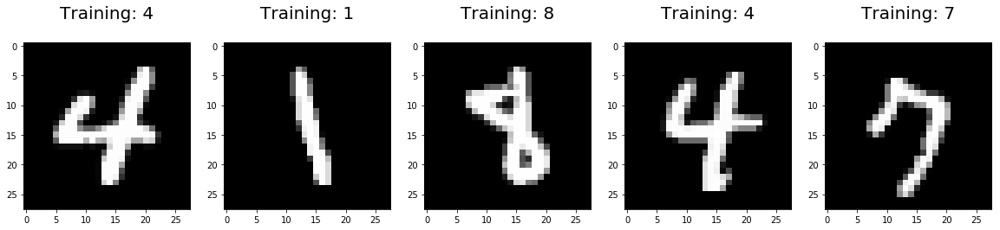

In [10]:
#Showing the Images and Labels (MNIST)
plt.figure(figsize=(20,4))
for index, (image, label) in enumerate(zip(train_img[0:5], train_lbl[0:5])):
    plt.subplot(1, 5, index + 1)
    plt.imshow(np.reshape(image, (28,28)), cmap=plt.cm.gray)
    plt.title('Training: %i\n' % label, fontsize = 20)
 


## Logistic Regression Model

In [11]:
#Now, it is time to choose the model, in this case it is a Logistic Regression model 
#(be sure you import the model.
#ie,from sklearn.linear_model import LogisticRegression)
# all parameters not specified are set to their defaults
# default solver is incredibly slow thats why we change it
#logisticRegr = LogisticRegression(solver = 'lbfgs')
    
logisticRegr = LogisticRegression(solver = 'lbfgs')


# Training the model on the data, storing the information 
#learned from the data.
#Model is learning the relationship between x (digits) and y (labels)

logisticRegr.fit(train_img, train_lbl)



/Users/Faith/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)
/Users/Faith/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning: lbfgs failed to converge. Increase the number of iterations.
  "of iterations.", ConvergenceWarning)
/Users/Faith/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning: lbfgs failed to converge. Increase the number of iterations.
  "of iterations.", ConvergenceWarning)
/Users/Faith/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning: lbfgs failed to converge. Increase the number of iterations.
  "of iterations.", ConvergenceWarning)
/Users/Faith/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning: lbfgs failed

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='warn',
          n_jobs=None, penalty='l2', random_state=None, solver='lbfgs',
          tol=0.0001, verbose=0, warm_start=False)

## Predict The Labels of New Data

In [12]:
#Predict the labels of new data (new images)
#Uses the information the model learned during the model training process
# Returns a NumPy Array
# Predict for One Observation (image)
#logisticRegr.predict(test_img[0].reshape(1,-1))

#Predict for Multiple Observations (images) at Once

#logisticRegr.predict(test_img[0:10])

#Predict the entire test data
predictions = logisticRegr.predict(test_img)




## Measuring Accuracy of the model

In [13]:
#Measuring accuracy of the model
score = logisticRegr.score(test_img, test_lbl)

print("Accuracy score: ",score)


Accuracy score:  0.9134


## Identifying Misclassified Images and Creating a Confusion Matrix

In [14]:
#Identifying Misclassified images and image labels
# and creating a confusion matrix 
index = 0
confusion_dict = {}
misclassifiedIndexes = []

for label, predict in zip(test_lbl, predictions):
    if label != predict: 
        misclassifiedIndexes.append(index)
        if not (label in confusion_dict.keys()):
            confusion_dict[label]=[predict]
        else:
            confusion_dict[label].append(predict)
    index +=1
    all_labels = sorted(list(confusion_dict.keys()))  
    
#label_cts = [len(confusion_dict[int(label)]) for label in all_labels]
label_cts = []
for label in all_labels:
    label_cts.append(len(confusion_dict[label]))
#confusion_mat = [[confusion_dict[int(label)].count(predict)/label_cts[int(label)] for predict in all_labels] for label in all_labels]
confusion_mat = []
for label in all_labels:
    predict_ratios = []
    for predict in all_labels:
        predict_ratios.append(round(confusion_dict[int(label)].count(predict)/label_cts[int(label)], 3))
    confusion_mat.append(predict_ratios)

#print("Confusion Matrix ",confusion_mat)
#print(confusion_mat[8])

## Confusion Matrix using Seaborn package

[[ 908    0    3    4    2    3    7    1    7    1]
 [   0 1121   10    4    1    4    4    2   14    3]
 [   3    8  877   17   13    3   15   14   30    2]
 [   1    7   32  927    0   25    2    7   25   12]
 [   5    1    5    0  873    2    8    4   10   40]
 [  12    4   10   39   11  778   17    5   33   12]
 [   4    1    5    1    5    9  982    0    5    1]
 [   8    3   16    3   12    1    0  942    5   39]
 [   5   20   11   29    6   30    9    4  849   15]
 [   7    2    4   19   39    5    0   28   11  877]]


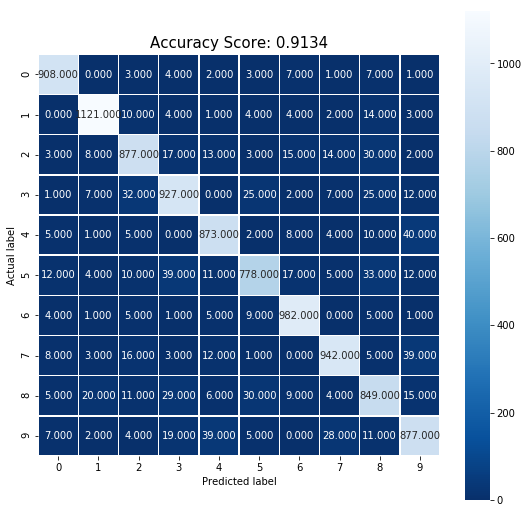

In [15]:

#Confusion matrix using 'seaborn' python package
cm = metrics.confusion_matrix(test_lbl, predictions)
print(cm)
plt.figure(figsize=(9,9))
sns.heatmap(cm, annot=True, fmt=".3f", linewidths=.5, square = True, cmap = 'Blues_r');
plt.ylabel('Actual label');
plt.xlabel('Predicted label');
all_sample_title = 'Accuracy Score: {0}'.format(score)
plt.title(all_sample_title, size = 15);



## Print the Misclassified Images

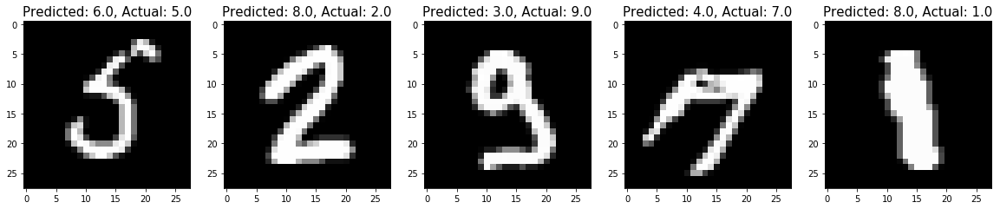

In [16]:
#Print the misclassified images
plt.figure(figsize=(20,4))
for plotIndex, badIndex in enumerate(misclassifiedIndexes[0:5]):
    plt.subplot(1, 5, plotIndex + 1)
    plt.imshow(np.reshape(test_img[badIndex], (28,28)), cmap=plt.cm.gray)
    plt.title('Predicted: {}, Actual: {}'.format(predictions[badIndex], test_lbl[badIndex]), fontsize = 15)

plt.show()
